## Open Data and Imports 

In [1200]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import pmdarima as pm
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import  ARIMA
from sklearn.metrics import mean_squared_error
import geopandas
%matplotlib inline 

In [1201]:
raw_df = pd.read_csv('Seoul.csv')
df_measurements = pd.read_csv('Measurement_info.csv')
df_station = pd.read_csv('Measurement_station_info.csv')
shanghi_weather = pd.read_csv('Shanghai AQI and Weather.csv')
shanghi_air = pd.read_csv('shanghai-air-quality.csv', index_col=False)
gdf = geopandas.read_file('Seoul')

In [1202]:
raw_df.head()

,Measurement date,Station code,Address,Latitude,Longitude,SO2,NO2,O3,CO,PM10,PM2.5
0,2017-01-01 00:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.059,0.002,1.2,73.0,57.0
1,2017-01-01 01:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.058,0.002,1.2,71.0,59.0
2,2017-01-01 02:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.056,0.002,1.2,70.0,59.0
3,2017-01-01 03:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.004,0.056,0.002,1.2,70.0,58.0
4,2017-01-01 04:00,101,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005007,0.003,0.051,0.002,1.2,69.0,61.0


##### This is a general indiction of what levels of certain pollutants are the worse.

In [1203]:
df_measurements

,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.0
1,3,NO2,ppm,0.03,0.06,0.20,2.0
2,5,CO,ppm,2.00,9.00,15.00,50.0
3,6,O3,ppm,0.03,0.09,0.15,0.5
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.0
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.0


##### Station based on district of Seoul

In [1204]:
df_station

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",37.564263,126.974676
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",37.593742,126.949679
5,106,Mapo-gu,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597
6,107,Seongdong-gu,"18, Ttukseom-ro 3-gil, Seongdong-gu, Seoul, Re...",37.541864,127.049659
7,108,Gwangjin-gu,"571, Gwangnaru-ro, Gwangjin-gu, Seoul, Republi...",37.547180,127.092493
8,109,Dongdaemun-gu,"43, Cheonho-daero 13-gil, Dongdaemun-gu, Seoul...",37.575743,127.028885
9,110,Jungnang-gu,"369, Yongmasan-ro, Jungnang-gu, Seoul, Republi...",37.584848,127.094023


###### Weather Data on Shanghi to see how it may effect air pollution in Seoul

In [1205]:
shanghi_weather.head()

,date,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,DewPointC,FeelsLikeC,HeatIndexC,...,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,AQI,AQI_Explained
0,2014-01-01,15.0,5.0,0.0,8.7,4.0,0.0,-1.0,11.0,12.0,...,0.0,43.0,0.0,1021.0,15.0,10.0,242.0,12.0,319.0,Hazardous
1,2014-01-02,14.0,7.0,0.0,8.7,4.0,2.0,4.0,11.0,13.0,...,3.0,60.0,0.0,1019.0,14.0,10.0,141.0,14.0,352.0,Hazardous
2,2014-01-03,16.0,9.0,0.0,8.7,4.0,10.0,3.0,11.0,12.0,...,26.0,55.0,0.0,1017.0,16.0,10.0,295.0,14.0,338.0,Hazardous
3,2014-01-04,10.0,4.0,0.0,5.5,2.0,17.0,3.0,7.0,9.0,...,24.0,68.0,0.1,1022.0,10.0,10.0,169.0,14.0,355.0,Hazardous
4,2014-01-05,10.0,3.0,0.0,8.7,3.0,24.0,3.0,9.0,9.0,...,12.0,66.0,0.0,1024.0,10.0,10.0,117.0,6.0,343.0,Hazardous


##### Air qualtiy data on Shanghi to see how ceratin increases in specfic polutes could effect Seoul 

In [1206]:
shanghi_air.head()

,date,pm25,pm10,o3,no2,so2,co
0,2021/1/5,76,43,28,13,1,6
1,2021/1/6,98,41,23,15,2,7
2,2021/1/7,101,60,20,9,2,7
3,2021/1/8,81,46,19,13,3,9
4,2021/1/9,80,57,20,24,4,10


##### Cutting down to look at the daily average and creating a df that looks at every station and date seperatley 

In [1207]:
raw_df['Measurement date'] = raw_df['Measurement date'].str.slice(0, 11)
df = raw_df.groupby(['Station code', 'Measurement date']).aggregate({'SO2': 'mean', 'NO2':'mean', 'O3':'mean', 'CO':'mean', 'PM10':'mean', 'PM2.5':'mean'})

# Functions Relevant for Creating New Columns

##### SO2 Level

In [1208]:
def SO2Level(x):
    if x <= 0.02:
        return "Good"
    elif 0.02 < x <= 0.05:
        return  "Normal"
    elif 0.05 < x <= 0.15:
        return "Bad"
    elif 0.15 < x <= 1.0:
        return  "Very Bad"
df['SO2 Level'] = df.apply(lambda row: SO2Level(row.SO2), axis=1)

##### NO2 Level

In [1209]:
def NO2Level(x):
    if x <= 0.03:
        return "Good"
    elif 0.03 < x <= 0.06:
        return "Normal"
    elif 0.06 < x <= 0.2:
        return "Bad"
    elif 0.2 < x <= 2.0:
        return "Very Bad"
df['NO2 Level'] = df.apply(lambda row: NO2Level(row.NO2), axis=1) 

##### CO Level

In [1210]:
def COLevel(x):
    if x <= 2:
        return "Good"
    elif 2 < x <= 9:
        return "Normal"
    elif 9 < x <= 15:
        return "Bad"
    elif 15 < x <= 50:
        return "Very Bad"
df['CO Level'] = df.apply(lambda row: COLevel(row.CO), axis=1)

##### O3 Level

In [1211]:
def O3Level(x):
    if x <= 0.03:
        return "Good"
    elif 0.03 < x <= 0.09:
        return "Normal"
    elif 0.09 < x <= 0.15:
        return "Bad"
    elif 0.15 < x <= 0.5:
        return "Very Bad"
df['O3 Level'] = df.apply(lambda row: O3Level(row.O3), axis=1)

##### PM10 Level

In [1212]:
def PM10Level(x):
    if x <= 30:
        return "Good"
    elif 30 < x <= 80:
        return "Normal"
    elif 80 < x <= 150:
        return "Bad"
    elif 150 < x <= 600:
        return "Very Bad"
df['PM10 Level'] = df.apply(lambda row: PM10Level(row.PM10), axis=1)

##### PM2.5 Level

In [1213]:
def PM25Level(x):
    if x <= 15:
        return "Good"
    elif 15 < x <= 35:
        return "Normal"
    elif 35 < x <= 75:
        return "Bad"
    elif 75 < x <= 500:
        return "Very Bad"
df['PM2.5 Level'] = df.apply(lambda row: PM25Level(row['PM2.5']), axis=1)

# New DataFrame

In [1214]:
df

SO2       NO2        O3        CO  \
Station code Measurement date                                           
101          2017-01-01        0.004208  0.054250  0.003125  1.029167   
             2017-01-02        0.004792  0.046250  0.016375  1.020833   
             2017-01-03        0.004833  0.046750  0.013875  0.833333   
             2017-01-04        0.005375  0.058167  0.008750  0.991667   
             2017-01-05        0.004333  0.041333  0.011000  0.620833   
...                                 ...       ...       ...       ...   
125          2019-12-27        0.002958  0.031667  0.015708  0.562500   
             2019-12-28        0.003292  0.043417  0.005667  0.612500   
             2019-12-29        0.003125  0.036833  0.007958  0.591667   
             2019-12-30        0.002958  0.030792  0.012083  0.591667   
             2019-12-31        0.002875  0.019542  0.018542  0.416667   

                                     PM10      PM2.5 SO2 Level NO2 Level  \
Station code Measurement date                                              
101          2017-01-01         81.666667  67.291667      Good    Normal   
             2017-01-02        112.166667  87.166667      Good    Normal   
             2017-01-03         72.916667  51.833333      Good    Normal   
             2017-01-04         51.125000  34.916667      Good    Normal   
             2017-01-05         34.875000  21.958333      Good    Normal   
...                                   ...        ...       ...       ...   
125          2019-12-27         41.083333  30.125000      Good    Normal   
             2019-12-28         49.375000  31.291667      Good    Normal   
             2019-12-29         49.791667  33.666667      Good    Normal   
             2019-12-30         46.125000  35.250000      Good    Normal   
             2019-12-31         27.458333  19.291667      Good      Good   

                              CO Level O3 Level PM10 Level PM2.5 Level  
Station code Measurement date                                           
101          2017-01-01           Good     Good        Bad         Bad  
             2017-01-02           Good     Good        Bad    Very Bad  
             2017-01-03           Good     Good     Normal         Bad  
             2017-01-04           Good     Good     Normal      Normal  
             2017-01-05           Good     Good     Normal      Normal  
...                                ...      ...        ...         ...  
125          2019-12-27           Good     Good     Normal      Normal  
             2019-12-28           Good     Good     Normal      Normal  
             2019-12-29           Good     Good     Normal      Normal  
             2019-12-30           Good     Good     Normal         Bad  
             2019-12-31           Good     Good       Good      Normal  

[27125 rows x 12 columns]

In [1215]:
df.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 27125 entries, (101, '2017-01-01 ') to (125, '2019-12-31 ')
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   SO2          27125 non-null  float64
 1   NO2          27125 non-null  float64
 2   O3           27125 non-null  float64
 3   CO           27125 non-null  float64
 4   PM10         27125 non-null  float64
 5   PM2.5        27125 non-null  float64
 6   SO2 Level    27125 non-null  object 
 7   NO2 Level    27123 non-null  object 
 8   CO Level     27125 non-null  object 
 9   O3 Level     27123 non-null  object 
 10  PM10 Level   27109 non-null  object 
 11  PM2.5 Level  27117 non-null  object 
dtypes: float64(6), object(6)
memory usage: 2.6+ MB


# Reset Index

In [1216]:
df = df.reset_index()

In [1217]:
df['Measurement date'] = pd.to_datetime(df['Measurement date'])
df.set_index(df['Measurement date'], inplace=True)
df = df.drop('Measurement date', axis=1)
df

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,125,0.002958,0.031667,0.015708,0.562500,41.083333,30.125000,Good,Normal,Good,Good,Normal,Normal
2019-12-28,125,0.003292,0.043417,0.005667,0.612500,49.375000,31.291667,Good,Normal,Good,Good,Normal,Normal
2019-12-29,125,0.003125,0.036833,0.007958,0.591667,49.791667,33.666667,Good,Normal,Good,Good,Normal,Normal


In [1218]:
df_station

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",37.564263,126.974676
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",37.593742,126.949679
5,106,Mapo-gu,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597
6,107,Seongdong-gu,"18, Ttukseom-ro 3-gil, Seongdong-gu, Seoul, Re...",37.541864,127.049659
7,108,Gwangjin-gu,"571, Gwangnaru-ro, Gwangjin-gu, Seoul, Republi...",37.547180,127.092493
8,109,Dongdaemun-gu,"43, Cheonho-daero 13-gil, Dongdaemun-gu, Seoul...",37.575743,127.028885
9,110,Jungnang-gu,"369, Yongmasan-ro, Jungnang-gu, Seoul, Republi...",37.584848,127.094023


Testing every station and see what pollutants are relavent to each station before modeling and testing. I will sperate every year and see if it shows the variation

In [1219]:
features = ['SO2', 'NO2', 'O3', 'CO', 'PM10', 'PM2.5']

## Relevant functions 

In [1220]:
def arima_results(endog, test, order=[0,0,0]):
    arima = ARIMA(endog, order=order).fit()
    
    train_hat = arima.predict()
    
    rmse_train = mean_squared_error(endog,
                                    train_hat,
                                    squared=False)
    
    
    rmse_test = mean_squared_error(test,
                                   arima.predict(), 
                                   squared=False)
    
 
    print(f"""Train RMSE: {rmse_train}""")     
    print(f"""Test RMSE: {rmse_test}""")    
    print(f"""Summary: {arima.summary()}""")
    
    return sm

In [1221]:
def stationarity_check(df):     
    df_test = adfuller(df)
    print('Results of Dickey-Fuller Test: \n')

    dfoutput = pd.Series(df_test[0:4], index=['Test Statistic', 'p-value', 
                                             '#Lags Used', 'Number of Observations Used'])
    for key,value in df_test[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)
    return None

In [1222]:
def arimamodel(timeseries):
    automodel = pm.auto_arima(timeseries, 
                              start_p=1, 
                              start_q=1,
                              test="adf",
                              seasonal=False,
                              trace=True)
    return automodel

In [1223]:
def plotarima(n_periods, timeseries, automodel):
    # Forecast
    fc, confint = automodel.predict(n_periods=n_periods, 
                                    return_conf_int=True)
    # Weekly index
    fc_ind = pd.date_range(timeseries.index[timeseries.shape[0]-1], 
                           periods=n_periods, 
                           freq="W")
    # Forecast series
    fc_series = pd.Series(fc, index=fc_ind)
    # Upper and lower confidence bounds
    lower_series = pd.Series(confint[:, 0], index=fc_ind)
    upper_series = pd.Series(confint[:, 1], index=fc_ind)
    # Create plot
    plt.figure(figsize=(10, 6))
    plt.plot(timeseries)
    plt.plot(fc_series, color="red")
    plt.xlabel("date")
    plt.ylabel(timeseries.name)
    plt.fill_between(lower_series.index, 
                     lower_series, 
                     upper_series, 
                     color="k", 
                     alpha=0.25)
    plt.legend(("past", "forecast", "95% confidence interval"),  
               loc="upper left")
    plt.show()

# Station 101

In [1224]:
df_101 = df[df['Station code'] == 101]

In [1225]:
df_101

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,101,0.006042,0.025083,0.018375,0.837500,34.416667,24.958333,Good,Good,Good,Good,Normal,Normal
2019-12-28,101,0.004250,0.046542,0.004708,0.766667,44.500000,30.458333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,101,0.003792,0.037750,0.008167,0.708333,45.375000,30.291667,Good,Normal,Good,Good,Normal,Normal


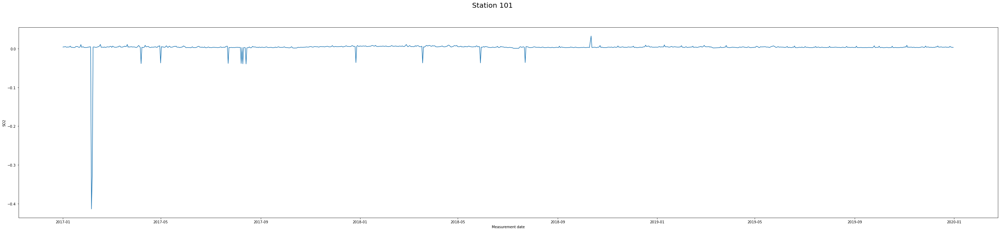

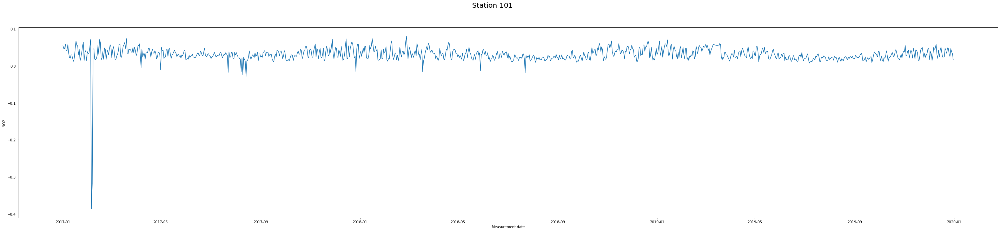

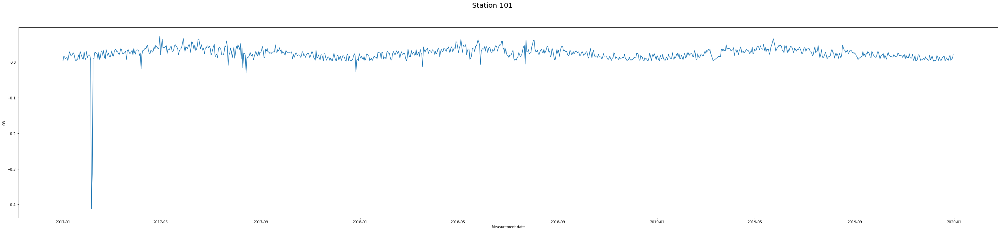

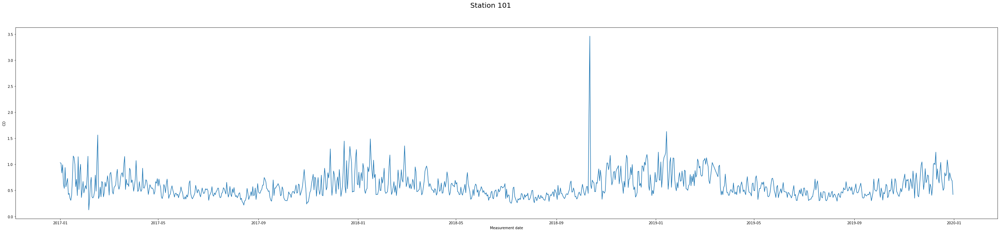

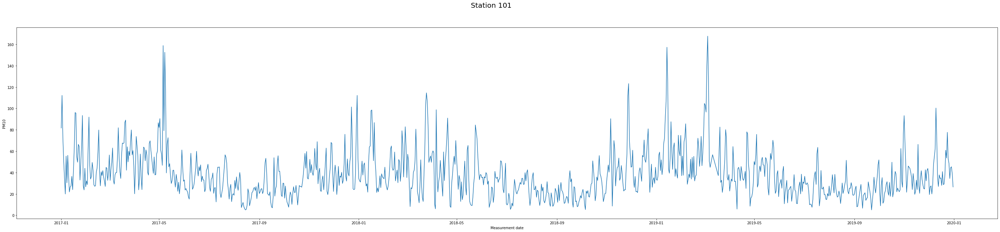

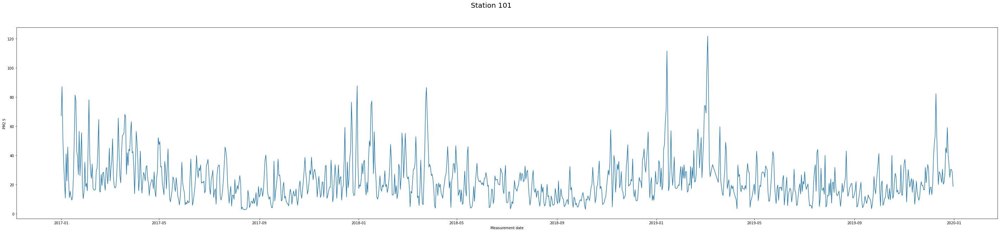

In [1226]:
for feature in features:
    fig, ax = plt.subplots(figsize=(50,10))
    fig.suptitle("Station 101", fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_101)

In [1227]:
df_101['NO2 Level'].value_counts()

Good      567
Normal    494
Bad        24
Name: NO2 Level, dtype: int64

In [1228]:
df_101['PM10 Level'].value_counts()

Normal      589
Good        446
Bad          46
Very Bad      4
Name: PM10 Level, dtype: int64

In [1229]:
df_101['PM2.5 Level'].value_counts()

Normal      576
Good        349
Bad         146
Very Bad     14
Name: PM2.5 Level, dtype: int64

##### For Station 101
- NO2 reaches levels of 'Bad' on 24 occasions and sits close to bad on most of the year. 
- PM10 reaches levels of 'Bad' on 46 occasions and 'Very Bad' on 4, and can get close to bad on many occasions. 
- PM2.5 reaches levels of 'Bad' on 146 occasions and 'Very Bad' on 14 occasions.


In [1230]:
df_101

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,101,0.004208,0.054250,0.003125,1.029167,81.666667,67.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,101,0.004792,0.046250,0.016375,1.020833,112.166667,87.166667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,101,0.004833,0.046750,0.013875,0.833333,72.916667,51.833333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,101,0.005375,0.058167,0.008750,0.991667,51.125000,34.916667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,101,0.004333,0.041333,0.011000,0.620833,34.875000,21.958333,Good,Normal,Good,Good,Normal,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,101,0.006042,0.025083,0.018375,0.837500,34.416667,24.958333,Good,Good,Good,Good,Normal,Normal
2019-12-28,101,0.004250,0.046542,0.004708,0.766667,44.500000,30.458333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,101,0.003792,0.037750,0.008167,0.708333,45.375000,30.291667,Good,Normal,Good,Good,Normal,Normal


# Picking the relevant columns 

In [1231]:
columns = ['NO2', 'PM10', 'PM2.5']
df_101 = df_101[columns]
df_101

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.054250,81.666667,67.291667
2017-01-02,0.046250,112.166667,87.166667
2017-01-03,0.046750,72.916667,51.833333
2017-01-04,0.058167,51.125000,34.916667
2017-01-05,0.041333,34.875000,21.958333
...,...,...,...
2019-12-27,0.025083,34.416667,24.958333
2019-12-28,0.046542,44.500000,30.458333
2019-12-29,0.037750,45.375000,30.291667


# Train-Test Split

In [1232]:
train = df_101[:-542]
test = df_101[542:]

<AxesSubplot:xlabel='Measurement date'>

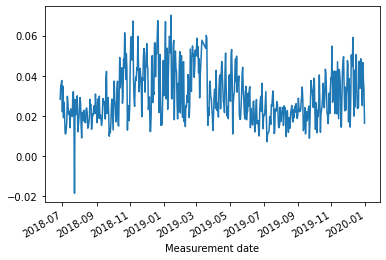

In [1233]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

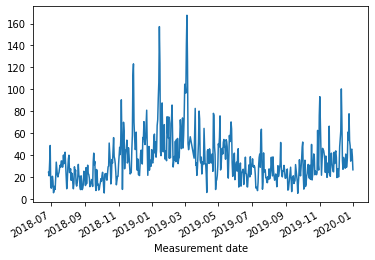

In [1234]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

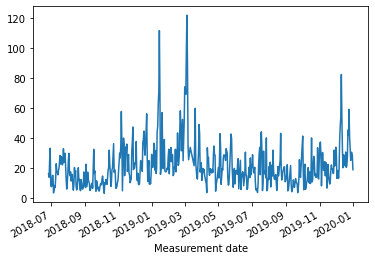

In [1235]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

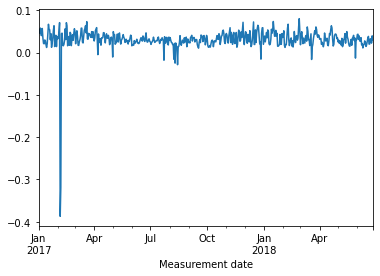

In [1236]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

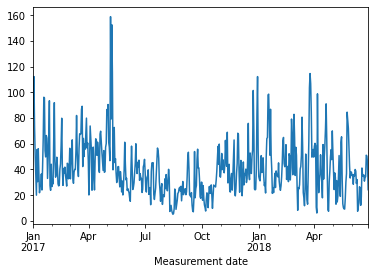

In [1237]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

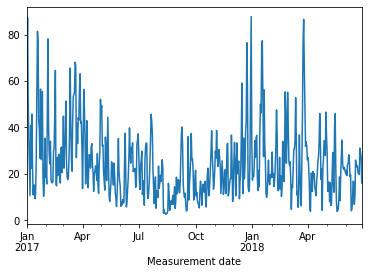

In [1238]:
train['PM2.5'].plot()

In [1239]:
print(stationarity_check(df_101['PM2.5']))
print(stationarity_check(df_101['PM10']))
print(stationarity_check(df_101['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -5.321631
p-value                           0.000005
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.915741e+00
p-value                        2.575463e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.508201e+00
p-value                        1.117369e-08
#Lags Used                     1.300000e+01
Number of Observations Used    1.071000e+03
Critical Value (1%)           -3.436470e+00
Critical Value (5%)           -2

# Rolling Mean Difference Train

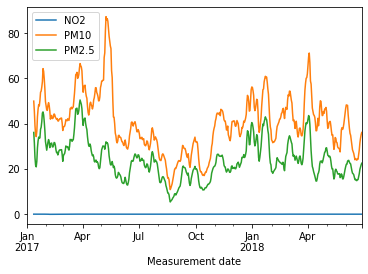

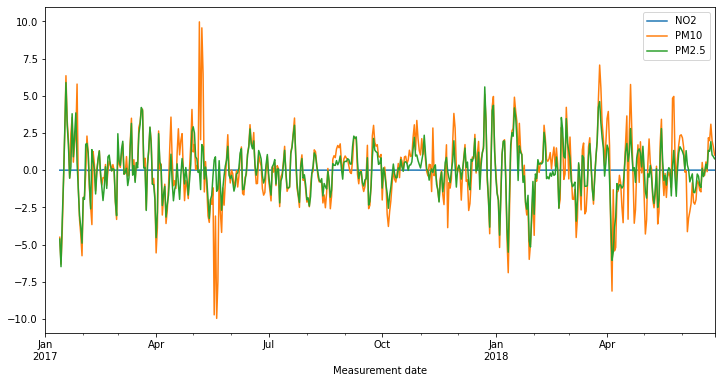

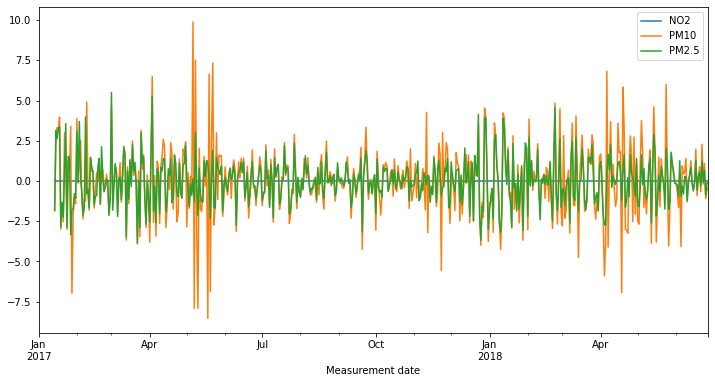

In [1240]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [1241]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.721942e+00
p-value                        1.186229e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.362457e+00
p-value                        2.799742e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.917348e+00
p-value                        1.063850e-14
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)      

In [1242]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.076823e+01
p-value                        2.421605e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.073179e+01
p-value                        2.966897e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.952936e+00
p-value                        2.486988e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

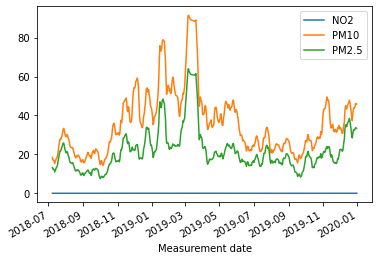

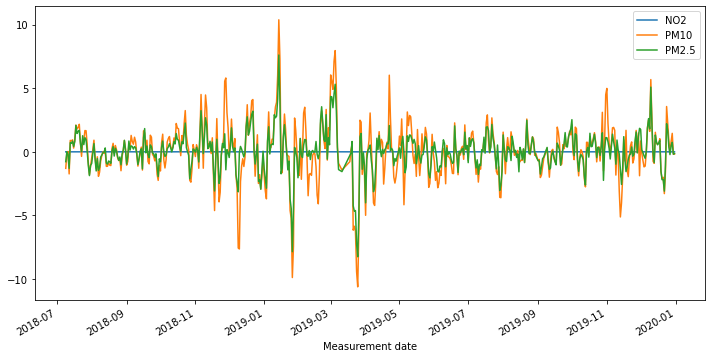

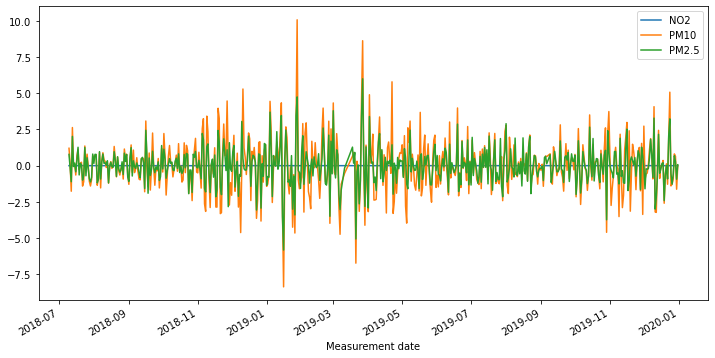

In [1243]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [1244]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.342381e+00
p-value                        2.734622e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.979350e+00
p-value                        2.649065e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.795774e+00
p-value                        2.303079e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [1245]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.560612e+00
p-value                        2.431629e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.166386e+01
p-value                        1.904796e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.017954e+01
p-value                        6.751796e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# First Simple Model 

# Station 101 PM2.5

In [1246]:
base_model = sm.tsa.statespace.SARIMAX(df_101['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4467.775
Date:                Thu, 21 Oct 2021   AIC                           8939.549
Time:                        22:47:32   BIC                           8949.528
Sample:                             0   HQIC                          8943.327
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8531      0.609     37.504      0.000      21.659      24.047
sigma2       220.8872      6.567     33.634      0.000     208.015     233.759
Ljung-Box (L1) (Q):                 510.36   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8379.443, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10253.923, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8377.701, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9291.279, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8379.575, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8371.134, Time=0.10 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8210.393, Time=0.24 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8323.457, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8208.702, Time=0.29 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8303.897, Time=0.08 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8210.655, Time=0.42 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.55 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8209.151, Time=0.32 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8291.323, Time=0.14 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

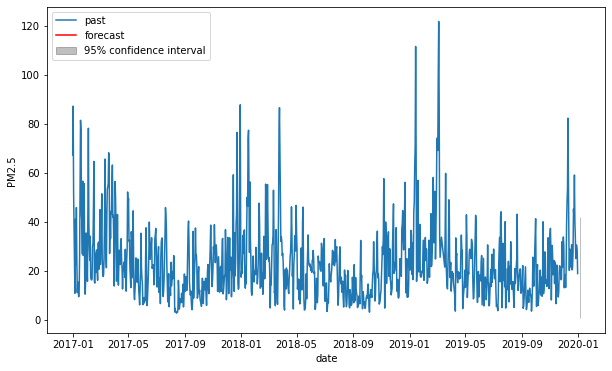

In [1247]:
timeseries = df_101['PM2.5']
automodel = arimamodel(df_101['PM2.5'])
plotarima(1, timeseries, automodel)

In [1248]:
best_model = sm.tsa.statespace.SARIMAX(df_101['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4094.542
Date:                Thu, 21 Oct 2021   AIC                           8201.084
Time:                        22:47:41   BIC                           8231.020
Sample:                             0   HQIC                          8212.417
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3303      0.217      1.521      0.128      -0.095       0.756
ar.L1          1.3768      0.057     24.285      0.000       1.266       1.488
ar.L2         -0.3913      0.051     -7.701      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [1249]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 11.141133861796654
Test RMSE: 18.608189264988095
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2076.121
Date:                Thu, 21 Oct 2021   AIC                           4164.242
Time:                        22:47:41   BIC                           4190.025
Sample:                    01-01-2017   HQIC                          4174.323
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.4734      1.586     15.430      0.000      21.365      27.582
ar.L1         -0.2620      0.167     -1.569      0.117      -

# Station 101 NO2

In [1255]:
base_model = sm.tsa.statespace.SARIMAX(df_101['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2626.791
Date:                Thu, 21 Oct 2021   AIC                          -5249.583
Time:                        22:48:39   BIC                          -5239.604
Sample:                             0   HQIC                         -5245.805
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0305      0.001     30.446      0.000       0.029       0.033
sigma2         0.0005   3.09e-06    149.742      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 216.31   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5303.845, Time=0.18 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4052.782, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5241.732, Time=0.06 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4842.913, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-5266.897, Time=0.17 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-5577.093, Time=0.36 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5022.466, Time=0.11 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-5563.326, Time=0.42 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-5575.378, Time=0.62 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5086.023, Time=0.19 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-5573.402, Time=0.46 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-5571.659, Time=0.24 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0]          
Total fit time: 2.920 seconds


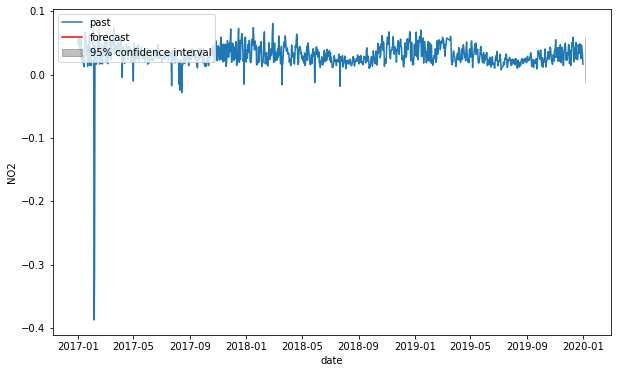

In [1256]:
timeseries = df_101['NO2']
automodel = arimamodel(df_101['NO2'])
plotarima(1, timeseries, automodel)

In [1257]:
best_model = sm.tsa.statespace.SARIMAX(df_101['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                2790.830
Date:                Thu, 21 Oct 2021   AIC                          -5571.659
Time:                        22:48:45   BIC                          -5546.712
Sample:                             0   HQIC                         -5562.215
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0142      0.021      0.691      0.490      -0.026       0.054
ar.L1          0.5350      0.671      0.797      0.425      -0.780       1.850
ma.L1          0.0628      0.671      0.094      0.9

In [1259]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

Train RMSE: 0.023822129277562047
Test RMSE: 0.019286586835801305
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1258.700
Date:                Thu, 21 Oct 2021   AIC                          -2507.400
Time:                        22:48:59   BIC                          -2485.914
Sample:                    01-01-2017   HQIC                         -2498.999
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0313      0.003     11.469      0.000       0.026       0.037
ar.L1          0.1504      1.874      0.080      0.936   

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 101 PM10

In [53]:
base_model = sm.tsa.statespace.SARIMAX(df_101['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4875.241
Date:                Wed, 20 Oct 2021   AIC                           9754.481
Time:                        14:47:59   BIC                           9764.460
Sample:                             0   HQIC                          9758.259
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     37.9738      0.849     44.748      0.000      36.311      39.637
sigma2       468.1279     14.189     32.993      0.000     440.319     495.937
Ljung-Box (L1) (Q):                 512.02   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9190.636, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11278.195, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9204.205, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10298.104, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9204.883, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9063.629, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9879.548, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9022.992, Time=0.18 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9024.473, Time=0.39 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9024.319, Time=0.31 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9032.012, Time=0.21 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9025.688, Time=0.28 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9025.719, Time=0.48 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9017.193, Time=0.54 sec
 ARIMA(1,0,2)(0,0,0)[0] interce

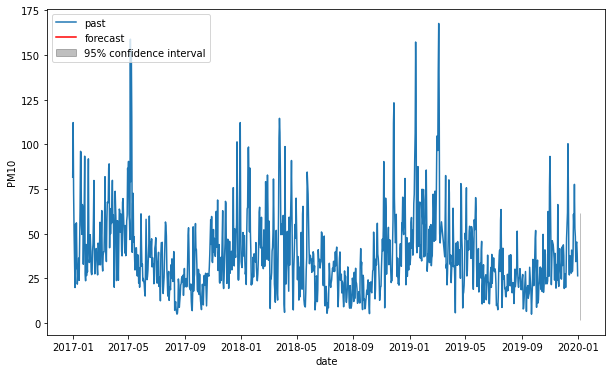

In [54]:
timeseries = df_101['PM10']
automodel = arimamodel(df_101['PM10'])
plotarima(1, timeseries, automodel)

In [55]:
best_model = sm.tsa.statespace.SARIMAX(df_101['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4502.597
Date:                Wed, 20 Oct 2021   AIC                           9017.193
Time:                        14:48:06   BIC                           9047.129
Sample:                             0   HQIC                          9028.526
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4130      0.268      1.542      0.123      -0.112       0.938
ar.L1          1.3866      0.048     28.910      0.000       1.293       1.481
ar.L2         -0.3974      0.044     -9.004      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [56]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

Train RMSE: 16.409248252265836
Test RMSE: 28.582567463643873
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2288.574
Date:                Wed, 20 Oct 2021   AIC                           4589.148
Time:                        14:48:06   BIC                           4614.931
Sample:                    01-01-2017   HQIC                          4599.229
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.7421      5.394      7.553      0.000      30.170      51.314
ar.L1          1.4014      0.067     21.006      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102

In [57]:
df_102 = df[df['Station code'] == 102]

In [58]:
df_102.tail()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2019-12-27,102,0.003167,0.022667,0.020417,0.495833,33.333333,28.250000,Good,Good,Good,Good,Normal,Normal
2019-12-28,102,0.003625,0.043792,0.003833,0.695833,44.000000,32.833333,Good,Normal,Good,Good,Normal,Normal
2019-12-29,102,0.003500,0.034958,0.008292,0.612500,44.958333,33.166667,Good,Normal,Good,Good,Normal,Normal
2019-12-30,102,0.003083,0.029875,0.011833,0.600000,35.250000,29.791667,Good,Good,Good,Good,Normal,Normal
2019-12-31,102,0.002375,0.013583,0.021542,0.375000,25.666667,18.041667,Good,Good,Good,Good,Good,Normal


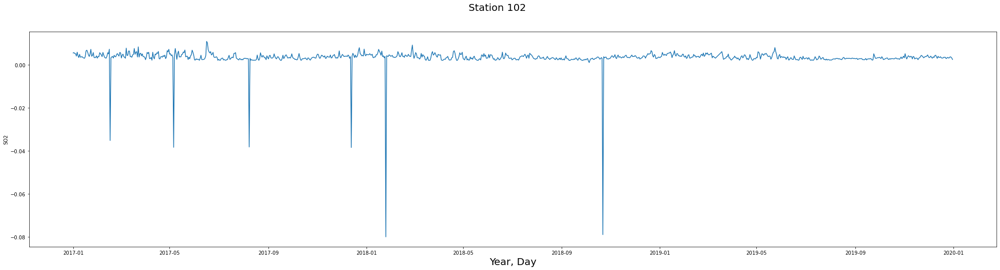

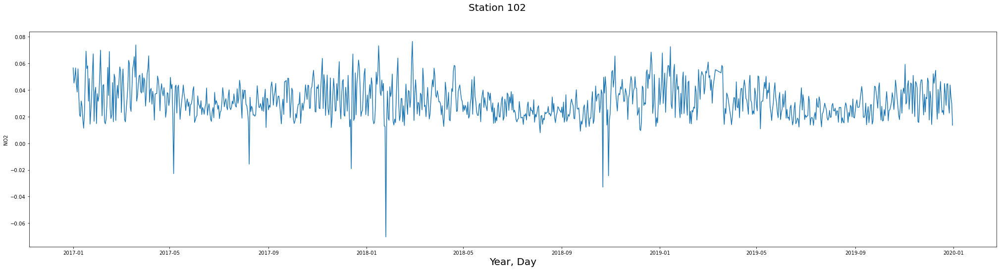

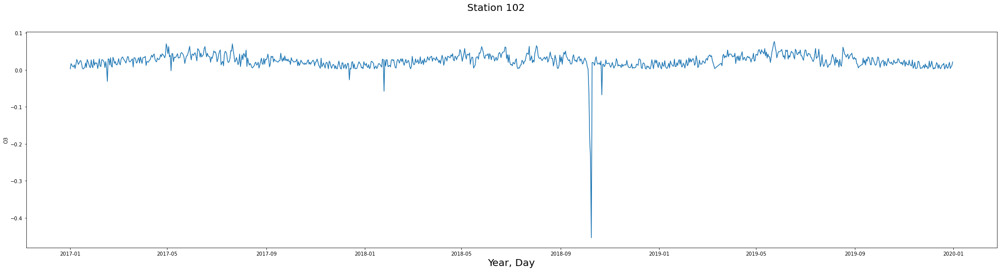

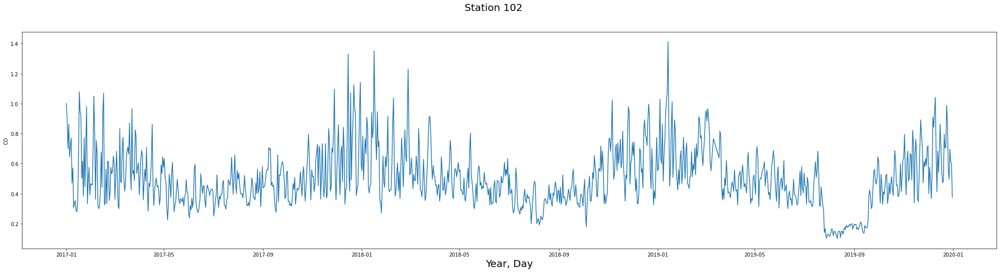

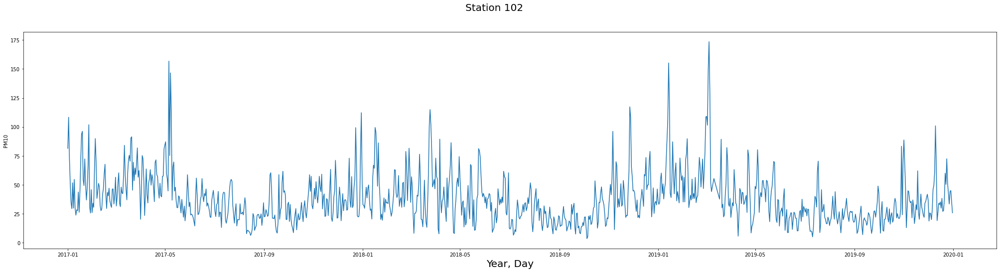

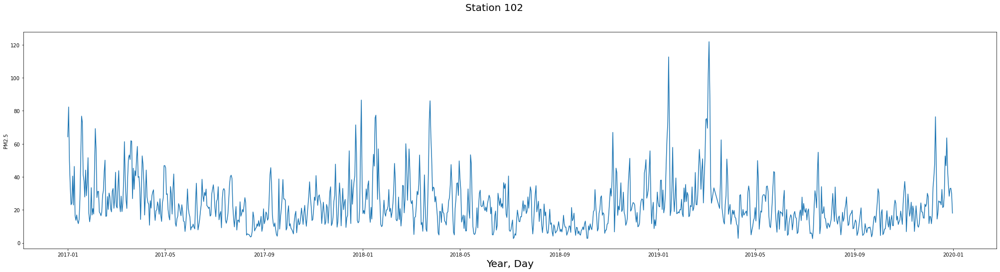

In [59]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 102", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_102)

In [60]:
df_102['NO2 Level'].value_counts()

Good      536
Normal    528
Bad        21
Name: NO2 Level, dtype: int64

In [61]:
df_102['PM10 Level'].value_counts()

Normal      589
Good        444
Bad          48
Very Bad      4
Name: PM10 Level, dtype: int64

In [62]:
df_102['PM2.5 Level'].value_counts()

Normal      581
Good        345
Bad         147
Very Bad     12
Name: PM2.5 Level, dtype: int64

##### For Station 102
- NO2 reaches levels of 'Bad' on 21 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 48 occasions and 'Very Bad' on 4, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 147 occasions and 'Very Bad' on 12 occasions.

# Picking the relevant columns

In [63]:
columns = ['NO2', 'PM10', 'PM2.5']
df_102 = df_102[columns]
df_102

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.056667,81.416667,64.250000
2017-01-02,0.045250,108.291667,82.333333
2017-01-03,0.049083,72.916667,49.791667
2017-01-04,0.056667,50.958333,34.375000
2017-01-05,0.044833,34.666667,23.125000
...,...,...,...
2019-12-27,0.022667,33.333333,28.250000
2019-12-28,0.043792,44.000000,32.833333
2019-12-29,0.034958,44.958333,33.166667


# Train-Test Split

In [64]:
train = df_102[:-542]
test = df_102[542:]

<AxesSubplot:xlabel='Measurement date'>

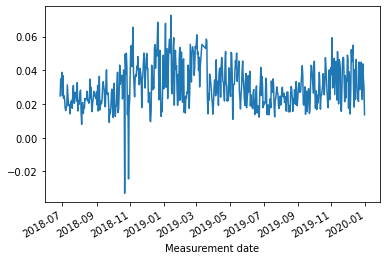

In [65]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

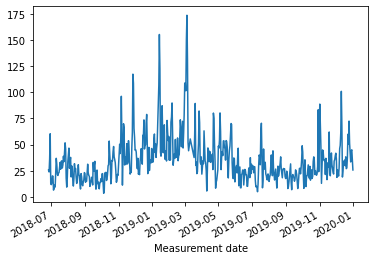

In [66]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

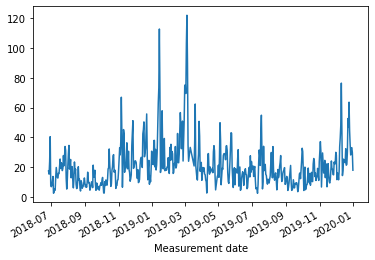

In [67]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

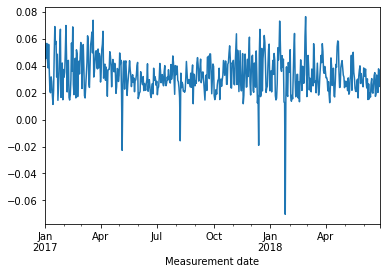

In [68]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

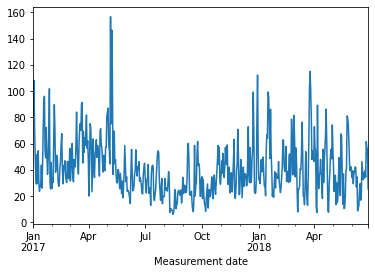

In [69]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

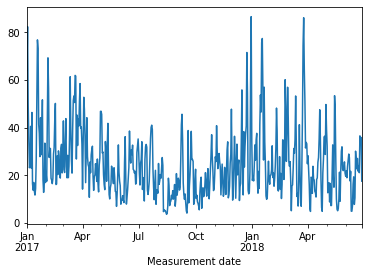

In [70]:
train['PM2.5'].plot()

In [71]:
print(stationarity_check(df_102['PM2.5']))
print(stationarity_check(df_102['PM10']))
print(stationarity_check(df_102['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.986390e+00
p-value                        2.542277e-12
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.749603e+00
p-value                        2.974213e-09
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.500309
p-value                           0.000196
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)           

# Rolling Mean Difference Train¶

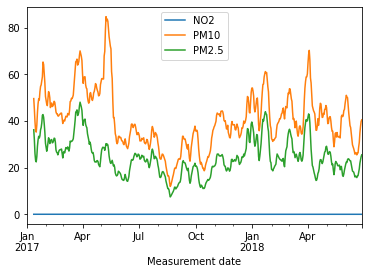

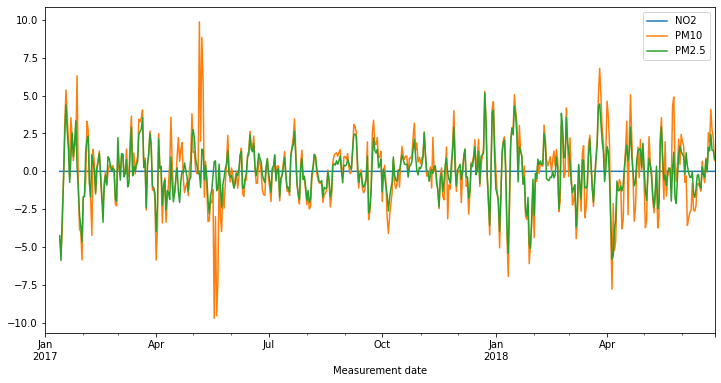

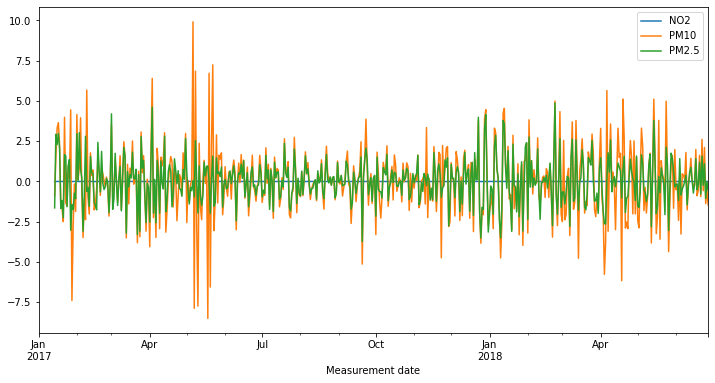

In [72]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [73]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.841801e+00
p-value                        5.909943e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.381231e+00
p-value                        2.506934e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.940039e+00
p-value                        2.679423e-17
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [74]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.122836e+01
p-value                        1.935048e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.073226e+01
p-value                        2.959173e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.114692e+01
p-value                        3.010062e-20
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test¶

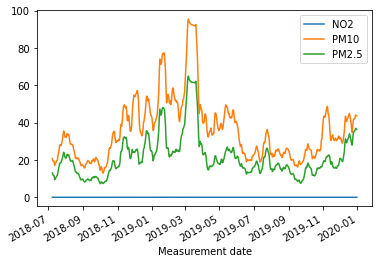

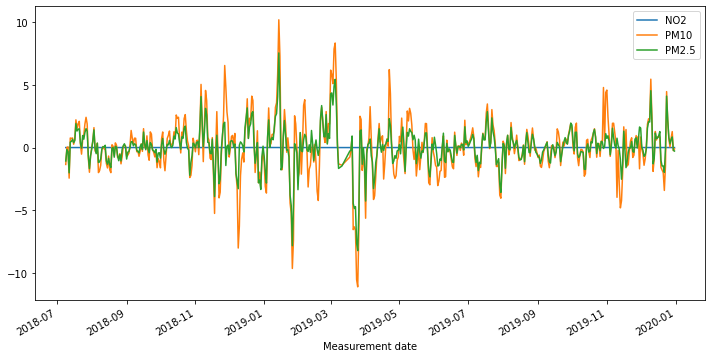

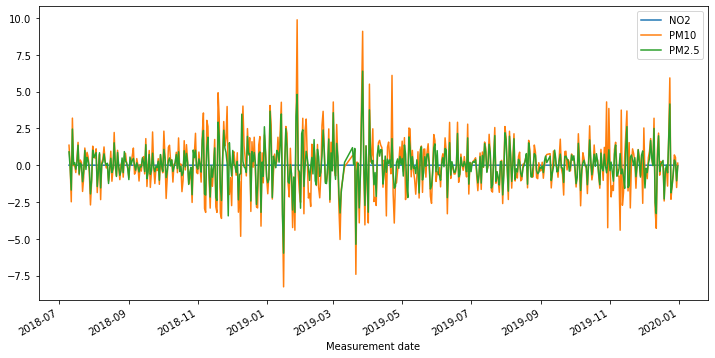

In [75]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [76]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.109808e+00
p-value                        9.392119e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.600126
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.672372e+00
p-value                        1.581161e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [77]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.802570e+00
p-value                        5.941216e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.154737e+01
p-value                        3.514499e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.053012e+01
p-value                        9.197947e-19
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 102 PM10

In [78]:
base_model = sm.tsa.statespace.SARIMAX(df_102['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4877.817
Date:                Wed, 20 Oct 2021   AIC                           9759.634
Time:                        14:48:10   BIC                           9769.612
Sample:                             0   HQIC                          9763.411
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     37.9718      0.851     44.595      0.000      36.303      39.641
sigma2       470.3562     14.201     33.120      0.000     442.522     498.190
Ljung-Box (L1) (Q):                 512.42   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9194.965, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11279.377, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9208.310, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10294.880, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9208.441, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9065.247, Time=0.12 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9894.008, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9027.254, Time=0.26 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9028.026, Time=0.38 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9028.268, Time=0.29 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9038.088, Time=0.19 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9029.957, Time=0.24 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9029.286, Time=0.49 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9021.489, Time=0.51 sec
 ARIMA(1,0,2)(0,0,0)[0] interce

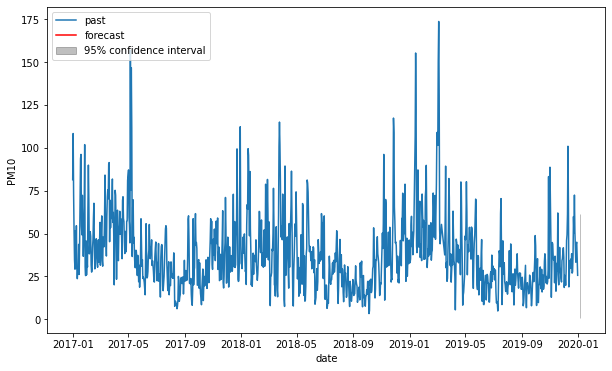

In [79]:
timeseries = df_102['PM10']
automodel = arimamodel(df_102['PM10'])
plotarima(1, timeseries, automodel)

In [80]:
best_model = sm.tsa.statespace.SARIMAX(df_102['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4504.745
Date:                Wed, 20 Oct 2021   AIC                           9021.489
Time:                        14:48:17   BIC                           9051.425
Sample:                             0   HQIC                          9032.822
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4065      0.267      1.522      0.128      -0.117       0.930
ar.L1          1.3613      0.052     26.393      0.000       1.260       1.462
ar.L2         -0.3719      0.048     -7.797      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [81]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

Train RMSE: 16.27156562422011
Test RMSE: 28.775897078739177
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2284.086
Date:                Wed, 20 Oct 2021   AIC                           4580.173
Time:                        14:48:18   BIC                           4605.956
Sample:                    01-01-2017   HQIC                          4590.254
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         41.2074      5.283      7.801      0.000      30.854      51.561
ar.L1          1.3962      0.068     20.604      0.000       1

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102 PM2.5

In [82]:
base_model = sm.tsa.statespace.SARIMAX(df_102['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4455.322
Date:                Wed, 20 Oct 2021   AIC                           8914.644
Time:                        14:48:18   BIC                           8924.623
Sample:                             0   HQIC                          8918.421
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8691      0.600     38.098      0.000      21.693      24.046
sigma2       215.8747      6.356     33.961      0.000     203.416     228.333
Ljung-Box (L1) (Q):                 533.58   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8301.962, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10247.656, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8302.517, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9233.965, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8281.606, Time=0.11 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8303.452, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8124.079, Time=0.23 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8219.717, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8113.611, Time=0.32 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8208.971, Time=0.11 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8115.081, Time=0.49 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=8124.665, Time=0.57 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8113.501, Time=0.28 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8111.700, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]         

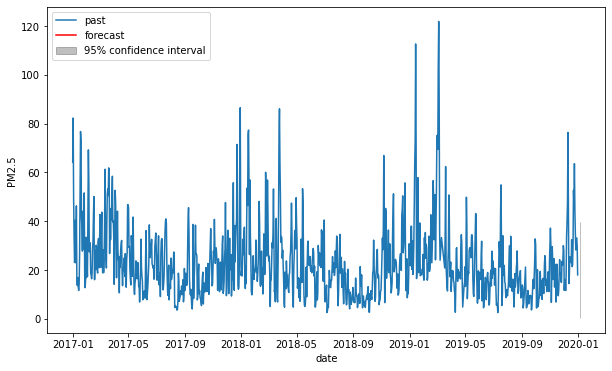

In [83]:
timeseries = df_102['PM2.5']
automodel = arimamodel(df_102['PM2.5'])
plotarima(1, timeseries, automodel)

In [84]:
best_model = sm.tsa.statespace.SARIMAX(df_102['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4046.362
Date:                Wed, 20 Oct 2021   AIC                           8104.724
Time:                        14:48:26   BIC                           8134.660
Sample:                             0   HQIC                          8116.057
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2596      0.179      1.452      0.147      -0.091       0.610
ar.L1          1.3625      0.051     26.751      0.000       1.263       1.462
ar.L2         -0.3735      0.047     -8.019      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [85]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

Train RMSE: 10.595628914329078
Test RMSE: 19.206907957110904
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2049.017
Date:                Wed, 20 Oct 2021   AIC                           4110.035
Time:                        14:48:26   BIC                           4135.817
Sample:                    01-01-2017   HQIC                          4120.116
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.4101      3.331      7.627      0.000      18.881      31.940
ar.L1          1.3635      0.070     19.582      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 102 NO2

In [86]:
base_model = sm.tsa.statespace.SARIMAX(df_102['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3155.444
Date:                Wed, 20 Oct 2021   AIC                          -6306.889
Time:                        14:48:26   BIC                          -6296.910
Sample:                             0   HQIC                         -6303.111
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0320      0.000     79.484      0.000       0.031       0.033
sigma2         0.0002    4.3e-06     40.560      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 203.05   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6440.470, Time=0.20 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4219.576, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6215.802, Time=0.07 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5132.336, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6555.884, Time=0.30 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-6272.644, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6385.309, Time=0.30 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6542.308, Time=0.30 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6567.828, Time=0.25 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5503.333, Time=0.18 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6566.030, Time=0.43 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5687.893, Time=0.20 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=inf, Time=0.50 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-6560.164, Time=0.46 sec

Best model:  ARIMA(1,0,2

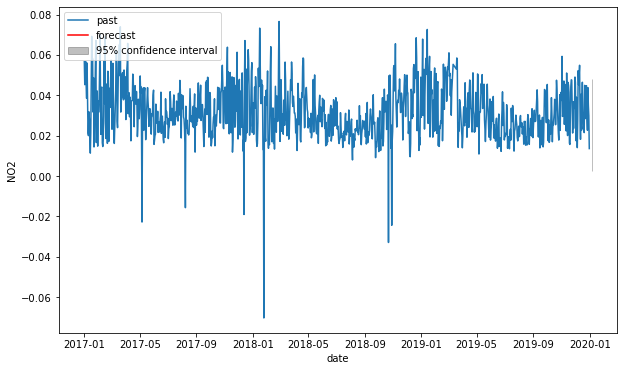

In [87]:
timeseries = df_102['NO2']
automodel = arimamodel(df_102['NO2'])
plotarima(1, timeseries, automodel)

In [88]:
best_model = sm.tsa.statespace.SARIMAX(df_102['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                3285.082
Date:                Wed, 20 Oct 2021   AIC                          -6560.164
Time:                        14:48:30   BIC                          -6535.217
Sample:                             0   HQIC                         -6550.720
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0030      0.001      2.049      0.040       0.000       0.006
ar.L1          0.9037      0.046     19.647      0.000       0.814       0.994
ma.L1         -0.4584      0.052     -8.820      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [89]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

Train RMSE: 0.012664950986851857
Test RMSE: 0.014194524001900998
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1602.015
Date:                Wed, 20 Oct 2021   AIC                          -3194.029
Time:                        14:48:30   BIC                          -3172.544
Sample:                    01-01-2017   HQIC                         -3185.628
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0334      0.001     38.048      0.000       0.032       0.035
ar.L1          0.5409      0.618      0.875      0.381   

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 103

In [90]:
df_103 = df[df['Station code'] == 103]

In [91]:
df_103.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,103,0.005042,0.039042,0.002500,1.112500,77.375000,73.125000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,103,0.006083,0.036417,0.013083,0.979167,105.458333,96.666667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,103,0.005375,0.035792,0.012625,0.791667,64.958333,54.375000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,103,0.005542,0.044167,0.006792,0.912500,49.208333,38.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,103,0.004292,0.029792,0.013417,0.633333,28.791667,23.083333,Good,Good,Good,Good,Good,Normal


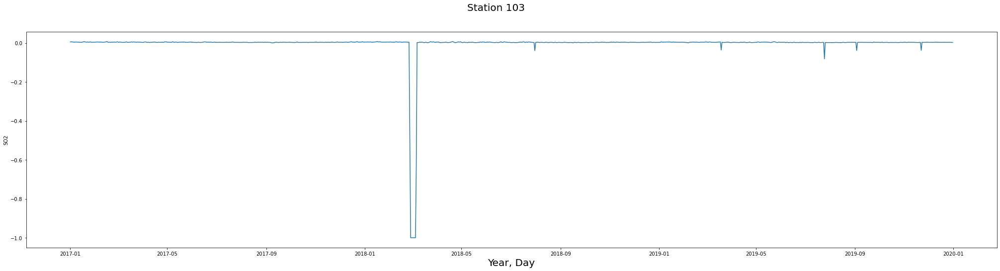

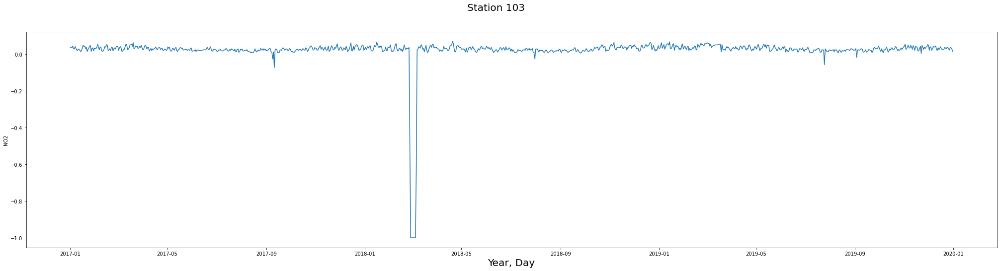

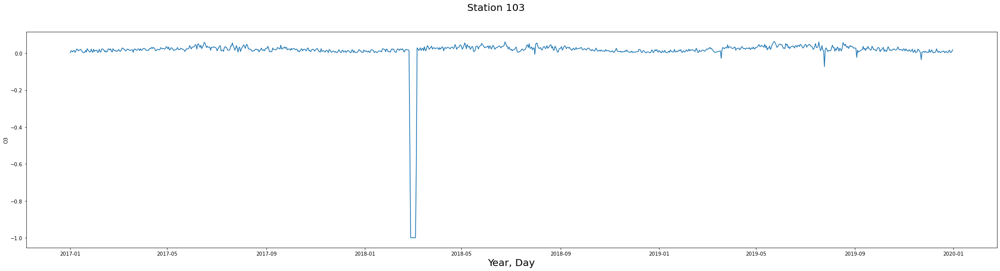

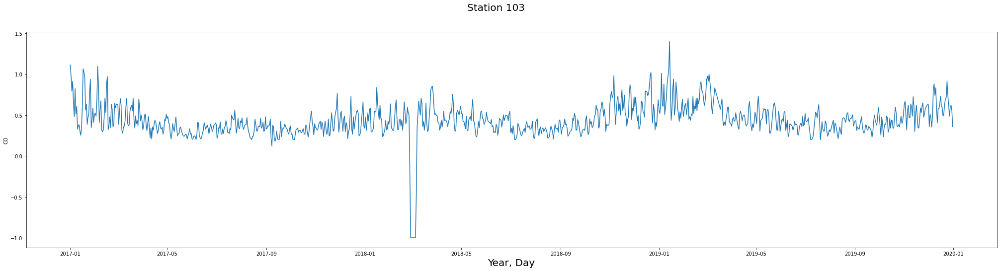

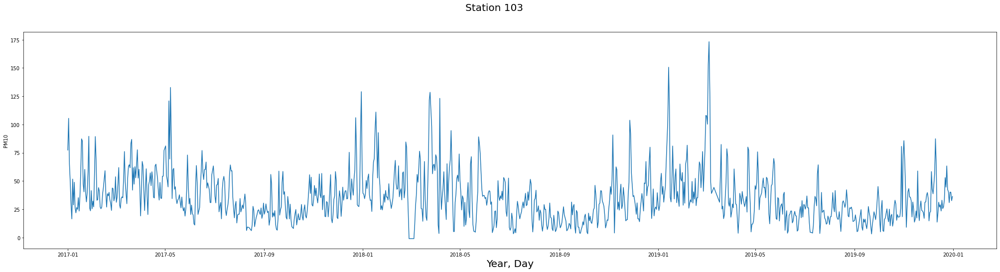

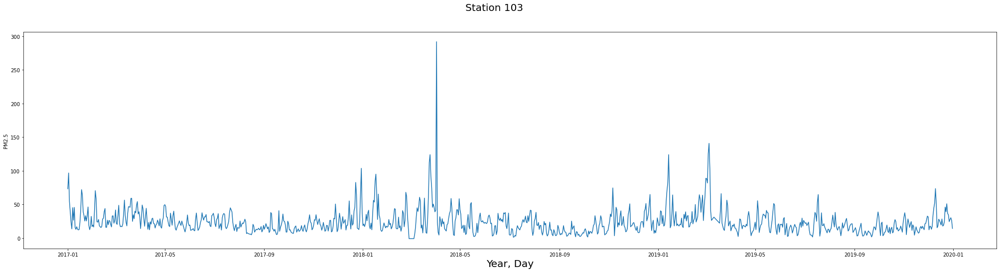

In [92]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 103", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_103)

In [93]:
df_103['NO2 Level'].value_counts()

Good      609
Normal    464
Bad        12
Name: NO2 Level, dtype: int64

In [94]:
df_103['PM10 Level'].value_counts()

Normal      531
Good        508
Bad          43
Very Bad      3
Name: PM10 Level, dtype: int64

In [95]:
df_103['PM2.5 Level'].value_counts()

Normal      547
Good        348
Bad         172
Very Bad     18
Name: PM2.5 Level, dtype: int64

##### For Station 103
- NO2 reaches levels of 'Bad' on 12 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 43 occasions and 'Very Bad' on 3, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 172 occasions and 'Very Bad' on 12 occasions.

# Picking the relevant columns

In [96]:
columns = ['NO2', 'PM10', 'PM2.5']
df_103 = df_103[columns]
df_103

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.039042,77.375000,73.125000
2017-01-02,0.036417,105.458333,96.666667
2017-01-03,0.035792,64.958333,54.375000
2017-01-04,0.044167,49.208333,38.583333
2017-01-05,0.029792,28.791667,23.083333
...,...,...,...
2019-12-27,0.023208,30.875000,24.291667
2019-12-28,0.037375,40.166667,27.583333
2019-12-29,0.034917,40.083333,30.125000


In [97]:
train = df_103[:-542]
test = df_103[542:]

<AxesSubplot:xlabel='Measurement date'>

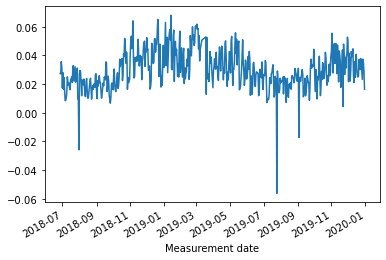

In [98]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

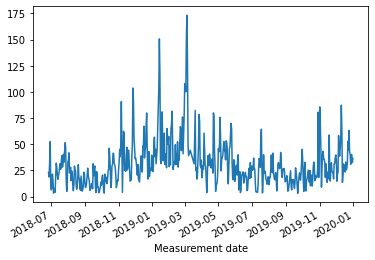

In [99]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

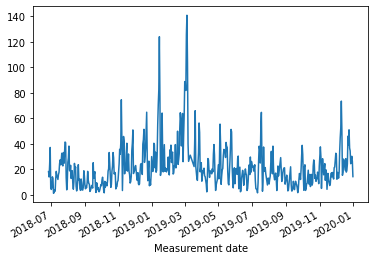

In [100]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

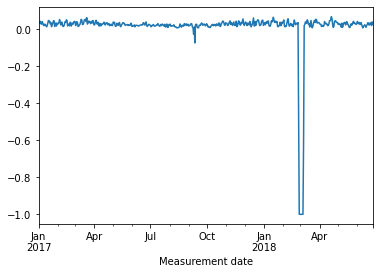

In [101]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

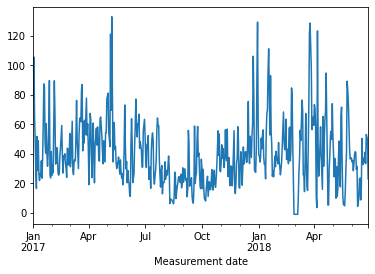

In [102]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

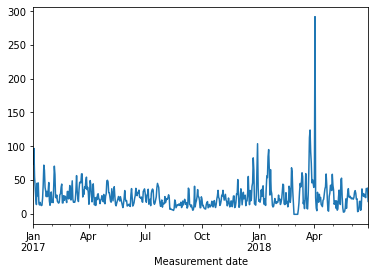

In [103]:
train['PM2.5'].plot()

In [104]:
print(stationarity_check(df_103['PM2.5']))
print(stationarity_check(df_103['PM10']))
print(stationarity_check(df_103['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.411134e+00
p-value                        7.129268e-11
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.548150e+00
p-value                        3.241951e-11
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.318872e+00
p-value                        3.101505e-08
#Lags Used                     1.600000e+01
Number of Observations Used    1.068000e+03
Critical Value (1%)           -3.436488e+00
Critical Value (5%)      

# Rolling Mean Difference Train

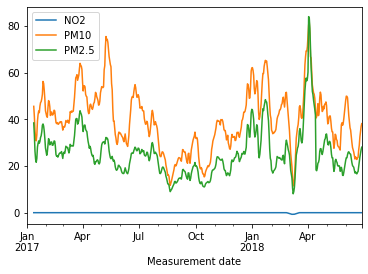

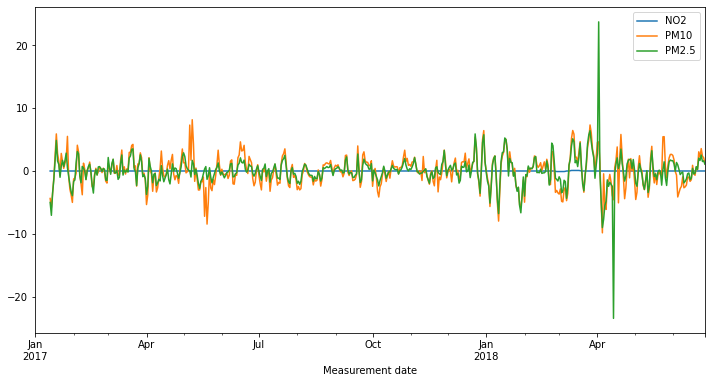

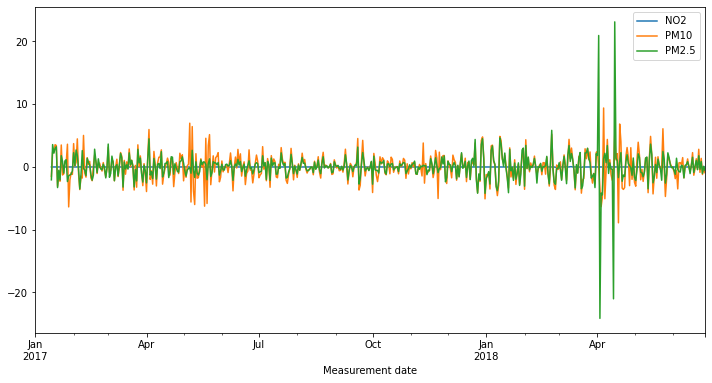

In [105]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [106]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.345997e+00
p-value                        3.084407e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.431747e+00
p-value                        6.334019e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.390587e+00
p-value                        8.020445e-11
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [107]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.027163e+01
p-value                        3.987534e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.049441e+01
p-value                        1.125250e-18
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.619943e+00
p-value                        6.143749e-14
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

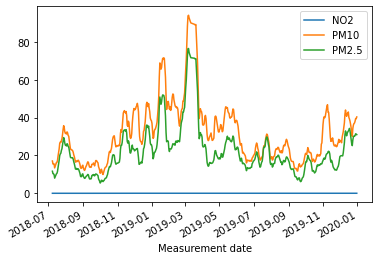

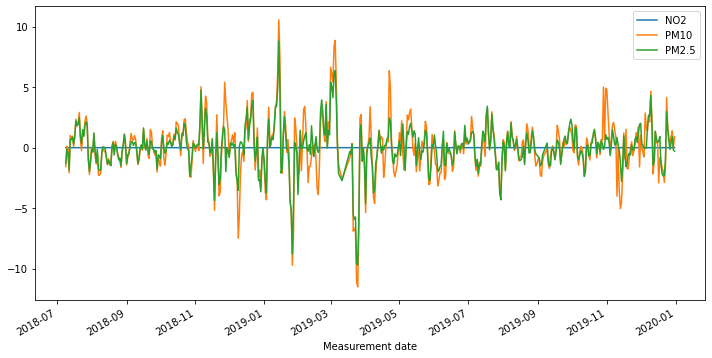

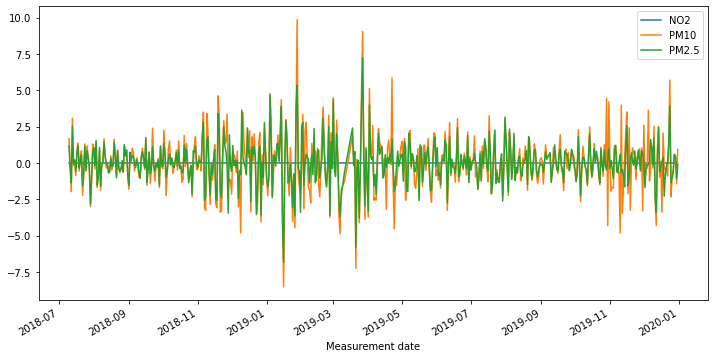

In [108]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [109]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.124007e+00
p-value                        8.717235e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.575190
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.852733e+00
p-value                        1.678151e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [110]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.673678e+00
p-value                        1.257247e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.160972e+01
p-value                        2.530270e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.036650e+01
p-value                        2.322966e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Station 103 PM10

In [111]:
base_model = sm.tsa.statespace.SARIMAX(df_103['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4912.484
Date:                Wed, 20 Oct 2021   AIC                           9828.967
Time:                        14:48:34   BIC                           9838.946
Sample:                             0   HQIC                          9832.745
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     35.5386      0.862     41.217      0.000      33.849      37.229
sigma2       501.3940     15.730     31.874      0.000     470.563     532.225
Ljung-Box (L1) (Q):                 529.51   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9231.692, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11192.077, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9233.873, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10220.762, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9229.247, Time=0.13 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9233.780, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9070.888, Time=0.23 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9183.380, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9070.354, Time=0.29 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=9162.959, Time=0.11 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=9072.266, Time=0.49 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9068.679, Time=0.36 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9070.472, Time=0.36 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=inf, Time=0.70 sec
 ARIMA(4,0,3)(0,0,0)[0]             

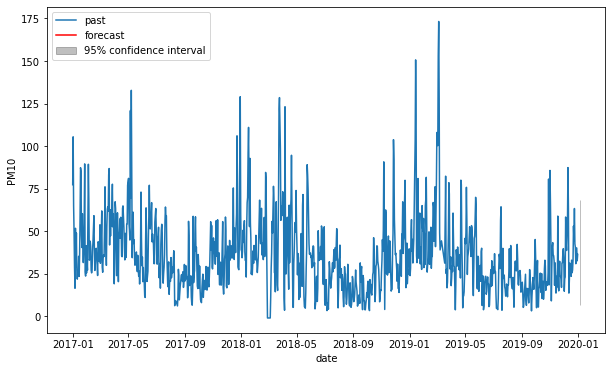

In [112]:
timeseries = df_103['PM10']
automodel = arimamodel(df_103['PM10'])
plotarima(1, timeseries, automodel)

In [113]:
best_model = sm.tsa.statespace.SARIMAX(df_103['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4524.984
Date:                Wed, 20 Oct 2021   AIC                           9061.969
Time:                        14:48:44   BIC                           9091.905
Sample:                             0   HQIC                          9073.301
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3957      0.266      1.486      0.137      -0.126       0.917
ar.L1          1.4025      0.047     29.628      0.000       1.310       1.495
ar.L2         -0.4136      0.043     -9.659      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [114]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 16.750687590611005
Test RMSE: 29.070477678727006
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2300.057
Date:                Wed, 20 Oct 2021   AIC                           4612.114
Time:                        14:48:44   BIC                           4637.896
Sample:                    01-01-2017   HQIC                          4622.195
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         40.0061      2.382     16.793      0.000      35.337      44.675
ar.L1         -0.3063      0.101     -3.036      0.002      -

# Station 103 PM2.5

In [115]:
base_model = sm.tsa.statespace.SARIMAX(df_103['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4718.790
Date:                Wed, 20 Oct 2021   AIC                           9441.580
Time:                        14:48:44   BIC                           9451.558
Sample:                             0   HQIC                          9445.357
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     23.6768      0.738     32.098      0.000      22.231      25.122
sigma2       350.8480      4.123     85.101      0.000     342.768     358.928
Ljung-Box (L1) (Q):                 383.76   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9092.030, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10475.397, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9123.435, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9759.316, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8960.822, Time=0.22 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9108.742, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8958.563, Time=0.21 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9075.323, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8960.321, Time=0.33 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.36 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8958.485, Time=0.19 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8987.659, Time=0.11 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8960.414, Time=0.36 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8960.444, Time=0.09 sec
 ARIMA(3,0,3)(0,0,0)[0]             :

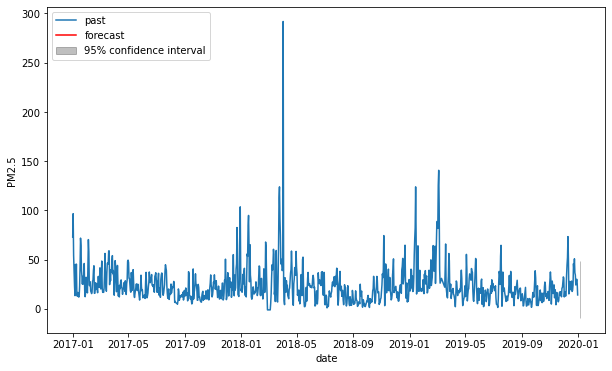

In [116]:
timeseries = df_103['PM2.5']
automodel = arimamodel(df_103['PM2.5'])
plotarima(1, timeseries, automodel)

In [117]:
best_model = sm.tsa.statespace.SARIMAX(df_103['PM2.5'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood               -4467.338
Date:                Wed, 20 Oct 2021   AIC                           8946.676
Time:                        14:48:52   BIC                           8976.612
Sample:                             0   HQIC                          8958.009
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.1994      0.635      1.890      0.059      -0.044       2.443
ar.L1          0.9500      0.025     37.626      0.000       0.901       0.999
ma.L1         -0.3639      0.032    -11.369      0.0

In [118]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])


/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.54750911911633
Test RMSE: 21.227807425953497
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2325.387
Date:                Wed, 20 Oct 2021   AIC                           4662.775
Time:                        14:48:52   BIC                           4688.557
Sample:                    01-01-2017   HQIC                          4672.856
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.1446      3.650      7.163      0.000      18.990      33.299
ar.L1          1.3018      0.168      7.754      0.000       0

# Station 103 NO2

In [119]:
base_model = sm.tsa.statespace.SARIMAX(df_103['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                1110.972
Date:                Wed, 20 Oct 2021   AIC                          -2217.945
Time:                        14:48:52   BIC                          -2207.966
Sample:                             0   HQIC                         -2214.167
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0219      0.014      1.588      0.112      -0.005       0.049
sigma2         0.0076      0.000     35.424      0.000       0.007       0.008
Ljung-Box (L1) (Q):                 928.70   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4538.639, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2153.401, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-4298.166, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3341.217, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4539.213, Time=0.24 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4514.076, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-4541.212, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-4524.763, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-4555.255, Time=0.42 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-4551.804, Time=0.04 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-4547.987, Time=0.39 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-4553.209, Time=0.52 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-4537.018, Time=0.47 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-4550.683, Time=0.14 sec
 ARIMA(5,0,2)(0,0,0

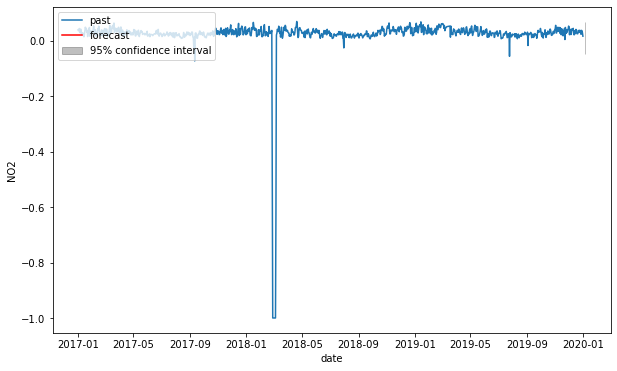

In [120]:
timeseries = df_103['NO2']
automodel = arimamodel(df_103['NO2'])
plotarima(1, timeseries, automodel)

In [121]:
best_model = sm.tsa.statespace.SARIMAX(df_103['NO2'], trend='c', order=[4,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packa

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(4, 0, 2)   Log Likelihood                2281.700
Date:                Wed, 20 Oct 2021   AIC                          -4547.401
Time:                        14:48:57   BIC                          -4507.486
Sample:                             0   HQIC                         -4532.290
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0069      0.004      1.667      0.096      -0.001       0.015
ar.L1          0.4777      0.075      6.341      0.000       0.330       0.625
ar.L2          0.0697      0.086      0.813      0.4

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [122]:
model_train = arima_results(train['NO2'],test['NO2'], order=[4,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.03873285618580366
Test RMSE: 0.11640928285061776
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(4, 0, 2)   Log Likelihood                 993.655
Date:                Wed, 20 Oct 2021   AIC                          -1971.310
Time:                        14:48:58   BIC                          -1936.933
Sample:                    01-01-2017   HQIC                         -1957.868
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0143      0.036      0.402      0.688      -0.056       0.084
ar.L1          0.7515      0.078      9.625      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 104

In [123]:
df_104 = df[df['Station code'] == 104]

In [124]:
df_104.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,104,0.005958,0.041708,0.005458,0.708333,70.291667,45.541667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,104,0.006500,0.037333,0.019750,0.520833,102.416667,73.458333,Good,Normal,Good,Good,Bad,Bad
2017-01-03,104,0.005333,0.038292,0.016167,0.262500,73.625000,46.875000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,104,0.004750,0.033625,0.006375,0.537500,46.333333,29.041667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,104,0.003917,0.014083,0.008833,0.625000,32.083333,20.041667,Good,Good,Good,Good,Normal,Normal


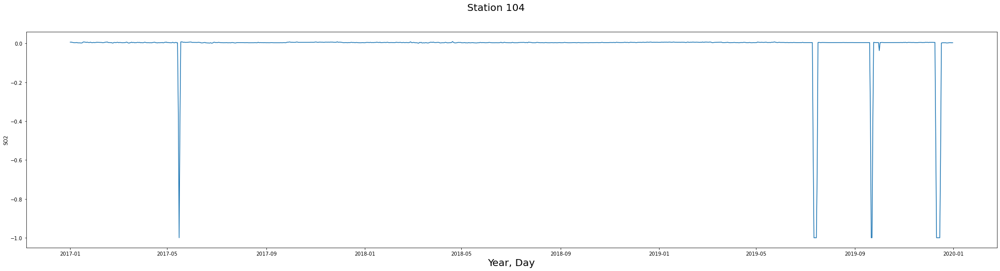

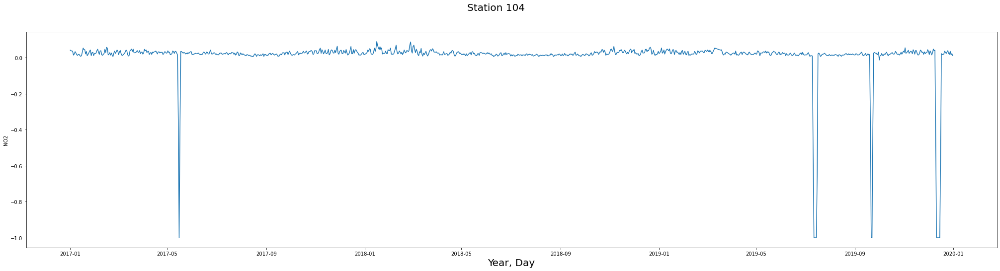

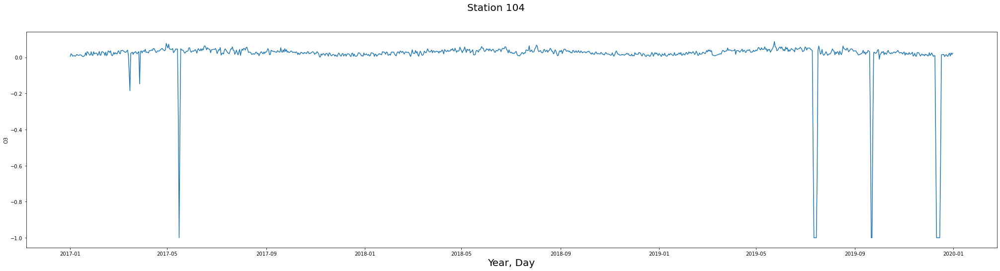

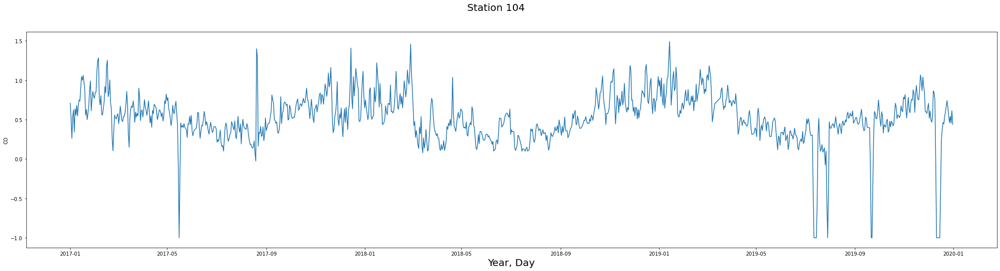

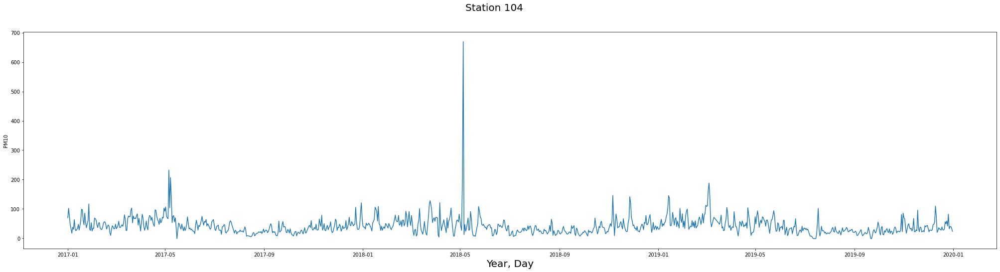

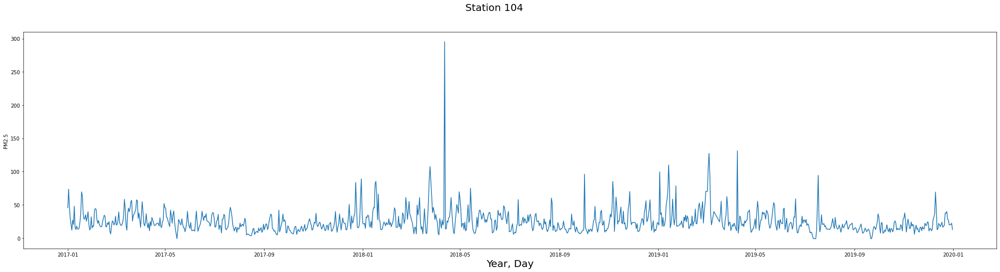

In [125]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 104", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_104)

In [126]:
df_104['NO2 Level'].value_counts()

Good      791
Normal    283
Bad        11
Name: NO2 Level, dtype: int64

In [127]:
df_104['PM10 Level'].value_counts()

Normal      608
Good        402
Bad          69
Very Bad      5
Name: PM10 Level, dtype: int64

In [128]:
df_104['PM2.5 Level'].value_counts()

Normal      576
Good        307
Bad         183
Very Bad     19
Name: PM2.5 Level, dtype: int64

##### For Station 104
- NO2 reaches levels of 'Bad' on 11 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 69 occasions and 'Very Bad' on 5, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 183 occasions and 'Very Bad' on 19 occasions.


# Picking the relevant columns

In [129]:
columns = ['NO2', 'PM10', 'PM2.5']
df_104 = df_104[columns]
df_104

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.041708,70.291667,45.541667
2017-01-02,0.037333,102.416667,73.458333
2017-01-03,0.038292,73.625000,46.875000
2017-01-04,0.033625,46.333333,29.041667
2017-01-05,0.014083,32.083333,20.041667
...,...,...,...
2019-12-27,0.018250,32.583333,19.541667
2019-12-28,0.035458,40.250000,19.958333
2019-12-29,0.015167,40.083333,20.166667


# Train-Test Split

In [130]:
train = df_104[:-542]
test = df_104[542:]

<AxesSubplot:xlabel='Measurement date'>

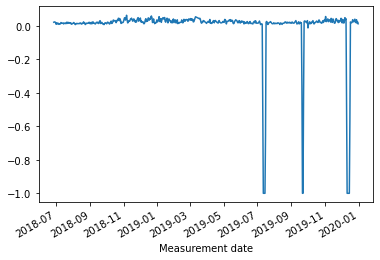

In [131]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

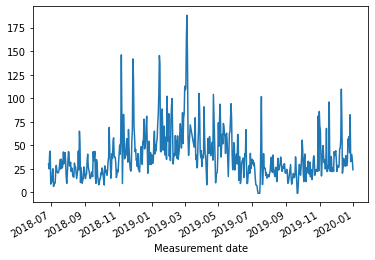

In [132]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

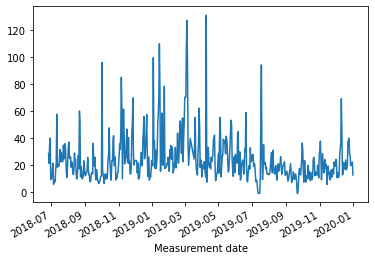

In [133]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

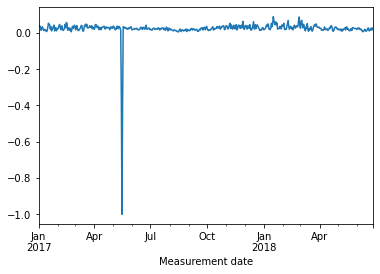

In [134]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

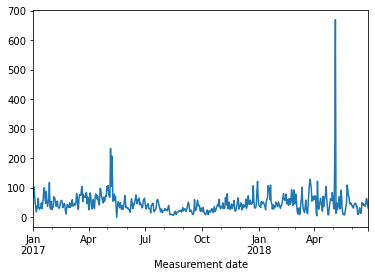

In [135]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

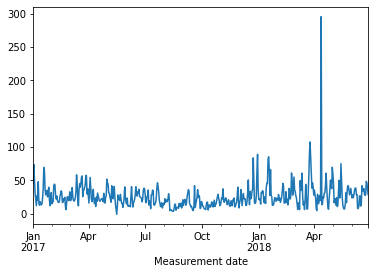

In [136]:
train['PM2.5'].plot()

In [137]:
print(stationarity_check(df_104['PM2.5']))
print(stationarity_check(df_104['PM10']))
print(stationarity_check(df_104['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -1.400838e+01
p-value                        3.752268e-26
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.885145e+00
p-value                        1.400796e-09
#Lags Used                     8.000000e+00
Number of Observations Used    1.076000e+03
Critical Value (1%)           -3.436442e+00
Critical Value (5%)           -2.864230e+00
Critical Value (10%)          -2.568202e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.629552e+00
p-value                        1.626033e-16
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)      

# Rolling Mean Difference Train

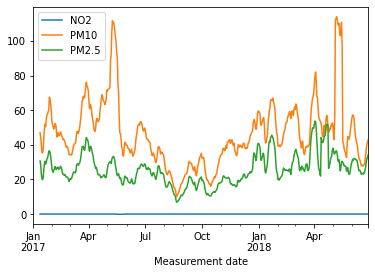

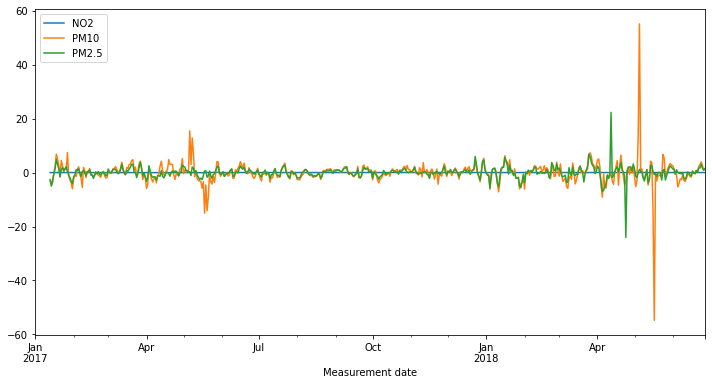

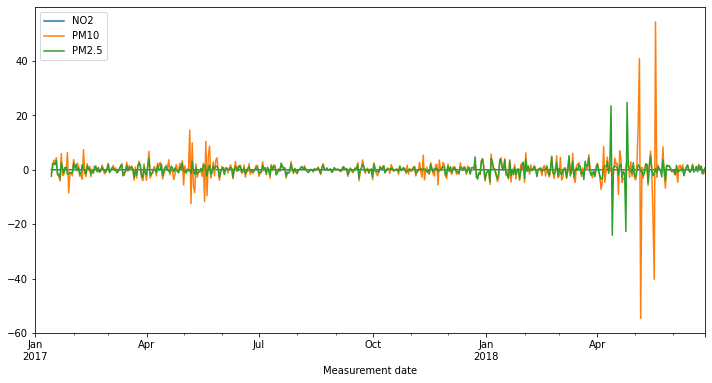

In [138]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = train.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [139]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                  -5.504779
p-value                          0.000002
#Lags Used                      17.000000
Number of Observations Used    513.000000
Critical Value (1%)             -3.443162
Critical Value (5%)             -2.867190
Critical Value (10%)            -2.569780
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.528517e+00
p-value                        2.933312e-16
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.565407e+00
p-value                        2.934753e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [140]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.223571e+01
p-value                        1.029336e-22
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.079593e+01
p-value                        2.075629e-19
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.782352e+00
p-value                        6.681332e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Train

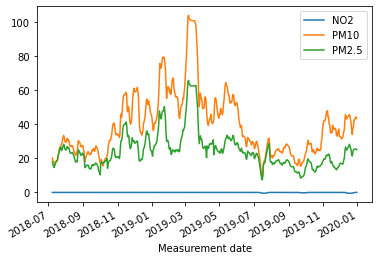

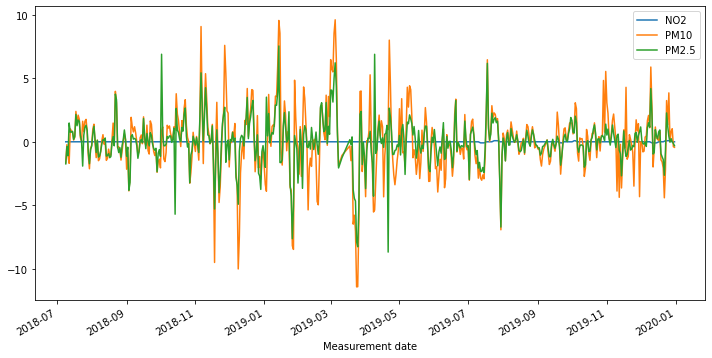

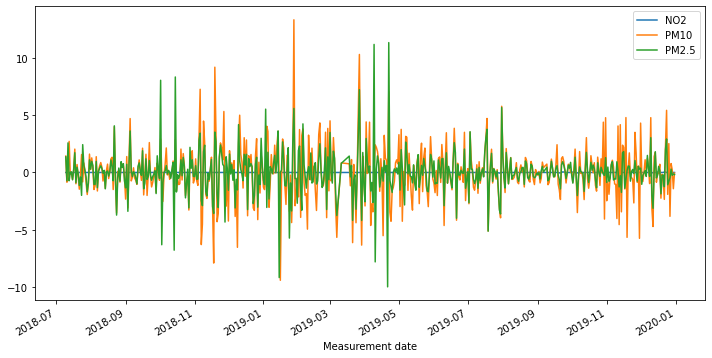

In [141]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = test.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [142]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.645853e+00
p-value                        1.843578e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.817129e+00
p-value                        4.266569e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.532628e+00
p-value                        9.783572e-09
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [143]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.690993e+00
p-value                        1.136635e-16
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.032529e+01
p-value                        2.936650e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.405230e+00
p-value                        2.176707e-13
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 104 PM10

In [144]:
base_model = sm.tsa.statespace.SARIMAX(df_104['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5308.444
Date:                Wed, 20 Oct 2021   AIC                          10620.887
Time:                        14:49:02   BIC                          10630.866
Sample:                             0   HQIC                         10624.665
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     42.3415      1.315     32.211      0.000      39.765      44.918
sigma2      1040.3084      7.303    142.449      0.000    1025.995    1054.622
Ljung-Box (L1) (Q):                 254.83   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10400.684, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11705.904, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10548.150, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11084.325, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10296.478, Time=0.19 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=10495.992, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10297.306, Time=0.23 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10297.144, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10302.740, Time=0.14 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10441.045, Time=0.04 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10298.923, Time=0.43 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=10290.198, Time=0.41 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10330.414, Time=0.13 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=10332.634, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0

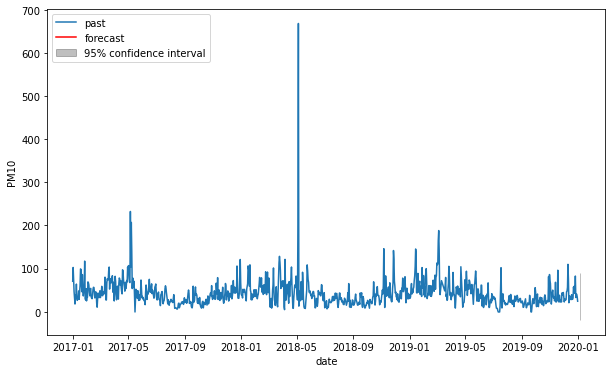

In [145]:
timeseries = df_104['PM10']
automodel = arimamodel(df_104['PM10'])
plotarima(1, timeseries, automodel)

In [146]:
best_model = sm.tsa.statespace.SARIMAX(df_104['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -5140.099
Date:                Wed, 20 Oct 2021   AIC                          10290.198
Time:                        14:49:07   BIC                          10315.145
Sample:                             0   HQIC                         10299.642
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5448      0.507      1.074      0.283      -0.449       1.539
ar.L1          1.3337      0.033     40.828      0.000       1.270       1.398
ar.L2         -0.3468      0.023    -15.063      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [147]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 34.36782712545945
Test RMSE: 33.00942447490371
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2691.241
Date:                Wed, 20 Oct 2021   AIC                           5392.481
Time:                        14:49:07   BIC                           5413.967
Sample:                    01-01-2017   HQIC                          5400.882
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.3364     10.478      4.422      0.000      25.800      66.872
ar.L1          1.2789      0.065     19.758      0.000       1.

# Station 104 PM2.5

In [148]:
base_model = sm.tsa.statespace.SARIMAX(df_104['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4670.783
Date:                Wed, 20 Oct 2021   AIC                           9345.566
Time:                        14:49:07   BIC                           9355.545
Sample:                             0   HQIC                          9349.344
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.9032      0.706     35.271      0.000      23.519      26.287
sigma2       321.1350      3.467     92.619      0.000     314.339     327.931
Ljung-Box (L1) (Q):                 220.48   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9213.809, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10510.379, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9342.470, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9889.253, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9085.396, Time=0.23 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9288.021, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9087.052, Time=0.20 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9087.009, Time=0.23 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9097.682, Time=0.13 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9239.360, Time=0.06 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9089.085, Time=0.28 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9086.131, Time=0.44 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 1.777 seconds


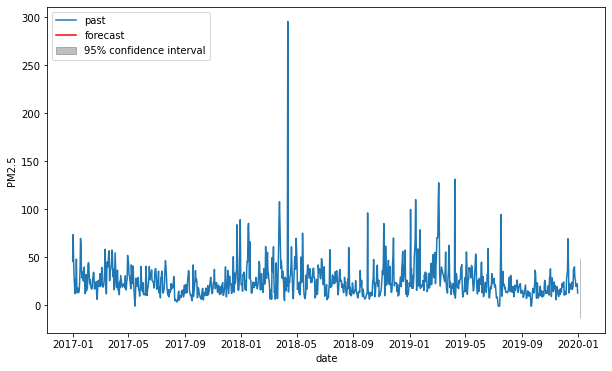

In [149]:
timeseries = df_104['PM2.5']
automodel = arimamodel(df_104['PM2.5'])
plotarima(1, timeseries, automodel)

In [150]:
best_model = sm.tsa.statespace.SARIMAX(df_104['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4538.065
Date:                Wed, 20 Oct 2021   AIC                           9086.131
Time:                        14:49:09   BIC                           9111.078
Sample:                             0   HQIC                          9095.575
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7807      0.597      1.308      0.191      -0.389       1.951
ar.L1          1.3201      0.048     27.590      0.000       1.226       1.414
ar.L2         -0.3525      0.026    -13.551      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [151]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.34375622135541
Test RMSE: 19.07776514700495
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2319.767
Date:                Wed, 20 Oct 2021   AIC                           4651.535
Time:                        14:49:09   BIC                           4677.317
Sample:                    01-01-2017   HQIC                          4661.616
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.9980      2.169     11.987      0.000      21.747      30.249
ar.L1          0.1034      1.505      0.069      0.945      -2.

# Station 104 PM NO2

In [152]:
base_model = sm.tsa.statespace.SARIMAX(df_104['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 799.222
Date:                Wed, 20 Oct 2021   AIC                          -1594.444
Time:                        14:49:10   BIC                          -1584.466
Sample:                             0   HQIC                         -1590.667
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0098      0.017      0.587      0.557      -0.023       0.043
sigma2         0.0134      0.000     28.022      0.000       0.012       0.014
Ljung-Box (L1) (Q):                 779.96   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3350.962, Time=0.13 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1588.650, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-2961.825, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2715.432, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3355.378, Time=0.29 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3234.010, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3353.498, Time=0.24 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3354.193, Time=0.30 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-3355.694, Time=0.13 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-3150.691, Time=0.15 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-3353.755, Time=0.25 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-3291.403, Time=0.14 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-3353.037, Time=0.39 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3354.981, Time=0.19 sec

Best model:  ARIMA

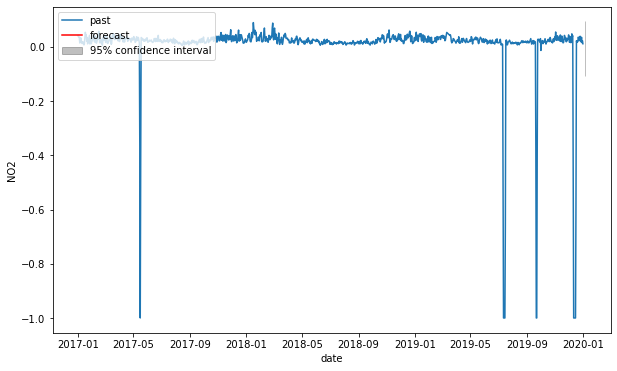

In [153]:
timeseries = df_104['NO2']
automodel = arimamodel(df_104['NO2'])
plotarima(1, timeseries, automodel)

In [154]:
best_model = sm.tsa.statespace.SARIMAX(df_104['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                1682.490
Date:                Wed, 20 Oct 2021   AIC                          -3354.981
Time:                        14:49:12   BIC                          -3330.034
Sample:                             0   HQIC                         -3345.537
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0033      0.006      0.587      0.557      -0.008       0.015
ar.L1          0.6603      0.012     53.450      0.000       0.636       0.684
ma.L1          0.7802      0.011     68.206      0.0

In [155]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.036924614621430416
Test RMSE: 0.16067075439030037
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1020.360
Date:                Wed, 20 Oct 2021   AIC                          -2030.720
Time:                        14:49:13   BIC                          -2009.234
Sample:                    01-01-2017   HQIC                         -2022.319
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0231      0.009      2.625      0.009       0.006       0.040
ar.L1          0.0165      0.144      0.115      0.909    

# Station 105

In [156]:
df_105 = df[df['Station code'] == 105]

In [157]:
df_105.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,105,0.005250,0.038500,0.007625,0.783333,91.291667,49.541667,Good,Normal,Good,Good,Bad,Bad
2017-01-02,105,0.005625,0.032708,0.020208,0.741667,126.333333,64.291667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,105,0.006250,0.033292,0.016417,0.683333,90.291667,40.166667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,105,0.006000,0.040000,0.013167,0.783333,60.458333,32.166667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,105,0.005292,0.025917,0.021042,0.591667,27.333333,17.541667,Good,Good,Good,Good,Good,Normal


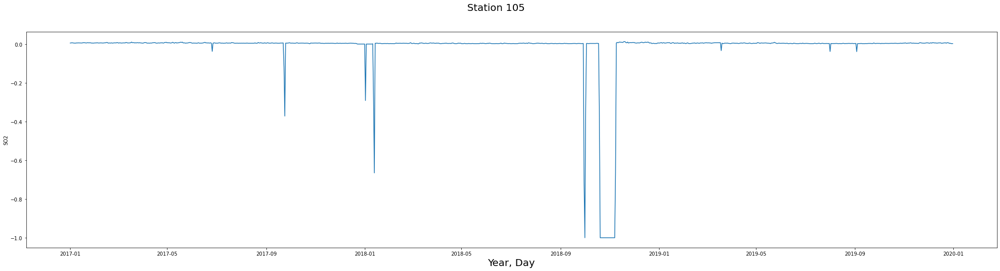

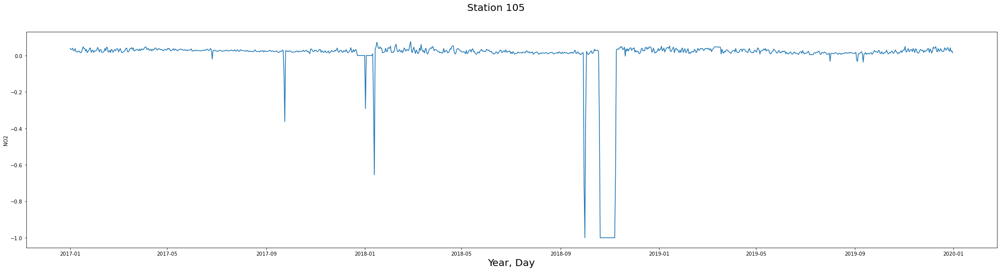

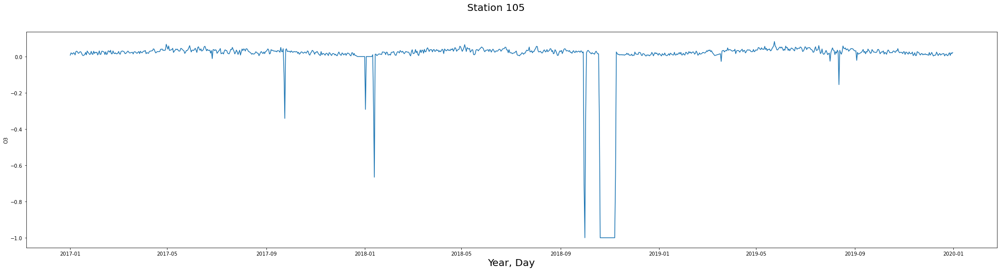

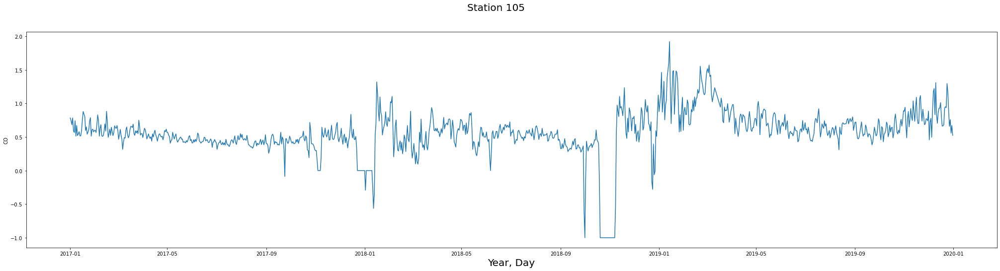

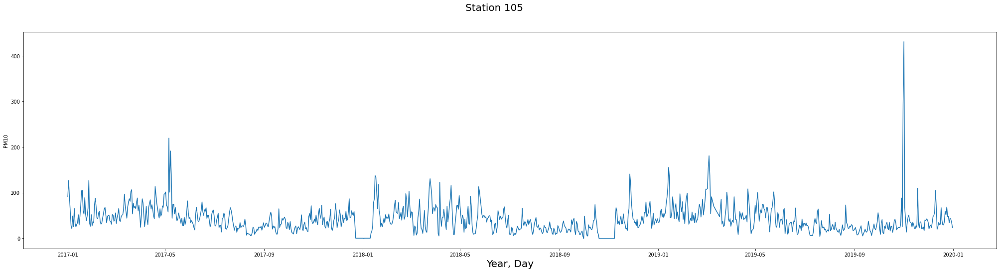

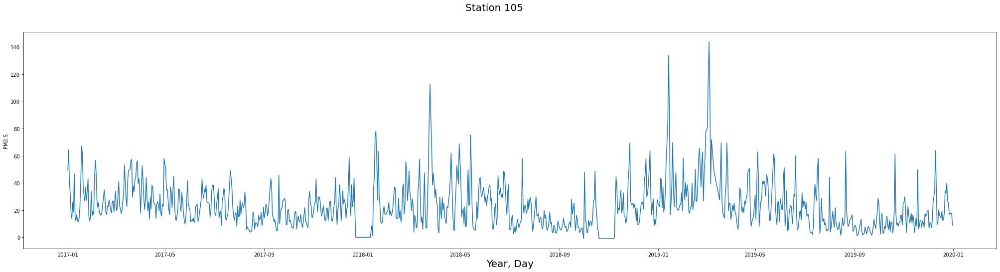

In [158]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 105", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_105)

In [159]:
df_105['NO2 Level'].value_counts()

Good      804
Normal    277
Bad         4
Name: NO2 Level, dtype: int64

In [160]:
df_105['PM10 Level'].value_counts()

Normal      586
Good        415
Bad          77
Very Bad      7
Name: PM10 Level, dtype: int64

In [161]:
df_105['PM2.5 Level'].value_counts()

Normal      489
Good        396
Bad         186
Very Bad     14
Name: PM2.5 Level, dtype: int64

##### For Station 105
- NO2 reaches levels of 'Bad' on 4 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 77 occasions and 'Very Bad' on 7, and can get close to bad on many occasions.
- Lastly, PM2.5 reaches levels of 'Bad' on 186 occasions and 'Very Bad' on 14 occasions.

# Picking the relevant columns

In [162]:
columns = ['NO2', 'PM10', 'PM2.5']
df_105 = df_105[columns]
df_105

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.038500,91.291667,49.541667
2017-01-02,0.032708,126.333333,64.291667
2017-01-03,0.033292,90.291667,40.166667
2017-01-04,0.040000,60.458333,32.166667
2017-01-05,0.025917,27.333333,17.541667
...,...,...,...
2019-12-27,0.023375,33.666667,16.875000
2019-12-28,0.042125,43.916667,17.708333
2019-12-29,0.022042,41.250000,17.041667


# Train-Test Split

In [163]:
train = df_105[:-542]
test = df_105[542:]

<AxesSubplot:xlabel='Measurement date'>

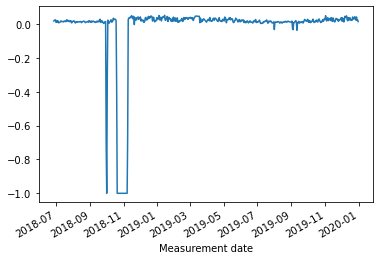

In [164]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

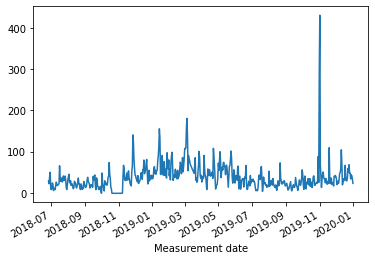

In [165]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

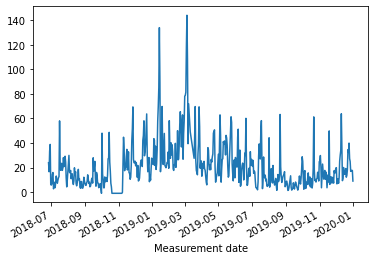

In [166]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

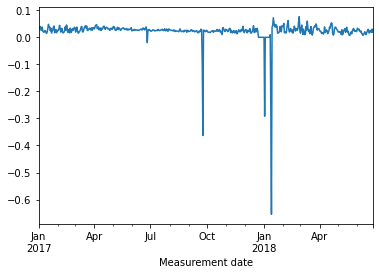

In [167]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

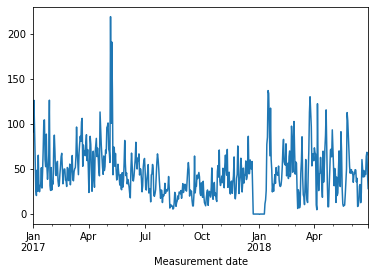

In [168]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

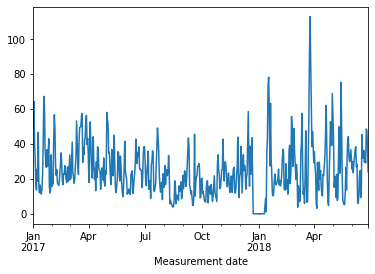

In [169]:
train['PM2.5'].plot()

In [170]:
print(stationarity_check(df_105['PM2.5']))
print(stationarity_check(df_105['PM10']))
print(stationarity_check(df_105['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.652613e+00
p-value                        1.772840e-11
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.814345e+00
p-value                        6.934146e-12
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.927806
p-value                           0.000031
#Lags Used                       20.000000
Number of Observations Used    1064.000000
Critical Value (1%)              -3.436511
Critical Value (5%)           

# Rolling Mean Difference Train

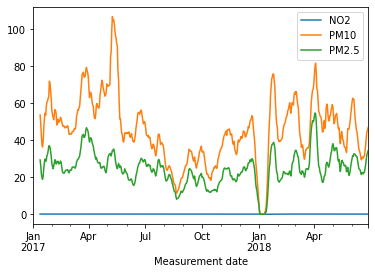

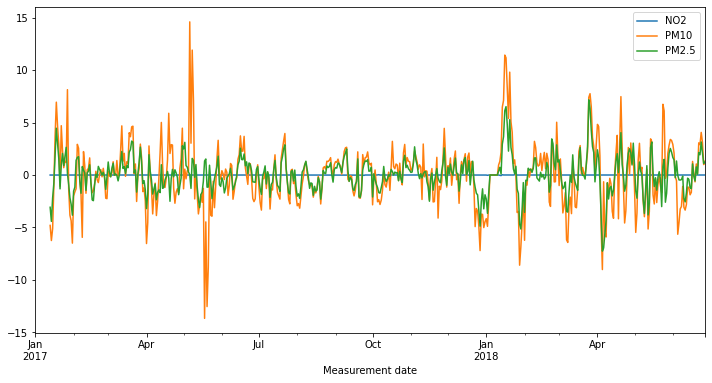

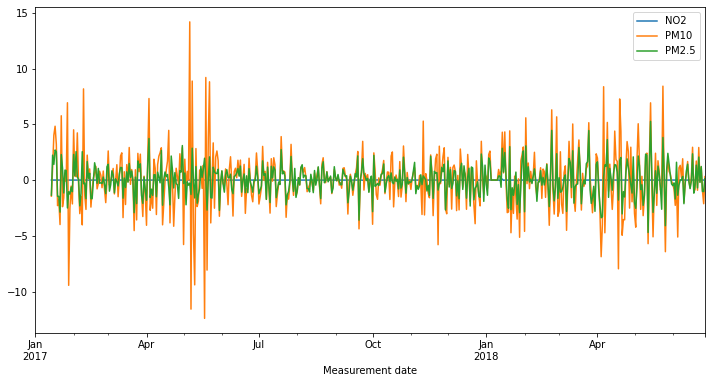

In [171]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [172]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.387981e+00
p-value                        8.141118e-11
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.265591e+00
p-value                        4.948491e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.675165e+00
p-value                        1.555790e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [173]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.013643e+01
p-value                        8.645008e-18
#Lags Used                     1.400000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.006366e+01
p-value                        1.313370e-17
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.133648e+00
p-value                        2.975578e-15
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

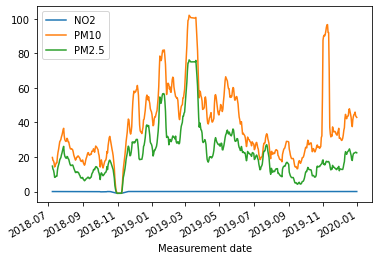

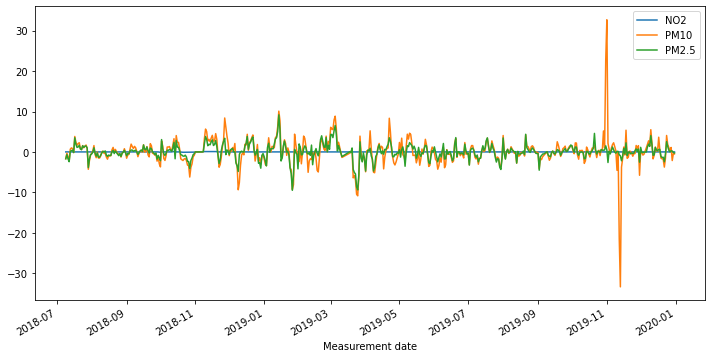

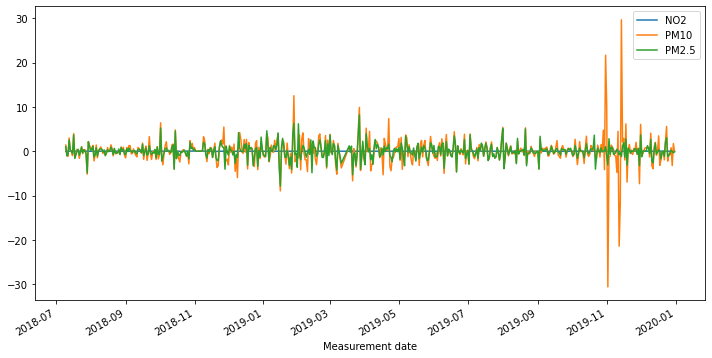

In [174]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [175]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -5.902127e+00
p-value                        2.762231e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.113366e+00
p-value                        9.218333e-08
#Lags Used                     1.700000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.617222
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.

In [176]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.724324e+00
p-value                        9.361900e-17
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.138614e+01
p-value                        8.281109e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.810005e+00
p-value                        2.003216e-14
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

# Station 105 PM2.5

In [177]:
base_model = sm.tsa.statespace.SARIMAX(df_105['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4619.998
Date:                Wed, 20 Oct 2021   AIC                           9243.997
Time:                        14:49:16   BIC                           9253.976
Sample:                             0   HQIC                          9247.774
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.8773      0.664     34.430      0.000      21.575      24.180
sigma2       292.4369      7.918     36.932      0.000     276.918     307.956
Ljung-Box (L1) (Q):                 552.87   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8581.175, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10355.129, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8582.925, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9441.970, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8581.531, Time=0.12 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8494.731, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9083.446, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8447.126, Time=0.20 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8447.451, Time=0.34 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8446.270, Time=0.34 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8465.823, Time=0.15 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=8449.362, Time=0.46 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=8450.556, Time=0.49 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=8458.000, Time=0.25 sec
 ARIMA(3,0,4)(0,0,0)[0]         

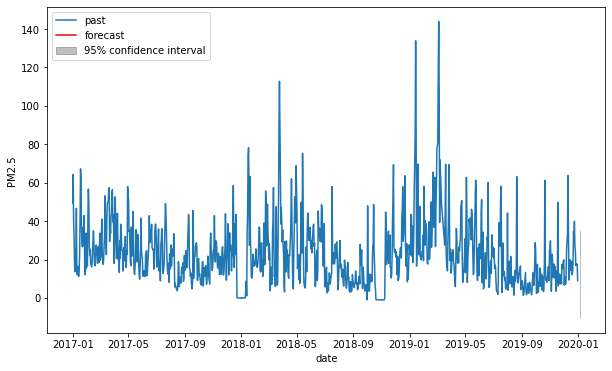

In [178]:
timeseries = df_105['PM2.5']
automodel = arimamodel(df_105['PM2.5'])
plotarima(1, timeseries, automodel)

In [179]:
best_model = sm.tsa.statespace.SARIMAX(df_105['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4214.570
Date:                Wed, 20 Oct 2021   AIC                           8441.140
Time:                        14:49:24   BIC                           8471.076
Sample:                             0   HQIC                          8452.473
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2040      0.147      1.387      0.165      -0.084       0.492
ar.L1          1.4646      0.049     29.722      0.000       1.368       1.561
ar.L2         -0.4734      0.045    -10.422      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [180]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.771127885881748
Test RMSE: 22.677321025019026
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2060.157
Date:                Wed, 20 Oct 2021   AIC                           4132.314
Time:                        14:49:25   BIC                           4158.097
Sample:                    01-01-2017   HQIC                          4142.395
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.4403      2.887      8.812      0.000      19.782      31.099
ar.L1          1.5224      0.064     23.938      0.000       

# Station 105 PM10

In [181]:
base_model = sm.tsa.statespace.SARIMAX(df_105['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5247.565
Date:                Wed, 20 Oct 2021   AIC                          10499.131
Time:                        14:49:25   BIC                          10509.109
Sample:                             0   HQIC                         10502.908
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     41.4613      1.154     35.931      0.000      39.200      43.723
sigma2       929.8790     12.446     74.715      0.000     905.486     954.272
Ljung-Box (L1) (Q):                 467.04   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10006.314, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11632.966, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10027.143, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10763.862, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10021.153, Time=0.12 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9888.246, Time=0.11 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10502.808, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9864.843, Time=0.19 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9856.305, Time=0.24 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9868.836, Time=0.23 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9863.682, Time=0.59 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9858.144, Time=0.47 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9859.202, Time=0.39 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9861.810, Time=0.33 sec
 ARIMA(4,0,3)(0,0,0)[0]    

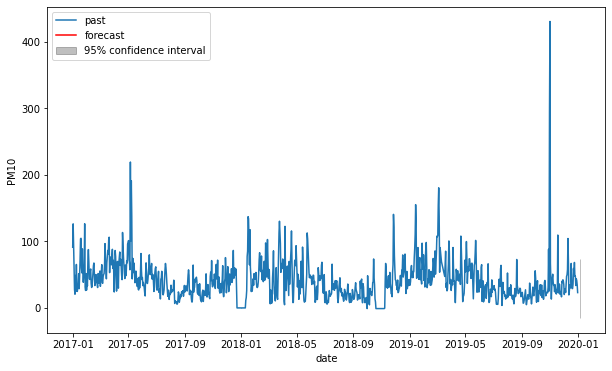

In [182]:
timeseries = df_105['PM10']
automodel = arimamodel(df_105['PM10'])
plotarima(1, timeseries, automodel)

In [183]:
best_model = sm.tsa.statespace.SARIMAX(df_105['PM10'], trend='c', order=[3,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -4918.162
Date:                Wed, 20 Oct 2021   AIC                           9850.324
Time:                        14:49:34   BIC                           9885.250
Sample:                             0   HQIC                          9863.546
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7647      0.526      1.453      0.146      -0.267       1.796
ar.L1          0.8290      0.110      7.514      0.000       0.613       1.045
ar.L2          0.4617      0.172      2.691      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [184]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 20.431646329199054
Test RMSE: 41.10056942082306
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -2407.886
Date:                Wed, 20 Oct 2021   AIC                           4829.772
Time:                        14:49:34   BIC                           4859.852
Sample:                    01-01-2017   HQIC                          4841.534
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.2624      6.786      6.818      0.000      32.963      59.562
ar.L1          0.6155      0.067      9.164      0.000       0

# Station 105 NO2 

In [185]:
base_model = sm.tsa.statespace.SARIMAX(df_105['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 560.136
Date:                Wed, 20 Oct 2021   AIC                          -1116.271
Time:                        14:49:34   BIC                          -1106.293
Sample:                             0   HQIC                         -1112.494
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0012      0.027      0.044      0.965      -0.052       0.054
sigma2         0.0209      0.001     17.543      0.000       0.019       0.023
Ljung-Box (L1) (Q):                 924.75   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3217.813, Time=0.16 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1118.196, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3172.819, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2206.824, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3232.063, Time=0.24 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3198.292, Time=0.12 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3247.573, Time=0.39 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3249.182, Time=0.09 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-3247.508, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-3245.805, Time=0.30 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=-3247.189, Time=0.10 sec

Best model:  ARIMA(3,0,0)(0,0,0)[0]          
Total fit time: 1.612 seconds


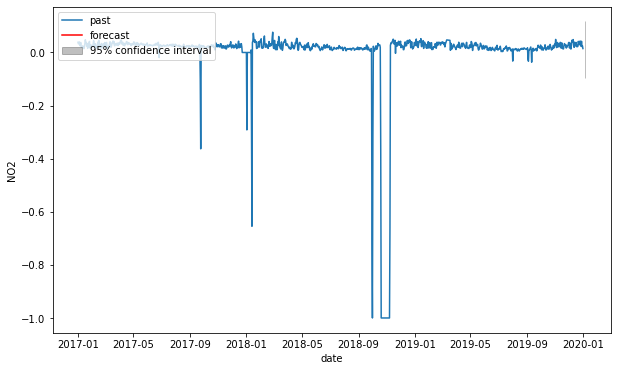

In [186]:
timeseries = df_105['NO2']
automodel = arimamodel(df_105['NO2'])
plotarima(1, timeseries, automodel)

In [187]:
best_model = sm.tsa.statespace.SARIMAX(df_105['NO2'], trend='c', order=[3,0,0])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 0)   Log Likelihood                1628.595
Date:                Wed, 20 Oct 2021   AIC                          -3247.189
Time:                        14:49:36   BIC                          -3222.242
Sample:                             0   HQIC                         -3237.745
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0001      0.003      0.041      0.967      -0.006       0.006
ar.L1          1.1019      0.009    126.793      0.000       1.085       1.119
ar.L2         -0.3904      0.012    -33.819      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [188]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,0])

Train RMSE: 0.03758851283499046
Test RMSE: 0.20348702716986444
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 0)   Log Likelihood                1011.070
Date:                Wed, 20 Oct 2021   AIC                          -2012.140
Time:                        14:49:36   BIC                          -1990.654
Sample:                    01-01-2017   HQIC                         -2003.739
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0227      0.006      3.922      0.000       0.011       0.034
ar.L1          0.3729      0.013     29.331      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 106

In [189]:
df_106 = df[df['Station code'] == 106]

In [190]:
df_106.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,106,0.004792,0.054917,0.004083,1.162500,76.083333,68.000000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,106,0.005167,0.045500,0.014500,1.070833,103.333333,91.041667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,106,0.005083,0.048125,0.012458,0.900000,66.375000,54.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,106,0.005125,0.058458,0.009000,1.041667,49.125000,39.500000,Good,Normal,Good,Good,Normal,Bad
2017-01-05,106,0.003917,0.041875,0.011000,0.750000,31.750000,24.250000,Good,Normal,Good,Good,Normal,Normal


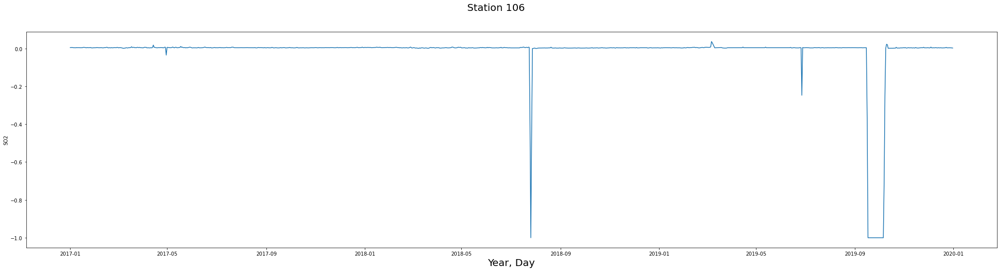

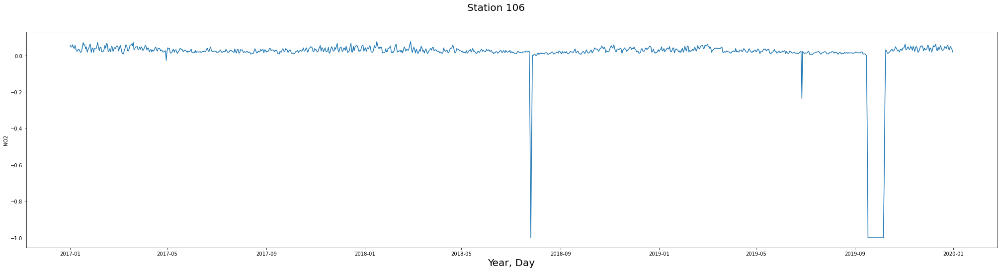

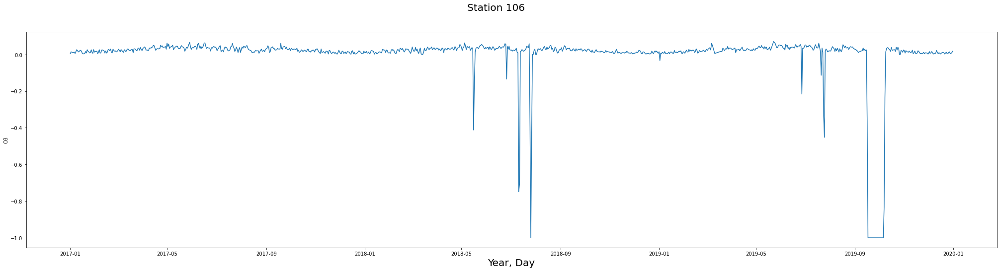

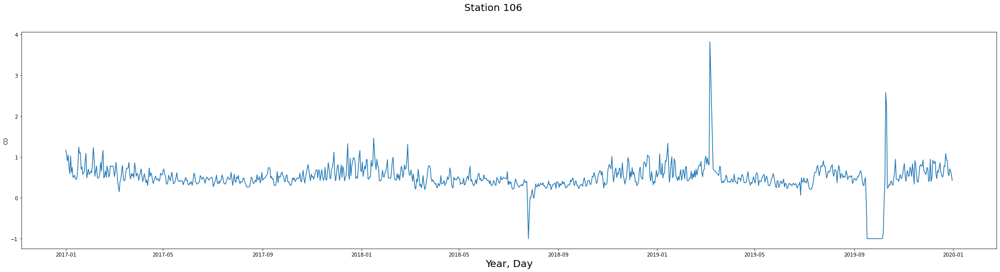

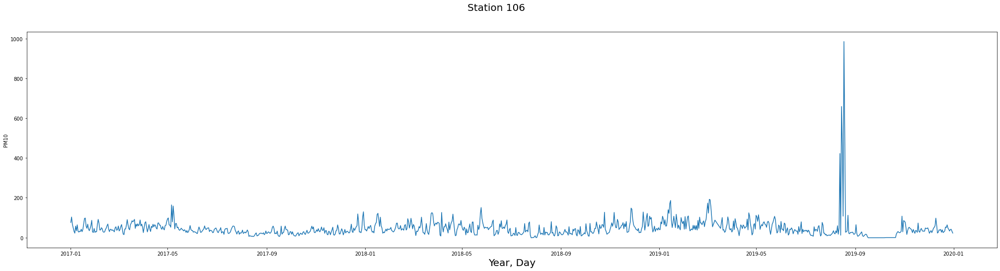

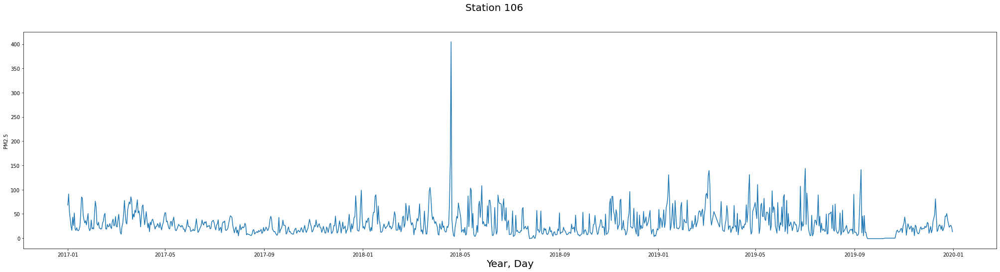

In [191]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 106", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_106)

In [192]:
df_106['NO2 Level'].value_counts()

Good      698
Normal    372
Bad        15
Name: NO2 Level, dtype: int64

In [193]:
df_106['PM10 Level'].value_counts()

Normal      585
Good        386
Bad         100
Very Bad     12
Name: PM10 Level, dtype: int64

In [194]:
df_106['PM2.5 Level'].value_counts()

Normal      499
Good        276
Bad         250
Very Bad     60
Name: PM2.5 Level, dtype: int64

#### For Station 106
- NO2 reaches levels of 'Bad' on 15 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 100 occasions and 'Very Bad' on 12 occasions, and gets close to 'Bad' on many occasions.
- PM2.5 reaches levels of 'Bad' on 250 occasions and 'Very Bad' on 60 occasions.


In [195]:
columns = ['NO2', 'PM10', 'PM2.5']
df_106 = df_106[columns]
df_106

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.054917,76.083333,68.000000
2017-01-02,0.045500,103.333333,91.041667
2017-01-03,0.048125,66.375000,54.708333
2017-01-04,0.058458,49.125000,39.500000
2017-01-05,0.041875,31.750000,24.250000
...,...,...,...
2019-12-27,0.032208,32.708333,22.583333
2019-12-28,0.049583,40.416667,25.125000
2019-12-29,0.042500,41.750000,26.625000


In [196]:
train = df_106[:-542]
test = df_106[542:]

<AxesSubplot:xlabel='Measurement date'>

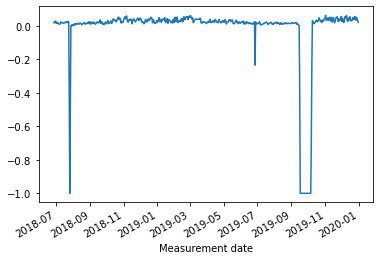

In [197]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

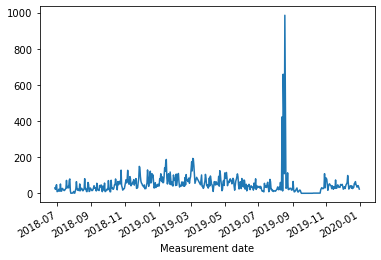

In [198]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

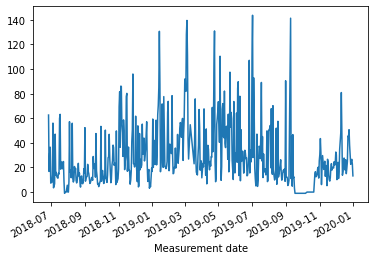

In [199]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

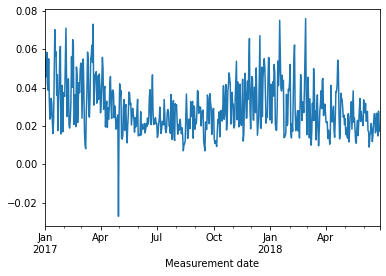

In [200]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

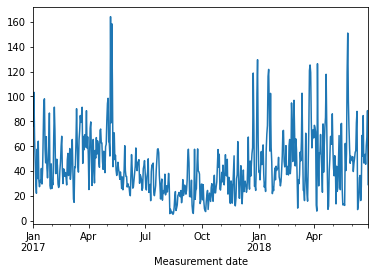

In [201]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

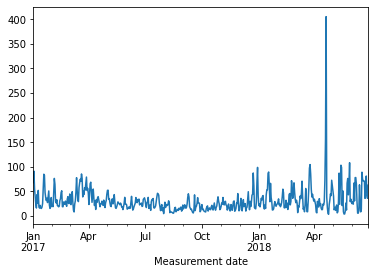

In [202]:
train['PM2.5'].plot()

In [203]:
print(stationarity_check(df_106['PM2.5']))
print(stationarity_check(df_106['PM10']))
print(stationarity_check(df_106['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -4.152624
p-value                           0.000792
#Lags Used                       22.000000
Number of Observations Used    1062.000000
Critical Value (1%)              -3.436522
Critical Value (5%)              -2.864265
Critical Value (10%)             -2.568221
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.125068e+00
p-value                        1.128928e-12
#Lags Used                     8.000000e+00
Number of Observations Used    1.076000e+03
Critical Value (1%)           -3.436442e+00
Critical Value (5%)           -2.864230e+00
Critical Value (10%)          -2.568202e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.901180
p-value                           0.000035
#Lags Used                       22.000000
Number of Observations Used    1062.000000
Critical Value (1%)              -3.436522
Critical Value (5%)              -2.8

# Rolling Mean Difference Train

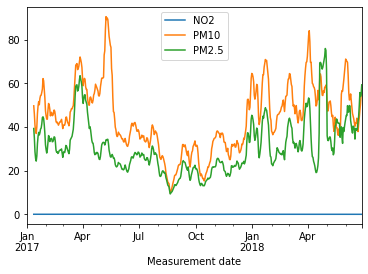

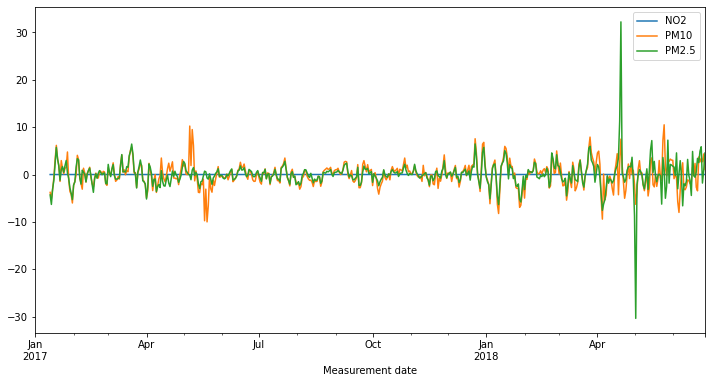

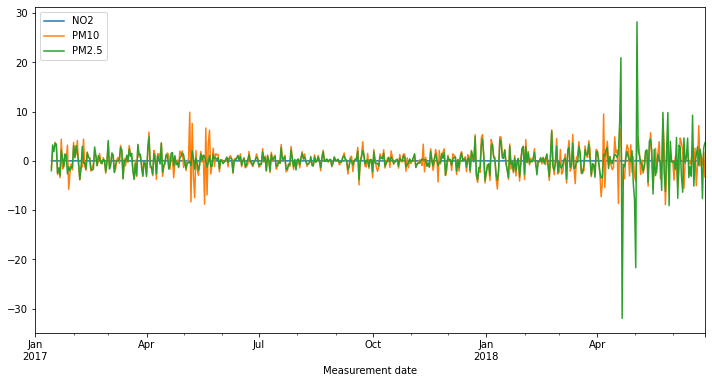

In [204]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [205]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.984565e+00
p-value                        2.569538e-12
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.494158e+00
p-value                        1.289359e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.260256e+00
p-value                        1.413382e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [206]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.081515e+01
p-value                        1.865412e-19
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.863519e+00
p-value                        4.172144e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.014961e+01
p-value                        8.015335e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

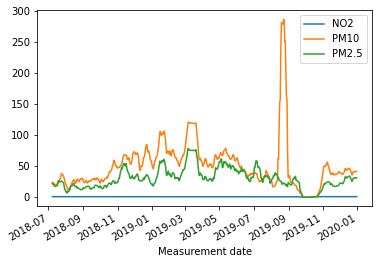

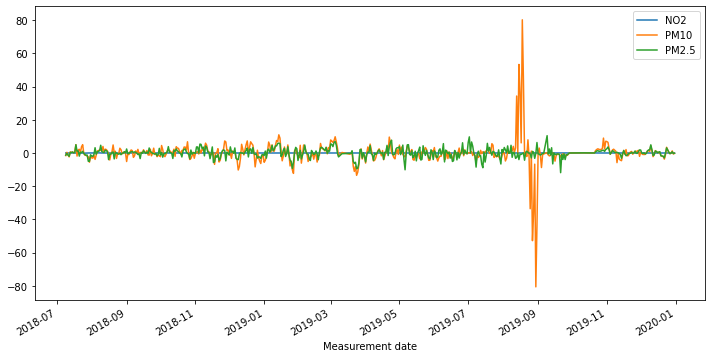

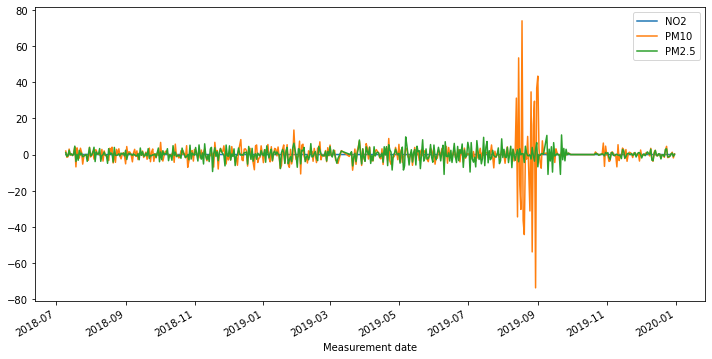

In [207]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [208]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -5.888006e+00
p-value                        2.969950e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.285858e+00
p-value                        3.699683e-08
#Lags Used                     1.700000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.991449e+00
p-value                        1.741712e-07
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)      

In [209]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.541686e+00
p-value                        2.715981e-16
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.922238e+00
p-value                        1.033622e-14
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.160196e+00
p-value                        9.187699e-13
#Lags Used                     1.300000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

# Station 106 PM2.5

In [210]:
base_model = sm.tsa.statespace.SARIMAX(df_106['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5056.450
Date:                Wed, 20 Oct 2021   AIC                          10116.900
Time:                        14:49:40   BIC                          10126.879
Sample:                             0   HQIC                         10120.677
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     29.9570      0.971     30.854      0.000      28.054      31.860
sigma2       653.7781      7.331     89.183      0.000     639.410     668.146
Ljung-Box (L1) (Q):                 263.87   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9916.162, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11052.356, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10010.420, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10475.033, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9794.812, Time=0.23 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9966.398, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9796.655, Time=0.23 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9796.642, Time=0.23 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9811.814, Time=0.14 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9928.486, Time=0.07 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.26 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9789.545, Time=0.44 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9815.593, Time=0.12 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9816.540, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept  

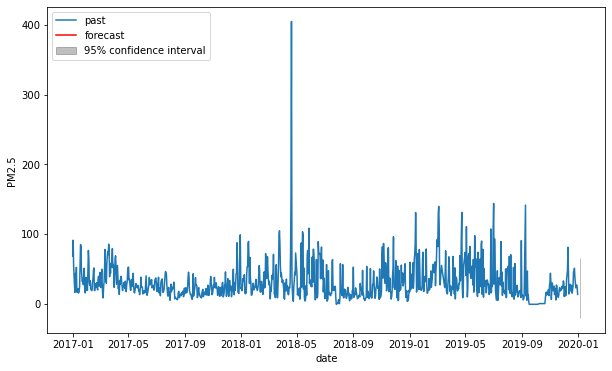

In [211]:
timeseries = df_106['PM2.5']
automodel = arimamodel(df_106['PM2.5'])
plotarima(1, timeseries, automodel)

In [212]:
best_model = sm.tsa.statespace.SARIMAX(df_106['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4889.772
Date:                Wed, 20 Oct 2021   AIC                           9789.545
Time:                        14:49:45   BIC                           9814.491
Sample:                             0   HQIC                          9798.989
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4665      0.379      1.231      0.218      -0.276       1.209
ar.L1          1.3647      0.032     42.264      0.000       1.301       1.428
ar.L2         -0.3801      0.023    -16.734      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [213]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,1])

Train RMSE: 22.105409330826305
Test RMSE: 29.9028644281283
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2451.304
Date:                Wed, 20 Oct 2021   AIC                           4912.608
Time:                        14:49:45   BIC                           4934.094
Sample:                    01-01-2017   HQIC                          4921.009
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         31.4776      2.859     11.012      0.000      25.875      37.080
ar.L1          0.6982      1.191      0.586      0.558      -1.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 106 PM10

In [214]:
base_model = sm.tsa.statespace.SARIMAX(df_106['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5789.806
Date:                Wed, 20 Oct 2021   AIC                          11583.612
Time:                        14:49:45   BIC                          11593.590
Sample:                             0   HQIC                         11587.389
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     46.8075      2.512     18.632      0.000      41.884      51.731
sigma2      2526.4643     20.779    121.588      0.000    2485.738    2567.190
Ljung-Box (L1) (Q):                 275.79   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=11236.958, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=12259.128, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=11422.101, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11700.708, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=11238.822, Time=0.15 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=11238.657, Time=0.11 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=11687.045, Time=0.07 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=11320.185, Time=0.03 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=11157.282, Time=0.15 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=11106.456, Time=0.15 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=11111.638, Time=0.16 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=11063.141, Time=0.43 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=11107.952, Time=0.19 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=inf, Time=0.77 sec
 ARIMA(4,0,3)(0,0,0)[0]  

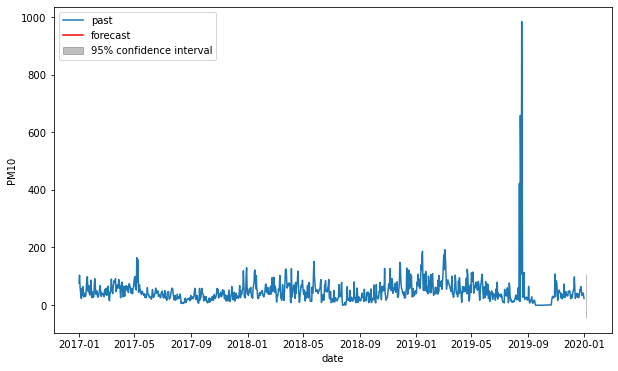

In [215]:
timeseries = df_106['PM10']
automodel = arimamodel(df_106['PM10'])
plotarima(1, timeseries, automodel)

In [216]:
best_model = sm.tsa.statespace.SARIMAX(df_106['PM10'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood               -5519.104
Date:                Wed, 20 Oct 2021   AIC                          11050.209
Time:                        14:49:55   BIC                          11080.145
Sample:                             0   HQIC                         11061.541
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.5968      3.939      6.245      0.000      16.877      32.317
ar.L1         -0.2605      0.014    -18.588      0.000      -0.288      -0.233
ar.L2          0.3223      0.006     50.911      0.0

In [217]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 18.816007519912862
Test RMSE: 70.17326529051837
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 1)   Log Likelihood               -2363.705
Date:                Wed, 20 Oct 2021   AIC                           4739.410
Time:                        14:49:56   BIC                           4765.193
Sample:                    01-01-2017   HQIC                          4749.491
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.6225      7.021      6.498      0.000      31.861      59.384
ar.L1          1.5579      0.040     39.109      0.000       1

# Station 106 NO2

In [218]:
base_model = sm.tsa.statespace.SARIMAX(df_106['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 549.472
Date:                Wed, 20 Oct 2021   AIC                          -1094.943
Time:                        14:49:56   BIC                          -1084.965
Sample:                             0   HQIC                         -1091.166
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0050      0.029      0.172      0.863      -0.052       0.062
sigma2         0.0213      0.001     16.591      0.000       0.019       0.024
Ljung-Box (L1) (Q):                 986.03   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3840.237, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1095.674, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3662.408, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2344.296, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3848.074, Time=0.30 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3760.266, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3857.495, Time=0.26 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3843.068, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-3854.536, Time=0.40 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-3855.215, Time=0.25 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3854.273, Time=0.15 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-3854.007, Time=0.05 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-3856.321, Time=0.39 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3855.551, Time=0.53 sec

Best model:  ARIMA

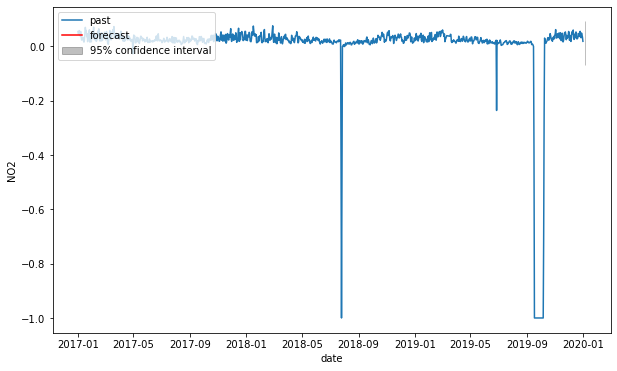

In [219]:
timeseries = df_106['NO2']
automodel = arimamodel(df_106['NO2'])
plotarima(1, timeseries, automodel)

In [220]:
best_model = sm.tsa.statespace.SARIMAX(df_106['NO2'], trend='c', order=[3,0,0])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 0)   Log Likelihood                1925.561
Date:                Wed, 20 Oct 2021   AIC                          -3841.121
Time:                        14:49:59   BIC                          -3816.175
Sample:                             0   HQIC                         -3831.677
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0003      0.002      0.122      0.903      -0.004       0.005
ar.L1          1.3154      0.006    214.624      0.000       1.303       1.327
ar.L2         -0.6344      0.012    -54.577      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [221]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,0])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.010964845190477829
Test RMSE: 0.20880371077137194
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 0)   Log Likelihood                1680.747
Date:                Wed, 20 Oct 2021   AIC                          -3351.494
Time:                        14:49:59   BIC                          -3330.008
Sample:                    01-01-2017   HQIC                         -3343.093
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0294      0.001     23.592      0.000       0.027       0.032
ar.L1          0.5889      0.036     16.547      0.000    

# Station 107

In [222]:
df_107 = df[df['Station code'] == 107]

In [223]:
df_107.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,107,0.004500,0.045458,0.002875,0.791667,76.916667,52.916667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,107,0.005083,0.038042,0.013875,0.666667,111.500000,80.125000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,107,0.004917,0.045583,0.011208,0.525000,82.291667,51.875000,Good,Normal,Good,Good,Bad,Bad
2017-01-04,107,0.005208,0.056500,0.006208,0.604167,58.291667,35.458333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,107,0.004417,0.033125,0.014083,0.450000,39.291667,22.833333,Good,Normal,Good,Good,Normal,Normal


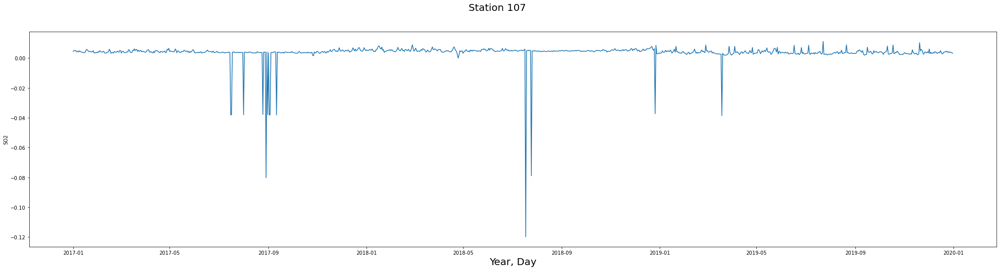

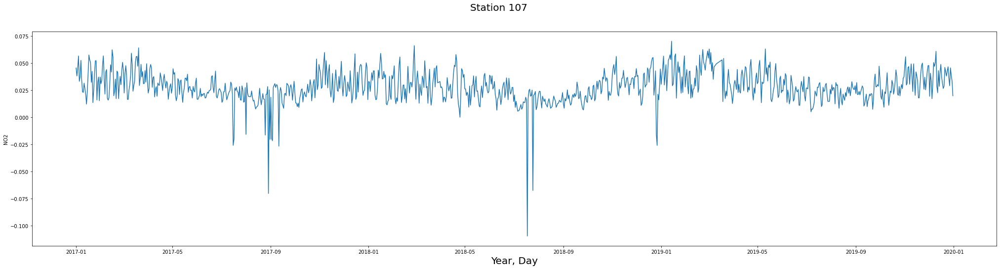

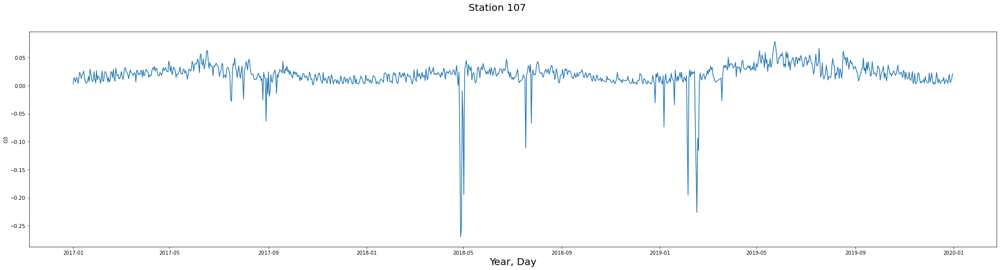

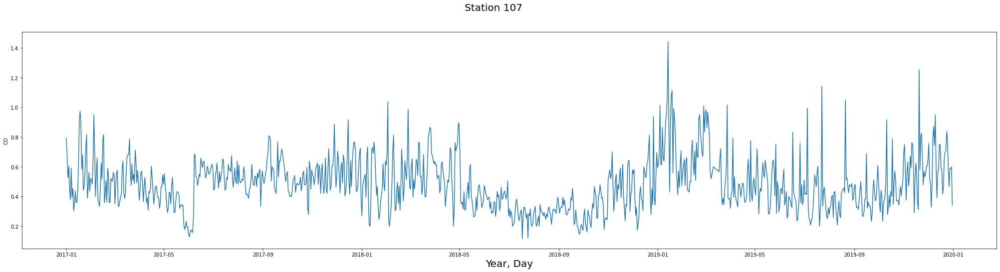

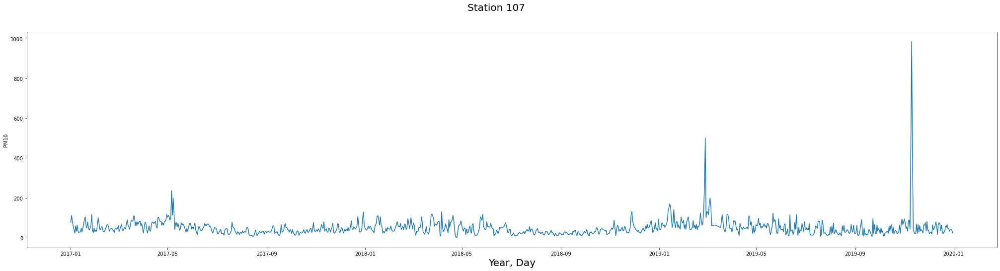

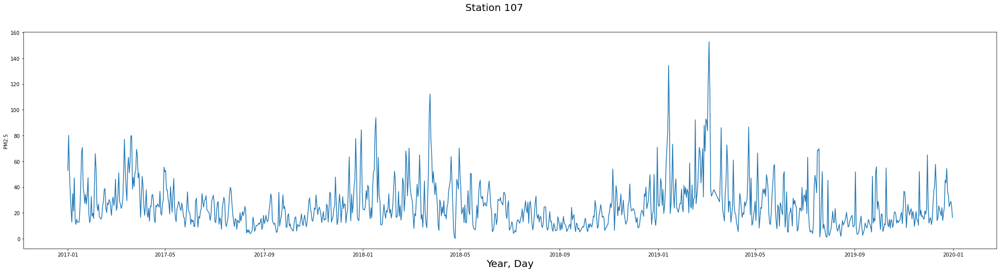

In [224]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 107", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_107)

In [225]:
df_107['NO2 Level'].value_counts()

Good      641
Normal    435
Bad         9
Name: NO2 Level, dtype: int64

In [226]:
df_107['PM10 Level'].value_counts()

Normal      638
Good        320
Bad         114
Very Bad     12
Name: PM10 Level, dtype: int64

In [227]:
df_107['PM2.5 Level'].value_counts()

Normal      533
Good        330
Bad         198
Very Bad     24
Name: PM2.5 Level, dtype: int64

###### For Station 107
- NO2 reaches levels of 'Bad' on 9 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 114 occasions and 'Very Bad' on 12, and gets close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 198 occasions and 'Very Bad' on 24 occasions.

# Picking the relevant columns

In [228]:
columns = ['NO2', 'PM10', 'PM2.5']
df_107 = df_107[columns]
df_107

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.045458,76.916667,52.916667
2017-01-02,0.038042,111.500000,80.125000
2017-01-03,0.045583,82.291667,51.875000
2017-01-04,0.056500,58.291667,35.458333
2017-01-05,0.033125,39.291667,22.833333
...,...,...,...
2019-12-27,0.029042,32.416667,24.750000
2019-12-28,0.045542,40.916667,27.291667
2019-12-29,0.038667,43.125000,29.041667


In [229]:
train = df_107[:-542]
test = df_107[542:]

<AxesSubplot:xlabel='Measurement date'>

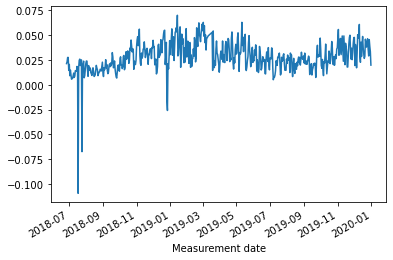

In [230]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

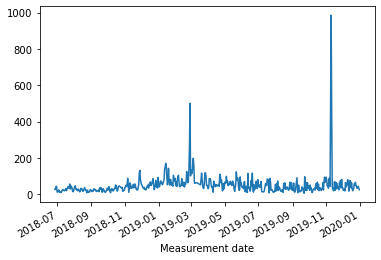

In [231]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

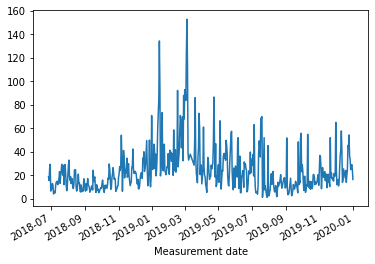

In [232]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

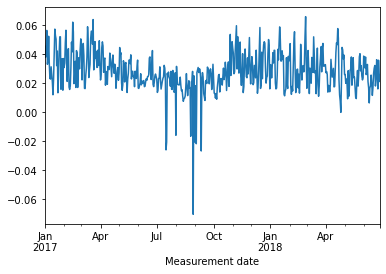

In [233]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

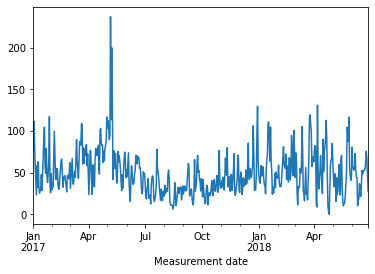

In [234]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

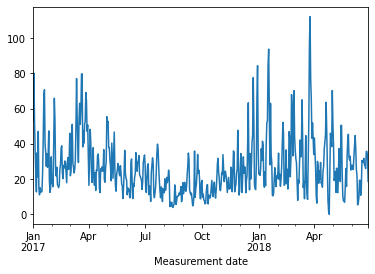

In [235]:
train['PM2.5'].plot()

In [236]:
print(stationarity_check(df_107['PM2.5']))
print(stationarity_check(df_107['PM10']))
print(stationarity_check(df_107['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.047055e+00
p-value                        5.651203e-10
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.503200e+00
p-value                        3.401381e-16
#Lags Used                     5.000000e+00
Number of Observations Used    1.079000e+03
Critical Value (1%)           -3.436425e+00
Critical Value (5%)           -2.864222e+00
Critical Value (10%)          -2.568198e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.286042
p-value                           0.000470
#Lags Used                       12.000000
Number of Observations Used    1072.000000
Critical Value (1%)              -3.436465
Critical Value (5%)           

# Rolling Mean Difference Train

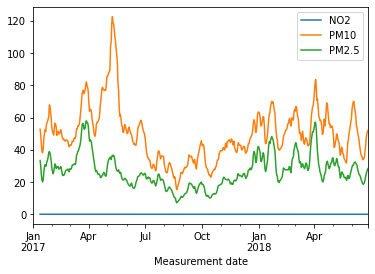

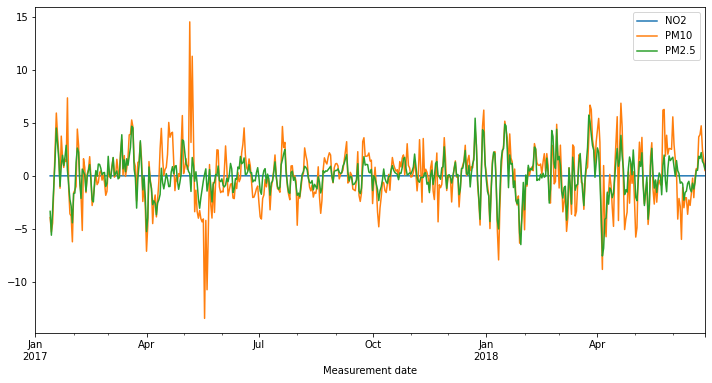

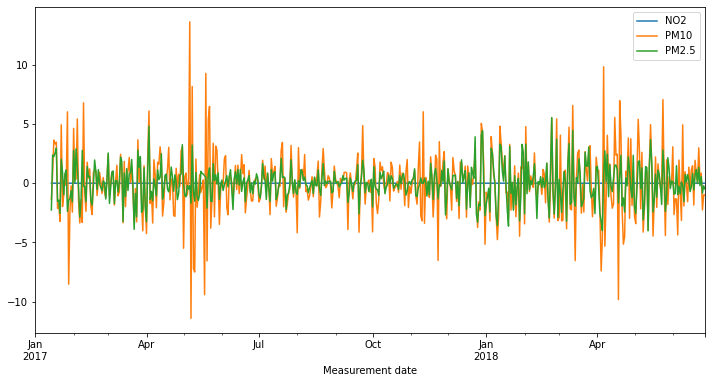

In [237]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [238]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.357546e+00
p-value                        2.520989e-08
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.881762e+00
p-value                        4.682404e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.972204e+00
p-value                        1.924358e-07
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)      

In [239]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.070443e+01
p-value                        3.456769e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.083999e+01
p-value                        1.625165e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.029147e+01
p-value                        3.560850e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

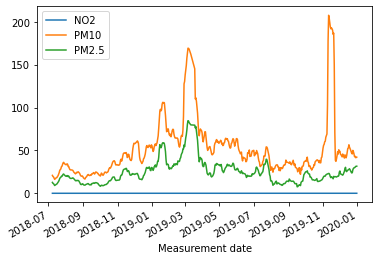

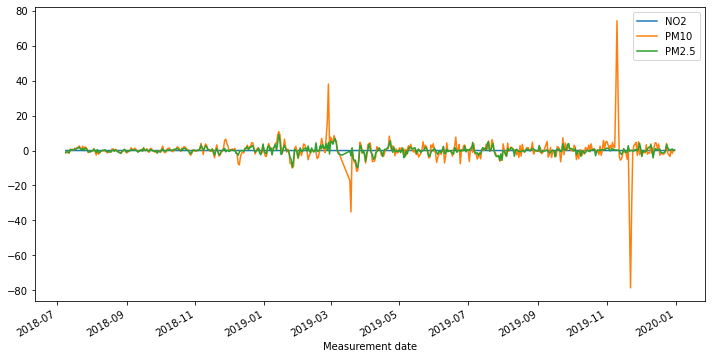

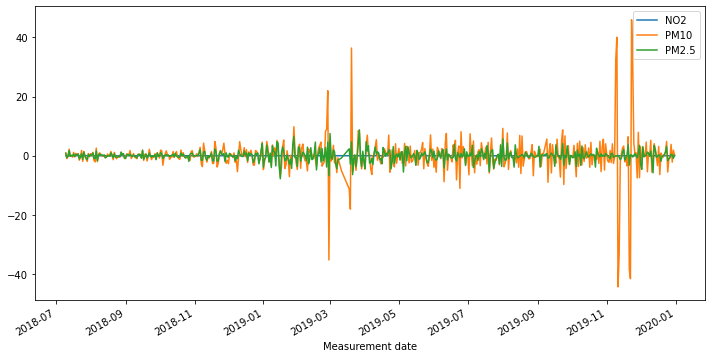

In [240]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));


In [241]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.116985e+00
p-value                        3.808327e-10
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.059642e+00
p-value                        1.656251e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.974393e+00
p-value                        1.902678e-07
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [242]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.815851e+00
p-value                        5.500493e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.917139e+00
p-value                        3.058768e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.647990e+00
p-value                        1.460276e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 107 PM2.5

In [243]:
base_model = sm.tsa.statespace.SARIMAX(df_107['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4666.281
Date:                Wed, 20 Oct 2021   AIC                           9336.562
Time:                        14:50:03   BIC                           9346.540
Sample:                             0   HQIC                          9340.339
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     25.5176      0.746     34.190      0.000      24.055      26.980
sigma2       318.4808      9.129     34.887      0.000     300.589     336.373
Ljung-Box (L1) (Q):                 501.80   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8784.848, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10542.548, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8795.811, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9660.411, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8797.136, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8667.243, Time=0.09 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9282.341, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8630.459, Time=0.23 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8632.444, Time=0.30 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8632.401, Time=0.33 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8632.494, Time=0.15 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8631.556, Time=0.21 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=8633.081, Time=0.28 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=8623.239, Time=0.50 sec
 ARIMA(1,0,2)(0,0,0)[0] intercep

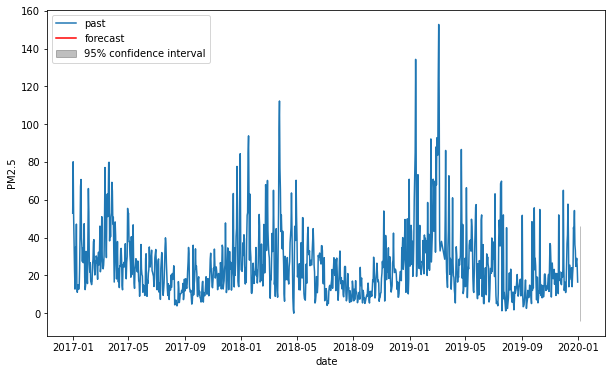

In [244]:
timeseries = df_107['PM2.5']
automodel = arimamodel(df_107['PM2.5'])
plotarima(1, timeseries, automodel)

In [245]:
best_model = sm.tsa.statespace.SARIMAX(df_107['PM2.5'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood               -4305.493
Date:                Wed, 20 Oct 2021   AIC                           8622.987
Time:                        14:50:10   BIC                           8652.923
Sample:                             0   HQIC                          8634.319
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7165      0.329      2.178      0.029       0.072       1.361
ar.L1          0.9723      0.011     85.634      0.000       0.950       0.995
ma.L1         -0.2928      0.025    -11.944      0.0

In [246]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[1,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 11.19115426178263
Test RMSE: 24.64586513304663
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(1, 0, 3)   Log Likelihood               -2080.423
Date:                Wed, 20 Oct 2021   AIC                           4172.847
Time:                        14:50:10   BIC                           4198.629
Sample:                    01-01-2017   HQIC                          4182.928
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.2405      3.937      6.919      0.000      19.524      34.957
ar.L1          0.9791      0.019     52.742      0.000       0.

# Station 107 PM10

In [247]:
base_model = sm.tsa.statespace.SARIMAX(df_107['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5691.547
Date:                Wed, 20 Oct 2021   AIC                          11387.095
Time:                        14:50:10   BIC                          11397.073
Sample:                             0   HQIC                         11390.872
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     49.8759      2.182     22.854      0.000      45.599      54.153
sigma2      2107.9147     14.993    140.596      0.000    2078.530    2137.300
Ljung-Box (L1) (Q):                 412.16   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=11001.012, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=12230.724, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=11002.998, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11440.707, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10984.403, Time=0.12 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=11003.361, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10827.695, Time=0.25 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10932.182, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=10821.370, Time=0.27 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=10923.517, Time=0.05 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=10821.932, Time=0.47 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=10825.226, Time=0.50 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10819.662, Time=0.38 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10817.656, Time=0.22 sec
 ARIMA(1,0,2)(0,0,0

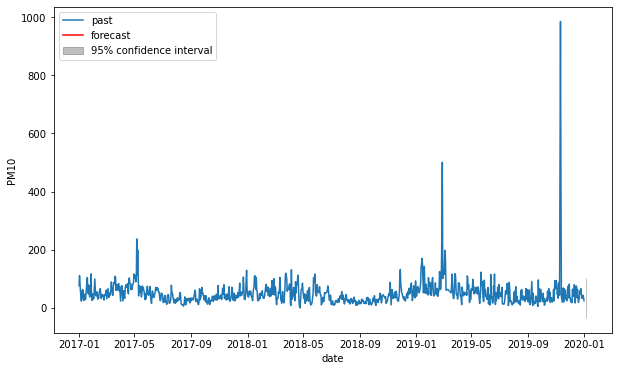

In [248]:
timeseries = df_107['PM10']
automodel = arimamodel(df_107['PM10'])
plotarima(1, timeseries, automodel)

In [249]:
best_model = sm.tsa.statespace.SARIMAX(df_107['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -5398.665
Date:                Wed, 20 Oct 2021   AIC                          10809.330
Time:                        14:50:18   BIC                          10839.266
Sample:                             0   HQIC                         10820.663
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.2919      1.100      1.174      0.240      -0.864       3.448
ar.L1          1.2244      0.061     20.001      0.000       1.104       1.344
ar.L2         -0.2511      0.045     -5.552      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [250]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 20.05457391305559
Test RMSE: 64.81045786520997
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2398.494
Date:                Wed, 20 Oct 2021   AIC                           4808.989
Time:                        14:50:18   BIC                           4834.771
Sample:                    01-01-2017   HQIC                          4819.070
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         50.0118      6.451      7.753      0.000      37.368      62.655
ar.L1          1.4219      0.082     17.329      0.000       1.

# Station 107 NO2

In [251]:
base_model = sm.tsa.statespace.SARIMAX(df_107['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3070.794
Date:                Wed, 20 Oct 2021   AIC                          -6137.588
Time:                        14:50:18   BIC                          -6127.609
Sample:                             0   HQIC                         -6133.810
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0281      0.000     60.481      0.000       0.027       0.029
sigma2         0.0002   3.58e-06     56.909      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 262.47   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6442.548, Time=0.22 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4418.158, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6175.485, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5225.722, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=inf, Time=0.39 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6515.407, Time=0.17 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5575.510, Time=0.17 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6508.448, Time=0.32 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6307.590, Time=0.44 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5728.374, Time=0.17 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-6517.319, Time=0.50 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=-6422.283, Time=0.65 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=-6515.555, Time=0.39 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=-6332.523, Time=0.57 sec
 ARIMA(3,0,2)(0,0,0)[0]  

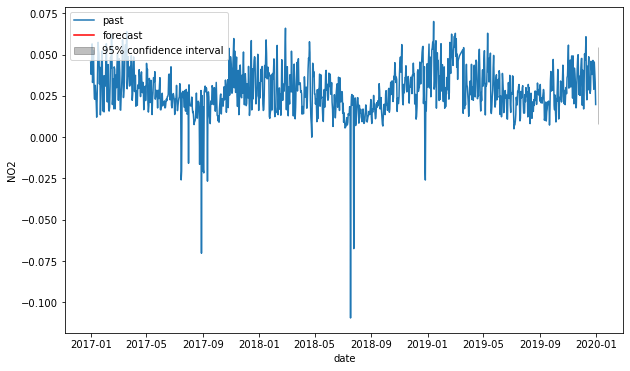

In [252]:
timeseries = df_107['NO2']
automodel = arimamodel(df_107['NO2'])
plotarima(1, timeseries, automodel)

In [253]:
best_model = sm.tsa.statespace.SARIMAX(df_107['NO2'], trend='c', order=[2,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(2, 0, 3)   Log Likelihood                3254.370
Date:                Wed, 20 Oct 2021   AIC                          -6494.740
Time:                        14:50:25   BIC                          -6459.814
Sample:                             0   HQIC                         -6481.518
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0020      0.001      2.521      0.012       0.000       0.003
ar.L1          0.5029      0.178      2.820      0.005       0.153       0.852
ar.L2          0.4280      0.169      2.534      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [254]:
model_train = arima_results(train['NO2'],test['NO2'], order=[2,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.012040313819955477
Test RMSE: 0.0177360403150849
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(2, 0, 3)   Log Likelihood                1629.395
Date:                Wed, 20 Oct 2021   AIC                          -3244.789
Time:                        14:50:25   BIC                          -3214.709
Sample:                    01-01-2017   HQIC                         -3233.028
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0282      0.001     22.330      0.000       0.026       0.031
ar.L1         -0.1070      0.249     -0.430      0.667     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 108

In [255]:
df_108 = df[df['Station code'] == 108]

In [256]:
df_108.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,108,0.004375,0.044542,0.005042,0.812500,79.708333,71.333333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,108,0.005208,0.044792,0.019208,0.900000,110.750000,95.458333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,108,0.004875,0.047708,0.015875,0.862500,85.750000,69.041667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,108,0.006083,0.055833,0.008042,0.945833,55.875000,41.250000,Good,Normal,Good,Good,Normal,Bad
2017-01-05,108,0.004000,0.033042,0.017125,0.612500,32.583333,21.750000,Good,Normal,Good,Good,Normal,Normal


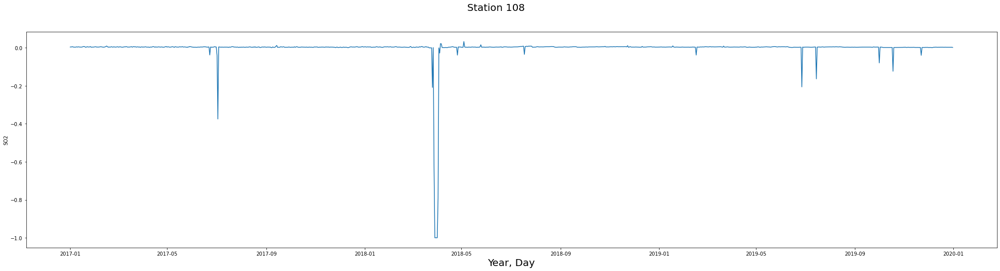

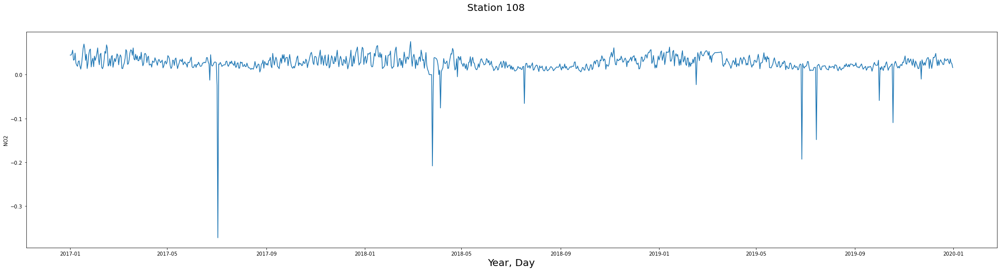

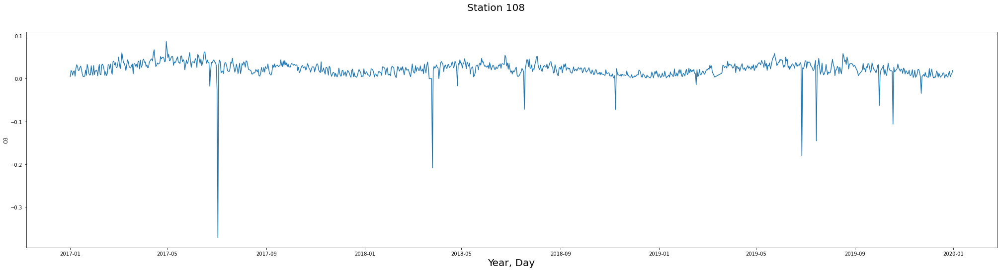

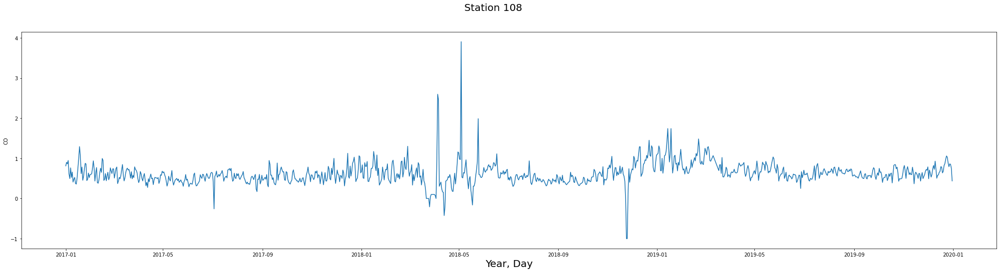

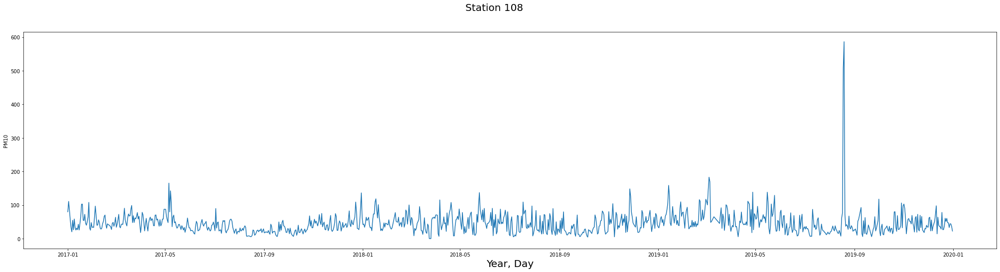

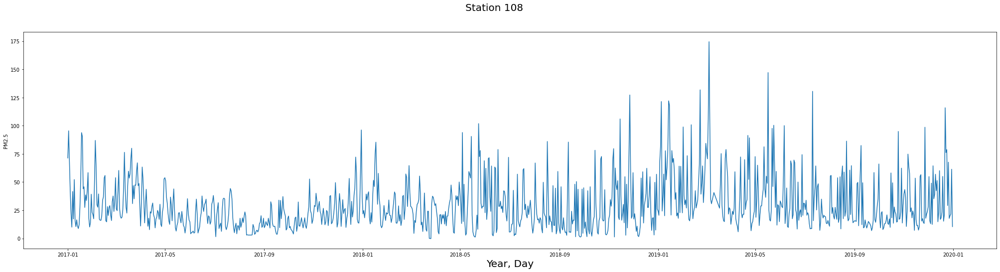

In [257]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 108", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_108)

In [258]:
df_108['NO2 Level'].value_counts()

Good      677
Normal    393
Bad        15
Name: NO2 Level, dtype: int64

In [259]:
df_108['PM2.5 Level'].value_counts()

Normal      467
Good        311
Bad         255
Very Bad     52
Name: PM2.5 Level, dtype: int64

In [260]:
df_108['PM10 Level'].value_counts()

Normal      632
Good        354
Bad          93
Very Bad      6
Name: PM10 Level, dtype: int64

#### For Station 108:
- NO2 reaches levels of 'Bad' on 15 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 93 occasions and 'Very Bad' on 6, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 255 occasions and 'Very Bad' on 52 occasions.

# Picking the relevant columns

In [261]:
columns = ['NO2', 'PM10', 'PM2.5']
df_108 = df_108[columns]
df_108

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.044542,79.708333,71.333333
2017-01-02,0.044792,110.750000,95.458333
2017-01-03,0.047708,85.750000,69.041667
2017-01-04,0.055833,55.875000,41.250000
2017-01-05,0.033042,32.583333,21.750000
...,...,...,...
2019-12-27,0.024750,32.958333,17.791667
2019-12-28,0.035917,44.041667,20.125000
2019-12-29,0.027250,43.750000,21.625000


# Train-Test Split

In [262]:
train = df_108[:-542]
test = df_108[542:]

<AxesSubplot:xlabel='Measurement date'>

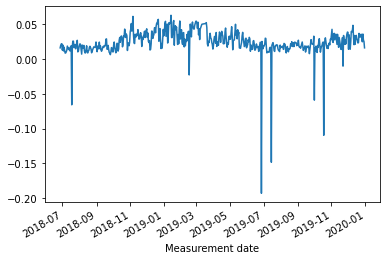

In [263]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

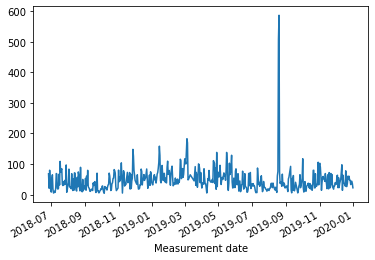

In [264]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

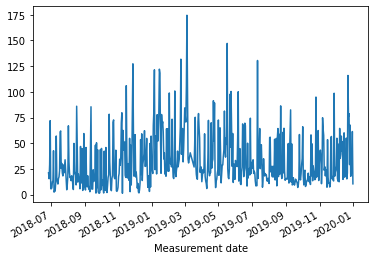

In [265]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

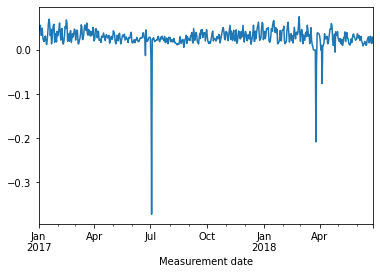

In [266]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

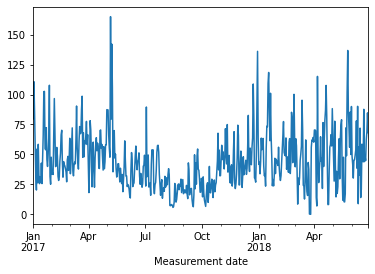

In [267]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

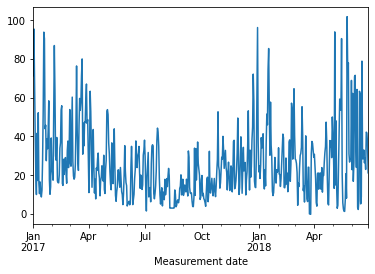

In [268]:
train['PM2.5'].plot()

In [269]:
print(stationarity_check(df_108['PM2.5']))
print(stationarity_check(df_108['PM10']))
print(stationarity_check(df_108['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -5.651316e+00
p-value                        9.845705e-07
#Lags Used                     1.100000e+01
Number of Observations Used    1.073000e+03
Critical Value (1%)           -3.436459e+00
Critical Value (5%)           -2.864237e+00
Critical Value (10%)          -2.568206e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.447289e+01
p-value                        6.561052e-27
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.265780
p-value                           0.000509
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)           

# Rolling Mean Difference Train

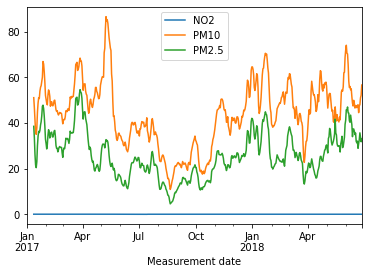

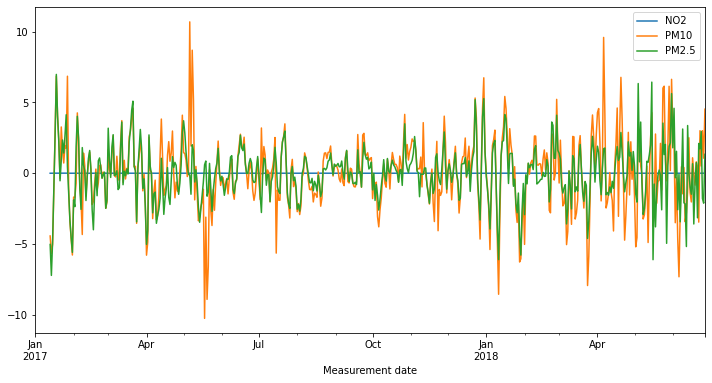

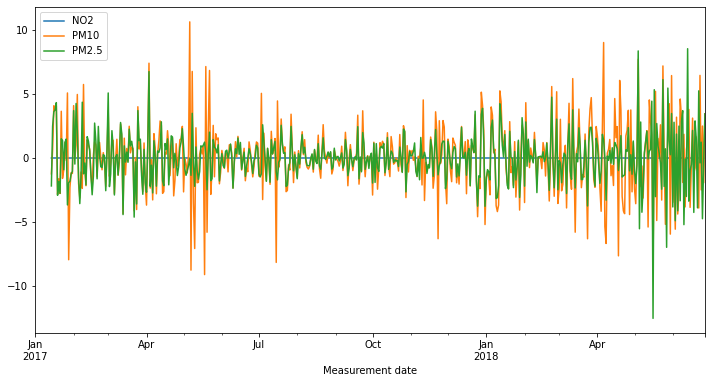

In [270]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [271]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.010312e+00
p-value                        1.579230e-07
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.017267e+00
p-value                        6.682694e-10
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.330846e+00
p-value                        3.371879e-13
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)      

In [272]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.060486e+01
p-value                        6.039286e-19
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.050609e+01
p-value                        1.053409e-18
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.501702e+00
p-value                        3.431313e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

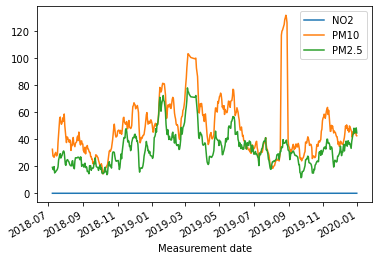

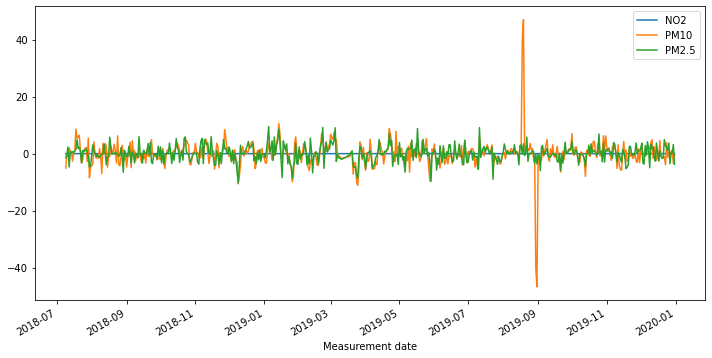

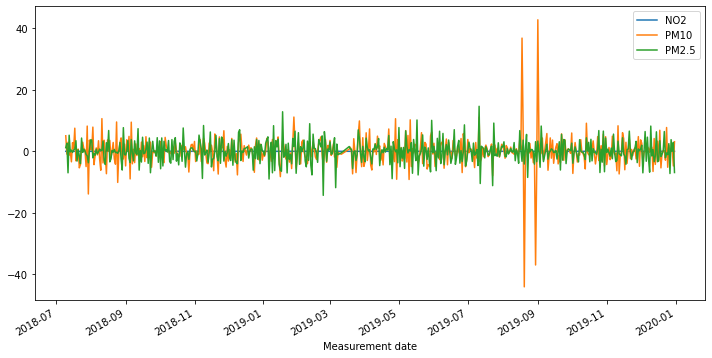

In [273]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [274]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.818859e+00
p-value                        1.901315e-14
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.212548e+00
p-value                        6.757375e-13
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.324335
p-value                          0.000005
#Lags Used                      18.000000
Number of Observations Used    512.000000
Critical Value (1%)             -3.443187
Critical Value (5%)             -2.

In [275]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.063638e+01
p-value                        5.059769e-19
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.006875e+01
p-value                        1.275505e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.182801e+01
p-value                        8.116197e-22
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

# Station 108 PM2.5

In [276]:
base_model = sm.tsa.statespace.SARIMAX(df_108['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4934.210
Date:                Wed, 20 Oct 2021   AIC                           9872.420
Time:                        14:50:29   BIC                           9882.398
Sample:                             0   HQIC                          9876.197
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     29.3881      0.960     30.609      0.000      27.506      31.270
sigma2       521.8816     18.159     28.740      0.000     486.291     557.472
Ljung-Box (L1) (Q):                 153.77   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9733.490, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10929.820, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9976.918, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10425.525, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9670.023, Time=0.18 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9883.907, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9671.780, Time=0.22 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9671.824, Time=0.28 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9676.992, Time=0.13 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9845.639, Time=0.08 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9673.472, Time=0.33 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9664.136, Time=0.45 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9698.631, Time=0.15 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9701.996, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0)[0] interce

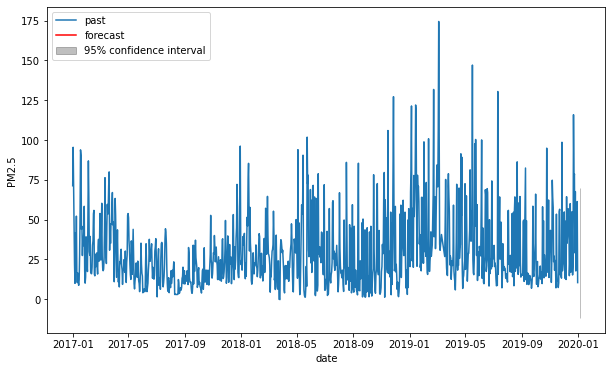

In [277]:
timeseries = df_108['PM2.5']
automodel = arimamodel(df_108['PM2.5'])
plotarima(1, timeseries, automodel)

In [278]:
best_model = sm.tsa.statespace.SARIMAX(df_108['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4827.068
Date:                Wed, 20 Oct 2021   AIC                           9664.136
Time:                        14:50:34   BIC                           9689.083
Sample:                             0   HQIC                          9673.580
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3802      0.244      1.557      0.120      -0.098       0.859
ar.L1          1.2404      0.032     39.008      0.000       1.178       1.303
ar.L2         -0.2532      0.028     -8.930      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [279]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 14.929420971472707
Test RMSE: 30.2171401790365
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2236.950
Date:                Wed, 20 Oct 2021   AIC                           4485.901
Time:                        14:50:35   BIC                           4511.683
Sample:                    01-01-2017   HQIC                          4495.982
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.2604      5.192      5.443      0.000      18.085      38.436
ar.L1          1.3383      0.080     16.651      0.000       1.

# Station 108 PM10

In [280]:
base_model = sm.tsa.statespace.SARIMAX(df_108['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5368.691
Date:                Wed, 20 Oct 2021   AIC                          10741.381
Time:                        14:50:35   BIC                          10751.360
Sample:                             0   HQIC                         10745.159
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     45.8446      1.414     32.426      0.000      43.074      48.616
sigma2      1162.4987     10.145    114.589      0.000    1142.615    1182.382
Ljung-Box (L1) (Q):                 295.34   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10575.361, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11859.591, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10598.806, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11145.218, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10401.826, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=10591.093, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10388.389, Time=0.26 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10535.824, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=10388.870, Time=0.35 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10390.334, Time=0.41 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10387.114, Time=0.25 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10403.963, Time=0.15 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=10389.106, Time=0.38 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=10387.968, Time=0.25 sec
 ARIMA(3,0,3)(0,0,0

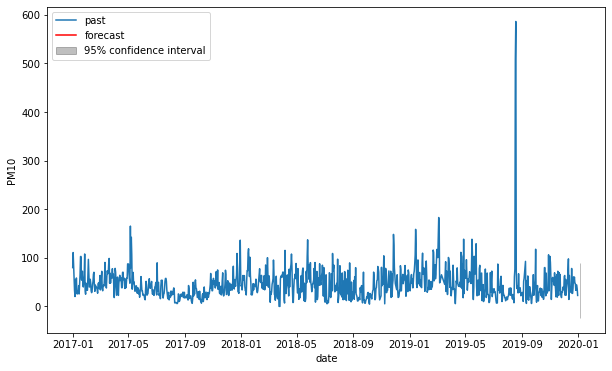

In [281]:
timeseries = df_108['PM10']
automodel = arimamodel(df_108['PM10'])
plotarima(1, timeseries, automodel)

In [282]:
best_model = sm.tsa.statespace.SARIMAX(df_108['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -5190.133
Date:                Wed, 20 Oct 2021   AIC                          10392.266
Time:                        14:50:38   BIC                          10422.202
Sample:                             0   HQIC                         10403.599
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     20.4653     24.442      0.837      0.402     -27.441      68.371
ar.L1          0.5534      0.882      0.628      0.530      -1.174       2.281
ar.L2          0.0016      0.363      0.004      0.9

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [283]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 19.421488552901625
Test RMSE: 46.00641140511223
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2380.851
Date:                Wed, 20 Oct 2021   AIC                           4773.702
Time:                        14:50:38   BIC                           4799.485
Sample:                    01-01-2017   HQIC                          4783.783
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.3683      6.086      7.619      0.000      34.441      58.296
ar.L1          1.4028      0.094     14.893      0.000       1

# Station 108 NO2

In [284]:
base_model = sm.tsa.statespace.SARIMAX(df_108['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2611.870
Date:                Wed, 20 Oct 2021   AIC                          -5219.740
Time:                        14:50:38   BIC                          -5209.762
Sample:                             0   HQIC                         -5215.963
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0263      0.001     26.598      0.000       0.024       0.028
sigma2         0.0005   3.78e-06    125.738      0.000       0.000       0.000
Ljung-Box (L1) (Q):                  98.01   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5341.607, Time=0.18 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4244.413, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5020.285, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4672.305, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-5308.000, Time=0.31 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-5369.913, Time=0.31 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-4824.923, Time=0.10 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-5349.950, Time=0.31 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-5368.116, Time=0.45 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-4916.334, Time=0.19 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-5366.080, Time=0.34 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-5362.701, Time=0.46 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0]          
Total fit time: 2.808 seconds


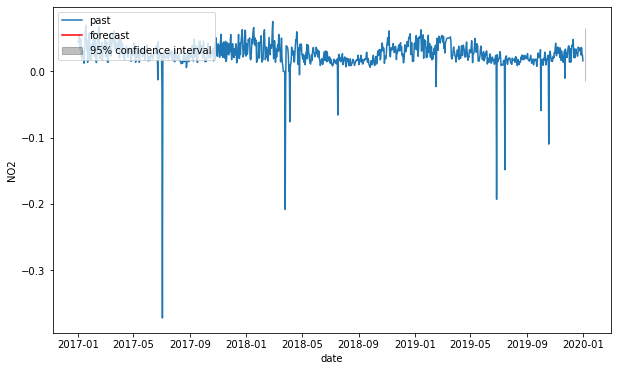

In [285]:
timeseries = df_108['NO2']
automodel = arimamodel(df_108['NO2'])
plotarima(1, timeseries, automodel)

In [286]:
best_model = sm.tsa.statespace.SARIMAX(df_108['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                2686.350
Date:                Wed, 20 Oct 2021   AIC                          -5362.701
Time:                        14:50:42   BIC                          -5337.754
Sample:                             0   HQIC                         -5353.257
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0011      0.001      1.883      0.060   -4.65e-05       0.002
ar.L1          0.9570      0.022     43.174      0.000       0.914       1.000
ma.L1         -0.7637      0.025    -30.065      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [287]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.02322355646222032
Test RMSE: 0.02193435301059168
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1272.513
Date:                Wed, 20 Oct 2021   AIC                          -2535.026
Time:                        14:50:42   BIC                          -2513.540
Sample:                    01-01-2017   HQIC                         -2526.625
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0286      0.006      4.817      0.000       0.017       0.040
ar.L1          0.9762      0.030     32.045      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 109

In [288]:
df_109 = df[df['Station code'] == 109]

In [289]:
df_109.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,109,0.005583,0.046292,0.002917,1.016667,87.083333,62.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-02,109,0.005625,0.039417,0.012250,1.041667,128.041667,89.250000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,109,0.006042,0.043958,0.010042,0.945833,91.958333,62.583333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,109,0.006250,0.051583,0.007208,0.995833,55.958333,34.791667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,109,0.005292,0.040375,0.006667,0.804167,43.416667,24.458333,Good,Normal,Good,Good,Normal,Normal


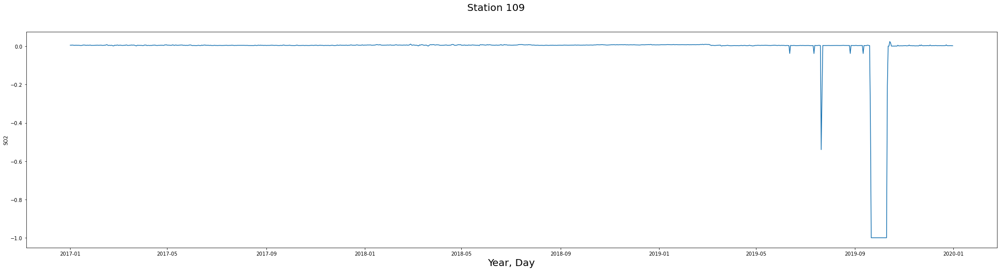

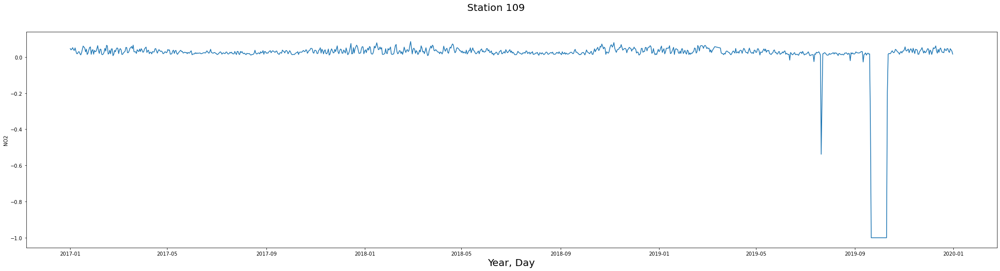

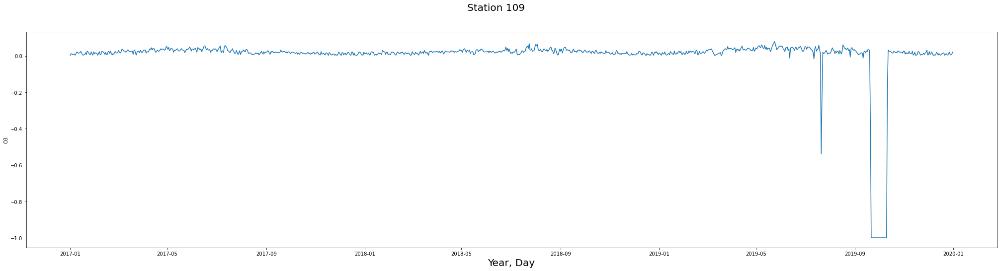

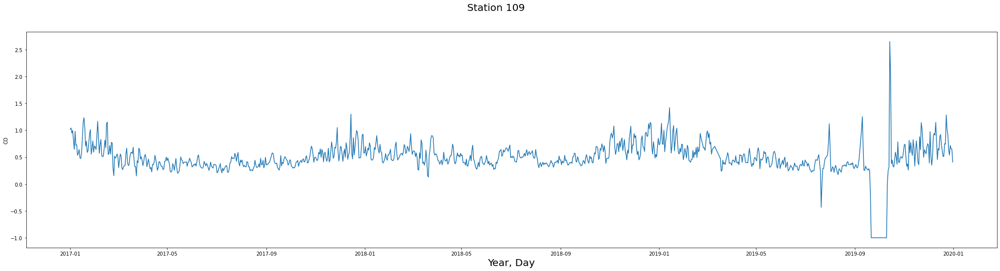

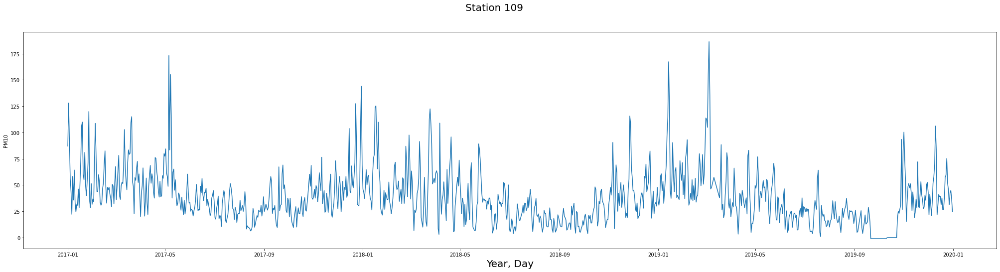

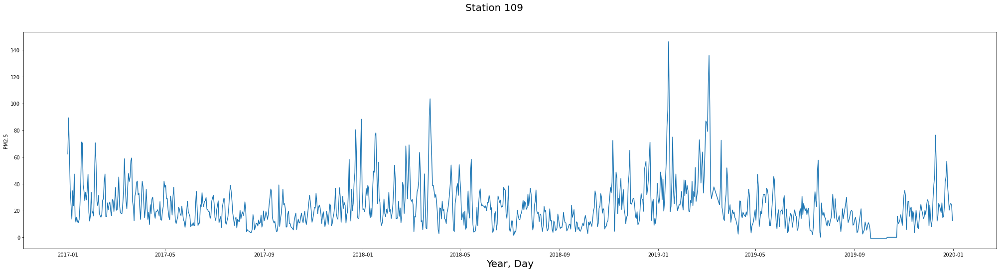

In [290]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 109", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_109)

In [291]:
df_109['NO2 Level'].value_counts()

Good      643
Normal    405
Bad        37
Name: NO2 Level, dtype: int64

In [292]:
df_109['PM2.5 Level'].value_counts()

Normal      534
Good        378
Bad         154
Very Bad     19
Name: PM2.5 Level, dtype: int64

In [293]:
df_109['PM10 Level'].value_counts()

Normal      568
Good        452
Bad          60
Very Bad      5
Name: PM10 Level, dtype: int64

#### For Station 109
- NO2 reaches levels of 'Bad' on 37 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 60 occasions and 'Very Bad' on 5, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 154 occasions and 'Very Bad' on 19 occasions.

# Picking the relevant columns

In [294]:
columns = ['NO2', 'PM10', 'PM2.5']
df_109 = df_109[columns]
df_109

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.046292,87.083333,62.250000
2017-01-02,0.039417,128.041667,89.250000
2017-01-03,0.043958,91.958333,62.583333
2017-01-04,0.051583,55.958333,34.791667
2017-01-05,0.040375,43.416667,24.458333
...,...,...,...
2019-12-27,0.025333,31.291667,20.291667
2019-12-28,0.045833,42.291667,24.541667
2019-12-29,0.039000,44.916667,25.291667


In [295]:
train = df_109[:-542]
test = df_109[542:]

<AxesSubplot:xlabel='Measurement date'>

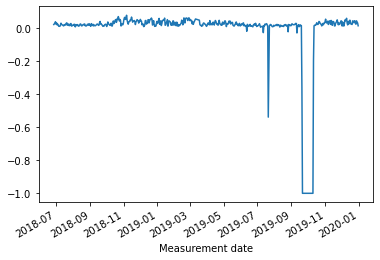

In [296]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

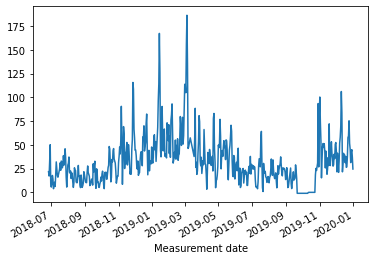

In [297]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

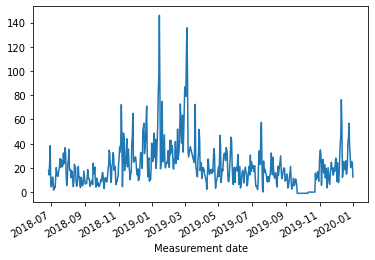

In [298]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

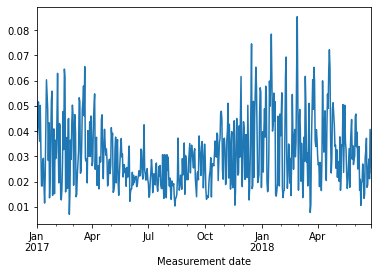

In [299]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

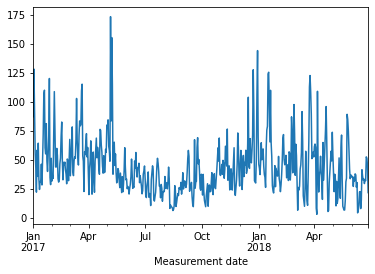

In [300]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

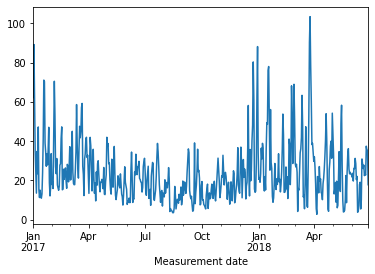

In [301]:
train['PM2.5'].plot()

In [302]:
print(stationarity_check(df_109['PM2.5']))
print(stationarity_check(df_109['PM10']))
print(stationarity_check(df_109['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -4.809026
p-value                           0.000052
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.161361e+00
p-value                        7.160931e-08
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.391018
p-value                           0.000308
#Lags Used                       22.000000
Number of Observations Used    1062.000000
Critical Value (1%)              -3.436522
Critical Value (5%)              -2.8

# Rolling Mean Difference Train

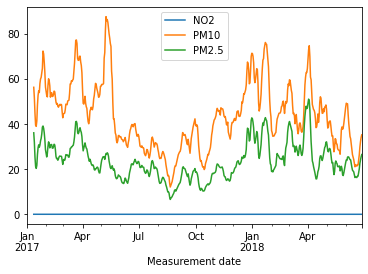

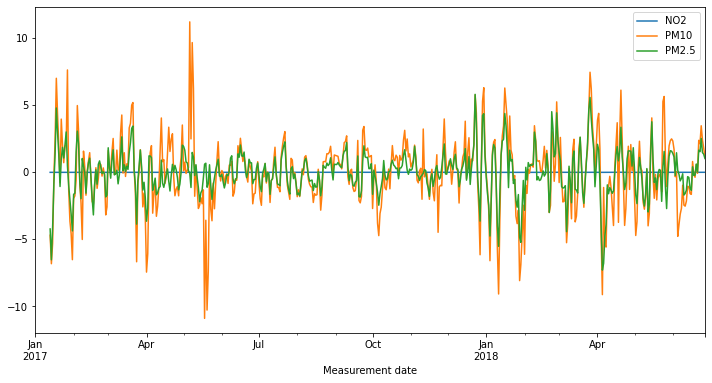

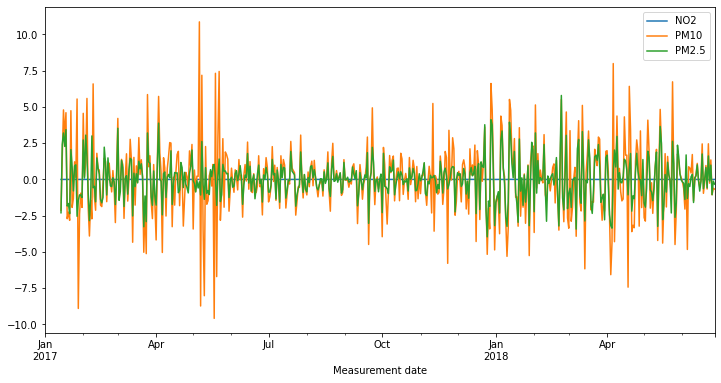

In [303]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [304]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.956506e+00
p-value                        3.027276e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.300407e+00
p-value                        4.032784e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.732764e+00
p-value                        3.264302e-09
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [305]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.112142e+01
p-value                        3.458330e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.077057e+01
p-value                        2.390168e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.020258e+01
p-value                        5.917069e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

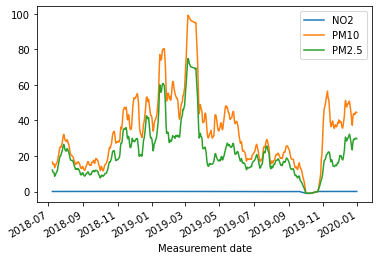

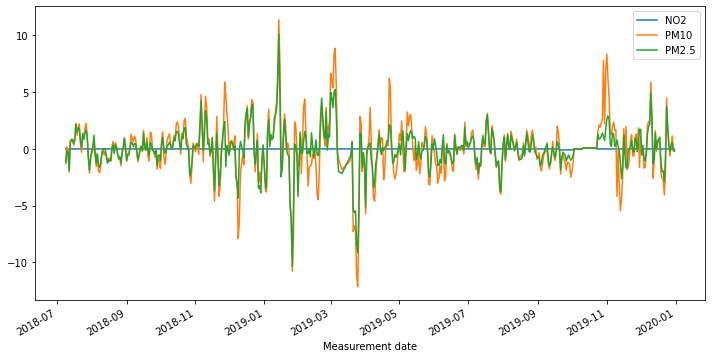

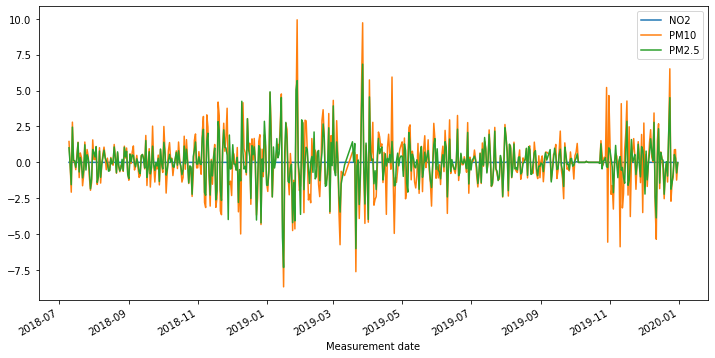

In [306]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [307]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.110318e+00
p-value                        9.367011e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.298211e+00
p-value                        1.360216e-10
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.712313e+00
p-value                        3.654403e-09
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

In [308]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.002136e+01
p-value                        1.675707e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.135063e+01
p-value                        1.001590e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.692690e+00
p-value                        1.405544e-11
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 109 PM2.5

In [309]:
base_model = sm.tsa.statespace.SARIMAX(df_109['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4590.025
Date:                Wed, 20 Oct 2021   AIC                           9184.049
Time:                        14:50:46   BIC                           9194.028
Sample:                             0   HQIC                          9187.827
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.7026      0.679     33.416      0.000      21.371      24.034
sigma2       276.7176      7.237     38.235      0.000     262.533     290.902
Ljung-Box (L1) (Q):                 588.39   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8427.834, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10323.171, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8435.497, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9320.361, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8411.967, Time=0.11 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8432.993, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8263.791, Time=0.23 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8355.079, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8255.933, Time=0.34 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8336.785, Time=0.08 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8257.815, Time=0.47 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=8263.008, Time=0.49 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8257.790, Time=0.26 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8328.281, Time=0.15 sec
 ARIMA(5,0,2)(0,0,0)[0]         

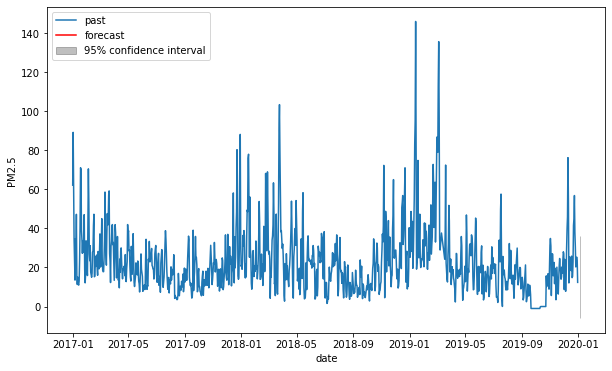

In [310]:
timeseries = df_109['PM2.5']
automodel = arimamodel(df_109['PM2.5'])
plotarima(1, timeseries, automodel)

In [311]:
best_model = sm.tsa.statespace.SARIMAX(df_109['PM2.5'], trend='c', order=[4,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(4, 0, 1)   Log Likelihood               -4117.892
Date:                Wed, 20 Oct 2021   AIC                           8249.783
Time:                        14:50:54   BIC                           8284.708
Sample:                             0   HQIC                          8263.004
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2098      0.142      1.472      0.141      -0.070       0.489
ar.L1          1.7891      0.038     47.084      0.000       1.715       1.864
ar.L2         -1.1110      0.055    -20.354      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [312]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[4,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.651534328832092
Test RMSE: 22.24651896957419
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(4, 0, 1)   Log Likelihood               -2051.672
Date:                Wed, 20 Oct 2021   AIC                           4117.343
Time:                        14:50:55   BIC                           4147.423
Sample:                    01-01-2017   HQIC                          4129.105
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.0283      1.515     15.861      0.000      21.059      26.998
ar.L1         -0.0767      0.050     -1.521      0.128      -0

# Station 109 PM10

In [313]:
base_model = sm.tsa.statespace.SARIMAX(df_109['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5047.086
Date:                Wed, 20 Oct 2021   AIC                          10098.172
Time:                        14:50:55   BIC                          10108.150
Sample:                             0   HQIC                         10101.949
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     38.2696      0.970     39.469      0.000      36.369      40.170
sigma2       642.5901     20.185     31.835      0.000     603.028     682.152
Ljung-Box (L1) (Q):                 563.77   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9408.320, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11384.702, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9419.134, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10428.893, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9418.866, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9294.670, Time=0.11 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10041.292, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9256.542, Time=0.23 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9257.736, Time=0.38 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9257.760, Time=0.32 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9267.124, Time=0.16 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9258.813, Time=0.21 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9258.242, Time=0.35 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9250.951, Time=0.55 sec
 ARIMA(1,0,2)(0,0,0)[0] interc

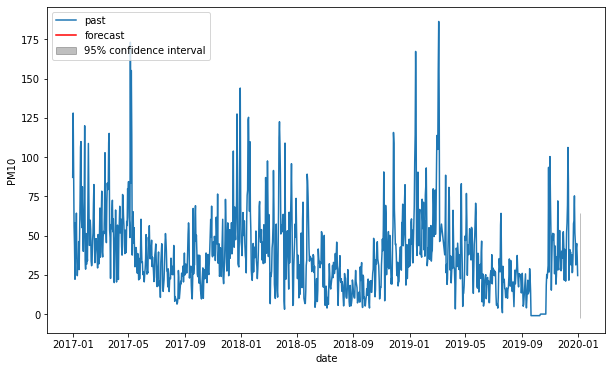

In [314]:
timeseries = df_109['PM10']
automodel = arimamodel(df_109['PM10'])
plotarima(1, timeseries, automodel)

In [315]:
best_model = sm.tsa.statespace.SARIMAX(df_109['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4619.475
Date:                Wed, 20 Oct 2021   AIC                           9250.951
Time:                        14:51:02   BIC                           9280.887
Sample:                             0   HQIC                          9262.283
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3053      0.200      1.524      0.128      -0.087       0.698
ar.L1          1.3983      0.047     29.572      0.000       1.306       1.491
ar.L2         -0.4060      0.045     -9.086      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [316]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

Train RMSE: 18.66188987632114
Test RMSE: 35.348349363689074
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2358.557
Date:                Wed, 20 Oct 2021   AIC                           4729.113
Time:                        14:51:02   BIC                           4754.896
Sample:                    01-01-2017   HQIC                          4739.194
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.0459      7.001      6.292      0.000      30.325      57.767
ar.L1          1.3810      0.066     20.785      0.000       1

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 109 NO2

In [317]:
base_model = sm.tsa.statespace.SARIMAX(df_109['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 586.095
Date:                Wed, 20 Oct 2021   AIC                          -1168.189
Time:                        14:51:02   BIC                          -1158.211
Sample:                             0   HQIC                         -1164.412
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0096      0.030      0.318      0.751      -0.050       0.069
sigma2         0.0199      0.001     16.104      0.000       0.017       0.022
Ljung-Box (L1) (Q):                 995.35   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3881.308, Time=0.16 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1165.154, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3838.944, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2347.880, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3885.988, Time=0.07 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3873.068, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3884.006, Time=0.29 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3883.683, Time=0.08 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-3885.282, Time=0.07 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3881.494, Time=0.09 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-3882.000, Time=0.33 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-3884.159, Time=0.18 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 1.562 seconds


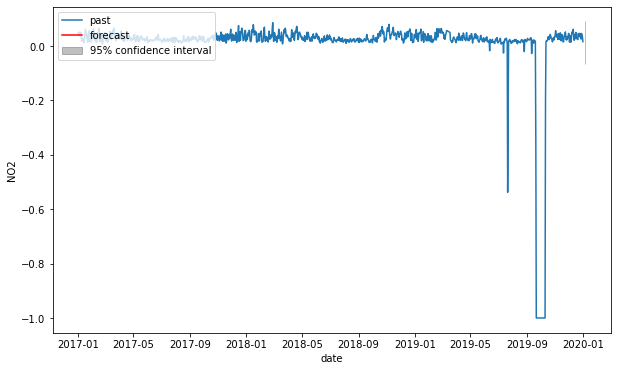

In [318]:
timeseries = df_109['NO2']
automodel = arimamodel(df_109['NO2'])
plotarima(1, timeseries, automodel)

In [319]:
best_model = sm.tsa.statespace.SARIMAX(df_109['NO2'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood                1947.079
Date:                Wed, 20 Oct 2021   AIC                          -3884.159
Time:                        14:51:04   BIC                          -3859.212
Sample:                             0   HQIC                         -3874.715
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0008      0.004      0.195      0.845      -0.007       0.008
ar.L1          0.6123      0.093      6.619      0.000       0.431       0.794
ar.L2          0.3131      0.089      3.502      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [320]:
model_train = arima_results(train['NO2'],test['NO2'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.011340093063532898
Test RMSE: 0.2017935359892835
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood                1661.869
Date:                Wed, 20 Oct 2021   AIC                          -3313.739
Time:                        14:51:04   BIC                          -3292.253
Sample:                    01-01-2017   HQIC                         -3305.338
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0305      0.001     29.890      0.000       0.029       0.033
ar.L1         -0.0454      0.144     -0.315      0.753     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 110

In [321]:
df_110 = df[df['Station code'] == 110]

In [322]:
df_110.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,110,0.005250,0.040792,0.004542,0.795833,80.166667,63.750000,Good,Normal,Good,Good,Bad,Bad
2017-01-02,110,0.005417,0.040958,0.013583,0.866667,122.166667,94.583333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,110,0.004875,0.043542,0.008250,0.716667,93.916667,69.458333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,110,0.005667,0.052417,0.005917,0.779167,60.625000,38.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-05,110,0.005000,0.031375,0.014208,0.520833,38.333333,23.291667,Good,Normal,Good,Good,Normal,Normal


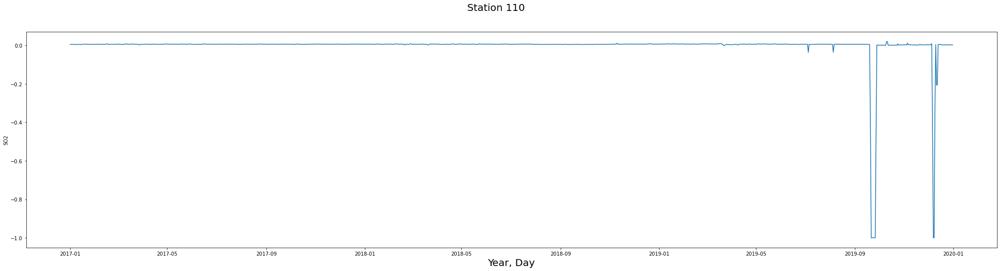

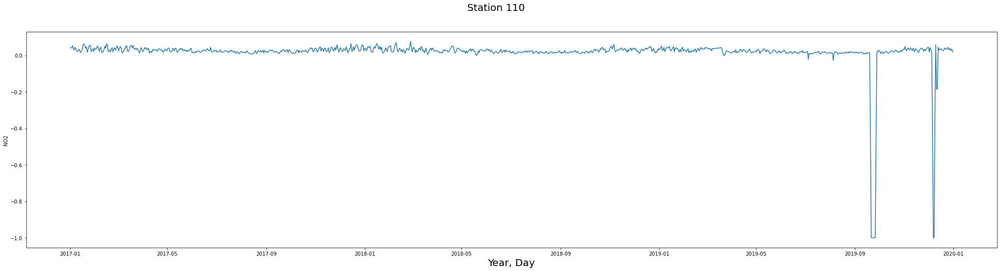

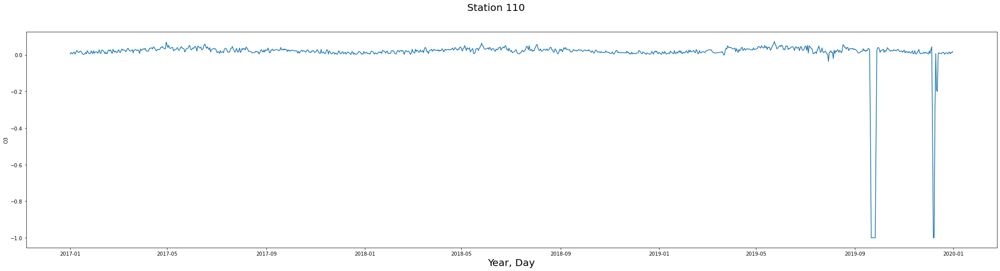

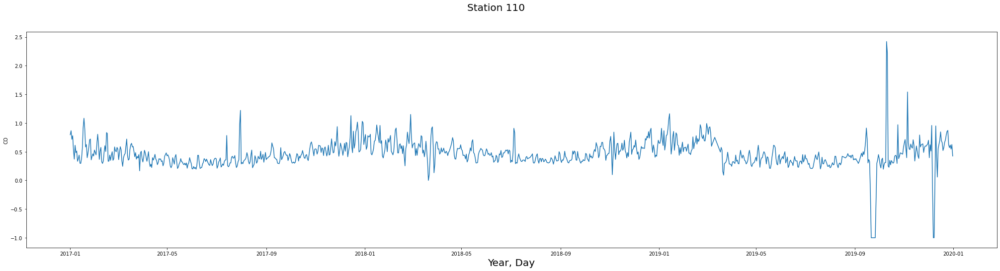

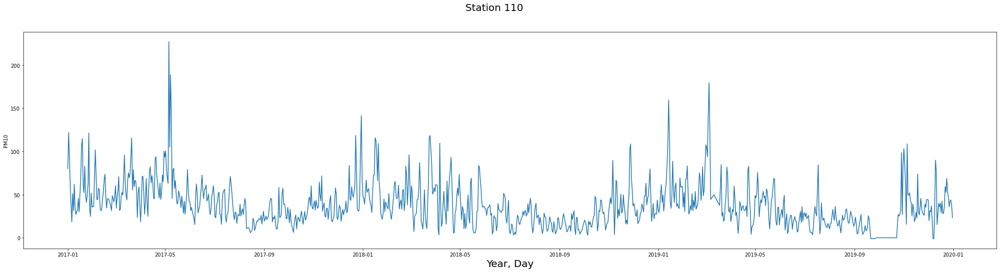

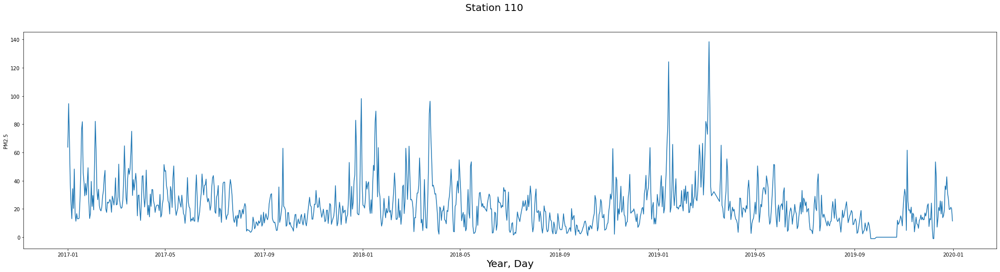

In [323]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 110", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_110)

In [324]:
df_110['NO2 Level'].value_counts()

Good      733
Normal    345
Bad         7
Name: NO2 Level, dtype: int64

In [325]:
df_110['PM2.5 Level'].value_counts()

Normal      532
Good        381
Bad         153
Very Bad     19
Name: PM2.5 Level, dtype: int64

In [326]:
df_110['PM10 Level'].value_counts()

Normal      551
Good        466
Bad          64
Very Bad      4
Name: PM10 Level, dtype: int64

##### For Station 110
- NO2 reaches levels of 'Bad' on 7 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 64 occasions and 'Very Bad' on 4, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 153 occasions and 'Very Bad' on 19 occasions.

# Picking the relevant columns

In [327]:
columns = ['NO2', 'PM10', 'PM2.5']
df_110 = df_110[columns]
df_110

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.040792,80.166667,63.750000
2017-01-02,0.040958,122.166667,94.583333
2017-01-03,0.043542,93.916667,69.458333
2017-01-04,0.052417,60.625000,38.666667
2017-01-05,0.031375,38.333333,23.291667
...,...,...,...
2019-12-27,0.030125,35.958333,19.750000
2019-12-28,0.040125,42.666667,19.750000
2019-12-29,0.027667,43.875000,21.208333


In [328]:
train = df_110[:-542]
test = df_110[542:]

<AxesSubplot:xlabel='Measurement date'>

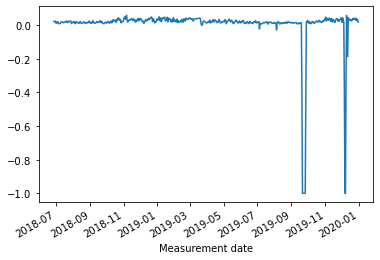

In [329]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

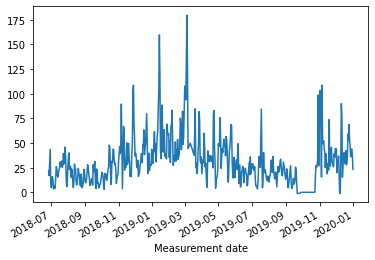

In [330]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

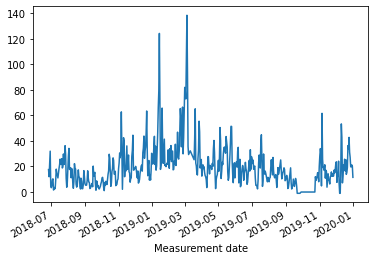

In [331]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

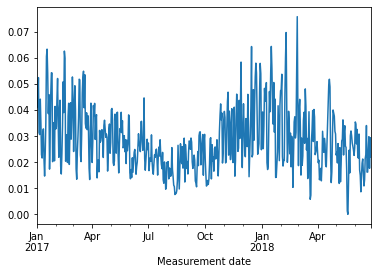

In [332]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

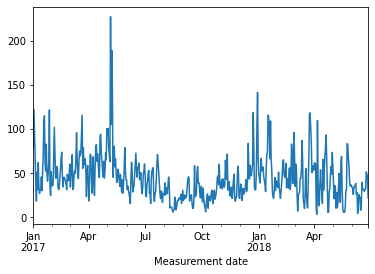

In [333]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

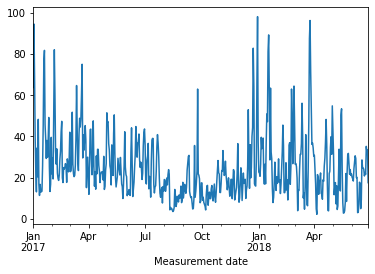

In [334]:
train['PM2.5'].plot()

In [335]:
print(stationarity_check(df_110['PM2.5']))
print(stationarity_check(df_110['PM10']))
print(stationarity_check(df_110['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -5.742010e+00
p-value                        6.244123e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.124832e+00
p-value                        8.679508e-08
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.261193e+00
p-value                        5.078051e-13
#Lags Used                     8.000000e+00
Number of Observations Used    1.076000e+03
Critical Value (1%)           -3.436442e+00
Critical Value (5%)      

# Rolling Mean Difference Train

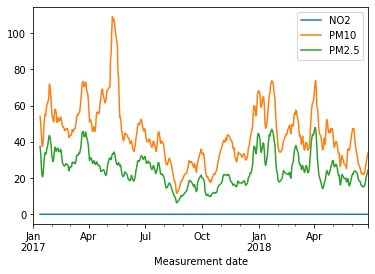

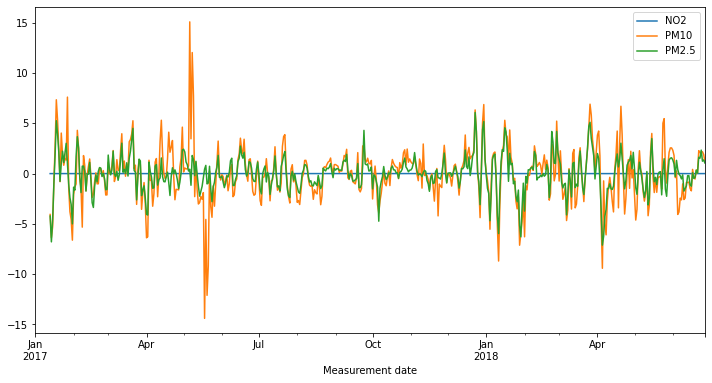

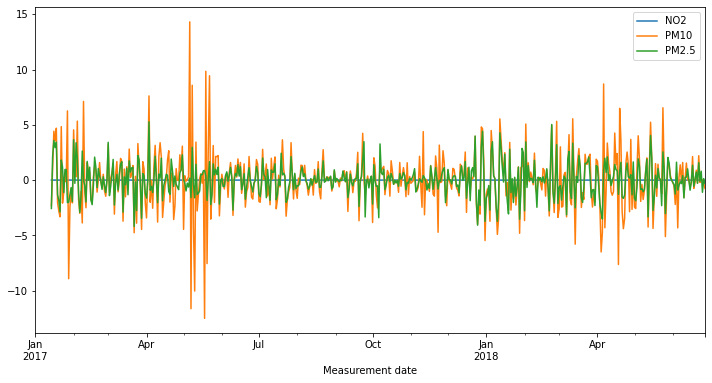

In [336]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [337]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.593276e+00
p-value                        2.498562e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.050967e+00
p-value                        1.742533e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.511140e+00
p-value                        1.099661e-08
#Lags Used                     1.600000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)      

In [338]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.113629e+01
p-value                        3.189198e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.109260e+01
p-value                        4.046883e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.057069e+01
p-value                        7.318655e-19
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

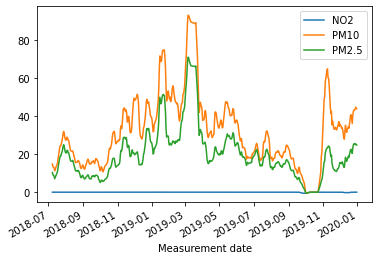

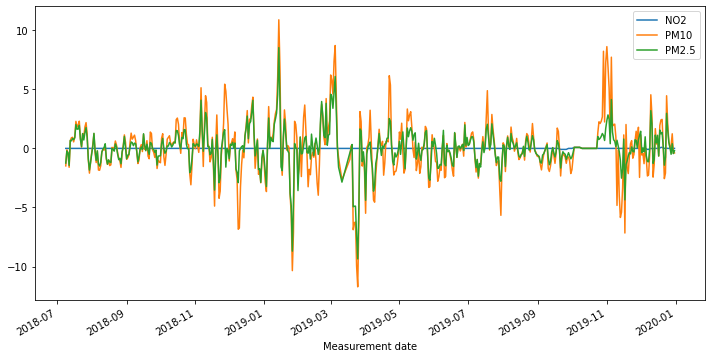

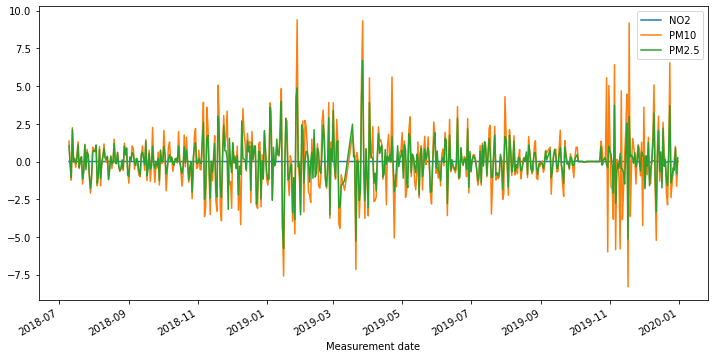

In [339]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [340]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.039290e+00
p-value                        1.358140e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.156441
p-value                          0.000011
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.063179e+00
p-value                        1.198964e-07
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213

In [341]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.878113e+00
p-value                        3.833937e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.139860e+01
p-value                        7.747568e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.464966e+00
p-value                        1.531260e-13
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Station 110 PM2.5

In [342]:
base_model = sm.tsa.statespace.SARIMAX(df_110['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4569.013
Date:                Wed, 20 Oct 2021   AIC                           9142.025
Time:                        14:51:08   BIC                           9152.004
Sample:                             0   HQIC                          9145.803
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     22.1649      0.660     33.598      0.000      20.872      23.458
sigma2       266.2048      7.360     36.170      0.000     251.780     280.630
Ljung-Box (L1) (Q):                 573.66   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8428.869, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10274.655, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8427.668, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9299.443, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8429.297, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8413.467, Time=0.11 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8268.132, Time=0.20 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8362.940, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8262.927, Time=0.29 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8344.112, Time=0.10 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8264.704, Time=0.49 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.61 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8264.092, Time=0.39 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8330.176, Time=0.14 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

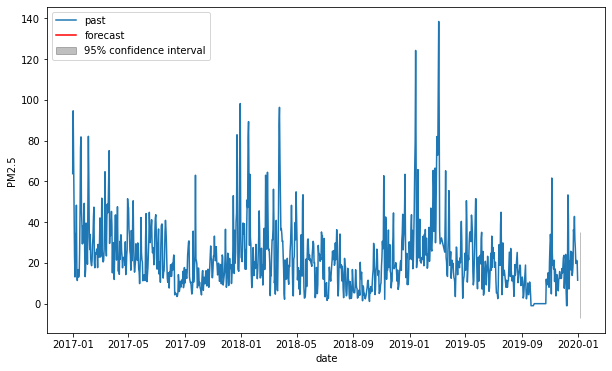

In [343]:
timeseries = df_110['PM2.5']
automodel = arimamodel(df_110['PM2.5'])
plotarima(1, timeseries, automodel)

In [344]:
best_model = sm.tsa.statespace.SARIMAX(df_110['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4122.138
Date:                Wed, 20 Oct 2021   AIC                           8256.276
Time:                        14:51:19   BIC                           8286.212
Sample:                             0   HQIC                          8267.609
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2271      0.138      1.650      0.099      -0.043       0.497
ar.L1          1.3859      0.049     28.523      0.000       1.291       1.481
ar.L2         -0.3958      0.045     -8.710      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [345]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 11.389342841043172
Test RMSE: 21.38393923300091
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2088.693
Date:                Wed, 20 Oct 2021   AIC                           4189.386
Time:                        14:51:19   BIC                           4215.169
Sample:                    01-01-2017   HQIC                          4199.467
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.1174      1.706     14.723      0.000      21.774      28.461
ar.L1         -0.3403      0.145     -2.353      0.019      -0

# Station 110 PM10

In [346]:
base_model = sm.tsa.statespace.SARIMAX(df_110['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5063.560
Date:                Wed, 20 Oct 2021   AIC                          10131.121
Time:                        14:51:19   BIC                          10141.100
Sample:                             0   HQIC                         10134.898
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     37.7694      0.974     38.763      0.000      35.860      39.679
sigma2       662.4035     18.144     36.509      0.000     626.842     697.965
Ljung-Box (L1) (Q):                 546.44   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9461.046, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11375.279, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9492.033, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10458.649, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9335.096, Time=0.25 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9478.143, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9331.680, Time=0.21 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9428.956, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9330.514, Time=0.32 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=9409.575, Time=0.12 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=9332.271, Time=0.45 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9329.604, Time=0.36 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9328.416, Time=0.37 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9330.553, Time=0.23 sec
 ARIMA(3,0,3)(0,0,0)[0]        

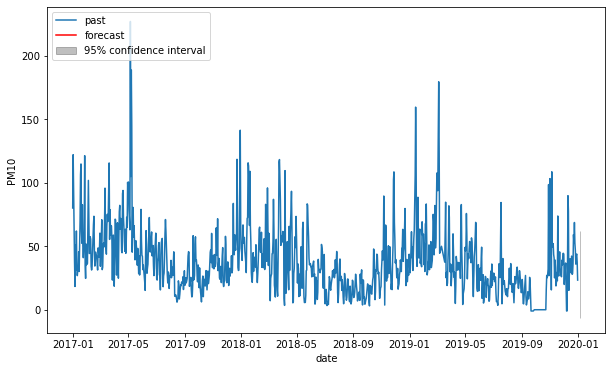

In [347]:
timeseries = df_110['PM10']
automodel = arimamodel(df_110['PM10'])
plotarima(1, timeseries, automodel)

In [348]:
best_model = sm.tsa.statespace.SARIMAX(df_110['PM10'], trend='c', order=[3,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -4654.560
Date:                Wed, 20 Oct 2021   AIC                           9323.121
Time:                        14:51:29   BIC                           9358.046
Sample:                             0   HQIC                          9336.342
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4471      0.263      1.700      0.089      -0.068       0.963
ar.L1          0.6990      0.065     10.819      0.000       0.572       0.826
ar.L2          0.7234      0.107      6.770      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [349]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 19.33942283183201
Test RMSE: 34.93285975804324
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -2378.352
Date:                Wed, 20 Oct 2021   AIC                           4770.704
Time:                        14:51:29   BIC                           4800.783
Sample:                    01-01-2017   HQIC                          4782.465
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.4765      7.249      6.136      0.000      30.269      58.684
ar.L1          0.6243      0.118      5.292      0.000       0.

# Station 110 NO2

In [350]:
base_model = sm.tsa.statespace.SARIMAX(df_110['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                1044.534
Date:                Wed, 20 Oct 2021   AIC                          -2085.068
Time:                        14:51:29   BIC                          -2075.089
Sample:                             0   HQIC                         -2081.290
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0164      0.013      1.298      0.194      -0.008       0.041
sigma2         0.0085      0.000     38.008      0.000       0.008       0.009
Ljung-Box (L1) (Q):                 823.40   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4166.331, Time=0.12 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2053.264, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3615.510, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3292.291, Time=0.16 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4175.543, Time=0.19 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3882.459, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-4190.873, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-4055.122, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-4190.112, Time=0.43 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-4189.421, Time=0.36 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-4198.285, Time=0.36 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-4181.397, Time=0.18 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-4190.780, Time=0.41 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-4190.430, Time=0.24 sec
 ARIMA(3,0,3)(0,0,0

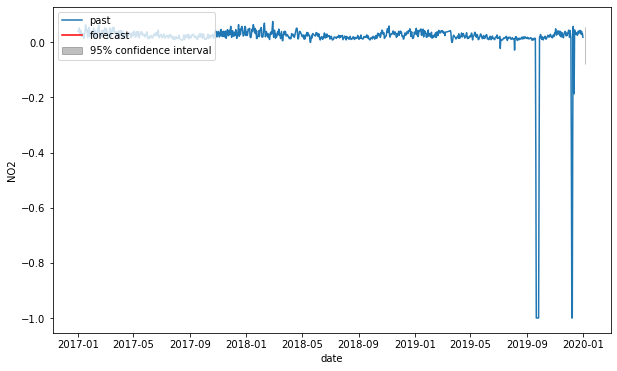

In [351]:
timeseries = df_110['NO2']
automodel = arimamodel(df_110['NO2'])
plotarima(1, timeseries, automodel)

In [352]:
best_model = sm.tsa.statespace.SARIMAX(df_110['NO2'], trend='c', order=[5,0,4])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(5, 0, 4)   Log Likelihood                2122.763
Date:                Wed, 20 Oct 2021   AIC                          -4223.526
Time:                        14:51:45   BIC                          -4168.644
Sample:                             0   HQIC                         -4202.750
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0059      0.005      1.196      0.232      -0.004       0.016
ar.L1          0.8707      0.110      7.886      0.000       0.654       1.087
ar.L2         -0.0470      0.181     -0.260      0.7

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [353]:
model_train = arima_results(train['NO2'],test['NO2'], order=[5,0,4])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.009439799428226866
Test RMSE: 0.13121230988889074
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(5, 0, 4)   Log Likelihood                1761.495
Date:                Wed, 20 Oct 2021   AIC                          -3500.990
Time:                        14:51:45   BIC                          -3453.722
Sample:                    01-01-2017   HQIC                         -3482.508
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0284      0.001     22.724      0.000       0.026       0.031
ar.L1          0.3030      0.698      0.434      0.664    

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 111

In [354]:
df_111 = df[df['Station code'] == 111]

In [355]:
df_111.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,111,0.004917,0.047708,0.002625,0.916667,65.750000,43.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,111,0.005750,0.043375,0.010958,0.929167,98.791667,62.375000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,111,0.006083,0.050417,0.008583,0.866667,101.083333,58.666667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,111,0.005750,0.056250,0.007083,0.945833,60.375000,30.833333,Good,Normal,Good,Good,Normal,Normal
2017-01-05,111,0.004542,0.040375,0.007792,0.645833,50.708333,24.625000,Good,Normal,Good,Good,Normal,Normal


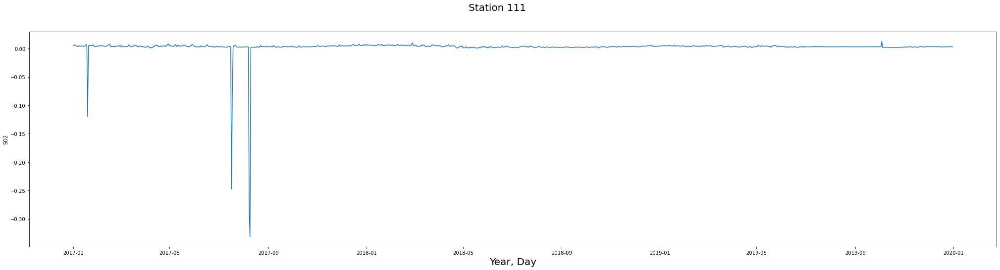

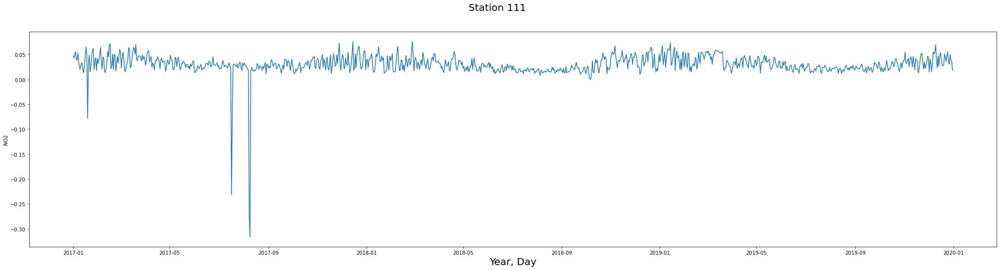

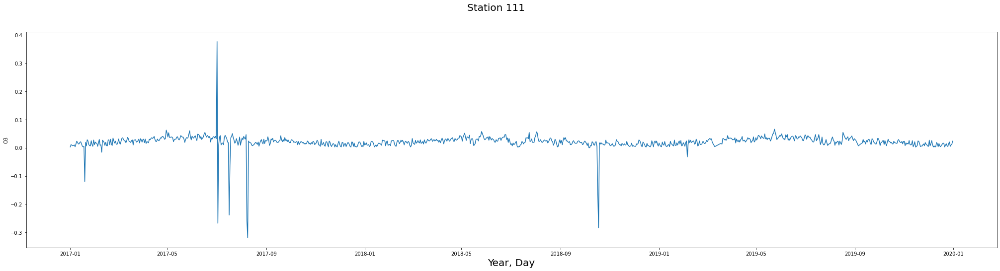

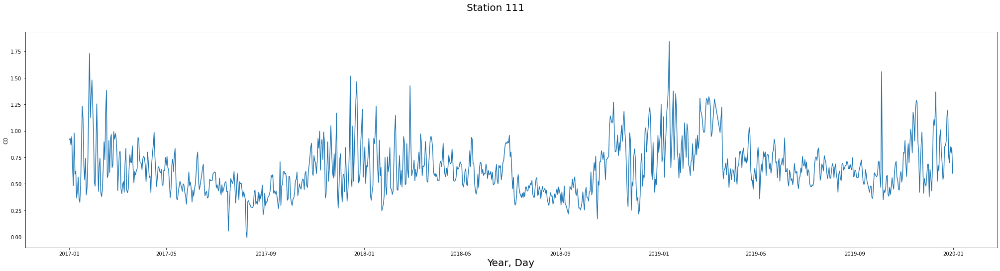

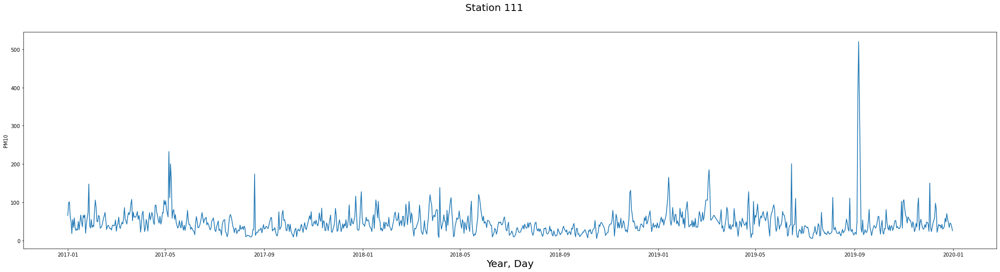

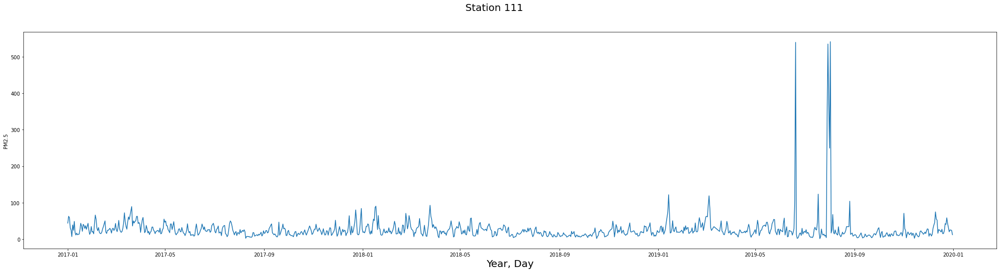

In [356]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 111", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_111)

In [357]:
df_111['NO2 Level'].value_counts()

Good      578
Normal    481
Bad        26
Name: NO2 Level, dtype: int64

In [358]:
df_111['PM10 Level'].value_counts()

Normal      686
Good        310
Bad          78
Very Bad     11
Name: PM10 Level, dtype: int64

In [359]:
df_111['PM2.5 Level'].value_counts()

Normal      561
Good        338
Bad         166
Very Bad     17
Name: PM2.5 Level, dtype: int64

###### For Station 111
- NO2 reaches levels of 'Bad' on 26 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 78 occasions and 'Very Bad' on 11,  and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 166 occasions and 'Very Bad' on 17 occasions.

# Picking the relevant columns

In [360]:
columns = ['NO2', 'PM10', 'PM2.5']
df_111 = df_111[columns]
df_111

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.047708,65.750000,43.708333
2017-01-02,0.043375,98.791667,62.375000
2017-01-03,0.050417,101.083333,58.666667
2017-01-04,0.056250,60.375000,30.833333
2017-01-05,0.040375,50.708333,24.625000
...,...,...,...
2019-12-27,0.030708,34.083333,19.875000
2019-12-28,0.049875,45.750000,25.000000
2019-12-29,0.038875,43.875000,24.541667


# Train-Test Split

In [361]:
train = df_111[:-542]
test = df_111[542:]

<AxesSubplot:xlabel='Measurement date'>

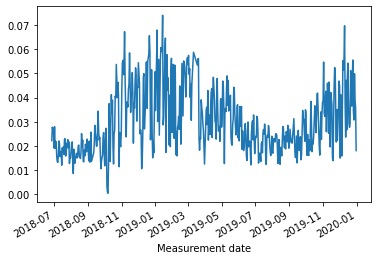

In [362]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

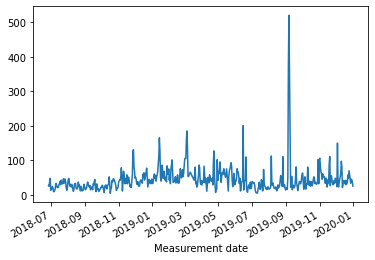

In [363]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

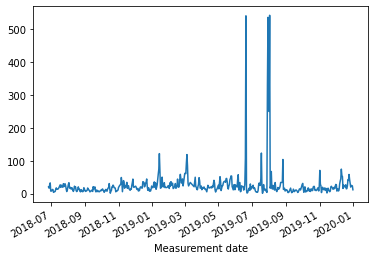

In [364]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

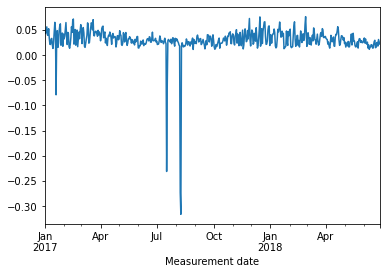

In [365]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

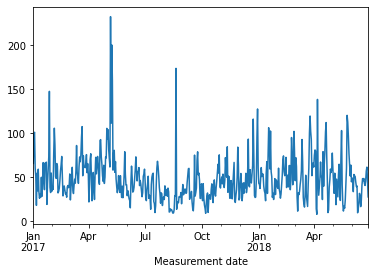

In [366]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

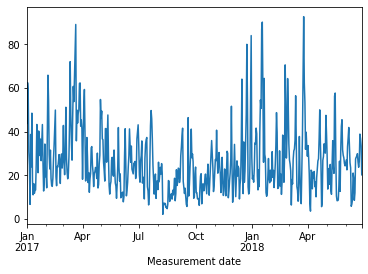

In [367]:
train['PM2.5'].plot()

In [368]:
print(stationarity_check(df_111['PM2.5']))
print(stationarity_check(df_111['PM10']))
print(stationarity_check(df_111['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -1.127003e+01
p-value                        1.545025e-20
#Lags Used                     5.000000e+00
Number of Observations Used    1.079000e+03
Critical Value (1%)           -3.436425e+00
Critical Value (5%)           -2.864222e+00
Critical Value (10%)          -2.568198e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.786621e+00
p-value                        2.423003e-09
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -3.031527
p-value                           0.032053
#Lags Used                       21.000000
Number of Observations Used    1063.000000
Critical Value (1%)              -3.436517
Critical Value (5%)           

# Rolling Mean Difference Train

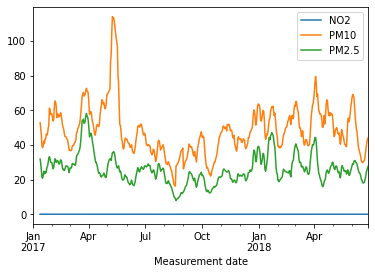

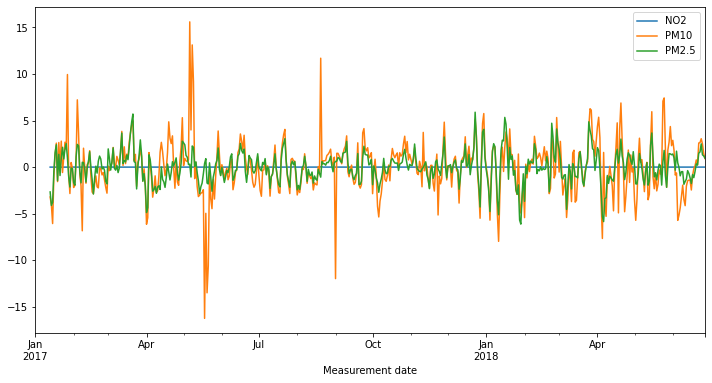

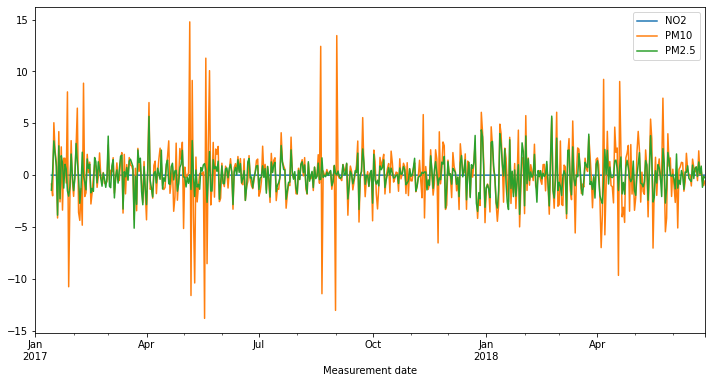

In [369]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [370]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.459547e+00
p-value                        5.399295e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.301344e+00
p-value                        4.010615e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.014176e+01
p-value                        8.384507e-18
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)      

In [371]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.495642e+00
p-value                        1.278137e-13
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.864277e+00
p-value                        4.153867e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.094054e+01
p-value                        9.320748e-20
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

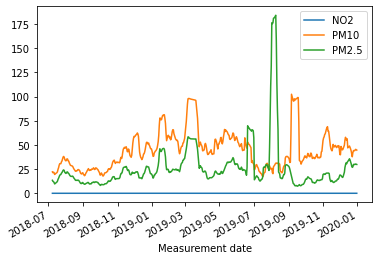

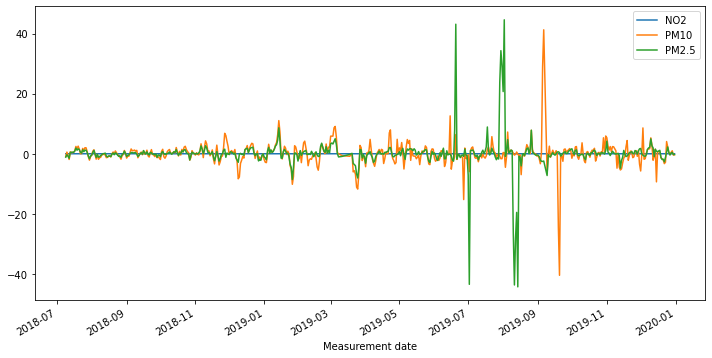

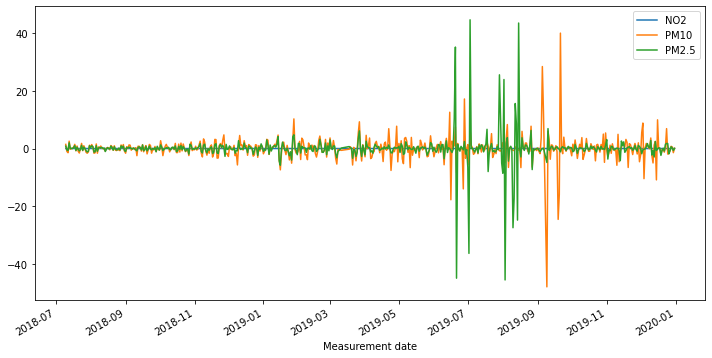

In [372]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [373]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.089856e+00
p-value                        4.439237e-10
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.377231e+00
p-value                        2.566632e-13
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.252504e+00
p-value                        4.418943e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [374]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.016861e+01
p-value                        7.187928e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.499022e+00
p-value                        3.485544e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.024718e+01
p-value                        4.585116e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Station 111 PM2.5

In [375]:
base_model = sm.tsa.statespace.SARIMAX(df_111['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5394.606
Date:                Wed, 20 Oct 2021   AIC                          10793.213
Time:                        14:51:49   BIC                          10803.191
Sample:                             0   HQIC                         10796.990
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     25.8591      2.309     11.198      0.000      21.333      30.385
sigma2      1219.3798     13.448     90.677      0.000    1193.023    1245.736
Ljung-Box (L1) (Q):                 322.12   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10477.427, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11265.590, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10520.952, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10800.902, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=inf, Time=0.35 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10469.697, Time=0.08 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10694.934, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10469.795, Time=0.14 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=10470.738, Time=0.10 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=10590.880, Time=0.09 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=10471.355, Time=0.16 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=10408.092, Time=0.23 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=10468.567, Time=0.15 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10407.304, Time=0.11 sec
 ARIMA(0,0,1)(0,0,0)[0] i

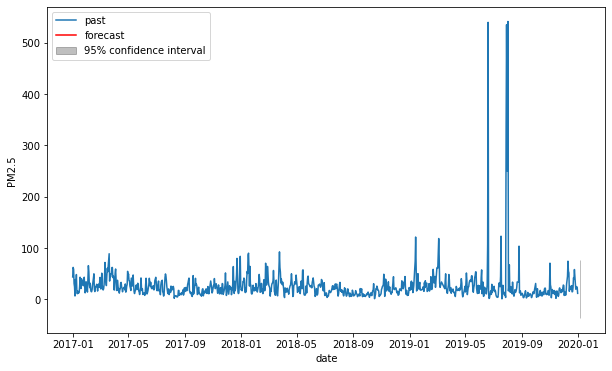

In [376]:
timeseries = df_111['PM2.5']
automodel = arimamodel(df_111['PM2.5'])
plotarima(1, timeseries, automodel)

In [377]:
best_model = sm.tsa.statespace.SARIMAX(df_111['PM2.5'], trend='c', order=[4,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packa

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(4, 0, 2)   Log Likelihood               -5182.659
Date:                Wed, 20 Oct 2021   AIC                          10381.318
Time:                        14:51:59   BIC                          10421.232
Sample:                             0   HQIC                         10396.428
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     14.3829      2.755      5.221      0.000       8.984      19.782
ar.L1          0.7263      0.175      4.153      0.000       0.384       1.069
ar.L2         -0.6100      0.125     -4.899      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [378]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[4,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 11.148385729742964
Test RMSE: 48.73119851346316
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(4, 0, 2)   Log Likelihood               -2079.414
Date:                Wed, 20 Oct 2021   AIC                           4174.829
Time:                        14:51:59   BIC                           4209.206
Sample:                    01-01-2017   HQIC                          4188.270
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.3438      2.566     10.268      0.000      21.315      31.372
ar.L1          0.7211      0.091      7.895      0.000       0

# Station 111 PM10

In [379]:
base_model = sm.tsa.statespace.SARIMAX(df_111['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5282.018
Date:                Wed, 20 Oct 2021   AIC                          10568.036
Time:                        14:51:59   BIC                          10578.015
Sample:                             0   HQIC                         10571.814
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     45.8709      1.286     35.671      0.000      43.350      48.391
sigma2       990.8486     10.263     96.542      0.000     970.733    1010.965
Ljung-Box (L1) (Q):                 295.71   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10395.142, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11801.825, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10435.456, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11031.129, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10434.063, Time=0.17 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10213.788, Time=0.13 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10810.060, Time=0.11 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10207.044, Time=0.22 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10206.780, Time=0.59 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10211.780, Time=0.29 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=10209.932, Time=0.57 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=10207.822, Time=0.40 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=10216.957, Time=0.31 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=10209.077, Time=0.27 sec
 ARIMA(4,0,3)(0,0,0

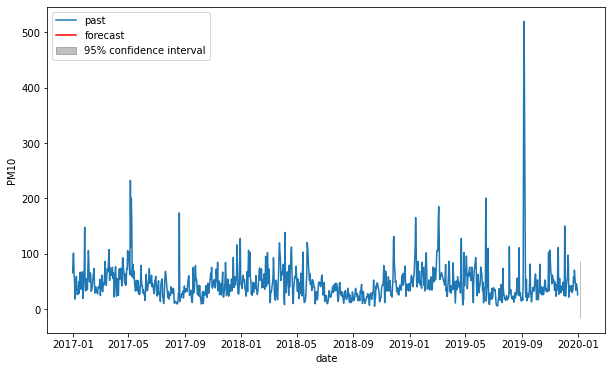

In [380]:
timeseries = df_111['PM10']
automodel = arimamodel(df_111['PM10'])
plotarima(1, timeseries, automodel)

In [381]:
best_model = sm.tsa.statespace.SARIMAX(df_111['PM10'], trend='c', order=[1,0,4])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(1, 0, 4)   Log Likelihood               -5092.887
Date:                Wed, 20 Oct 2021   AIC                          10199.774
Time:                        14:55:34   BIC                          10234.699
Sample:                             0   HQIC                         10212.995
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.8367      1.550      1.185      0.236      -1.200       4.874
ar.L1          0.9596      0.033     28.880      0.000       0.894       1.025
ma.L1         -0.4037      0.033    -12.344      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [382]:
model_train = arima_results(train['PM10'],test['PM10'], order=[1,0,4])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 21.766786631906697
Test RMSE: 40.232663994739454
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(1, 0, 4)   Log Likelihood               -2443.191
Date:                Wed, 20 Oct 2021   AIC                           4900.382
Time:                        14:55:34   BIC                           4930.461
Sample:                    01-01-2017   HQIC                          4912.143
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         48.3555      4.504     10.737      0.000      39.529      57.182
ar.L1          0.9547      0.048     19.973      0.000       

# Station 111 NO2

In [383]:
base_model = sm.tsa.statespace.SARIMAX(df_111['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2645.621
Date:                Wed, 20 Oct 2021   AIC                          -5287.243
Time:                        14:55:34   BIC                          -5277.264
Sample:                             0   HQIC                         -5283.465
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0303      0.001     31.116      0.000       0.028       0.032
sigma2         0.0004   3.64e-06    122.513      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 274.92   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5430.640, Time=0.19 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4074.836, Time=0.04 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5383.786, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4901.819, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-5405.961, Time=0.26 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-5698.771, Time=0.35 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5084.507, Time=0.12 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-5694.813, Time=0.34 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-5697.289, Time=0.47 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5192.885, Time=0.62 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-5694.881, Time=0.35 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-5683.870, Time=0.45 sec

Best model:  ARIMA(1,0,2)(0,0,0)[0]          
Total fit time: 3.303 seconds


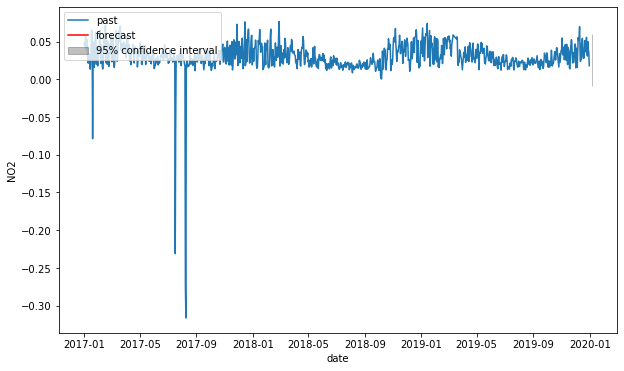

In [384]:
timeseries = df_111['NO2']
automodel = arimamodel(df_111['NO2'])
plotarima(1, timeseries, automodel)

In [385]:
best_model = sm.tsa.statespace.SARIMAX(df_111['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                2846.935
Date:                Wed, 20 Oct 2021   AIC                          -5683.870
Time:                        14:55:38   BIC                          -5658.924
Sample:                             0   HQIC                         -5674.426
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0026      0.002      1.112      0.266      -0.002       0.007
ar.L1          0.9161      0.073     12.524      0.000       0.773       1.059
ma.L1         -0.3308      0.076     -4.346      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [386]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.022872641031930672
Test RMSE: 0.020876848915403645
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1280.741
Date:                Wed, 20 Oct 2021   AIC                          -2551.481
Time:                        14:55:39   BIC                          -2529.996
Sample:                    01-01-2017   HQIC                         -2543.080
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0305      0.003     10.298      0.000       0.025       0.036
ar.L1          0.2934      0.741      0.396      0.692   

# Station 112

In [387]:
df_112 = df[df['Station code'] == 112]

In [388]:
df_112.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,112,0.004875,0.046375,0.002625,0.858333,78.166667,65.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,112,0.008542,0.033792,0.022875,0.966667,102.916667,85.291667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,112,0.006000,0.038917,0.014958,0.729167,77.875000,59.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,112,0.006667,0.044125,0.013792,0.808333,43.583333,33.291667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,112,0.005000,0.030375,0.013458,0.591667,27.500000,20.291667,Good,Normal,Good,Good,Good,Normal


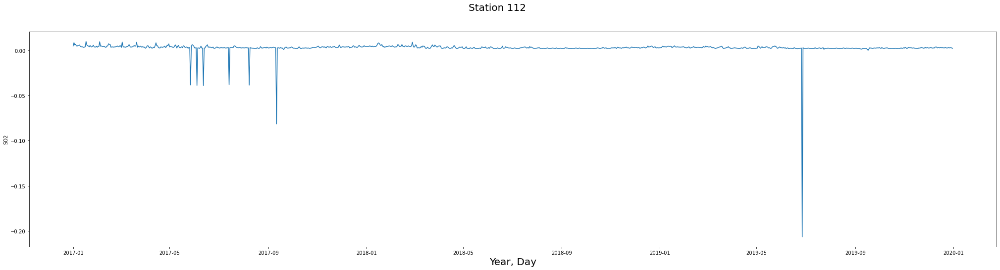

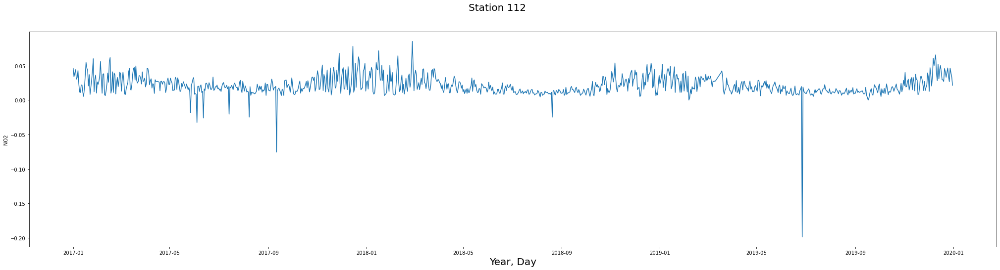

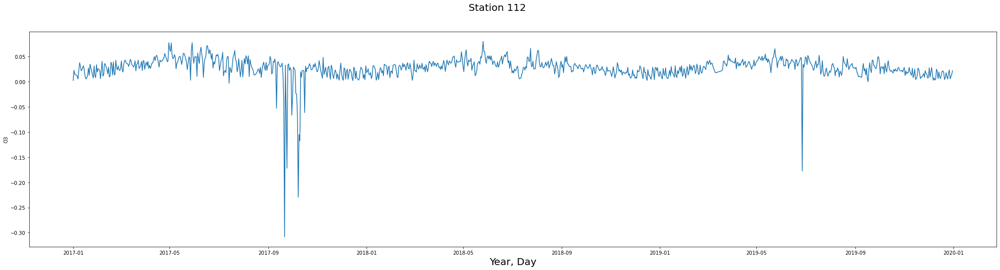

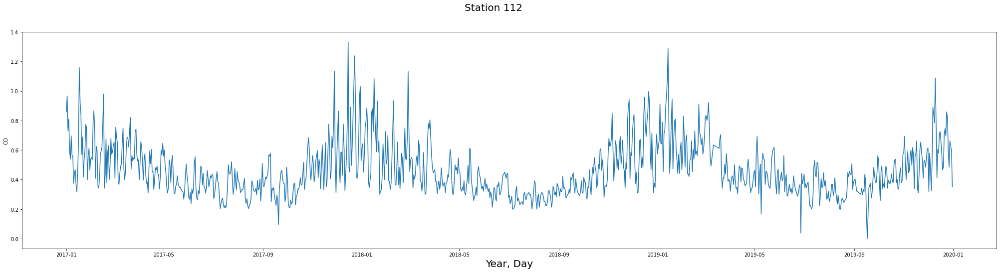

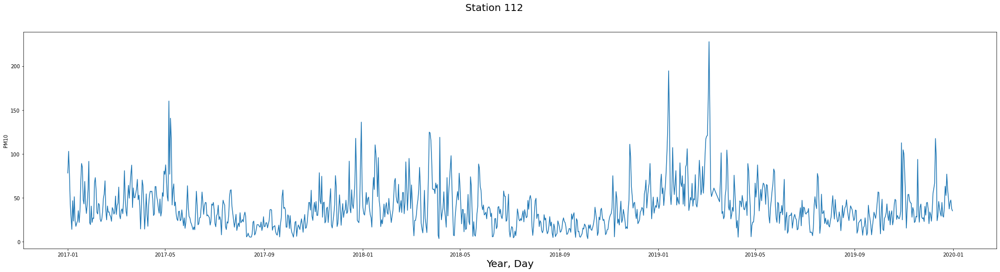

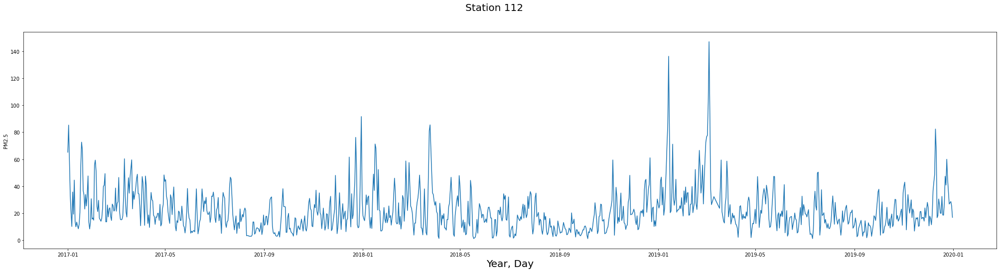

In [389]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 112", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_112)

In [390]:
df_112['NO2 Level'].value_counts()

Good      853
Normal    222
Bad        10
Name: NO2 Level, dtype: int64

In [391]:
df_112['PM10 Level'].value_counts()

Normal      569
Good        449
Bad          63
Very Bad      4
Name: PM10 Level, dtype: int64

In [392]:
df_112['PM2.5 Level'].value_counts()

Normal      531
Good        396
Bad         144
Very Bad     14
Name: PM2.5 Level, dtype: int64

###### For Station 112
- NO2 reaches levels of 'Bad' on 10 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 63 occasions and 'Very Bad' on 4, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 144 occasions and 'Very Bad' on 14 occasions.

# Picking the relevant columns

In [393]:
columns = ['NO2', 'PM10', 'PM2.5']
df_112 = df_112[columns]
df_112

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.046375,78.166667,65.208333
2017-01-02,0.033792,102.916667,85.291667
2017-01-03,0.038917,77.875000,59.791667
2017-01-04,0.044125,43.583333,33.291667
2017-01-05,0.030375,27.500000,20.291667
...,...,...,...
2019-12-27,0.026667,37.250000,26.875000
2019-12-28,0.046500,44.708333,27.791667
2019-12-29,0.039542,47.416667,28.708333


# Train-Test Split

In [394]:
train = df_112[:-542]
test = df_112[542:]

<AxesSubplot:xlabel='Measurement date'>

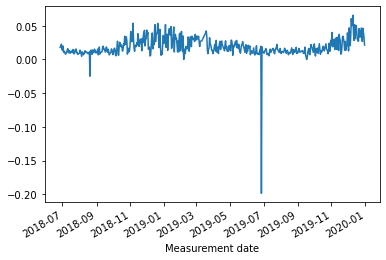

In [395]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

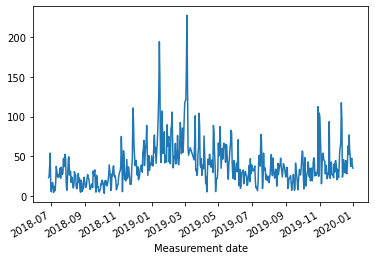

In [396]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

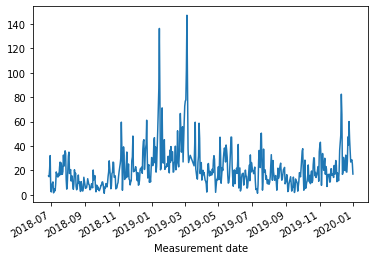

In [397]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

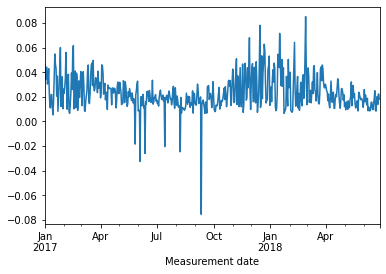

In [398]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

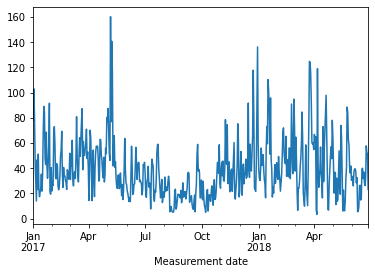

In [399]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

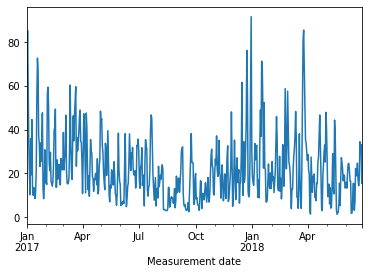

In [400]:
train['PM2.5'].plot()

In [401]:
print(stationarity_check(df_112['PM2.5']))
print(stationarity_check(df_112['PM10']))
print(stationarity_check(df_112['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -5.188564
p-value                           0.000009
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.772261e+00
p-value                        5.358412e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -3.115799
p-value                           0.025406
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)              -2.8

# Rolling Mean Difference Train

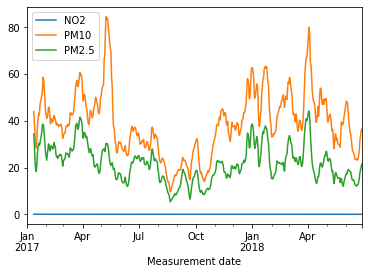

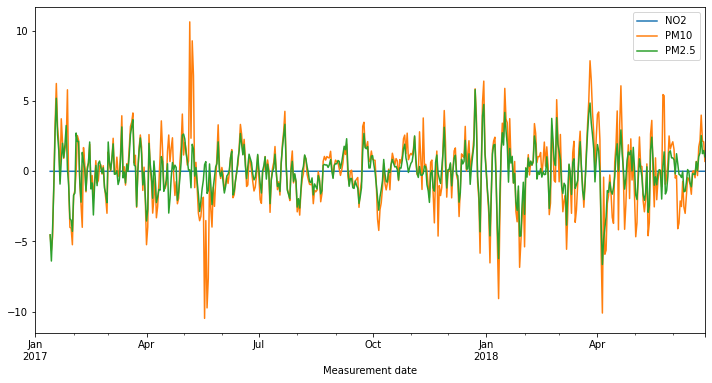

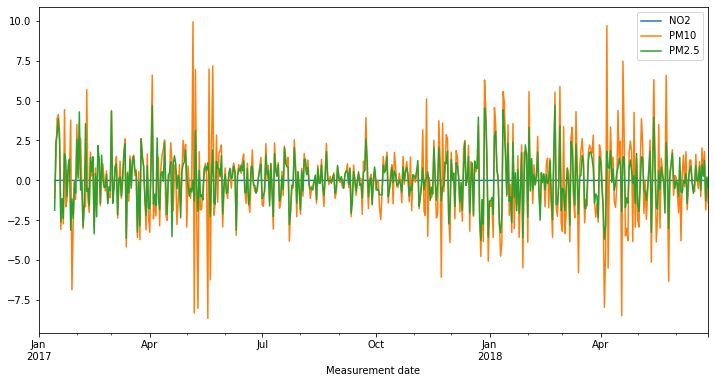

In [402]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [403]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.976100e+00
p-value                        2.699851e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.454641e+00
p-value                        1.627258e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.696964e+00
p-value                        1.097794e-16
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [404]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.069035e+01
p-value                        3.739816e-19
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.033955e+01
p-value                        2.707638e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.016397e+01
p-value                        7.381986e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

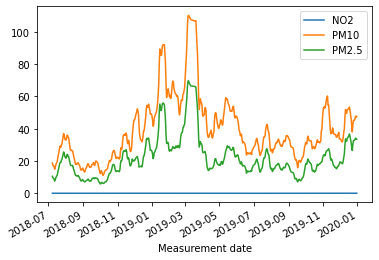

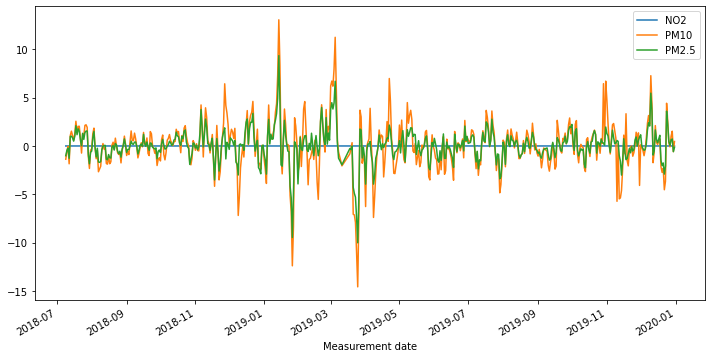

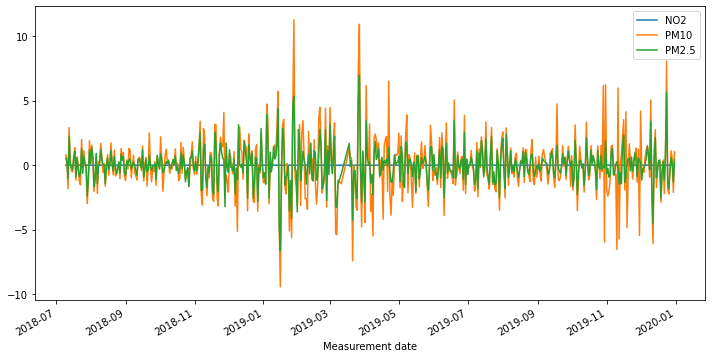

In [405]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [406]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.164865e+00
p-value                        7.029766e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.629440e+00
p-value                        2.027234e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.062176e+01
p-value                        5.492450e-19
#Lags Used                     1.100000e+01
Number of Observations Used    5.190000e+02
Critical Value (1%)           -3.443013e+00
Critical Value (5%)      

In [407]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.006148e+01
p-value                        1.329988e-17
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.138673e+01
p-value                        8.255272e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.909501e+00
p-value                        3.196949e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 112 PM2.5

In [408]:
base_model = sm.tsa.statespace.SARIMAX(df_112['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4521.656
Date:                Wed, 20 Oct 2021   AIC                           9047.312
Time:                        14:55:43   BIC                           9057.291
Sample:                             0   HQIC                          9051.090
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     21.7370      0.630     34.514      0.000      20.503      22.971
sigma2       243.9524      5.973     40.840      0.000     232.245     255.660
Ljung-Box (L1) (Q):                 529.09   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8437.376, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10214.222, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8437.517, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9271.778, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8427.567, Time=0.08 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8438.478, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8270.101, Time=0.21 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8375.698, Time=0.06 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8266.703, Time=0.36 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8357.659, Time=0.12 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8268.688, Time=0.50 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=8270.634, Time=0.53 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8267.566, Time=0.35 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8349.061, Time=0.10 sec
 ARIMA(5,0,2)(0,0,0)[0]         

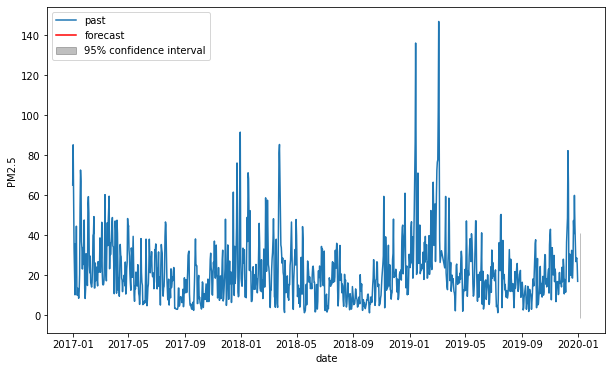

In [409]:
timeseries = df_112['PM2.5']
automodel = arimamodel(df_112['PM2.5'])
plotarima(1, timeseries, automodel)

In [410]:
best_model = sm.tsa.statespace.SARIMAX(df_112['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4123.504
Date:                Wed, 20 Oct 2021   AIC                           8259.008
Time:                        14:55:52   BIC                           8288.944
Sample:                             0   HQIC                          8270.341
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2341      0.170      1.378      0.168      -0.099       0.567
ar.L1          1.3967      0.052     26.681      0.000       1.294       1.499
ar.L2         -0.4070      0.048     -8.548      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [411]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 11.035767683682915
Test RMSE: 20.141767249569387
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2070.917
Date:                Wed, 20 Oct 2021   AIC                           4153.835
Time:                        14:55:52   BIC                           4179.617
Sample:                    01-01-2017   HQIC                          4163.916
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.6583      3.471      6.528      0.000      15.855      29.462
ar.L1          1.4070      0.070     20.202      0.000       

# Station 112 PM10

In [412]:
base_model = sm.tsa.statespace.SARIMAX(df_112['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5019.138
Date:                Wed, 20 Oct 2021   AIC                          10042.276
Time:                        14:55:52   BIC                          10052.255
Sample:                             0   HQIC                         10046.054
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     38.8595      0.977     39.758      0.000      36.944      40.775
sigma2       610.3241     16.317     37.404      0.000     578.343     642.305
Ljung-Box (L1) (Q):                 498.98   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9497.569, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11391.493, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9515.456, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10466.070, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9515.936, Time=0.15 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9372.591, Time=0.12 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10101.541, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9338.714, Time=0.25 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9339.676, Time=0.40 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9339.743, Time=0.36 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9347.582, Time=0.17 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9341.001, Time=0.21 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9340.446, Time=0.26 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9332.128, Time=0.52 sec
 ARIMA(1,0,2)(0,0,0)[0] interc

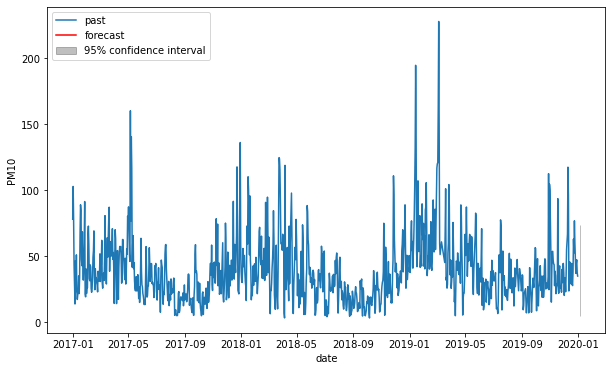

In [413]:
timeseries = df_112['PM10']
automodel = arimamodel(df_112['PM10'])
plotarima(1, timeseries, automodel)

In [414]:
best_model = sm.tsa.statespace.SARIMAX(df_112['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4660.064
Date:                Wed, 20 Oct 2021   AIC                           9332.128
Time:                        14:55:59   BIC                           9362.064
Sample:                             0   HQIC                          9343.460
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3949      0.259      1.526      0.127      -0.112       0.902
ar.L1          1.3705      0.051     27.019      0.000       1.271       1.470
ar.L2         -0.3805      0.047     -8.085      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [415]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 18.082940539674535
Test RMSE: 32.8695373740222
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2341.741
Date:                Wed, 20 Oct 2021   AIC                           4695.482
Time:                        14:55:59   BIC                           4721.265
Sample:                    01-01-2017   HQIC                          4705.563
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         39.3169      5.819      6.757      0.000      27.913      50.721
ar.L1          1.3523      0.069     19.649      0.000       1.

# Station 112 NO2

In [416]:
base_model = sm.tsa.statespace.SARIMAX(df_112['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3059.264
Date:                Wed, 20 Oct 2021   AIC                          -6114.528
Time:                        14:55:59   BIC                          -6104.550
Sample:                             0   HQIC                         -6110.751
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0212      0.000     44.255      0.000       0.020       0.022
sigma2         0.0002   1.89e-06    110.175      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 170.97   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6388.528, Time=0.22 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4869.668, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6018.712, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5467.484, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6413.841, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-6126.266, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6413.994, Time=0.31 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-6234.130, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-6307.612, Time=0.40 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-6412.173, Time=0.41 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6407.257, Time=0.30 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-6268.747, Time=0.04 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-6370.217, Time=0.48 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-6338.739, Time=0.45 sec

Best model:  ARIMA

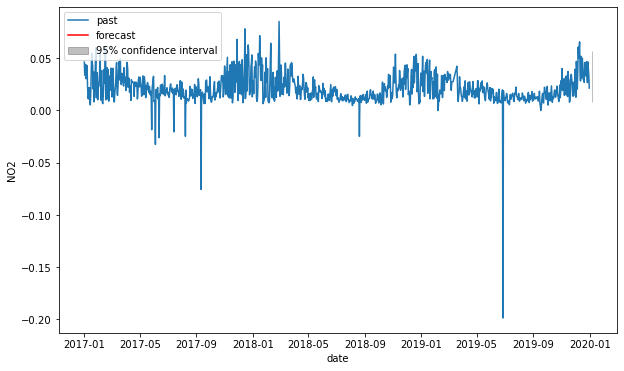

In [417]:
timeseries = df_112['NO2']
automodel = arimamodel(df_112['NO2'])
plotarima(1, timeseries, automodel)

In [418]:
best_model = sm.tsa.statespace.SARIMAX(df_112['NO2'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood                3175.370
Date:                Wed, 20 Oct 2021   AIC                          -6338.739
Time:                        14:56:03   BIC                          -6308.803
Sample:                             0   HQIC                         -6327.406
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0105      0.003      4.033      0.000       0.005       0.016
ar.L1          0.2492      0.188      1.327      0.184      -0.119       0.617
ar.L2          0.0753      0.076      0.986      0.3

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [419]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.012686980526445386
Test RMSE: 0.01760344451414729
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 1)   Log Likelihood                1601.069
Date:                Wed, 20 Oct 2021   AIC                          -3190.137
Time:                        14:56:03   BIC                          -3164.355
Sample:                    01-01-2017   HQIC                         -3180.056
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0233      0.001     22.389      0.000       0.021       0.025
ar.L1          0.2000      0.260      0.768      0.442    

# Station 113

In [420]:
df_113 = df[df['Station code'] == 113]

In [421]:
df_113.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,113,-0.036250,0.008292,-0.038708,0.833333,75.000000,45.083333,Good,Good,Good,Good,Normal,Bad
2017-01-02,113,-0.035292,-0.003375,-0.021250,0.812500,110.833333,67.000000,Good,Good,Good,Good,Bad,Bad
2017-01-03,113,0.006708,0.043875,0.016083,0.891667,93.125000,55.583333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,113,-0.035083,0.008333,-0.030708,0.875000,51.500000,30.291667,Good,Good,Good,Good,Normal,Normal
2017-01-05,113,-0.036750,-0.010250,-0.027792,0.541667,40.458333,21.958333,Good,Good,Good,Good,Normal,Normal


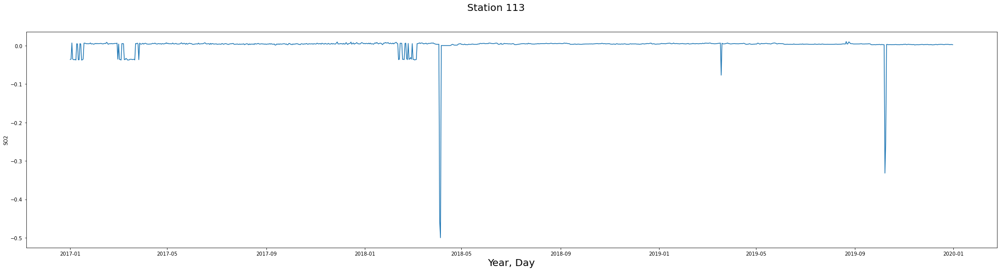

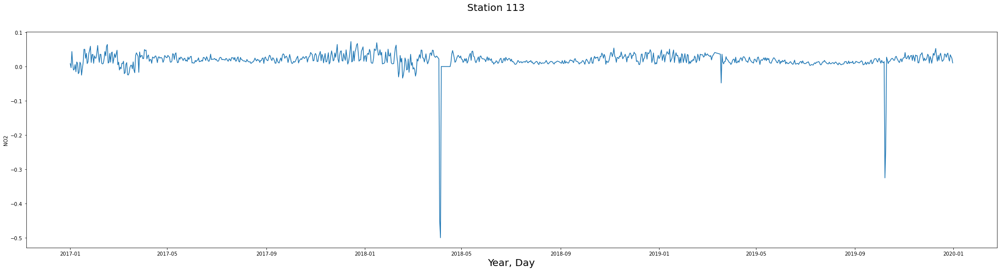

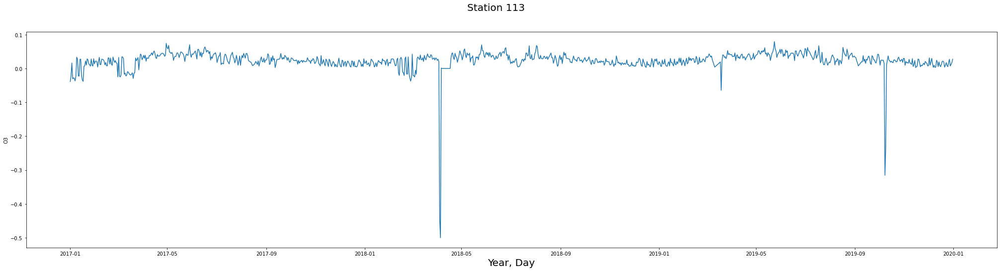

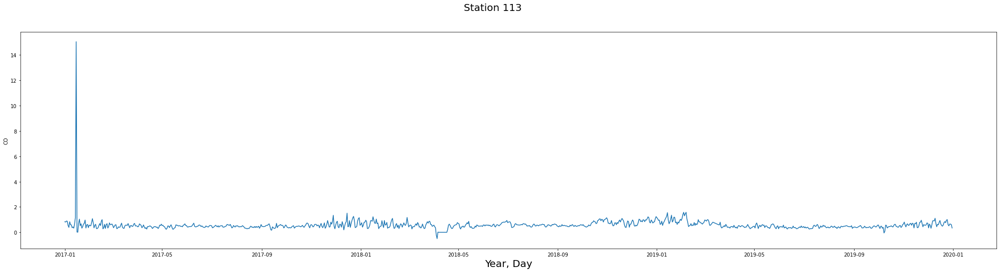

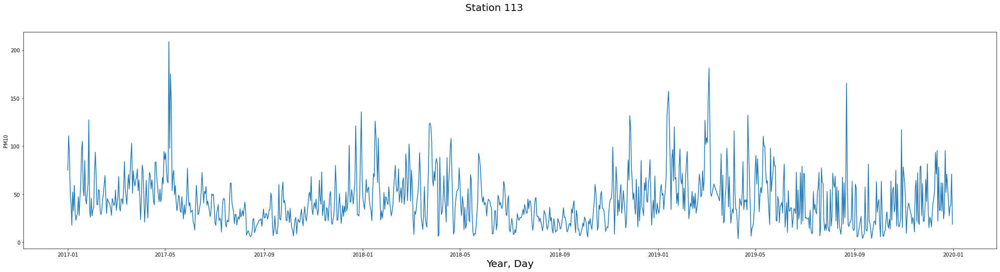

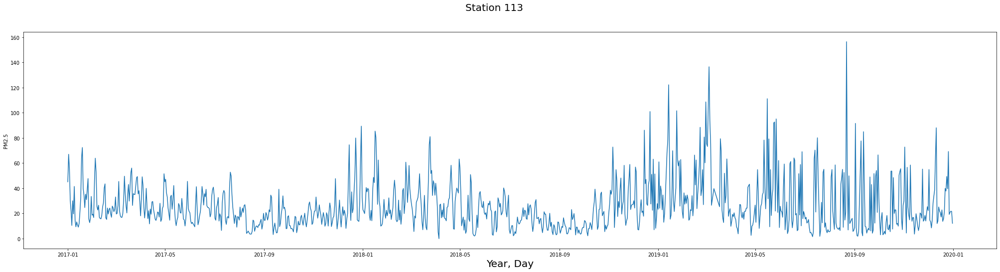

In [422]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 113", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_113)

In [423]:
df_113['NO2 Level'].value_counts()

Good      860
Normal    217
Bad         8
Name: NO2 Level, dtype: int64

In [424]:
df_113['PM10 Level'].value_counts()

Normal      612
Good        380
Bad          87
Very Bad      6
Name: PM10 Level, dtype: int64

In [425]:
df_113['PM2.5 Level'].value_counts()

Normal      495
Good        340
Bad         219
Very Bad     31
Name: PM2.5 Level, dtype: int64

##### For Station 113
- NO2 reaches levels of 'Bad' on 8 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 87 occasions and 'Very Bad' on 6, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 219 occasions and 'Very Bad' on 31 occasions.

# Picking the relevant columns

In [426]:
columns = ['NO2', 'PM10', 'PM2.5']
df_113 = df_113[columns]
df_113

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.008292,75.000000,45.083333
2017-01-02,-0.003375,110.833333,67.000000
2017-01-03,0.043875,93.125000,55.583333
2017-01-04,0.008333,51.500000,30.291667
2017-01-05,-0.010250,40.458333,21.958333
...,...,...,...
2019-12-27,0.016000,27.500000,19.166667
2019-12-28,0.034333,37.208333,20.750000
2019-12-29,0.029042,39.000000,21.708333


# Train-Test Split

In [427]:
train = df_113[:-542]
test = df_113[542:]

<AxesSubplot:xlabel='Measurement date'>

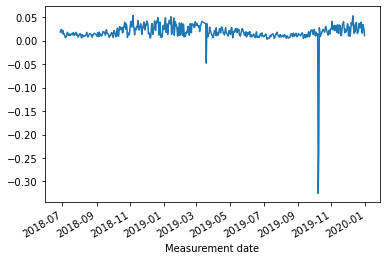

In [428]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

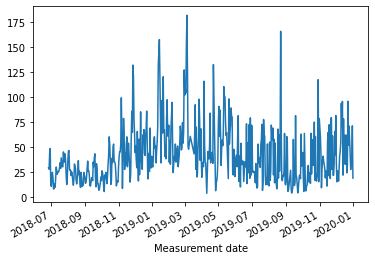

In [429]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

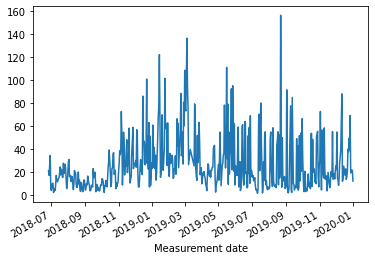

In [430]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

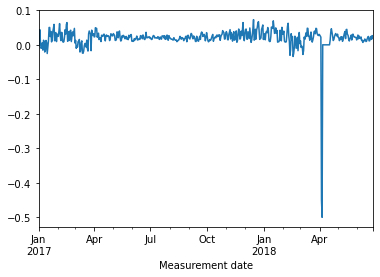

In [431]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

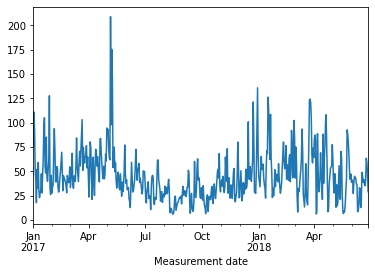

In [432]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

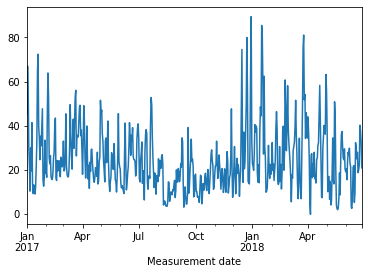

In [433]:
train['PM2.5'].plot()

In [434]:
print(stationarity_check(df_113['PM2.5']))
print(stationarity_check(df_113['PM10']))
print(stationarity_check(df_113['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -6.148354e+00
p-value                        7.669093e-08
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -5.340103
p-value                           0.000005
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.748111e+00
p-value                        8.152305e-17
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2

# Rolling Mean Difference Train

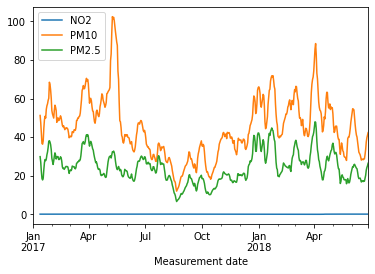

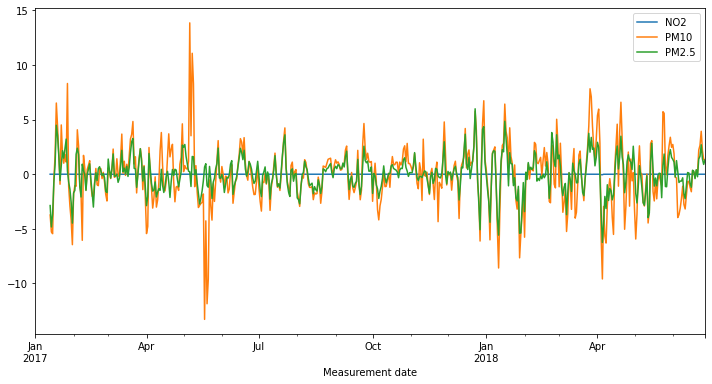

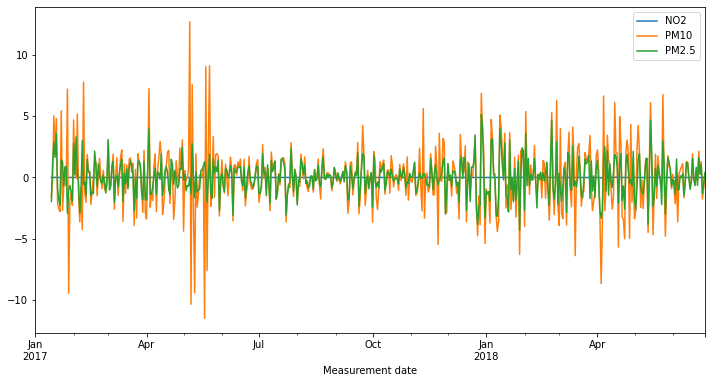

In [435]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [436]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.675325e+00
p-value                        1.554350e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.464317e+00
p-value                        1.537126e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.830959e+00
p-value                        1.894284e-09
#Lags Used                     1.700000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

In [437]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.023630e+01
p-value                        4.879270e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.038834e+01
p-value                        2.051939e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.580277e+00
p-value                        2.167786e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

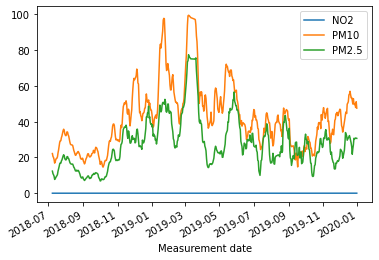

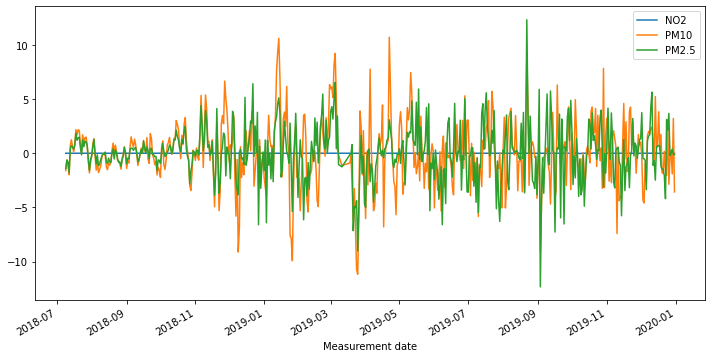

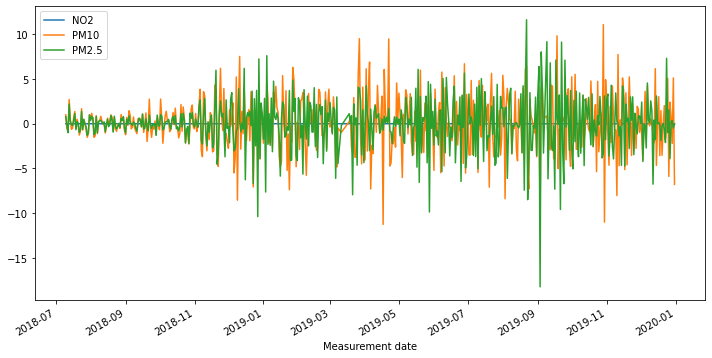

In [438]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [439]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.227956e+00
p-value                        6.172857e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.616282
p-value                          0.000001
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.591666e+00
p-value                        2.521910e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [440]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.890492e+00
p-value                        3.568746e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.004850e+01
p-value                        1.433153e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.931709e+00
p-value                        2.811604e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 113 PM2.5

In [441]:
base_model = sm.tsa.statespace.SARIMAX(df_113['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4753.347
Date:                Wed, 20 Oct 2021   AIC                           9510.695
Time:                        14:56:07   BIC                           9520.673
Sample:                             0   HQIC                          9514.472
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     25.8486      0.807     32.033      0.000      24.267      27.430
sigma2       373.9243     11.860     31.528      0.000     350.679     397.169
Ljung-Box (L1) (Q):                 256.82   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9288.132, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10620.726, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9436.705, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10003.491, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9194.082, Time=0.18 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9366.042, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9195.338, Time=0.25 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9195.313, Time=0.28 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9213.433, Time=0.13 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9330.111, Time=0.05 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.33 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9186.125, Time=0.46 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9210.477, Time=0.15 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9213.695, Time=0.09 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   

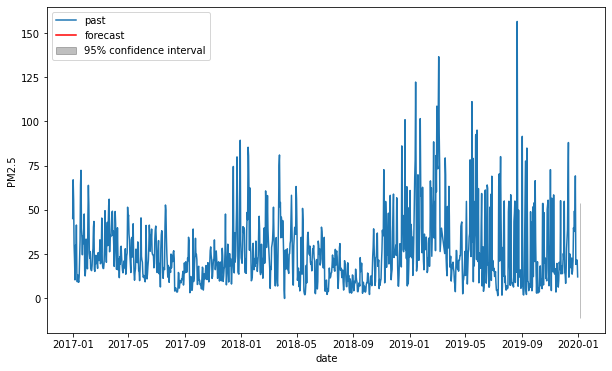

In [442]:
timeseries = df_113['PM2.5']
automodel = arimamodel(df_113['PM2.5'])
plotarima(1, timeseries, automodel)

In [443]:
best_model = sm.tsa.statespace.SARIMAX(df_113['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4588.063
Date:                Wed, 20 Oct 2021   AIC                           9186.125
Time:                        14:56:12   BIC                           9211.072
Sample:                             0   HQIC                          9195.569
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3747      0.269      1.394      0.163      -0.152       0.902
ar.L1          1.3442      0.037     36.522      0.000       1.272       1.416
ar.L2         -0.3586      0.030    -11.806      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [444]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,1])

Train RMSE: 10.725189598792822
Test RMSE: 25.77925164768129
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2058.153
Date:                Wed, 20 Oct 2021   AIC                           4126.307
Time:                        14:56:12   BIC                           4147.792
Sample:                    01-01-2017   HQIC                          4134.708
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.7156      1.389     17.799      0.000      21.994      27.437
ar.L1          0.5480      0.181      3.026      0.002       0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 113 NO2

In [445]:
base_model = sm.tsa.statespace.SARIMAX(df_113['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2327.964
Date:                Wed, 20 Oct 2021   AIC                          -4651.928
Time:                        14:56:12   BIC                          -4641.949
Sample:                             0   HQIC                         -4648.150
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0190      0.002     11.174      0.000       0.016       0.022
sigma2         0.0008   6.81e-06    117.679      0.000       0.001       0.001
Ljung-Box (L1) (Q):                 288.56   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4965.728, Time=0.27 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4251.847, Time=0.04 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-4883.287, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4911.196, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4998.511, Time=0.26 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4898.361, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-5030.118, Time=0.27 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-5018.587, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-5039.578, Time=0.39 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-5017.072, Time=0.10 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-5061.837, Time=0.49 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-5067.856, Time=0.14 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-5131.907, Time=0.26 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-5110.230, Time=0.20 sec
 ARIMA(5,0,1)(0,0,0

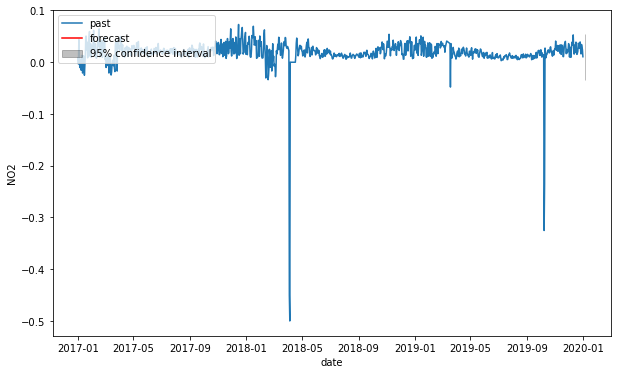

In [446]:
timeseries = df_113['NO2']
automodel = arimamodel(df_113['NO2'])
plotarima(1, timeseries, automodel)

In [447]:
best_model = sm.tsa.statespace.SARIMAX(df_113['NO2'], trend='c', order=[5,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(5, 0, 1)   Log Likelihood                2575.786
Date:                Wed, 20 Oct 2021   AIC                          -5135.573
Time:                        14:56:19   BIC                          -5095.658
Sample:                             0   HQIC                         -5120.463
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0131      0.002      6.638      0.000       0.009       0.017
ar.L1          0.2246      0.114      1.966      0.049       0.001       0.449
ar.L2         -0.1026      0.084     -1.225      0.2

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [448]:
model_train = arima_results(train['NO2'],test['NO2'], order=[5,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.026526354153220785
Test RMSE: 0.023745611546661362
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(5, 0, 2)   Log Likelihood                1200.175
Date:                Wed, 20 Oct 2021   AIC                          -2382.350
Time:                        14:56:20   BIC                          -2343.676
Sample:                    01-01-2017   HQIC                         -2367.229
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0198      0.005      4.012      0.000       0.010       0.030
ar.L1          0.5474      0.460      1.190      0.234   

# Station 113 PM10

In [449]:
base_model = sm.tsa.statespace.SARIMAX(df_113['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5103.765
Date:                Wed, 20 Oct 2021   AIC                          10211.530
Time:                        14:56:20   BIC                          10221.509
Sample:                             0   HQIC                         10215.308
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     43.3477      1.033     41.955      0.000      41.323      45.373
sigma2       713.3589     23.170     30.789      0.000     667.947     758.770
Ljung-Box (L1) (Q):                 361.25   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9851.706, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11609.558, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9967.009, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10826.507, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9742.409, Time=0.17 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9901.761, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9743.532, Time=0.23 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9743.492, Time=0.22 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9777.477, Time=0.11 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9866.765, Time=0.07 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.41 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9738.085, Time=0.53 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9763.159, Time=0.23 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9766.437, Time=0.11 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   

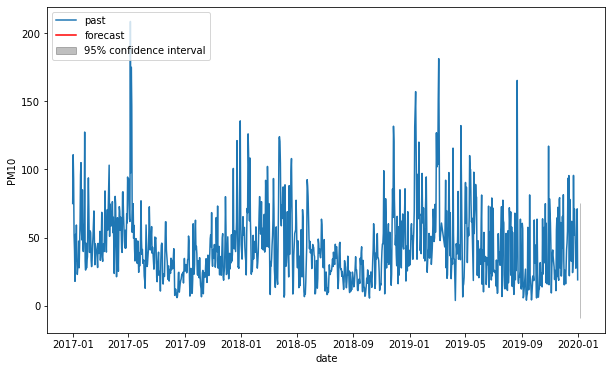

In [450]:
timeseries = df_113['PM10']
automodel = arimamodel(df_113['PM10'])
plotarima(1, timeseries, automodel)

In [451]:
best_model = sm.tsa.statespace.SARIMAX(df_113['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4864.042
Date:                Wed, 20 Oct 2021   AIC                           9738.085
Time:                        14:56:25   BIC                           9763.032
Sample:                             0   HQIC                          9747.529
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.7381      0.454      1.625      0.104      -0.152       1.628
ar.L1          1.4004      0.043     32.894      0.000       1.317       1.484
ar.L2         -0.4176      0.035    -11.879      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [452]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

Train RMSE: 19.6035164504605
Test RMSE: 34.431092824541956
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2386.082
Date:                Wed, 20 Oct 2021   AIC                           4782.163
Time:                        14:56:25   BIC                           4803.649
Sample:                    01-01-2017   HQIC                          4790.564
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.1921      2.849     15.860      0.000      39.607      50.777
ar.L1          0.0183      0.483      0.038      0.970      -0.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

# Station 114

In [453]:
df_114 = df[df['Station code'] == 114]

In [454]:
df_114.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,114,0.007958,0.052375,0.003875,1.191667,82.125000,65.208333,Good,Normal,Good,Good,Bad,Bad
2017-01-02,114,0.007542,0.040375,0.020042,0.912500,105.083333,82.208333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,114,0.006792,0.053958,0.009333,1.037500,84.791667,63.625000,Good,Normal,Good,Good,Bad,Bad
2017-01-04,114,0.006292,0.055250,0.010167,0.945833,49.041667,33.625000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,114,0.006667,0.038000,0.014500,0.812500,36.541667,24.166667,Good,Normal,Good,Good,Normal,Normal


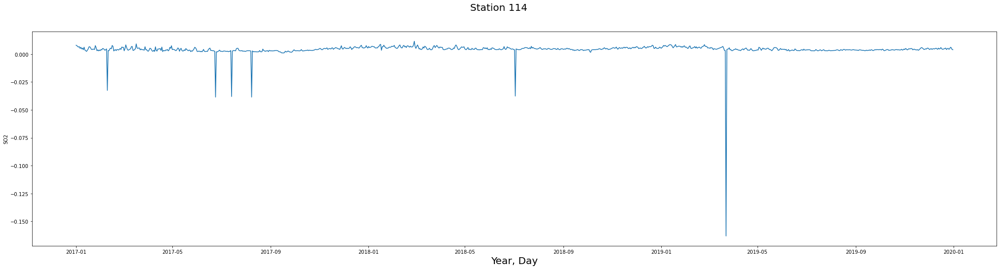

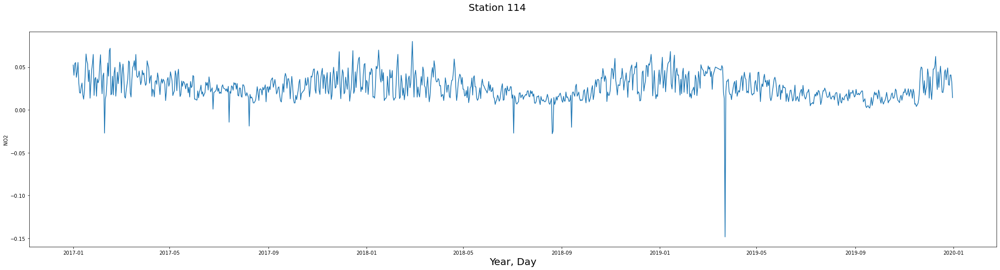

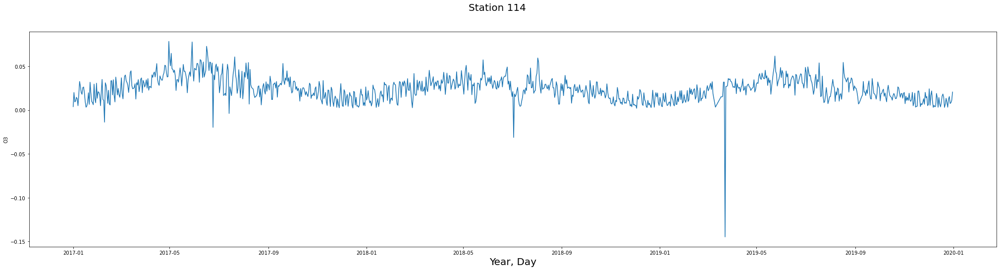

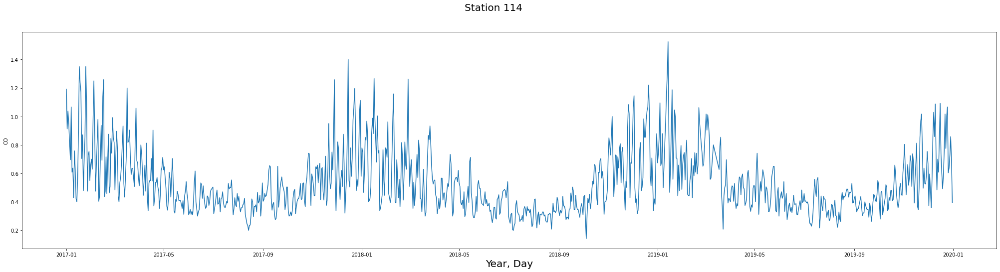

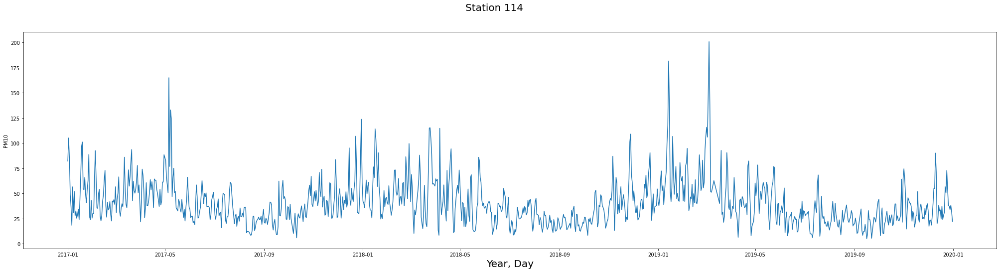

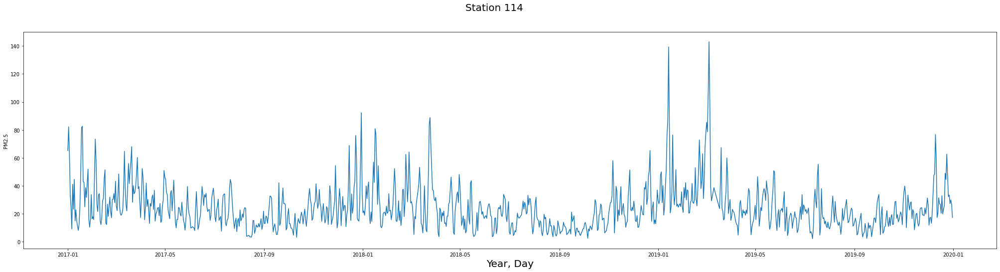

In [455]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 114", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_114)

In [456]:
df_114['NO2 Level'].value_counts()

Good      694
Normal    373
Bad        18
Name: NO2 Level, dtype: int64

In [457]:
df_114['PM10 Level'].value_counts()

Normal      616
Good        407
Bad          59
Very Bad      3
Name: PM10 Level, dtype: int64

In [458]:
df_114['PM2.5 Level'].value_counts()

Normal      577
Good        314
Bad         173
Very Bad     21
Name: PM2.5 Level, dtype: int64

##### For Station 114
- NO2 reaches levels of 'Bad' on 18 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 59 occasions and 'Very Bad' on 3, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 173 occasions and 'Very Bad' on 21 occasions.

# Picking the relevant columns

In [459]:
columns = ['NO2', 'PM10', 'PM2.5']
df_114 = df_114[columns]
df_114

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.052375,82.125000,65.208333
2017-01-02,0.040375,105.083333,82.208333
2017-01-03,0.053958,84.791667,63.625000
2017-01-04,0.055250,49.041667,33.625000
2017-01-05,0.038000,36.541667,24.166667
...,...,...,...
2019-12-27,0.028667,37.375000,33.416667
2019-12-28,0.040708,33.916667,27.250000
2019-12-29,0.040708,38.250000,29.916667


In [460]:
train = df_114[:-542]
test = df_114[542:]

<AxesSubplot:xlabel='Measurement date'>

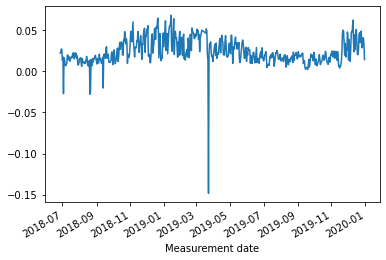

In [461]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

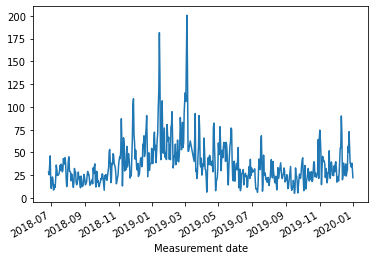

In [462]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

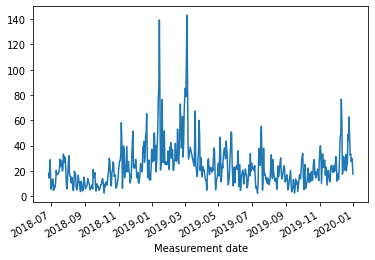

In [463]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

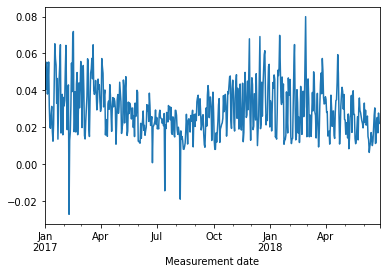

In [464]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

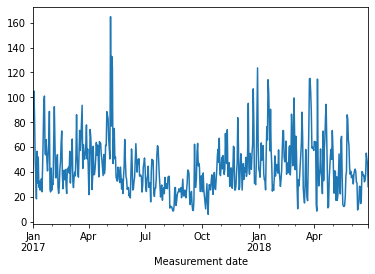

In [465]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

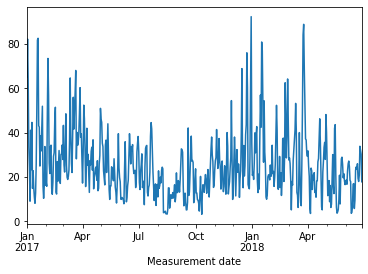

In [466]:
train['PM2.5'].plot()

In [467]:
print(stationarity_check(df_114['PM2.5']))
print(stationarity_check(df_114['PM10']))
print(stationarity_check(df_114['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -4.848068
p-value                           0.000044
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -5.566635
p-value                           0.000001
#Lags Used                       10.000000
Number of Observations Used    1074.000000
Critical Value (1%)              -3.436453
Critical Value (5%)              -2.864235
Critical Value (10%)             -2.568205
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -3.409940
p-value                           0.010625
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)              -2.864253
C

# Rolling Mean Difference Train

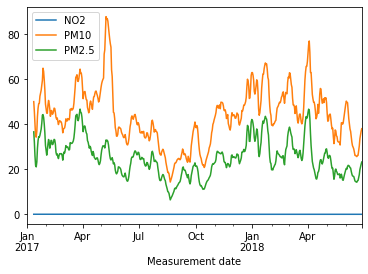

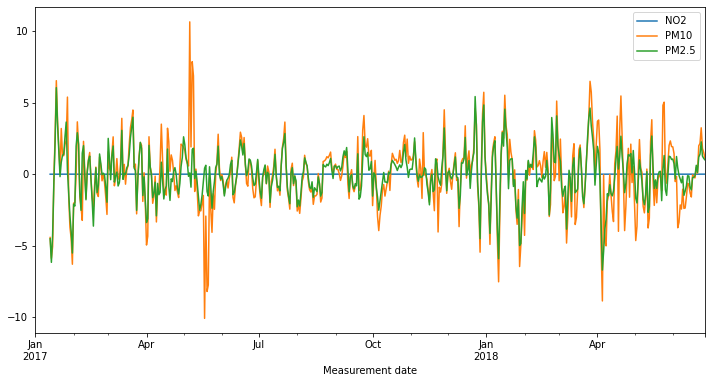

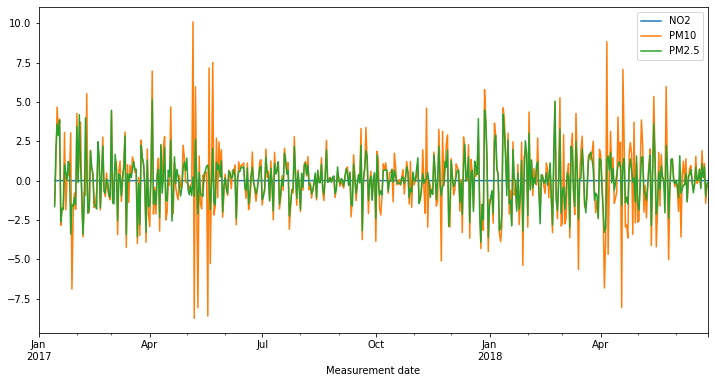

In [468]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [469]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.881182e+00
p-value                        4.698257e-12
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.335332e+00
p-value                        3.284086e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.167014e+00
p-value                        2.868872e-10
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [470]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.084189e+01
p-value                        1.608110e-19
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.047912e+01
p-value                        1.226798e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.001290e+01
p-value                        1.759414e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

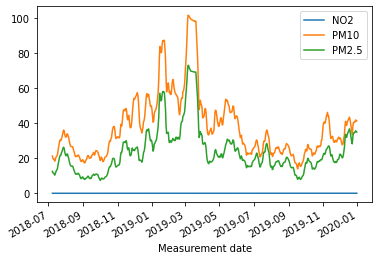

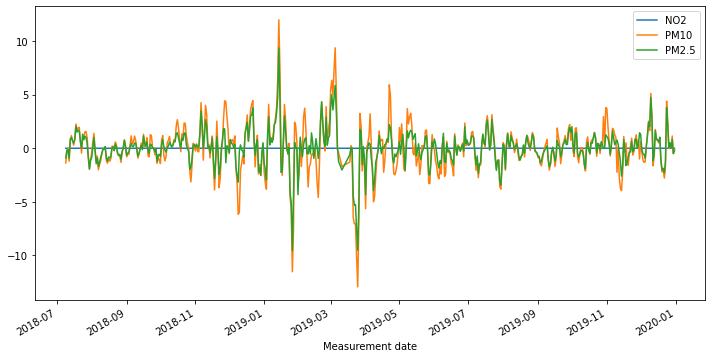

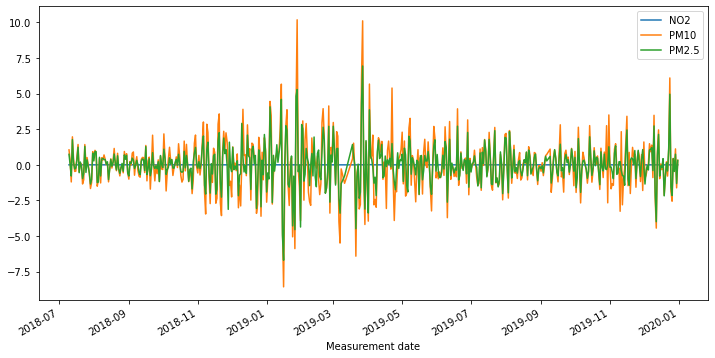

In [471]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [472]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.049124e+00
p-value                        1.290254e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.438608
p-value                          0.000003
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.194682e+00
p-value                        7.504578e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136

In [473]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.555201e+00
p-value                        2.509730e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.036589e+01
p-value                        2.331011e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.006944e+01
p-value                        1.270423e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 114 PM10

In [474]:
base_model = sm.tsa.statespace.SARIMAX(df_114['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4926.672
Date:                Wed, 20 Oct 2021   AIC                           9857.343
Time:                        14:56:30   BIC                           9867.322
Sample:                             0   HQIC                          9861.121
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     40.4217      0.884     45.749      0.000      38.690      42.153
sigma2       514.6800     14.359     35.844      0.000     486.537     542.823
Ljung-Box (L1) (Q):                 531.99   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9253.028, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11405.835, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9263.123, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10394.746, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9260.858, Time=0.14 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9113.237, Time=0.12 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=9976.126, Time=0.09 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9077.426, Time=0.23 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9078.119, Time=0.46 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9078.393, Time=0.39 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9087.009, Time=0.20 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9081.311, Time=0.23 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9079.194, Time=0.51 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9071.686, Time=0.62 sec
 ARIMA(1,0,2)(0,0,0)[0] interce

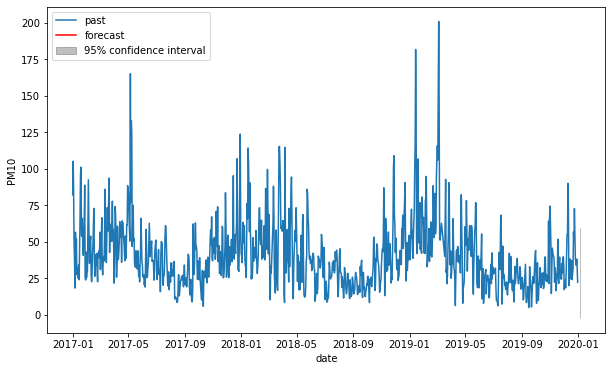

In [475]:
timeseries = df_114['PM10']
automodel = arimamodel(df_114['PM10'])
plotarima(1, timeseries, automodel)

In [476]:
best_model = sm.tsa.statespace.SARIMAX(df_114['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4529.843
Date:                Wed, 20 Oct 2021   AIC                           9071.686
Time:                        14:56:38   BIC                           9101.622
Sample:                             0   HQIC                          9083.018
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4143      0.279      1.486      0.137      -0.132       0.961
ar.L1          1.3609      0.048     28.306      0.000       1.267       1.455
ar.L2         -0.3712      0.044     -8.377      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [477]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 16.8594436315427
Test RMSE: 30.579994922849988
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2303.580
Date:                Wed, 20 Oct 2021   AIC                           4619.159
Time:                        14:56:38   BIC                           4644.942
Sample:                    01-01-2017   HQIC                          4629.240
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.0946      5.276      8.358      0.000      33.754      54.435
ar.L1          1.3654      0.073     18.609      0.000       1.

# Station 114 PM2.5

In [478]:
base_model = sm.tsa.statespace.SARIMAX(df_114['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4538.232
Date:                Wed, 20 Oct 2021   AIC                           9080.464
Time:                        14:56:38   BIC                           9090.443
Sample:                             0   HQIC                          9084.242
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.2576      0.642     37.797      0.000      23.000      25.515
sigma2       251.5213      6.448     39.006      0.000     238.883     264.160
Ljung-Box (L1) (Q):                 550.49   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8428.988, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10386.776, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8429.569, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9385.809, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8415.314, Time=0.13 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8430.358, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8249.604, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8360.015, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8245.935, Time=0.35 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8339.796, Time=0.12 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8247.918, Time=0.48 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=8252.093, Time=0.55 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8246.590, Time=0.32 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8327.206, Time=0.14 sec
 ARIMA(5,0,2)(0,0,0)[0]         

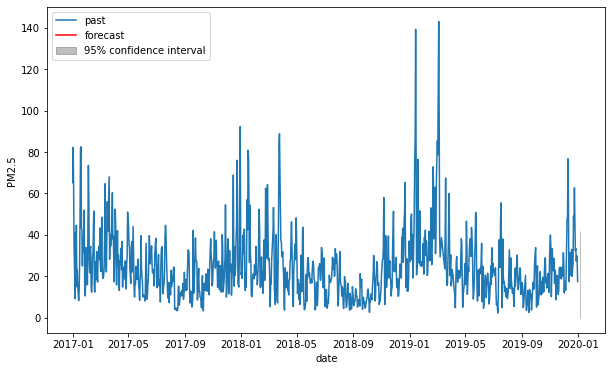

In [479]:
timeseries = df_114['PM2.5']
automodel = arimamodel(df_114['PM2.5'])
plotarima(1, timeseries, automodel)

In [480]:
best_model = sm.tsa.statespace.SARIMAX(df_114['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4113.212
Date:                Wed, 20 Oct 2021   AIC                           8238.424
Time:                        14:56:49   BIC                           8268.360
Sample:                             0   HQIC                          8249.757
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2360      0.172      1.369      0.171      -0.102       0.574
ar.L1          1.3878      0.048     28.830      0.000       1.293       1.482
ar.L2         -0.3972      0.044     -9.005      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [481]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 11.162731437897776
Test RMSE: 20.44928898994818
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2077.797
Date:                Wed, 20 Oct 2021   AIC                           4167.594
Time:                        14:56:49   BIC                           4193.377
Sample:                    01-01-2017   HQIC                          4177.676
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.5210      1.468     17.382      0.000      22.643      28.399
ar.L1         -0.0570      0.708     -0.081      0.936      -1

# Station 114 NO2

In [482]:
base_model = sm.tsa.statespace.SARIMAX(df_114['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3013.005
Date:                Wed, 20 Oct 2021   AIC                          -6022.010
Time:                        14:56:49   BIC                          -6012.031
Sample:                             0   HQIC                         -6018.233
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0266      0.000     56.255      0.000       0.026       0.028
sigma2         0.0002    3.3e-06     68.756      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 327.67   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6350.275, Time=0.20 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4488.171, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6195.212, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5318.915, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6480.481, Time=0.33 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-6244.103, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6482.687, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-6323.888, Time=0.10 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-6341.149, Time=0.39 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-6479.289, Time=0.51 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6457.954, Time=0.40 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-6343.393, Time=0.11 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.63 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-6427.332, Time=0.55 sec

Best model:  ARIMA(3,0,1

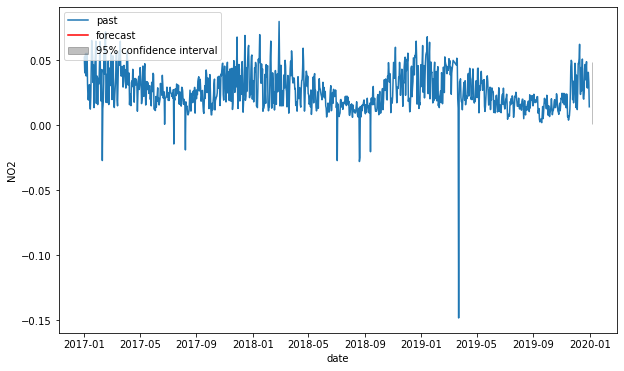

In [483]:
timeseries = df_114['NO2']
automodel = arimamodel(df_114['NO2'])
plotarima(1, timeseries, automodel)

In [484]:
best_model = sm.tsa.statespace.SARIMAX(df_114['NO2'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood                3219.666
Date:                Wed, 20 Oct 2021   AIC                          -6427.332
Time:                        14:56:53   BIC                          -6397.396
Sample:                             0   HQIC                         -6415.999
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0120      0.003      3.927      0.000       0.006       0.018
ar.L1          0.3423      0.226      1.515      0.130      -0.100       0.785
ar.L2          0.0596      0.125      0.479      0.6

In [485]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.011714847460633998
Test RMSE: 0.019269139609109854
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 1)   Log Likelihood                1644.555
Date:                Wed, 20 Oct 2021   AIC                          -3277.109
Time:                        14:56:54   BIC                          -3251.327
Sample:                    01-01-2017   HQIC                         -3267.028
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0295      0.001     26.678      0.000       0.027       0.032
ar.L1          0.2701      0.210      1.285      0.199   

# Station 115

In [486]:
df_115 = df[df['Station code'] == 115]

In [487]:
df_115.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,115,0.005125,0.046375,0.003625,1.058333,79.625000,51.041667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,115,0.005167,0.039167,0.011125,0.875000,106.958333,62.791667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,115,0.004833,0.040625,0.007750,0.816667,73.166667,38.416667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,115,0.006417,0.049500,0.006417,0.970833,58.375000,31.500000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,115,0.004958,0.039167,0.006083,0.820833,39.000000,20.291667,Good,Normal,Good,Good,Normal,Normal


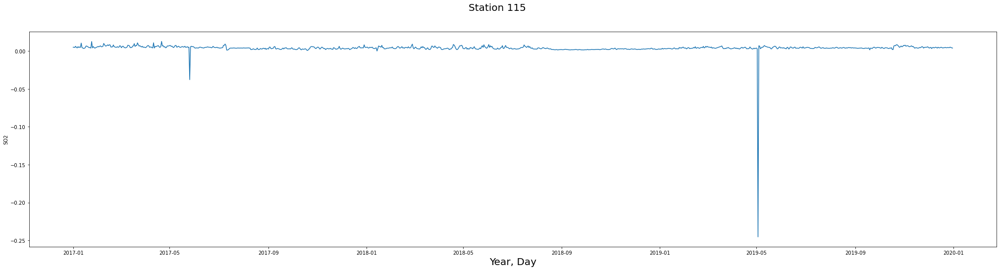

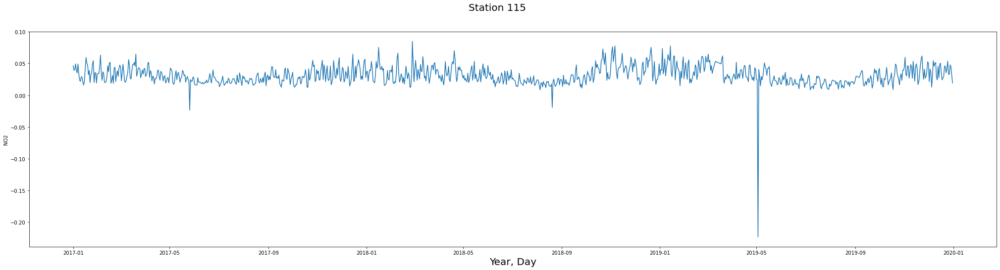

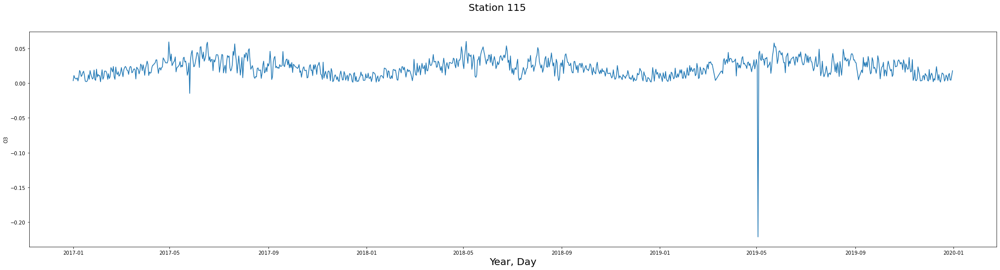

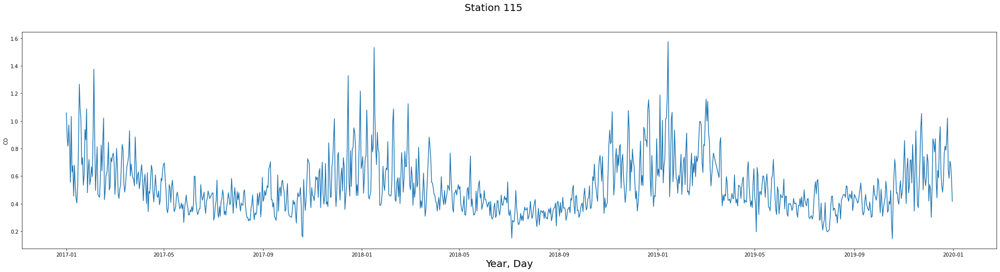

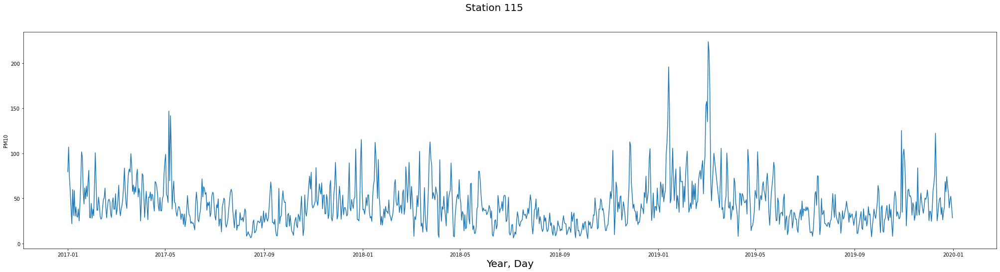

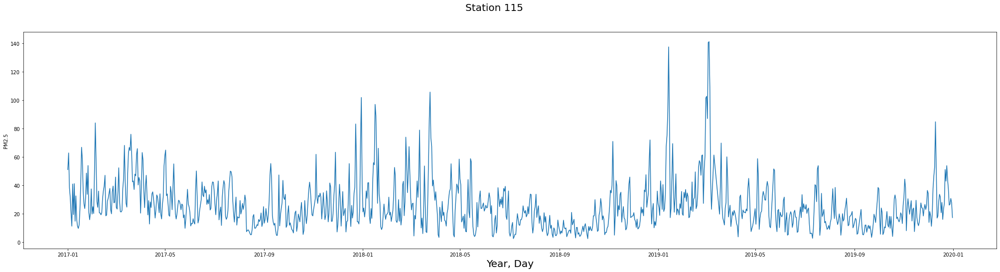

In [488]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 115", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_115)

In [489]:
df_115['NO2 Level'].value_counts()

Good      586
Normal    470
Bad        29
Name: NO2 Level, dtype: int64

In [490]:
df_115['PM10 Level'].value_counts()

Normal      666
Good        343
Bad          69
Very Bad      7
Name: PM10 Level, dtype: int64

In [491]:
df_115['PM2.5 Level'].value_counts()

Normal      561
Good        291
Bad         213
Very Bad     20
Name: PM2.5 Level, dtype: int64

###### For Station 115
- NO2 reaches levels of 'Bad' on 29 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 69 occasions and 'Very Bad' on 7, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 213 occasions and 'Very Bad' on 20 occasions.

# Picking the relevant columns

In [492]:
columns = ['NO2', 'PM10', 'PM2.5']
df_115 = df_115[columns]
df_115

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.046375,79.625000,51.041667
2017-01-02,0.039167,106.958333,62.791667
2017-01-03,0.040625,73.166667,38.416667
2017-01-04,0.049500,58.375000,31.500000
2017-01-05,0.039167,39.000000,20.291667
...,...,...,...
2019-12-27,0.033042,39.583333,26.041667
2019-12-28,0.047792,48.375000,26.708333
2019-12-29,0.044958,52.416667,30.750000


# Train-Test Split

In [493]:
train = df_115[:-542]
test = df_115[542:]

<AxesSubplot:xlabel='Measurement date'>

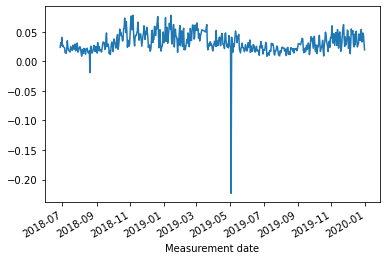

In [494]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

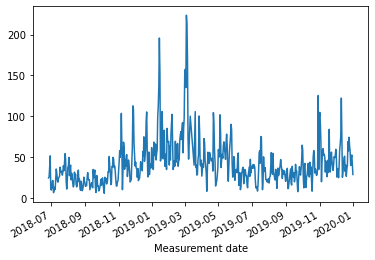

In [495]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

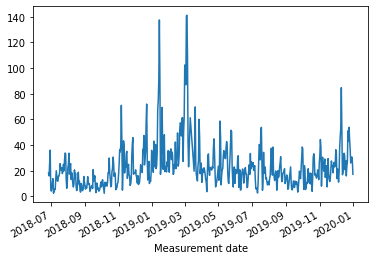

In [496]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

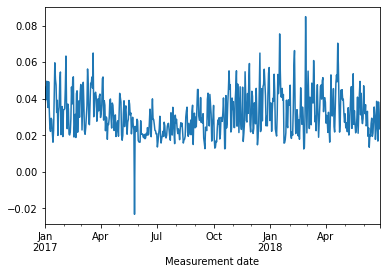

In [497]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

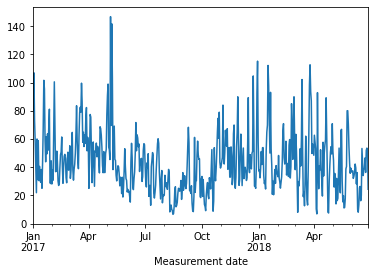

In [498]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

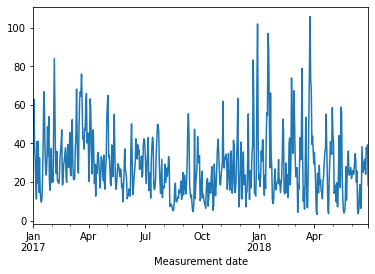

In [499]:
train['PM2.5'].plot()

In [500]:
print(stationarity_check(df_115['PM2.5']))
print(stationarity_check(df_115['PM10']))
print(stationarity_check(df_115['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.687713e+00
p-value                        1.446684e-11
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.236149e+00
p-value                        1.937239e-10
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -3.749838
p-value                           0.003464
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)           

# Rolling Mean Difference Train

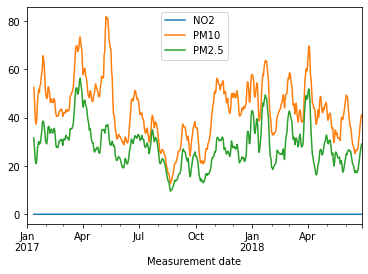

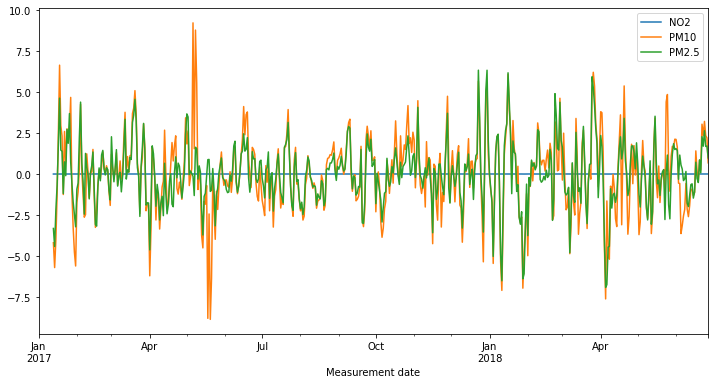

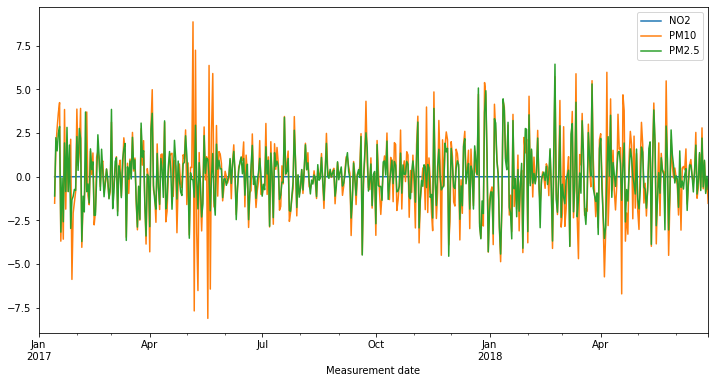

In [501]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = train.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [502]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.703300e+00
p-value                        1.321688e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.002632e+00
p-value                        2.311995e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.066083e+00
p-value                        4.428963e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [503]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.116068e+01
p-value                        2.792948e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.082385e+01
p-value                        1.777437e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.017778e+01
p-value                        6.820224e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Train

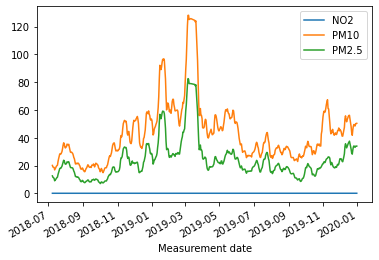

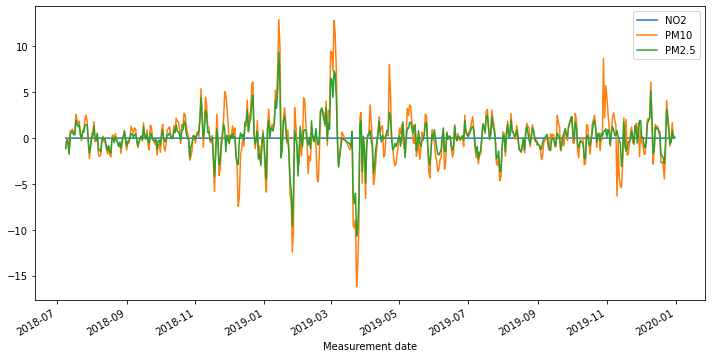

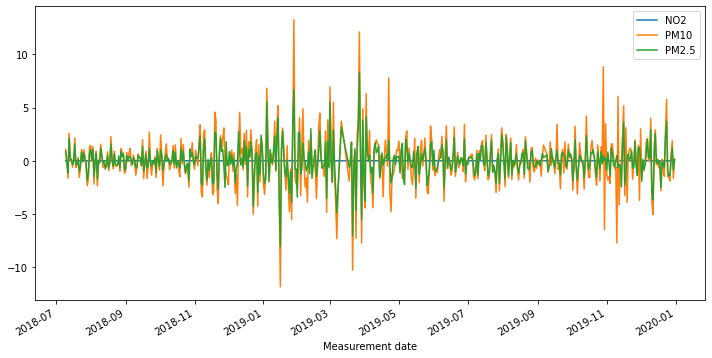

In [504]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = test.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [505]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.050066e+00
p-value                        1.283929e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.544337
p-value                          0.000002
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.042000e+00
p-value                        5.814414e-10
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [506]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.567124e+00
p-value                        2.340868e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.127022e+01
p-value                        1.543447e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.054121e+01
p-value                        8.640619e-19
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Station 115 PM10

In [507]:
base_model = sm.tsa.statespace.SARIMAX(df_115['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5021.147
Date:                Wed, 20 Oct 2021   AIC                          10046.294
Time:                        14:56:58   BIC                          10056.272
Sample:                             0   HQIC                         10050.071
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     42.7472      0.972     43.983      0.000      40.842      44.652
sigma2       612.5883     15.356     39.894      0.000     582.492     642.685
Ljung-Box (L1) (Q):                 520.79   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9459.698, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11543.789, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9477.635, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10572.149, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9479.447, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9352.726, Time=0.19 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10170.613, Time=0.14 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9312.061, Time=0.37 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9312.219, Time=0.59 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9312.655, Time=0.43 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9326.745, Time=0.19 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9313.667, Time=0.33 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9314.152, Time=0.60 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=9305.341, Time=0.56 sec
 ARIMA(1,0,2)(0,0,0)[0] interc

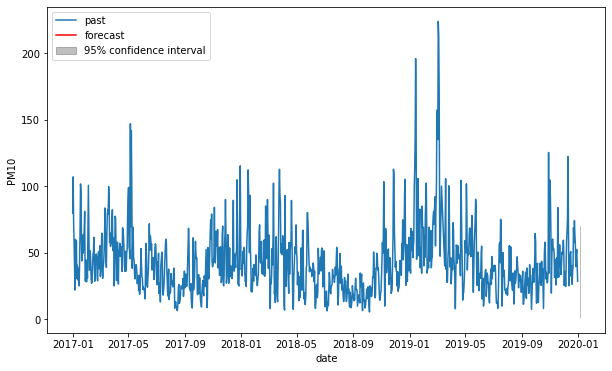

In [508]:
timeseries = df_115['PM10']
automodel = arimamodel(df_115['PM10'])
plotarima(1, timeseries, automodel)

In [509]:
best_model = sm.tsa.statespace.SARIMAX(df_115['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4646.670
Date:                Wed, 20 Oct 2021   AIC                           9305.341
Time:                        14:57:07   BIC                           9335.277
Sample:                             0   HQIC                          9316.674
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5204      0.333      1.563      0.118      -0.132       1.173
ar.L1          1.4101      0.053     26.618      0.000       1.306       1.514
ar.L2         -0.4222      0.048     -8.808      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [510]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 16.800570381456176
Test RMSE: 33.47965135225903
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2301.791
Date:                Wed, 20 Oct 2021   AIC                           4615.582
Time:                        14:57:08   BIC                           4641.364
Sample:                    01-01-2017   HQIC                          4625.663
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.5910      4.522      9.641      0.000      34.729      52.453
ar.L1          1.3715      0.077     17.907      0.000       1

# Station 115 PM2.5

In [511]:
base_model = sm.tsa.statespace.SARIMAX(df_115['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4633.418
Date:                Wed, 20 Oct 2021   AIC                           9270.835
Time:                        14:57:08   BIC                           9280.814
Sample:                             0   HQIC                          9274.613
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     25.7545      0.709     36.323      0.000      24.365      27.144
sigma2       299.7608      8.058     37.201      0.000     283.968     315.554
Ljung-Box (L1) (Q):                 532.43   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8667.119, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10535.167, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8665.663, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9552.499, Time=0.05 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8667.428, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8650.923, Time=0.13 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8500.737, Time=0.24 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8592.355, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8491.142, Time=0.36 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8581.541, Time=0.08 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8492.913, Time=0.50 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.45 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8492.049, Time=0.14 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8568.603, Time=0.09 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

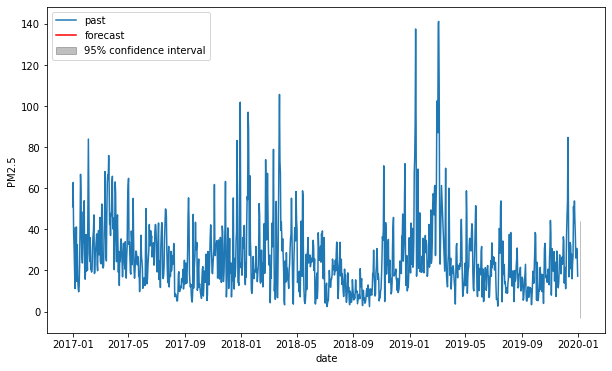

In [512]:
timeseries = df_115['PM2.5']
automodel = arimamodel(df_115['PM2.5'])
plotarima(1, timeseries, automodel)

In [513]:
best_model = sm.tsa.statespace.SARIMAX(df_115['PM2.5'], trend='c', order=[5,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(5, 0, 1)   Log Likelihood               -4236.226
Date:                Wed, 20 Oct 2021   AIC                           8488.453
Time:                        14:57:16   BIC                           8528.367
Sample:                             0   HQIC                          8503.563
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.8888      0.579      1.534      0.125      -0.247       2.024
ar.L1          1.6270      0.088     18.455      0.000       1.454       1.800
ar.L2         -0.9327      0.082    -11.330      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [514]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[5,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 12.470172694408507
Test RMSE: 22.382543479989305
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(5, 0, 1)   Log Likelihood               -2140.181
Date:                Wed, 20 Oct 2021   AIC                           4296.362
Time:                        14:57:17   BIC                           4330.739
Sample:                    01-01-2017   HQIC                          4309.804
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.6670      2.641     10.855      0.000      23.491      33.843
ar.L1          1.6844      0.065     25.972      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 115 NO2

In [515]:
base_model = sm.tsa.statespace.SARIMAX(df_115['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3008.466
Date:                Wed, 20 Oct 2021   AIC                          -6012.932
Time:                        14:57:17   BIC                          -6002.954
Sample:                             0   HQIC                         -6009.155
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0313      0.001     60.808      0.000       0.030       0.032
sigma2         0.0002    1.8e-06    127.084      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 202.30   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6257.687, Time=0.25 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4208.454, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5931.841, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5011.819, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=inf, Time=0.33 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6309.796, Time=0.39 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5308.660, Time=0.18 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6299.497, Time=0.31 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6315.180, Time=0.32 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5515.254, Time=0.18 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-6313.425, Time=0.43 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=-6247.379, Time=0.85 sec
 ARIMA(0,0,4)(0,0,0)[0]             : AIC=-5630.962, Time=0.41 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=-6312.390, Time=0.56 sec
 ARIMA(1,0,3)(0,0,0)[0] i

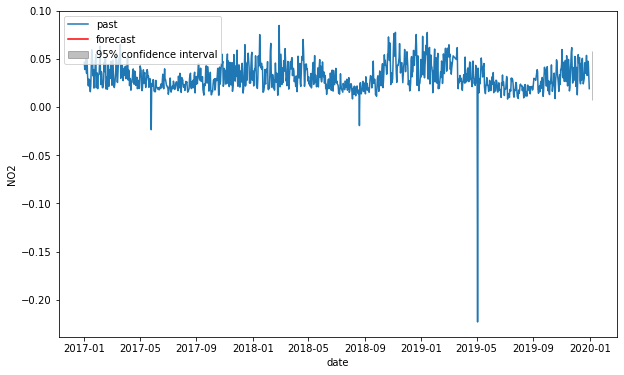

In [516]:
timeseries = df_115['NO2']
automodel = arimamodel(df_115['NO2'])
plotarima(1, timeseries, automodel)

In [517]:
best_model = sm.tsa.statespace.SARIMAX(df_115['NO2'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood                3160.096
Date:                Wed, 20 Oct 2021   AIC                          -6308.192
Time:                        14:57:23   BIC                          -6278.256
Sample:                             0   HQIC                         -6296.859
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0016      0.001      1.890      0.059    -5.8e-05       0.003
ar.L1          0.9486      0.026     36.385      0.000       0.897       1.000
ma.L1         -0.5996      0.027    -22.337      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [518]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.010083611491460379
Test RMSE: 0.019849041840572006
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 3)   Log Likelihood                1725.705
Date:                Wed, 20 Oct 2021   AIC                          -3439.409
Time:                        14:57:23   BIC                          -3413.627
Sample:                    01-01-2017   HQIC                         -3429.328
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0313      0.001     21.506      0.000       0.028       0.034
ar.L1          0.9474      0.045     20.967      0.000   

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 116

In [519]:
df_116 = df[df['Station code'] == 116]

In [520]:
df_116.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,116,0.006292,0.053292,0.005250,0.962500,75.125000,53.708333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,116,0.006500,0.036500,0.017833,0.683333,107.083333,71.000000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,116,0.006875,0.044125,0.012542,0.716667,75.208333,45.875000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,116,0.007125,0.051667,0.010000,0.787500,62.875000,37.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,116,0.006167,0.042583,0.007458,0.679167,51.541667,28.541667,Good,Normal,Good,Good,Normal,Normal


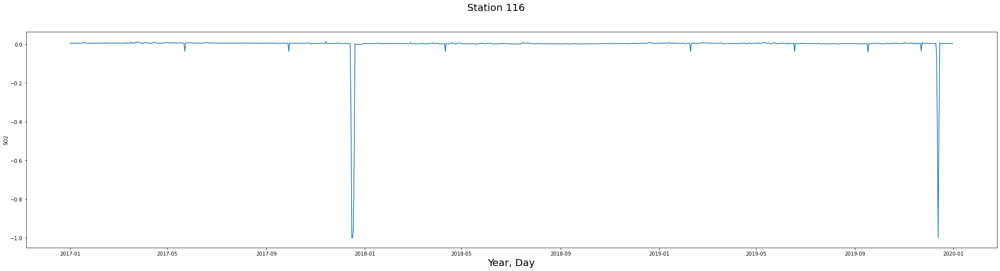

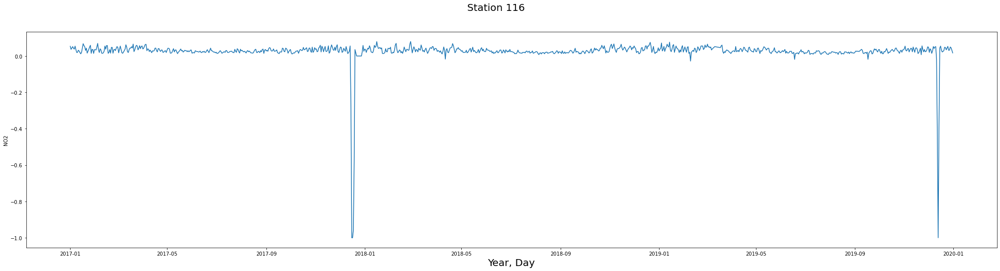

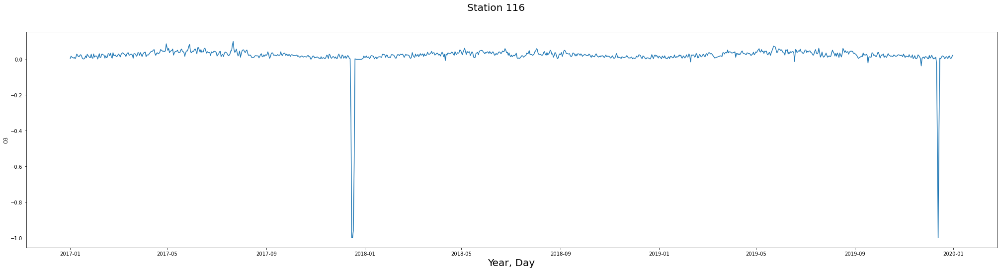

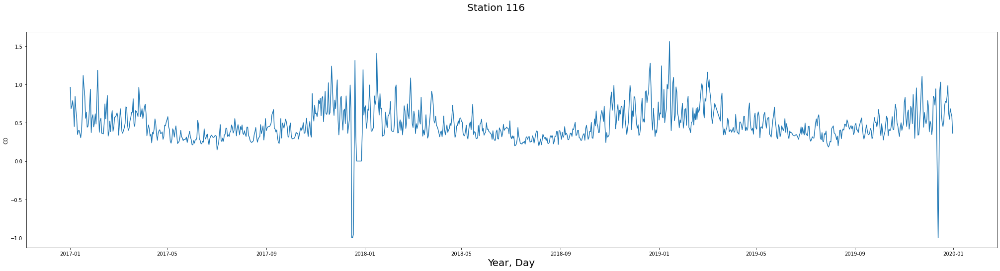

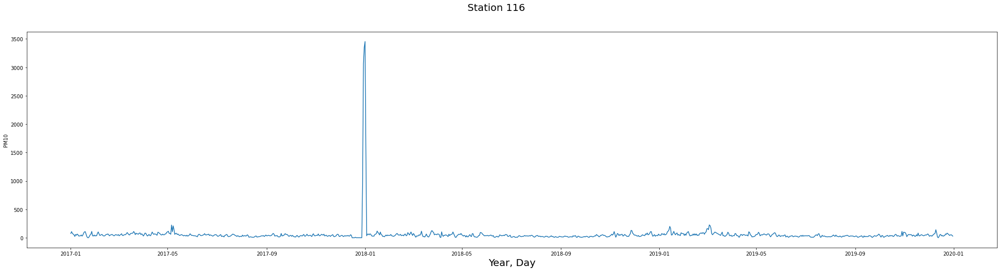

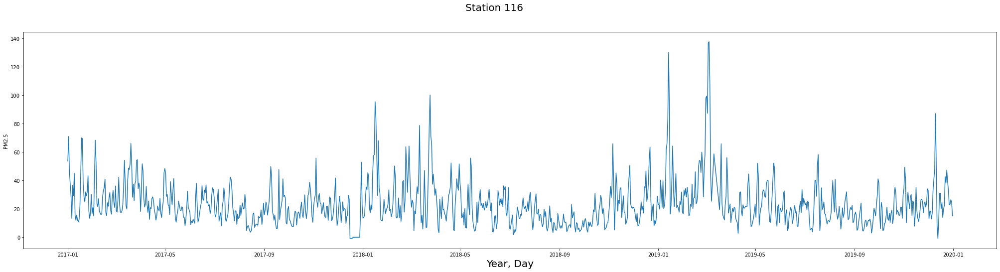

In [521]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 116", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_116)

In [522]:
df_116['NO2 Level'].value_counts()

Good      619
Normal    440
Bad        26
Name: NO2 Level, dtype: int64

In [523]:
df_116['PM2.5 Level'].value_counts()

Normal      591
Good        321
Bad         158
Very Bad     15
Name: PM2.5 Level, dtype: int64

In [524]:
df_116['PM10 Level'].value_counts()

Normal      653
Good        347
Bad          71
Very Bad      9
Name: PM10 Level, dtype: int64

##### For Station 116
- NO2 reaches levels of 'Bad' on 26 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 71 occasions and 'Very Bad' on 9, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 158 occasions and 'Very Bad' on 15 occasions.

# Picking the relevant columns

In [525]:
columns = ['NO2', 'PM10', 'PM2.5']
df_116 = df_116[columns]
df_116

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.053292,75.125000,53.708333
2017-01-02,0.036500,107.083333,71.000000
2017-01-03,0.044125,75.208333,45.875000
2017-01-04,0.051667,62.875000,37.208333
2017-01-05,0.042583,51.541667,28.541667
...,...,...,...
2019-12-27,0.032208,40.208333,22.708333
2019-12-28,0.049542,48.541667,23.125000
2019-12-29,0.044958,52.166667,26.458333


# Train-Test Split

In [526]:
train = df_116[:-542]
test = df_116[542:]

<AxesSubplot:xlabel='Measurement date'>

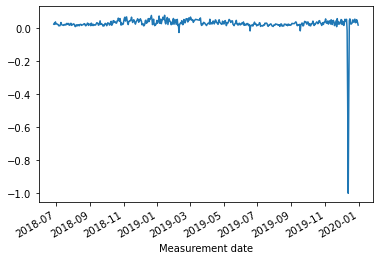

In [527]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

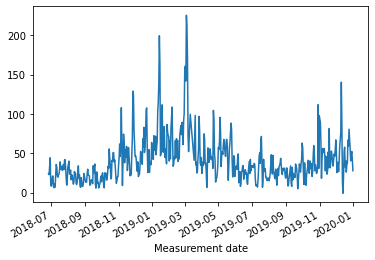

In [528]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

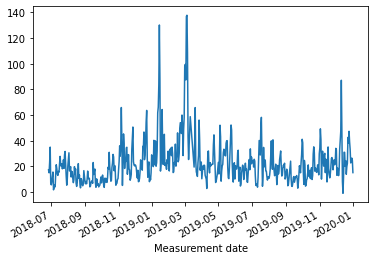

In [529]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

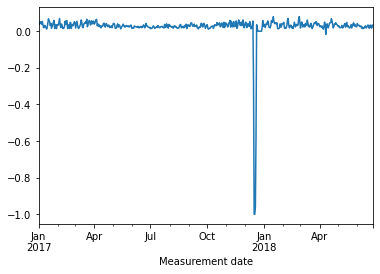

In [530]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

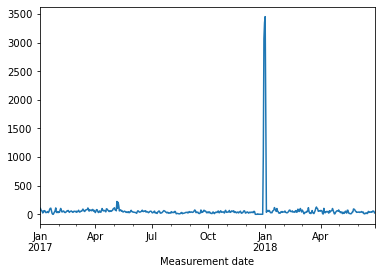

In [531]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

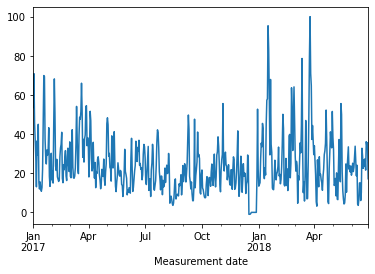

In [532]:
train['PM2.5'].plot()

In [533]:
print(stationarity_check(df_116['PM2.5']))
print(stationarity_check(df_116['PM10']))
print(stationarity_check(df_116['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.958562e+00
p-value                        2.991148e-12
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.340478e+00
p-value                        3.186178e-13
#Lags Used                     1.200000e+01
Number of Observations Used    1.072000e+03
Critical Value (1%)           -3.436465e+00
Critical Value (5%)           -2.864240e+00
Critical Value (10%)          -2.568208e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.007266e+01
p-value                        1.247141e-17
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)      

# Rolling Mean Difference Train

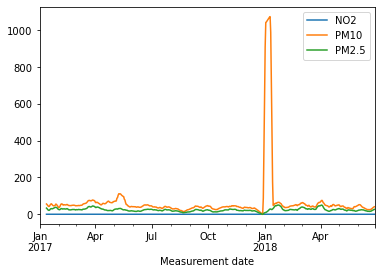

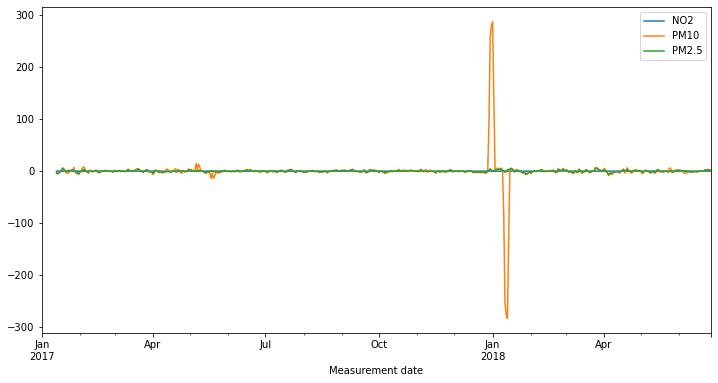

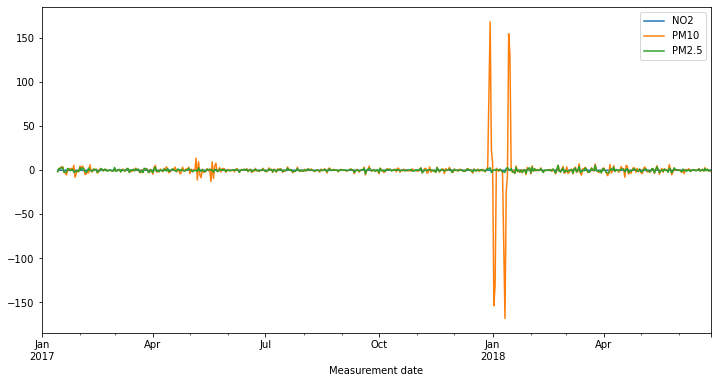

In [534]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [535]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.590299e+00
p-value                        7.142460e-09
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.002640e+00
p-value                        1.643442e-07
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.416177e+00
p-value                        1.838916e-08
#Lags Used                     1.700000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

In [536]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.047694e+01
p-value                        1.241972e-18
#Lags Used                     1.400000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)           -2.867168e+00
Critical Value (10%)          -2.569768e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.083321e+00
p-value                        4.606077e-10
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.398684e+00
p-value                        6.272653e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

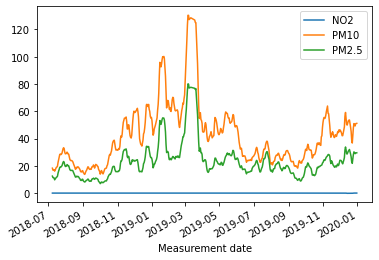

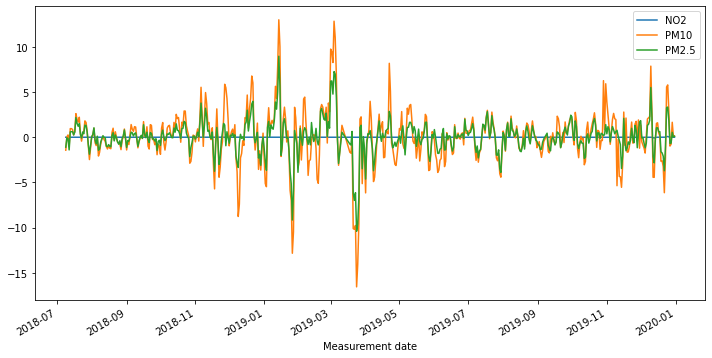

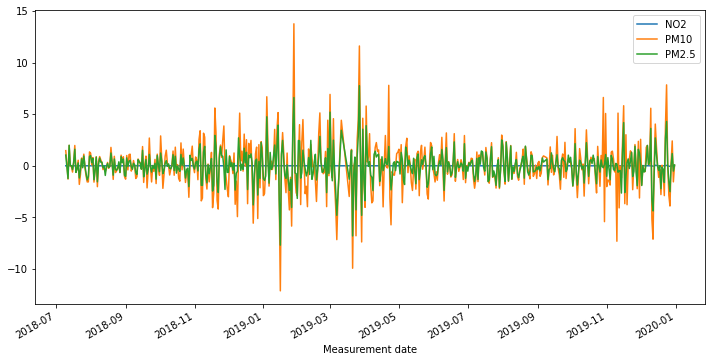

In [537]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [538]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.023503e+00
p-value                        1.474526e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.604683e+00
p-value                        2.339191e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.208927e+00
p-value                        6.902556e-13
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [539]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.583848e+00
p-value                        2.123047e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.115105e+01
p-value                        2.943125e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.847919e+00
p-value                        4.566935e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 116 PM2.5

In [540]:
base_model = sm.tsa.statespace.SARIMAX(df_116['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4542.844
Date:                Wed, 20 Oct 2021   AIC                           9089.687
Time:                        14:57:28   BIC                           9099.666
Sample:                             0   HQIC                          9093.465
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     23.4482      0.653     35.903      0.000      22.168      24.728
sigma2       253.6685      6.171     41.106      0.000     241.573     265.764
Ljung-Box (L1) (Q):                 558.44   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8421.845, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10338.619, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8421.708, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9340.206, Time=0.13 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8422.887, Time=0.11 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8404.401, Time=0.19 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8278.326, Time=0.31 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8348.011, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8262.548, Time=0.38 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8340.198, Time=0.08 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8264.521, Time=0.59 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.49 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8265.807, Time=0.27 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8333.492, Time=0.09 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

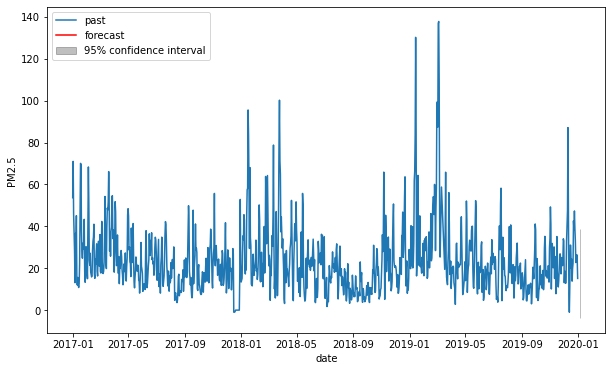

In [541]:
timeseries = df_116['PM2.5']
automodel = arimamodel(df_116['PM2.5'])
plotarima(1, timeseries, automodel)

In [542]:
best_model = sm.tsa.statespace.SARIMAX(df_116['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4121.658
Date:                Wed, 20 Oct 2021   AIC                           8255.315
Time:                        14:57:38   BIC                           8285.251
Sample:                             0   HQIC                          8266.648
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.9732      0.476      2.045      0.041       0.041       1.906
ar.L1          1.3040      0.074     17.542      0.000       1.158       1.450
ar.L2         -0.3453      0.058     -5.911      0.0

In [543]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.638422027545436
Test RMSE: 20.51940317636846
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2052.818
Date:                Wed, 20 Oct 2021   AIC                           4117.636
Time:                        14:57:39   BIC                           4143.418
Sample:                    01-01-2017   HQIC                          4127.717
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.5980      2.420     10.166      0.000      19.856      29.340
ar.L1          1.4721      0.079     18.741      0.000       1

# Station 116 PM10

In [544]:
base_model = sm.tsa.statespace.SARIMAX(df_116['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -7184.292
Date:                Wed, 20 Oct 2021   AIC                          14372.584
Time:                        14:57:39   BIC                          14382.562
Sample:                             0   HQIC                         14376.361
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     54.5342     23.270      2.344      0.019       8.927     100.142
sigma2      3.303e+04    499.238     66.153      0.000     3.2e+04     3.4e+04
Ljung-Box (L1) (Q):                 763.56   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=12719.000, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=14464.135, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=13068.906, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=13377.302, Time=0.07 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=12631.113, Time=0.06 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=12637.368, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=12625.610, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=12627.195, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=12602.399, Time=0.27 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=12604.503, Time=0.05 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=12556.580, Time=0.29 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=12590.884, Time=0.06 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=12492.544, Time=0.50 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=12623.543, Time=0.40 sec
 ARIMA(5,0,3)(0,0,0

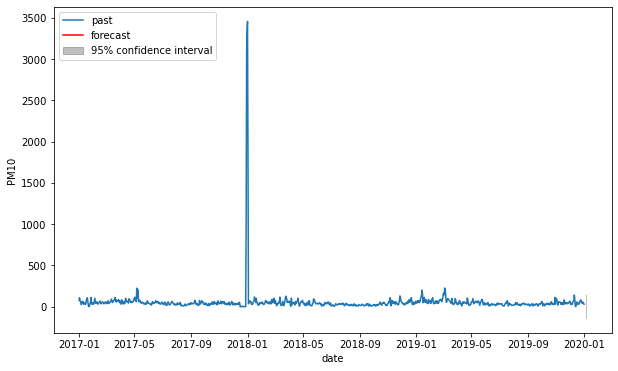

In [545]:
timeseries = df_116['PM10']
automodel = arimamodel(df_116['PM10'])
plotarima(1, timeseries, automodel)

In [546]:
best_model = sm.tsa.statespace.SARIMAX(df_116['PM10'], trend='c', order=[0,0,4])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(0, 0, 4)   Log Likelihood               -6219.433
Date:                Wed, 20 Oct 2021   AIC                          12450.866
Time:                        14:57:55   BIC                          12480.802
Sample:                             0   HQIC                         12462.199
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     54.3983     21.588      2.520      0.012      12.087      96.710
ma.L1          1.3982      0.005    276.773      0.000       1.388       1.408
ma.L2          1.3933      0.010    143.040      0.0

In [547]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 106.63429445279876
Test RMSE: 235.04165167102516
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -3307.415
Date:                Wed, 20 Oct 2021   AIC                           6628.829
Time:                        14:57:55   BIC                           6658.909
Sample:                    01-01-2017   HQIC                          6640.591
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         67.8194     48.508      1.398      0.162     -27.255     162.894
ar.L1          1.1741      0.026     44.677      0.000       

# Station 116 NO2

In [548]:
base_model = sm.tsa.statespace.SARIMAX(df_116['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                1356.130
Date:                Wed, 20 Oct 2021   AIC                          -2708.260
Time:                        14:57:55   BIC                          -2698.281
Sample:                             0   HQIC                         -2704.482
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0246      0.007      3.389      0.001       0.010       0.039
sigma2         0.0048   7.58e-05     63.454      0.000       0.005       0.005
Ljung-Box (L1) (Q):                 648.65   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3950.533, Time=0.15 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2581.212, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3675.689, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3590.828, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3949.607, Time=0.18 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-3949.185, Time=0.28 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-3821.445, Time=0.12 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3878.291, Time=0.06 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3951.775, Time=0.39 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-3956.234, Time=0.40 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3958.217, Time=0.22 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3911.304, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-3956.274, Time=0.40 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-3913.926, Time=0.12 sec
 ARIMA(4,0,2)(0,0,0

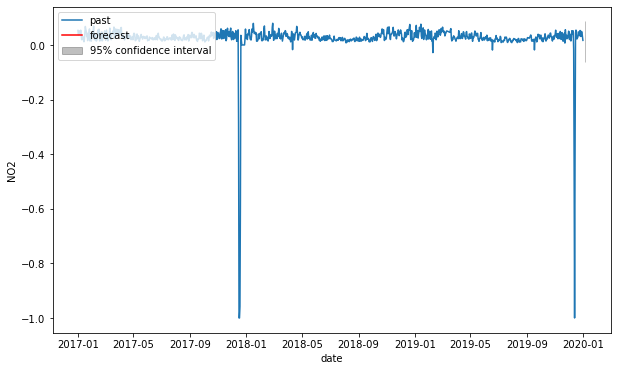

In [549]:
timeseries = df_116['NO2']
automodel = arimamodel(df_116['NO2'])
plotarima(1, timeseries, automodel)

In [550]:
best_model = sm.tsa.statespace.SARIMAX(df_116['NO2'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood                2000.088
Date:                Wed, 20 Oct 2021   AIC                          -3988.177
Time:                        14:58:03   BIC                          -3958.241
Sample:                             0   HQIC                         -3976.844
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0129      0.004      3.196      0.001       0.005       0.021
ar.L1          0.4219      0.030     14.175      0.000       0.364       0.480
ar.L2          0.2229      0.037      6.082      0.0

In [551]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,0])

Train RMSE: 0.03980459881451225
Test RMSE: 0.08867915680775477
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 0)   Log Likelihood                 979.381
Date:                Wed, 20 Oct 2021   AIC                          -1948.761
Time:                        14:58:03   BIC                          -1927.275
Sample:                    01-01-2017   HQIC                         -1940.360
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0239      0.016      1.474      0.140      -0.008       0.056
ar.L1          1.2574      0.011    114.740      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 117

In [552]:
df_117 = df[df['Station code'] == 117]

In [553]:
df_117.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,117,0.007000,0.036333,0.006208,0.983333,79.000000,54.375000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,117,0.008000,0.030458,0.016500,0.754167,116.416667,77.958333,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,117,0.007417,0.030125,0.014958,0.637500,75.125000,48.750000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,117,0.007750,0.039250,0.009458,0.795833,60.166667,35.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,117,0.006000,0.029292,0.010417,0.554167,38.500000,21.583333,Good,Good,Good,Good,Normal,Normal


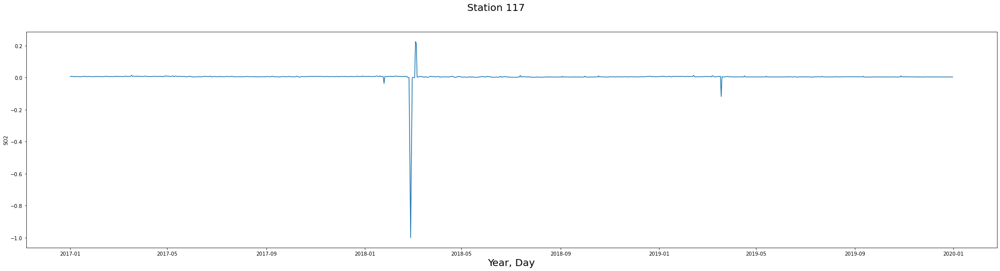

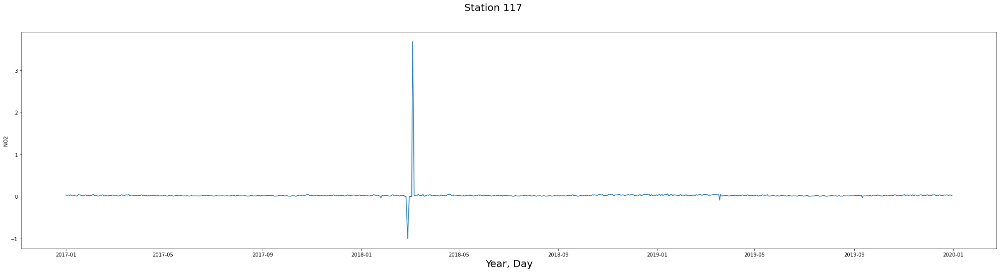

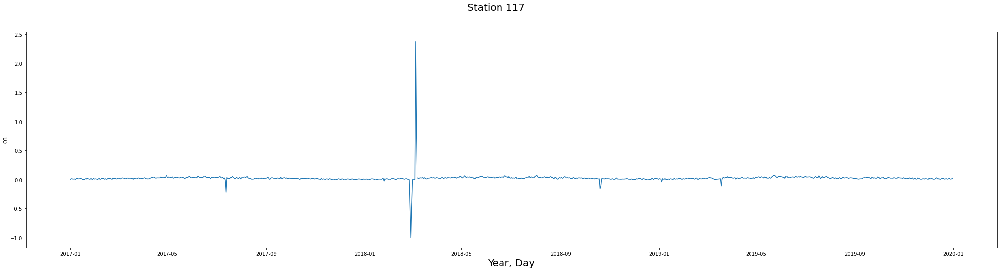

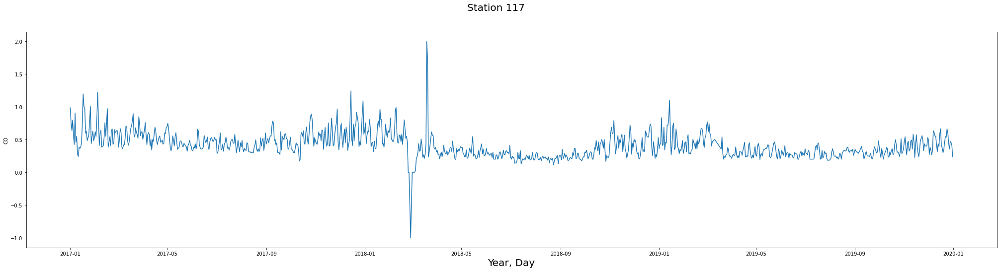

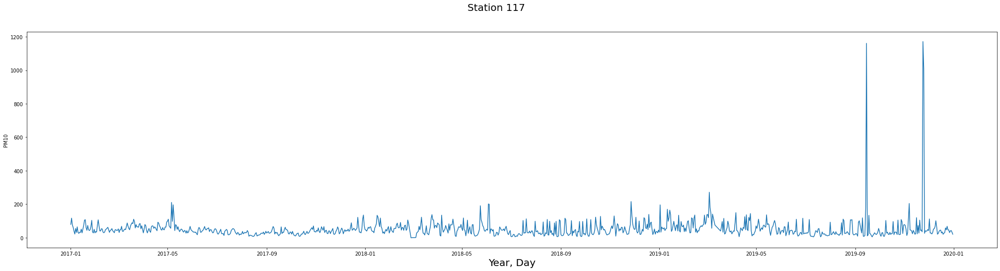

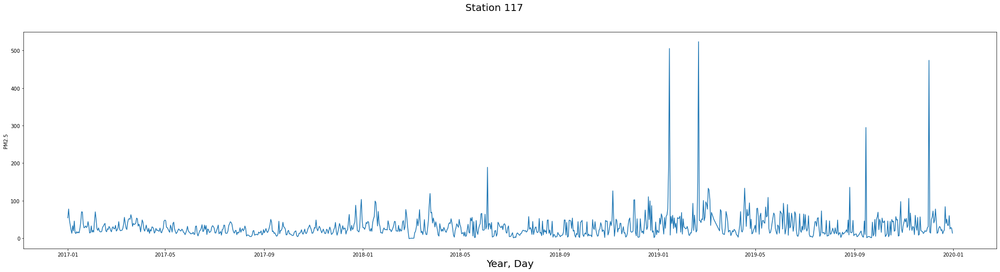

In [554]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 117", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_117)

In [555]:
df_117['NO2 Level'].value_counts()

Good      811
Normal    270
Bad         2
Name: NO2 Level, dtype: int64

In [556]:
df_117['PM10 Level'].value_counts()

Normal      569
Good        362
Bad         138
Very Bad     13
Name: PM10 Level, dtype: int64

In [557]:
df_117['PM2.5 Level'].value_counts()

Normal      471
Good        293
Bad         272
Very Bad     47
Name: PM2.5 Level, dtype: int64

###### For Station 117
- NO2 reaches levels of 'Bad' on 2 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 138 occasions and 'Very Bad' on 13 occasions, and can get close to 'Bad' on many occasions.
- PM2.5 reaches levels of 'Bad' on 272 occasions and 'Very Bad' on 47 occasions.

# Relevant Columns 

In [558]:
columns = ['NO2', 'PM10', 'PM2.5']
df_117 = df_117[columns]
df_117

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.036333,79.000000,54.375000
2017-01-02,0.030458,116.416667,77.958333
2017-01-03,0.030125,75.125000,48.750000
2017-01-04,0.039250,60.166667,35.583333
2017-01-05,0.029292,38.500000,21.583333
...,...,...,...
2019-12-27,0.027750,29.875000,60.250000
2019-12-28,0.039000,39.750000,24.791667
2019-12-29,0.036833,42.583333,28.458333


In [559]:
train = df_117[:-542]
test = df_117[542:]

<AxesSubplot:xlabel='Measurement date'>

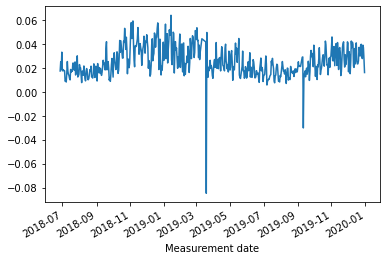

In [560]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

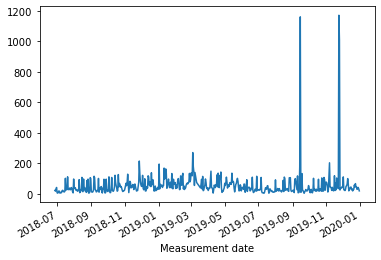

In [561]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

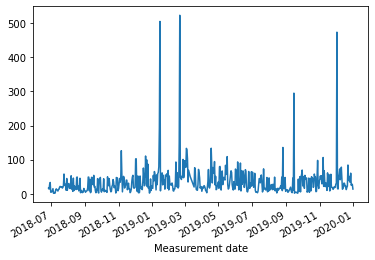

In [562]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

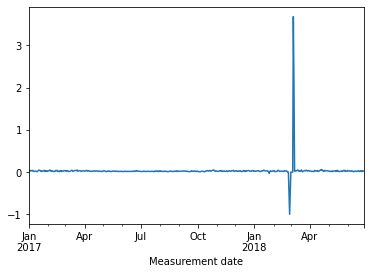

In [563]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

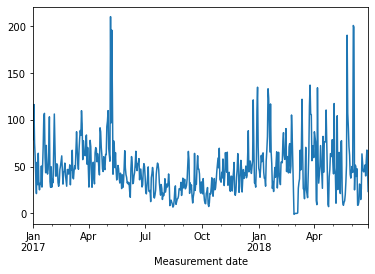

In [564]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

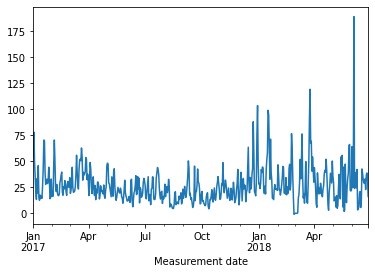

In [565]:
train['PM2.5'].plot()

In [566]:
print(stationarity_check(df_117['PM2.5']))
print(stationarity_check(df_117['PM10']))
print(stationarity_check(df_117['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -1.037313e+01
p-value                        2.236985e-18
#Lags Used                     5.000000e+00
Number of Observations Used    1.079000e+03
Critical Value (1%)           -3.436425e+00
Critical Value (5%)           -2.864222e+00
Critical Value (10%)          -2.568198e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.611123e+01
p-value                        5.010567e-29
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.689941e+01
p-value                        1.030478e-29
#Lags Used                     5.000000e+00
Number of Observations Used    1.079000e+03
Critical Value (1%)           -3.436425e+00
Critical Value (5%)      

# Rolling Mean Difference Train

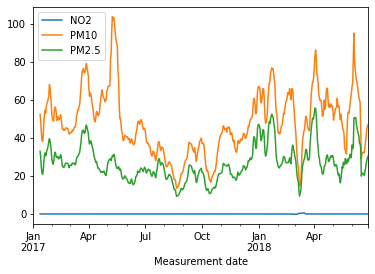

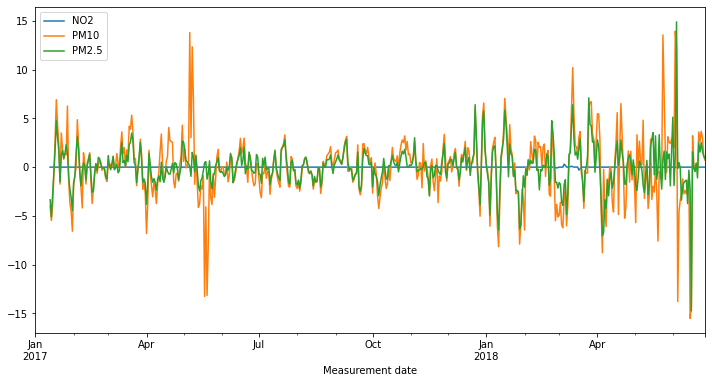

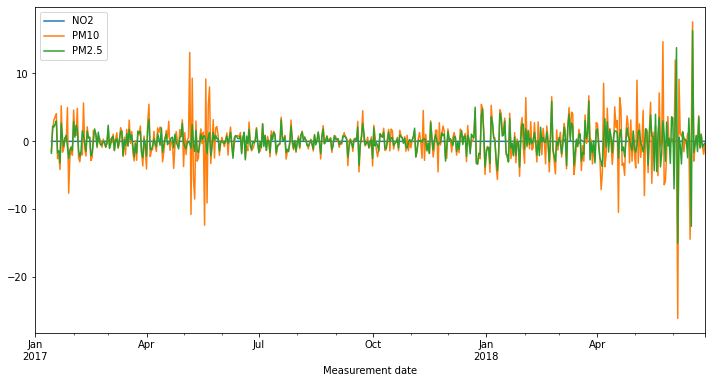

In [567]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [568]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.539632e+00
p-value                        3.405164e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.209131e+00
p-value                        6.894296e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.436592e+00
p-value                        1.809734e-13
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [569]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.149467e+01
p-value                        4.645500e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.097248e+01
p-value                        7.817004e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.018368e+01
p-value                        6.593454e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

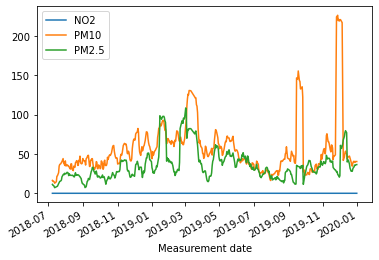

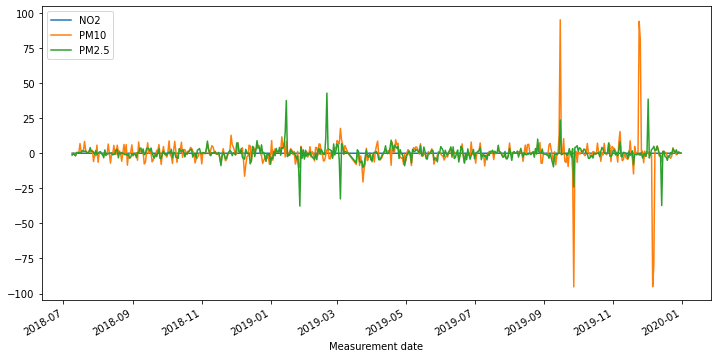

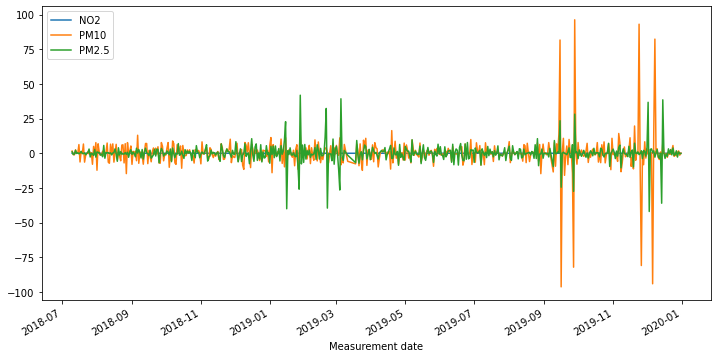

In [570]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [571]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.284011e+00
p-value                        1.229309e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.301325e+00
p-value                        1.110466e-15
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.158961e+00
p-value                        3.002853e-10
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [572]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.582534e+00
p-value                        2.139398e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.044514e+01
p-value                        1.486829e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.665044e+00
p-value                        1.322111e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 117 PM2.5

In [573]:
base_model = sm.tsa.statespace.SARIMAX(df_117['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5380.266
Date:                Wed, 20 Oct 2021   AIC                          10764.531
Time:                        14:58:07   BIC                          10774.510
Sample:                             0   HQIC                         10768.309
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     30.8969      1.729     17.867      0.000      27.508      34.286
sigma2      1187.5685     11.879     99.974      0.000    1164.287    1210.851
Ljung-Box (L1) (Q):                  74.56   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10708.516, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11402.592, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10939.502, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11122.407, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10671.089, Time=0.17 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=10865.587, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10672.648, Time=0.29 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10672.587, Time=0.30 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10673.973, Time=0.14 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10824.760, Time=0.03 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10673.388, Time=0.37 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=10665.944, Time=0.45 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10681.438, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=10686.580, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0

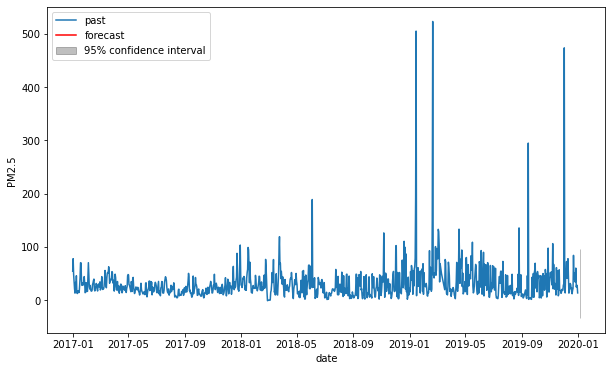

In [574]:
timeseries = df_117['PM2.5']
automodel = arimamodel(df_117['PM2.5'])
plotarima(1, timeseries, automodel)

In [575]:
best_model = sm.tsa.statespace.SARIMAX(df_117['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -5327.972
Date:                Wed, 20 Oct 2021   AIC                          10665.944
Time:                        14:58:13   BIC                          10690.891
Sample:                             0   HQIC                         10675.388
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5138      0.363      1.416      0.157      -0.197       1.225
ar.L1          1.1654      0.026     44.592      0.000       1.114       1.217
ar.L2         -0.1818      0.020     -9.107      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [576]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,1])

Train RMSE: 14.767310121962904
Test RMSE: 46.1798763299191
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2232.105
Date:                Wed, 20 Oct 2021   AIC                           4474.210
Time:                        14:58:13   BIC                           4495.695
Sample:                    01-01-2017   HQIC                          4482.611
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.0330      1.796     15.050      0.000      23.512      30.554
ar.L1         -0.3780      0.026    -14.784      0.000      -0.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

# Station 117 PM10

In [577]:
base_model = sm.tsa.statespace.SARIMAX(df_117['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -6076.549
Date:                Wed, 20 Oct 2021   AIC                          12157.099
Time:                        14:58:13   BIC                          12167.077
Sample:                             0   HQIC                         12160.876
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     51.5441      4.022     12.815      0.000      43.661      59.427
sigma2      4286.1134     37.527    114.214      0.000    4212.562    4359.665
Ljung-Box (L1) (Q):                 138.39   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=12140.662, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=12678.438, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=12190.991, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=12300.444, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=12190.383, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=11998.496, Time=0.22 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=12259.795, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=12000.333, Time=0.31 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=12000.357, Time=0.34 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=12222.715, Time=0.11 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=12002.475, Time=0.35 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=11991.558, Time=0.51 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=11995.298, Time=0.19 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=11995.291, Time=0.22 sec
 ARIMA(2,0,2)(0,0,0

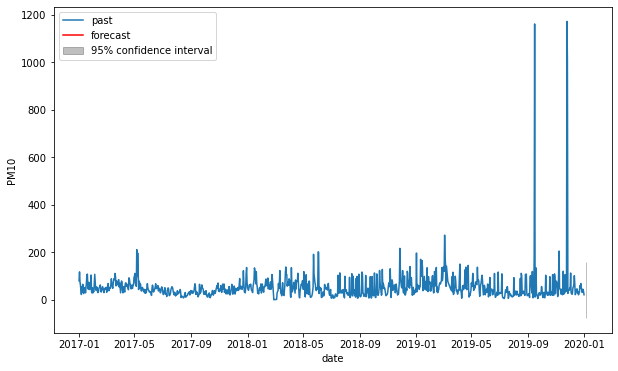

In [578]:
timeseries = df_117['PM10']
automodel = arimamodel(df_117['PM10'])
plotarima(1, timeseries, automodel)

In [579]:
best_model = sm.tsa.statespace.SARIMAX(df_117['PM10'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood               -5990.779
Date:                Wed, 20 Oct 2021   AIC                          11991.558
Time:                        14:58:18   BIC                          12016.505
Sample:                             0   HQIC                         12001.002
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      2.7423      3.785      0.724      0.469      -4.677      10.161
ar.L1          0.9464      0.074     12.775      0.000       0.801       1.092
ma.L1         -0.5359      0.073     -7.310      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [580]:
model_train = arima_results(train['PM10'],test['PM10'], order=[1,0,2])

Train RMSE: 23.277606106288534
Test RMSE: 91.22696829220713
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood               -2479.448
Date:                Wed, 20 Oct 2021   AIC                           4968.896
Time:                        14:58:18   BIC                           4990.381
Sample:                    01-01-2017   HQIC                          4977.297
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         48.1096      4.387     10.966      0.000      39.511      56.709
ar.L1          0.8537      0.053     16.212      0.000       0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 117 NO2

In [581]:
base_model = sm.tsa.statespace.SARIMAX(df_117['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 638.936
Date:                Wed, 20 Oct 2021   AIC                          -1273.872
Time:                        14:58:19   BIC                          -1263.894
Sample:                             0   HQIC                         -1270.095
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0276      0.010      2.773      0.006       0.008       0.047
sigma2         0.0180      0.000    160.268      0.000       0.018       0.018
Ljung-Box (L1) (Q):                 219.91   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-1585.633, Time=0.19 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1231.006, Time=0.06 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-1502.035, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-1586.262, Time=0.20 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-1585.518, Time=0.10 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=inf, Time=0.34 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-1608.419, Time=0.23 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-1273.872, Time=0.05 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-1606.611, Time=0.16 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=-1606.607, Time=0.24 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-1516.646, Time=0.03 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-1613.812, Time=0.52 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-1602.611, Time=0.32 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=-1614.428, Time=0.54 sec
 ARIMA(0,0,3)(0,0,0)[0] i

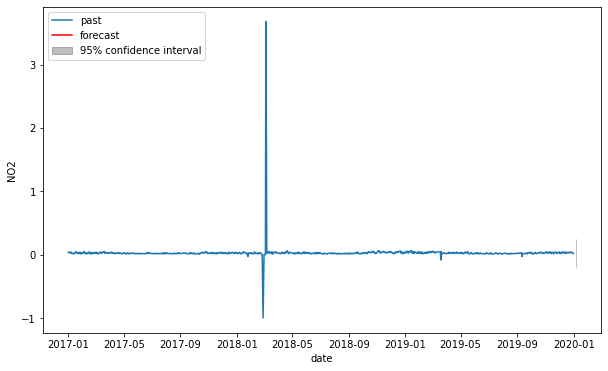

In [582]:
timeseries = df_117['NO2']
automodel = arimamodel(df_117['NO2'])
plotarima(1, timeseries, automodel)

In [583]:
best_model = sm.tsa.statespace.SARIMAX(df_117['NO2'], trend='c', order=[2,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(2, 0, 3)   Log Likelihood                 815.322
Date:                Wed, 20 Oct 2021   AIC                          -1616.644
Time:                        14:58:27   BIC                          -1581.718
Sample:                             0   HQIC                         -1603.422
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0192      0.017      1.161      0.246      -0.013       0.052
ar.L1          1.0817      0.177      6.097      0.000       0.734       1.429
ar.L2         -0.7793      0.119     -6.563      0.0

In [584]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,0])

Train RMSE: 0.16264656931028704
Test RMSE: 0.09744589202081824
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 0)   Log Likelihood                 215.500
Date:                Wed, 20 Oct 2021   AIC                           -421.000
Time:                        14:58:27   BIC                           -399.515
Sample:                    01-01-2017   HQIC                          -412.599
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0299      0.058      0.514      0.607      -0.084       0.144
ar.L1          0.5897      0.088      6.670      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 118

In [585]:
df_118 = df[df['Station code'] == 118]

In [586]:
df_118.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,118,0.004875,0.053458,0.006083,1.029167,65.958333,45.000000,Good,Normal,Good,Good,Normal,Bad
2017-01-02,118,0.005292,0.046000,0.015208,0.808333,100.666667,66.875000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,118,0.005000,0.043917,0.015625,0.675000,62.541667,37.958333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,118,0.004958,0.056167,0.008625,0.845833,52.416667,31.750000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,118,0.004000,0.040792,0.011375,0.679167,32.208333,18.916667,Good,Normal,Good,Good,Normal,Normal


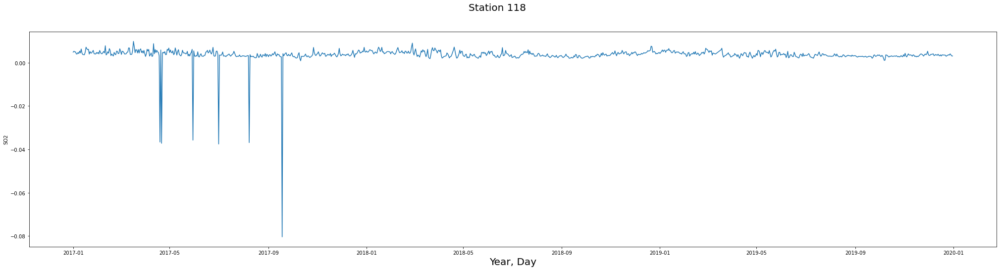

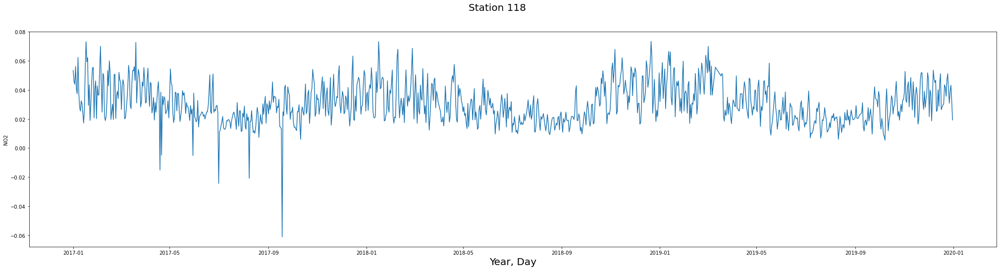

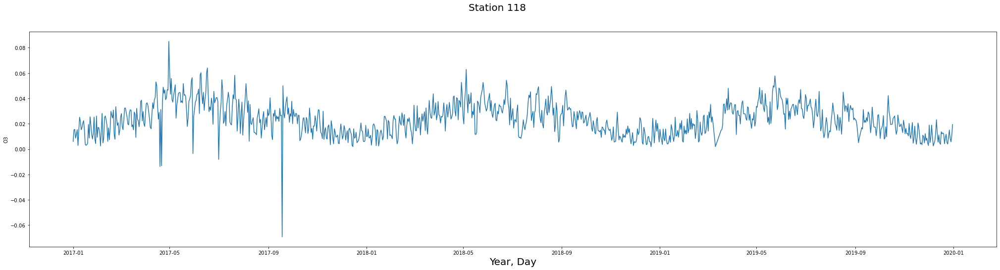

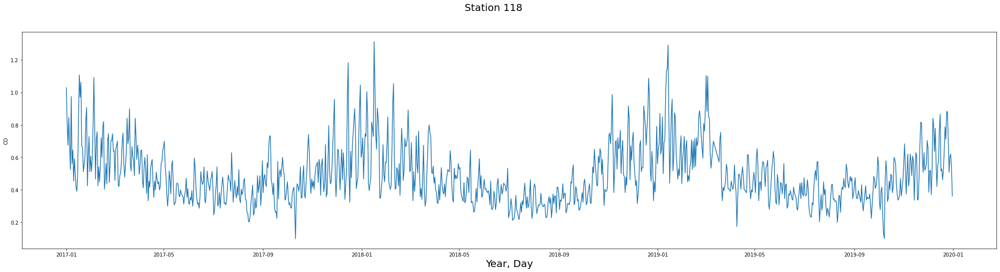

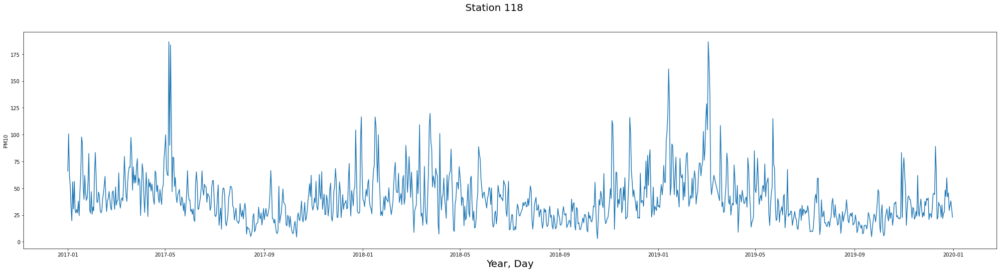

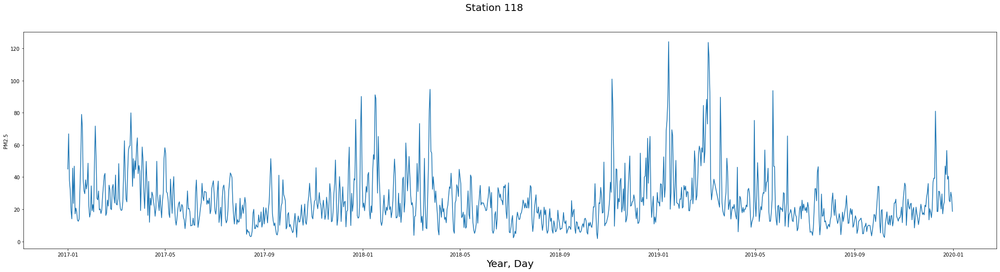

In [587]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 118", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_118)

In [588]:
df_118['NO2 Level'].value_counts()

Good      595
Normal    468
Bad        22
Name: NO2 Level, dtype: int64

In [589]:
df_118['PM10 Level'].value_counts()

Normal      609
Good        416
Bad          55
Very Bad      5
Name: PM10 Level, dtype: int64

In [590]:
df_118['PM2.5 Level'].value_counts()

Normal      574
Good        306
Bad         181
Very Bad     24
Name: PM2.5 Level, dtype: int64

###### For Station 118
- NO2 reaches levels of 'Bad' on 22 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 55 occasions and 'Very Bad' on 5, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 181 occasions and 'Very Bad' on 24 occasions.

# Picking the relevant columns

In [591]:
columns = ['NO2', 'PM10', 'PM2.5']
df_118 = df_118[columns]
df_118

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.053458,65.958333,45.000000
2017-01-02,0.046000,100.666667,66.875000
2017-01-03,0.043917,62.541667,37.958333
2017-01-04,0.056167,52.416667,31.750000
2017-01-05,0.040792,32.208333,18.916667
...,...,...,...
2019-12-27,0.030917,29.291667,25.541667
2019-12-28,0.039333,34.125000,24.625000
2019-12-29,0.043250,38.208333,30.666667


In [592]:
train = df_118[:-542]
test = df_118[542:]

<AxesSubplot:xlabel='Measurement date'>

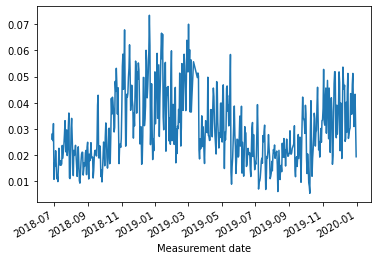

In [593]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

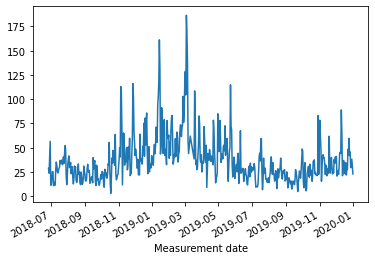

In [594]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

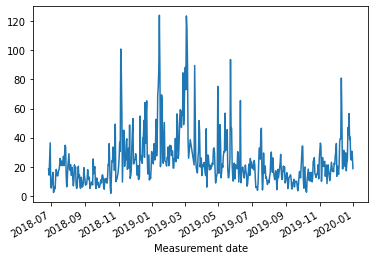

In [595]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

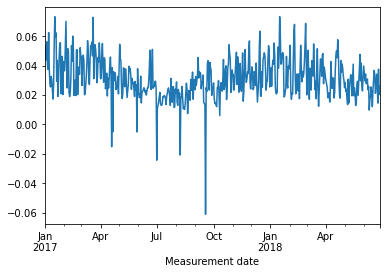

In [596]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

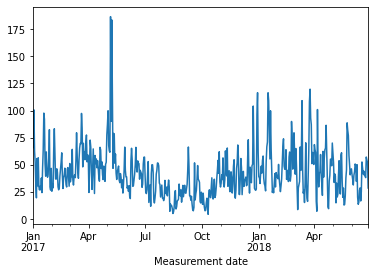

In [597]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

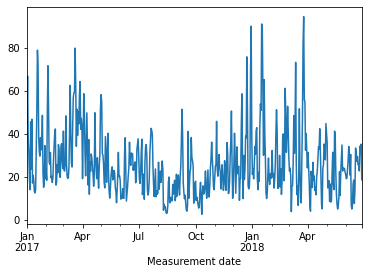

In [598]:
train['PM2.5'].plot()

In [599]:
print(stationarity_check(df_118['PM2.5']))
print(stationarity_check(df_118['PM10']))
print(stationarity_check(df_118['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.749081e+00
p-value                        1.013334e-11
#Lags Used                     5.000000e+00
Number of Observations Used    1.079000e+03
Critical Value (1%)           -3.436425e+00
Critical Value (5%)           -2.864222e+00
Critical Value (10%)          -2.568198e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.901687e+00
p-value                        1.277239e-09
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -3.540638
p-value                           0.007003
#Lags Used                       17.000000
Number of Observations Used    1067.000000
Critical Value (1%)              -3.436493
Critical Value (5%)           

# Rolling Mean Difference Train

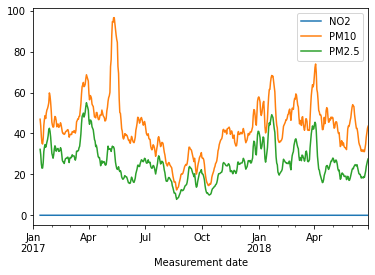

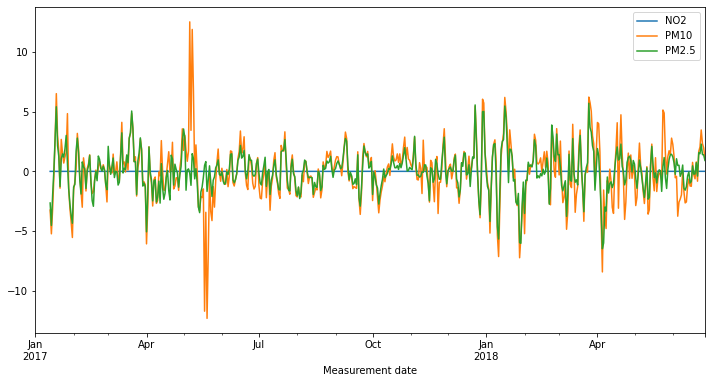

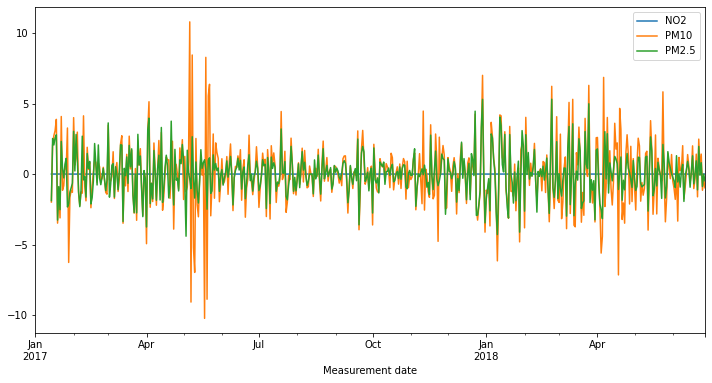

In [600]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [601]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.555089e+00
p-value                        3.114769e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.412323e+00
p-value                        2.087696e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.544140e+00
p-value                        2.677306e-16
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [602]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.113664e+01
p-value                        3.183253e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.073151e+01
p-value                        2.971603e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.090047e+01
p-value                        1.162741e-19
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)      

# Rolling Mean Difference Test

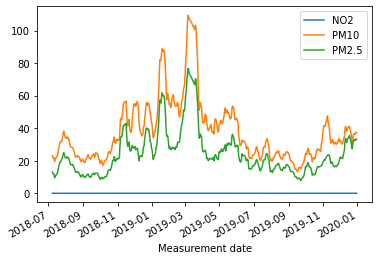

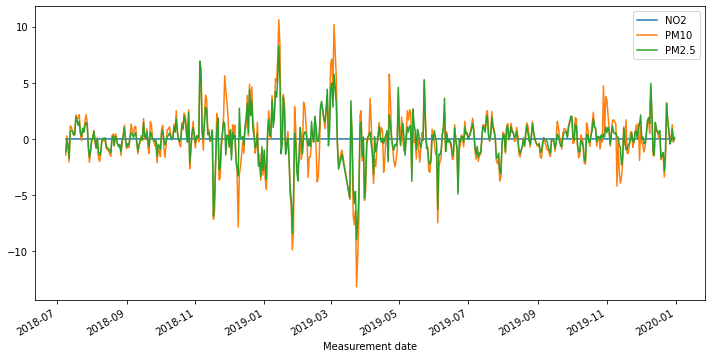

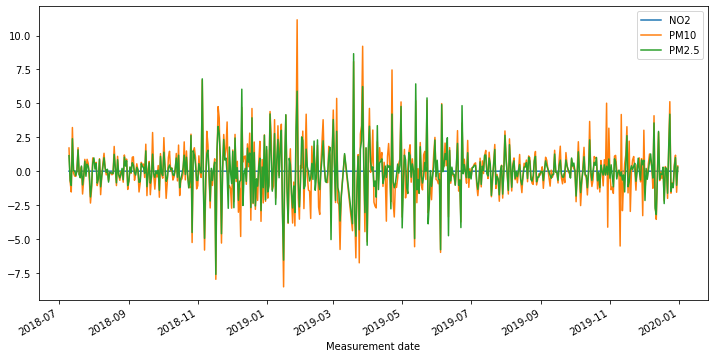

In [603]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [604]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.497729e+00
p-value                        4.334791e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.987235e+00
p-value                        2.529757e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.545976e+00
p-value                        9.097526e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)      

In [605]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.011255e+01
p-value                        9.915354e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.105650e+01
p-value                        4.929812e-20
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.935558e+00
p-value                        2.749725e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 118 PM2.5

In [606]:
base_model = sm.tsa.statespace.SARIMAX(df_118['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4582.478
Date:                Wed, 20 Oct 2021   AIC                           9168.956
Time:                        14:58:31   BIC                           9178.934
Sample:                             0   HQIC                          9172.733
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.9019      0.707     35.227      0.000      23.516      26.287
sigma2       272.8949      8.521     32.026      0.000     256.194     289.596
Ljung-Box (L1) (Q):                 486.14   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8652.837, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10453.225, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8667.406, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9576.759, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8509.047, Time=0.29 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8661.638, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8497.629, Time=0.22 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8613.031, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8498.099, Time=0.31 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8499.200, Time=0.41 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8496.811, Time=0.23 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=8529.727, Time=0.10 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=8498.741, Time=0.32 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=8499.303, Time=0.19 sec
 ARIMA(3,0,3)(0,0,0)[0]         

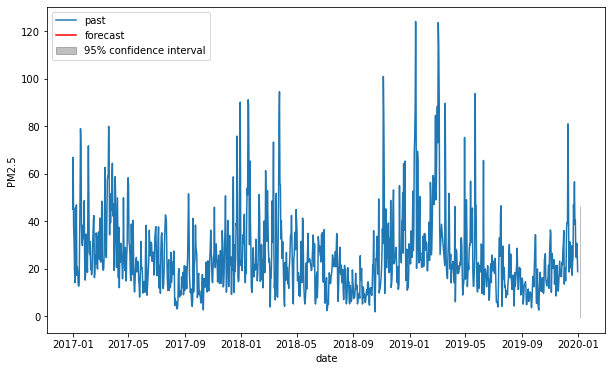

In [607]:
timeseries = df_118['PM2.5']
automodel = arimamodel(df_118['PM2.5'])
plotarima(1, timeseries, automodel)

In [608]:
best_model = sm.tsa.statespace.SARIMAX(df_118['PM2.5'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood               -4237.649
Date:                Wed, 20 Oct 2021   AIC                           8487.298
Time:                        14:58:40   BIC                           8517.234
Sample:                             0   HQIC                          8498.630
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.9298      0.390      2.384      0.017       0.165       1.694
ar.L1          0.9630      0.014     69.566      0.000       0.936       0.990
ma.L1         -0.2956      0.026    -11.363      0.0

In [609]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[1,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 11.341002074460496
Test RMSE: 21.92060994662327
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(1, 0, 3)   Log Likelihood               -2088.536
Date:                Wed, 20 Oct 2021   AIC                           4189.072
Time:                        14:58:40   BIC                           4214.854
Sample:                    01-01-2017   HQIC                          4199.153
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.3067      3.199      8.224      0.000      20.037      32.576
ar.L1          0.9754      0.021     46.351      0.000       0

# Station 118 PM10

In [610]:
base_model = sm.tsa.statespace.SARIMAX(df_118['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4954.483
Date:                Wed, 20 Oct 2021   AIC                           9912.966
Time:                        14:58:40   BIC                           9922.945
Sample:                             0   HQIC                          9916.744
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     39.9576      0.926     43.148      0.000      38.143      41.773
sigma2       541.7532     14.982     36.160      0.000     512.388     571.118
Ljung-Box (L1) (Q):                 500.56   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9341.288, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11400.656, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9389.689, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10485.876, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9210.761, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9365.232, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9210.407, Time=0.20 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9325.475, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9211.745, Time=0.28 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.26 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9210.195, Time=0.29 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9246.831, Time=0.10 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9211.763, Time=0.35 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9221.243, Time=0.15 sec
 ARIMA(3,0,3)(0,0,0)[0]             

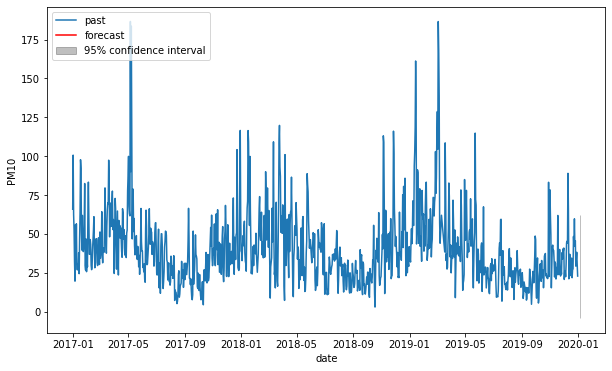

In [611]:
timeseries = df_118['PM10']
automodel = arimamodel(df_118['PM10'])
plotarima(1, timeseries, automodel)

In [612]:
best_model = sm.tsa.statespace.SARIMAX(df_118['PM10'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood               -4596.373
Date:                Wed, 20 Oct 2021   AIC                           9204.746
Time:                        14:58:49   BIC                           9234.682
Sample:                             0   HQIC                          9216.078
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3655      0.253      1.442      0.149      -0.131       0.862
ar.L1          1.5354      0.035     44.396      0.000       1.468       1.603
ar.L2         -0.6107      0.037    -16.714      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [613]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.304615942352175
Test RMSE: 30.90572009347854
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 1)   Log Likelihood               -2318.396
Date:                Wed, 20 Oct 2021   AIC                           4648.792
Time:                        14:58:49   BIC                           4674.575
Sample:                    01-01-2017   HQIC                          4658.873
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.0692      5.565      7.739      0.000      32.161      53.977
ar.L1          1.5120      0.048     31.582      0.000       1

# Station 118 NO2

In [614]:
base_model = sm.tsa.statespace.SARIMAX(df_118['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                3128.290
Date:                Wed, 20 Oct 2021   AIC                          -6252.581
Time:                        14:58:49   BIC                          -6242.602
Sample:                             0   HQIC                         -6248.803
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0306      0.000     74.341      0.000       0.030       0.031
sigma2         0.0002   5.57e-06     32.915      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 368.80   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6655.603, Time=0.22 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4289.768, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6485.844, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5255.737, Time=0.10 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6780.747, Time=0.30 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-6537.215, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6774.526, Time=0.33 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6786.630, Time=0.35 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6788.185, Time=0.28 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5667.728, Time=0.15 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6756.836, Time=0.48 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5903.103, Time=0.27 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-6786.176, Time=0.43 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-6732.375, Time=0.27 sec

Best model:  ARIMA

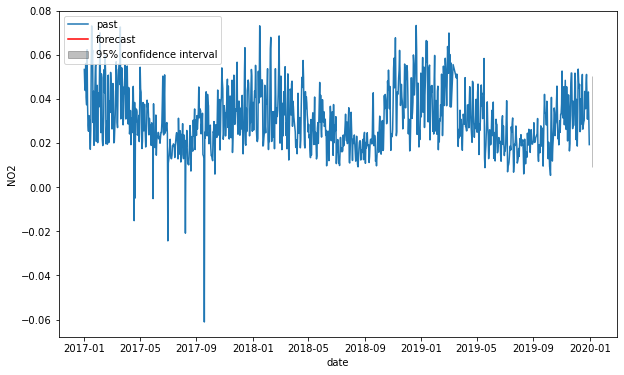

In [615]:
timeseries = df_118['NO2']
automodel = arimamodel(df_118['NO2'])
plotarima(1, timeseries, automodel)

In [616]:
best_model = sm.tsa.statespace.SARIMAX(df_118['NO2'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood                3371.187
Date:                Wed, 20 Oct 2021   AIC                          -6732.375
Time:                        14:58:53   BIC                          -6707.428
Sample:                             0   HQIC                         -6722.931
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0070      0.002      4.228      0.000       0.004       0.010
ar.L1          0.7708      0.053     14.659      0.000       0.668       0.874
ma.L1         -0.2237      0.062     -3.623      0.0

In [617]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.011769540543222247
Test RMSE: 0.017532764078006788
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood                1641.891
Date:                Wed, 20 Oct 2021   AIC                          -3273.783
Time:                        14:58:53   BIC                          -3252.297
Sample:                    01-01-2017   HQIC                         -3265.382
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0323      0.003     10.779      0.000       0.026       0.038
ar.L1          0.9868      0.009    107.944      0.000   

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 119

In [618]:
df_119 = df[df['Station code'] == 119]

In [619]:
df_119.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,119,0.004458,0.030333,0.005708,1.179167,70.250000,52.583333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,119,0.004292,0.027042,0.013875,1.025000,107.333333,74.541667,Good,Good,Good,Good,Bad,Bad
2017-01-03,119,-0.121292,-0.102583,-0.114958,0.583333,55.833333,36.416667,Good,Good,Good,Good,Normal,Bad
2017-01-04,119,0.004375,0.033333,0.007958,1.008333,56.708333,33.500000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,119,0.004417,0.025292,0.010083,0.733333,36.750000,23.958333,Good,Good,Good,Good,Normal,Normal


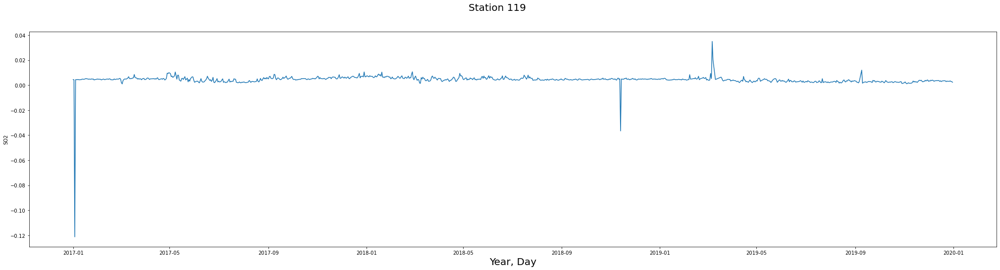

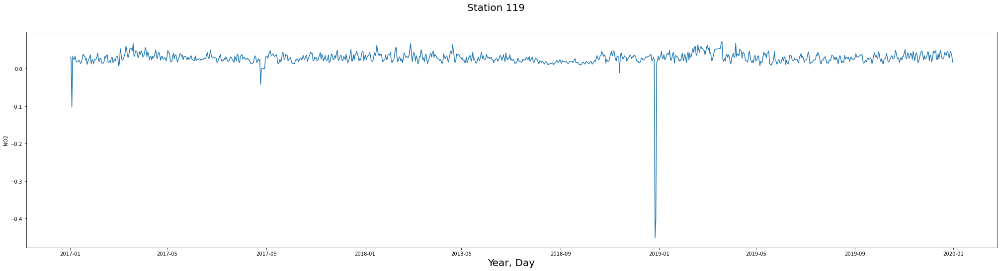

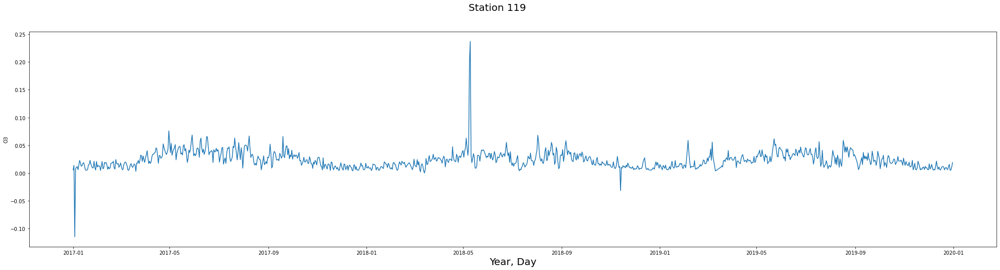

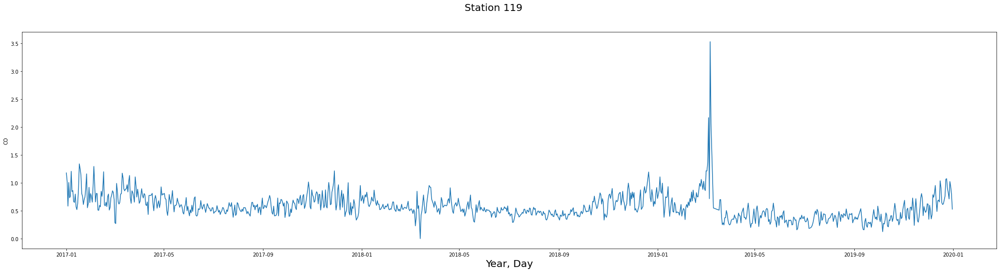

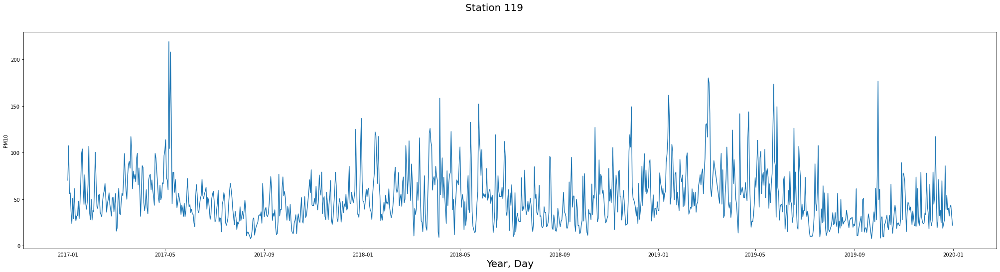

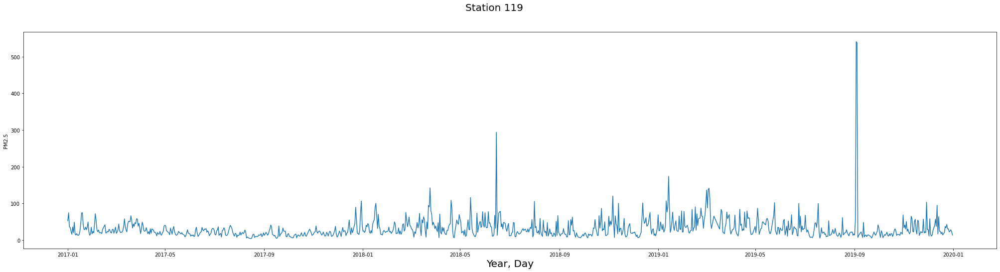

In [620]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 119", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_119)

In [621]:
df_119['NO2 Level'].value_counts()

Good      617
Normal    458
Bad        10
Name: NO2 Level, dtype: int64

In [622]:
df_119['PM2.5 Level'].value_counts()

Normal      542
Bad         253
Good        236
Very Bad     52
Name: PM2.5 Level, dtype: int64

In [623]:
df_119['PM10 Level'].value_counts()

Normal      688
Good        266
Bad         122
Very Bad      9
Name: PM10 Level, dtype: int64

###### For Station 119:
- NO2 reaches levels of 'Bad' on 10 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 122 occasions and 'Very Bad' on 9, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Very Bad' on 52 occasions.

# Picking the relevant columns

In [624]:
columns = ['NO2', 'PM10', 'PM2.5']
df_119 = df_119[columns]
df_119

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.030333,70.250000,52.583333
2017-01-02,0.027042,107.333333,74.541667
2017-01-03,-0.102583,55.833333,36.416667
2017-01-04,0.033333,56.708333,33.500000
2017-01-05,0.025292,36.750000,23.958333
...,...,...,...
2019-12-27,0.029250,31.791667,22.041667
2019-12-28,0.046667,41.291667,24.541667
2019-12-29,0.042167,43.666667,28.041667


# Train-Test Split

In [625]:
train = df_119[:-542]
test = df_119[542:]

<AxesSubplot:xlabel='Measurement date'>

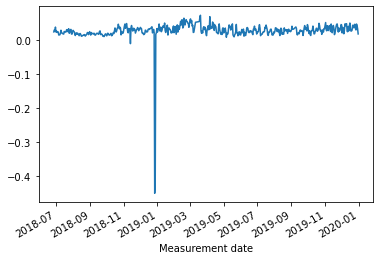

In [626]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

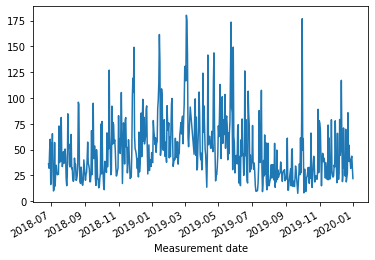

In [627]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

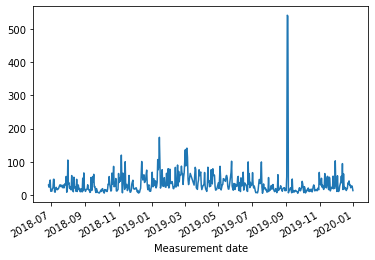

In [628]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

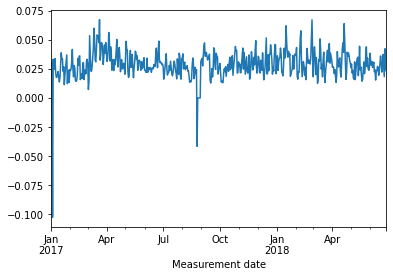

In [629]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

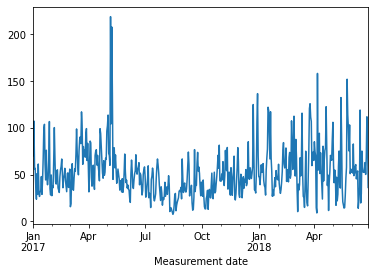

In [630]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

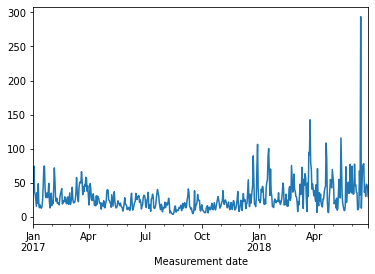

In [631]:
train['PM2.5'].plot()

In [632]:
print(stationarity_check(df_119['PM2.5']))
print(stationarity_check(df_119['PM10']))
print(stationarity_check(df_119['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -1.470337e+01
p-value                        2.922969e-27
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.403943e+00
p-value                        7.429371e-11
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.196626e+00
p-value                        7.419432e-13
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)      

# Rolling Mean Difference Train

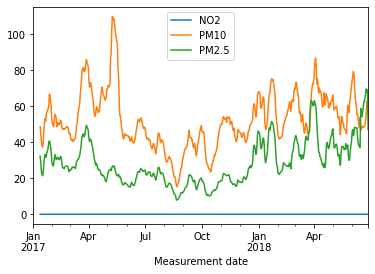

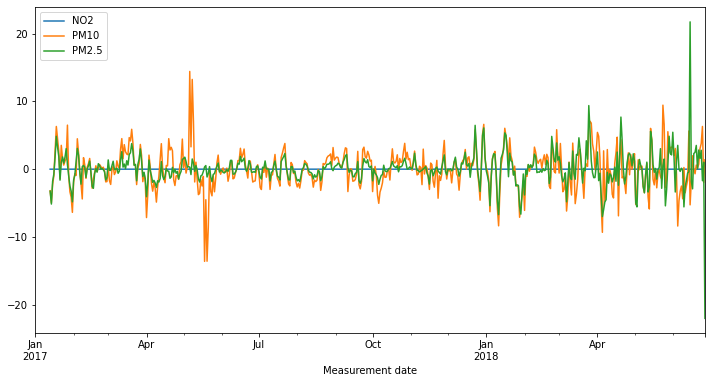

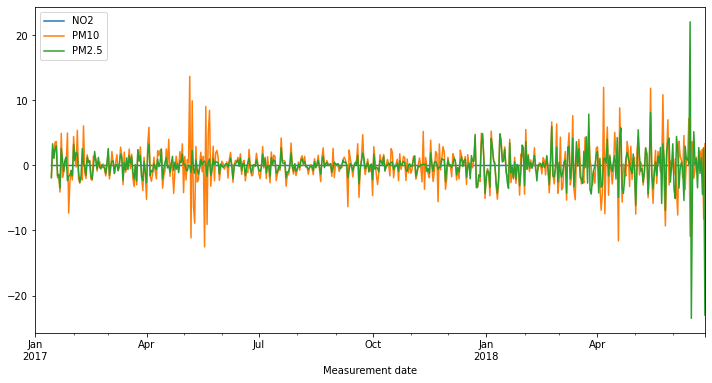

In [633]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [634]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.151103e+00
p-value                        3.139569e-10
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.463127e+00
p-value                        1.547937e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.459977e+00
p-value                        1.576924e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [635]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.110937e+01
p-value                        3.693020e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.045489e+01
p-value                        1.406997e-18
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.145740e+01
p-value                        5.662499e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)      

# Rolling Mean Difference Test

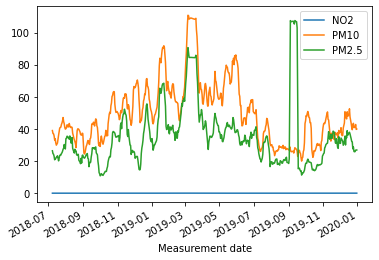

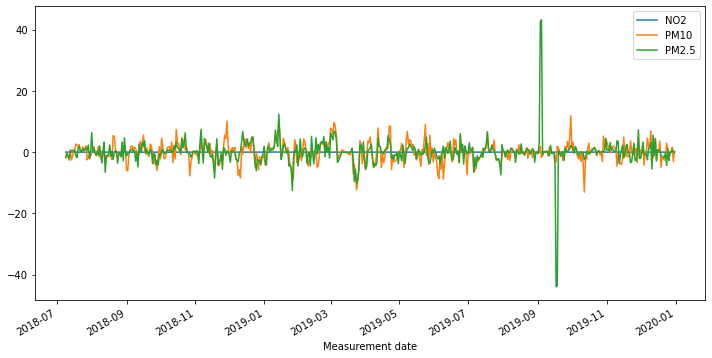

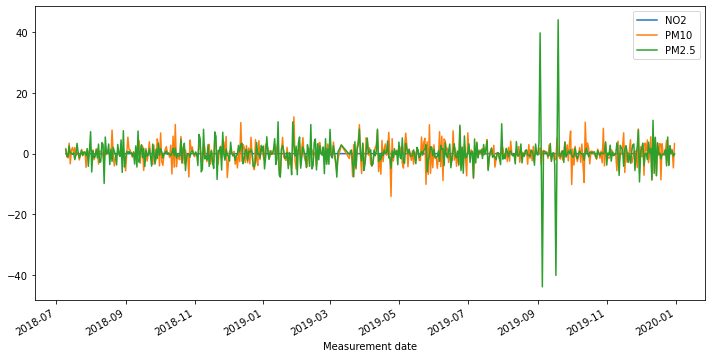

In [636]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [637]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.413927e+00
p-value                        7.015969e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.303426e+00
p-value                        1.096855e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.552061e+00
p-value                        3.169640e-11
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)      

In [638]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.544767e+00
p-value                        2.667510e-16
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.015707e+01
p-value                        7.679799e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.011661e+01
p-value                        9.687083e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 119 PM2.5

In [639]:
base_model = sm.tsa.statespace.SARIMAX(df_119['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5286.456
Date:                Wed, 20 Oct 2021   AIC                          10576.912
Time:                        14:58:58   BIC                          10586.891
Sample:                             0   HQIC                         10580.689
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     31.4495      1.511     20.808      0.000      28.487      34.412
sigma2       998.9874      8.433    118.456      0.000     982.458    1015.516
Ljung-Box (L1) (Q):                 243.46   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10462.792, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11321.578, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10480.595, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10769.899, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10483.893, Time=0.18 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10294.076, Time=0.16 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10633.864, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10287.240, Time=0.23 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=10289.223, Time=0.39 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=10289.293, Time=0.44 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=10287.410, Time=0.31 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10290.010, Time=0.29 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=10290.573, Time=0.53 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=10284.133, Time=0.54 sec
 ARIMA(1,0,2)(0,0,0

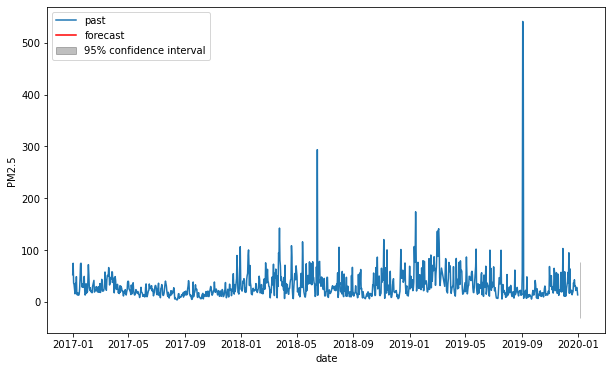

In [640]:
timeseries = df_119['PM2.5']
automodel = arimamodel(df_119['PM2.5'])
plotarima(1, timeseries, automodel)

In [641]:
best_model = sm.tsa.statespace.SARIMAX(df_119['PM2.5'], trend='c', order=[1,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 3)   Log Likelihood               -5135.478
Date:                Wed, 20 Oct 2021   AIC                          10282.956
Time:                        14:59:07   BIC                          10312.893
Sample:                             0   HQIC                         10294.289
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.0389      0.976      1.065      0.287      -0.873       2.951
ar.L1          0.9663      0.030     32.501      0.000       0.908       1.025
ma.L1         -0.4540      0.029    -15.772      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [642]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[1,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 18.9334730740811
Test RMSE: 41.73174035058233
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(1, 0, 3)   Log Likelihood               -2367.440
Date:                Wed, 20 Oct 2021   AIC                           4746.879
Time:                        14:59:07   BIC                           4772.662
Sample:                    01-01-2017   HQIC                          4756.960
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         32.5990      9.121      3.574      0.000      14.723      50.475
ar.L1          0.9931      0.010     97.927      0.000       0.9

# Station 119 PM10

In [643]:
base_model = sm.tsa.statespace.SARIMAX(df_119['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5172.808
Date:                Wed, 20 Oct 2021   AIC                          10349.616
Time:                        14:59:07   BIC                          10359.595
Sample:                             0   HQIC                         10353.393
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     50.5655      1.108     45.653      0.000      48.395      52.736
sigma2       810.1770     26.596     30.462      0.000     758.049     862.305
Ljung-Box (L1) (Q):                 302.72   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10073.054, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11893.241, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10225.590, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11131.255, Time=0.09 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9962.780, Time=0.20 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=10147.468, Time=0.10 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9964.174, Time=0.25 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9964.142, Time=0.24 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9991.069, Time=0.12 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=10106.195, Time=0.09 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9965.818, Time=0.41 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9956.954, Time=0.41 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9985.901, Time=0.15 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9989.822, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0)[0] int

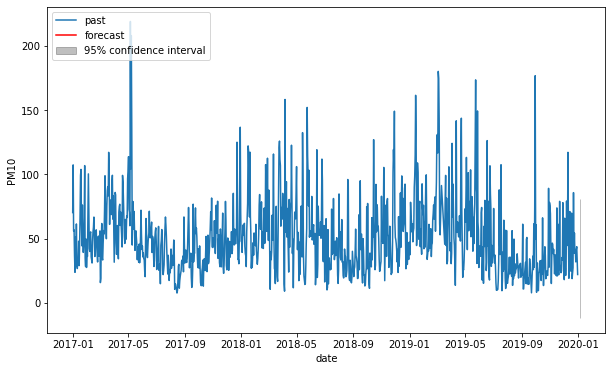

In [644]:
timeseries = df_119['PM10']
automodel = arimamodel(df_119['PM10'])
plotarima(1, timeseries, automodel)

In [645]:
best_model = sm.tsa.statespace.SARIMAX(df_119['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4973.477
Date:                Wed, 20 Oct 2021   AIC                           9956.954
Time:                        14:59:12   BIC                           9981.900
Sample:                             0   HQIC                          9966.397
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5379      0.332      1.618      0.106      -0.114       1.189
ar.L1          1.3846      0.033     41.584      0.000       1.319       1.450
ar.L2         -0.3956      0.029    -13.545      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [646]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 22.30634072832426
Test RMSE: 35.87414554613655
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2456.503
Date:                Wed, 20 Oct 2021   AIC                           4923.006
Time:                        14:59:12   BIC                           4944.491
Sample:                    01-01-2017   HQIC                          4931.406
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         52.9946      6.034      8.782      0.000      41.167      64.822
ar.L1          1.4323      0.052     27.794      0.000       1.

# Station 119 NO2

In [647]:
base_model = sm.tsa.statespace.SARIMAX(df_119['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2565.398
Date:                Wed, 20 Oct 2021   AIC                          -5126.796
Time:                        14:59:12   BIC                          -5116.817
Sample:                             0   HQIC                         -5123.018
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0279      0.001     20.147      0.000       0.025       0.031
sigma2         0.0005   3.62e-06    142.917      0.000       0.001       0.001
Ljung-Box (L1) (Q):                 288.07   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5276.968, Time=0.13 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4133.520, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5268.276, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5006.918, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-5354.803, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-5267.920, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-5457.230, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-5425.071, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-5440.776, Time=0.38 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-5572.319, Time=0.43 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-5575.306, Time=0.29 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-5580.082, Time=0.27 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5122.014, Time=0.11 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-5576.568, Time=0.27 sec
 ARIMA(0,0,3)(0,0,0

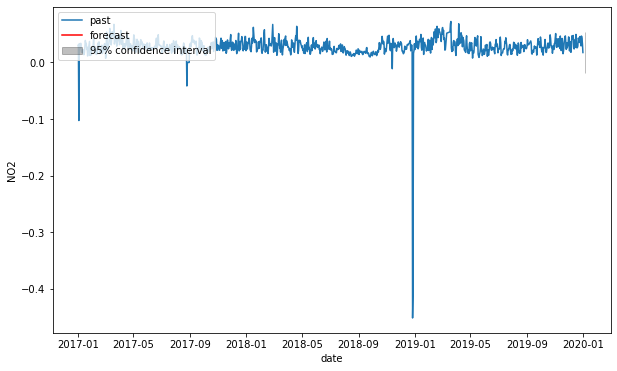

In [648]:
timeseries = df_119['NO2']
automodel = arimamodel(df_119['NO2'])
plotarima(1, timeseries, automodel)

In [649]:
best_model = sm.tsa.statespace.SARIMAX(df_119['NO2'], trend='c', order=[0,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(0, 0, 3)   Log Likelihood                2799.532
Date:                Wed, 20 Oct 2021   AIC                          -5589.065
Time:                        14:59:21   BIC                          -5564.118
Sample:                             0   HQIC                         -5579.621
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0278      0.002     15.275      0.000       0.024       0.031
ma.L1          0.7311      0.008     88.503      0.000       0.715       0.747
ma.L2          0.0619      0.010      6.008      0.0

In [650]:
model_train = arima_results(train['NO2'],test['NO2'], order=[0,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.010842760166496695
Test RMSE: 0.03034422808289554
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(0, 0, 3)   Log Likelihood                1687.462
Date:                Wed, 20 Oct 2021   AIC                          -3364.924
Time:                        14:59:22   BIC                          -3343.438
Sample:                    01-01-2017   HQIC                         -3356.523
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0291      0.001     32.301      0.000       0.027       0.031
ma.L1          0.3994      0.018     22.585      0.000    

# Station 120

In [651]:
df_120 = df[df['Station code'] == 120]

In [652]:
df_120.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,120,0.005417,0.058292,0.003583,1.104167,71.666667,57.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,120,0.009417,0.045167,0.018000,1.270833,99.791667,82.041667,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,120,0.004708,0.041167,0.017417,0.729167,63.416667,45.500000,Good,Normal,Good,Good,Normal,Bad
2017-01-04,120,0.005000,0.055958,0.008958,0.862500,52.250000,35.333333,Good,Normal,Good,Good,Normal,Bad
2017-01-05,120,0.003833,0.045333,0.008750,0.720833,32.458333,23.958333,Good,Normal,Good,Good,Normal,Normal


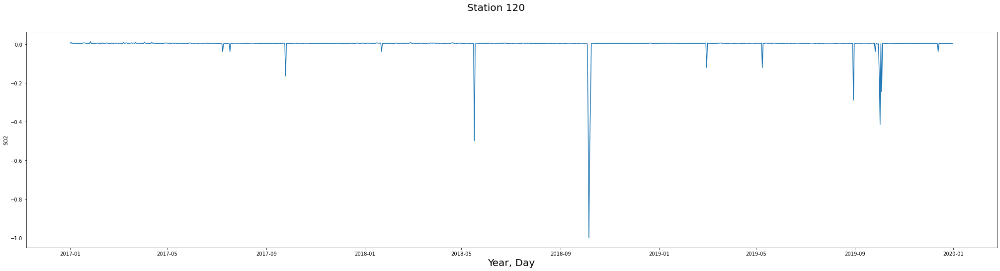

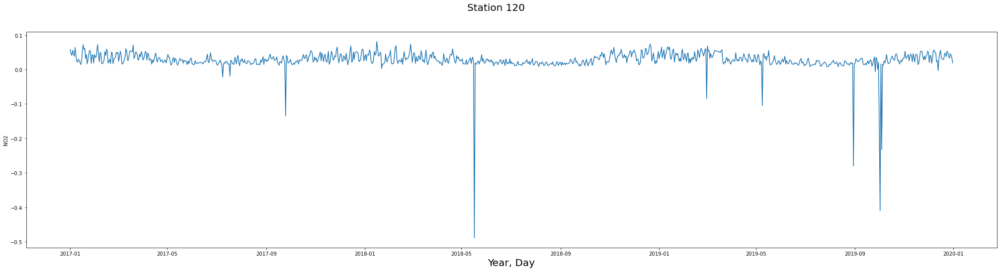

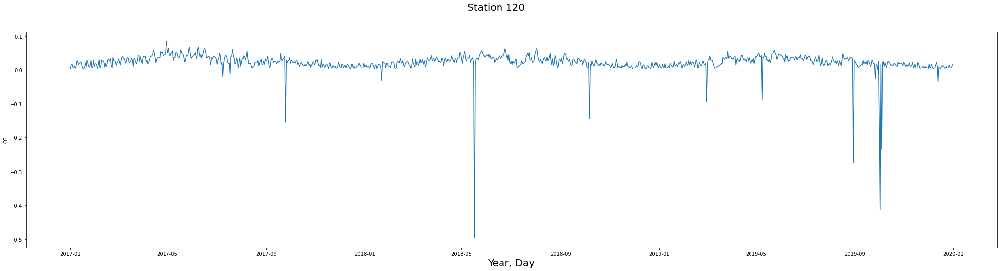

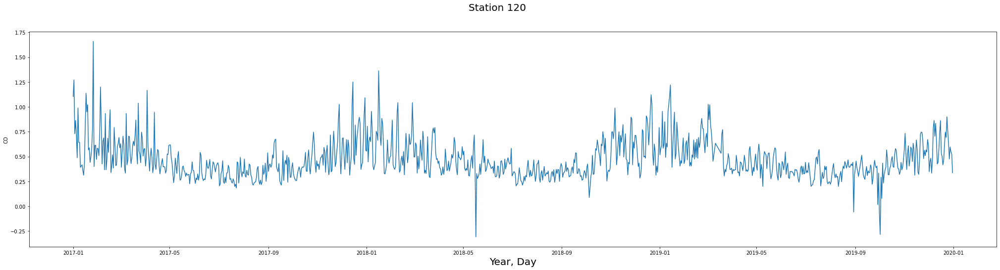

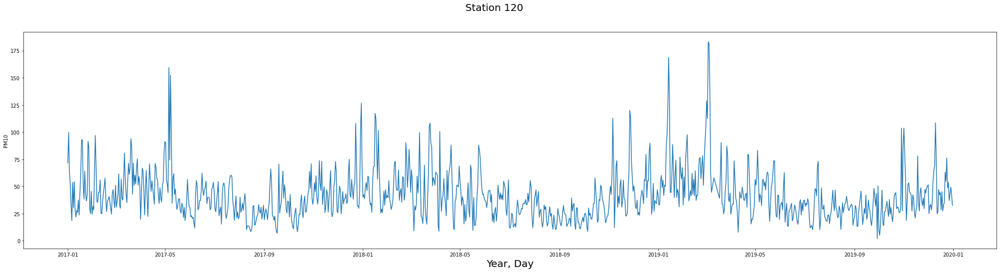

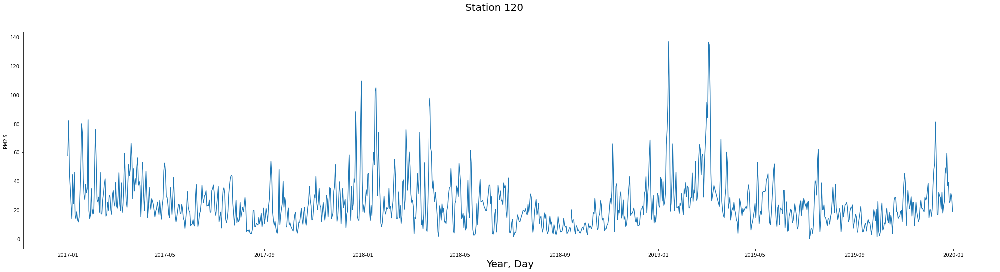

In [653]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 120", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_120)

In [654]:
df_120['NO2 Level'].value_counts()

Good      638
Normal    420
Bad        27
Name: NO2 Level, dtype: int64

In [655]:
df_120['PM2.5 Level'].value_counts()

Normal      556
Good        323
Bad         183
Very Bad     23
Name: PM2.5 Level, dtype: int64

In [656]:
df_120['PM10 Level'].value_counts()

Normal      681
Good        343
Bad          56
Very Bad      5
Name: PM10 Level, dtype: int64

###### For Station 120
- NO2 reaches levels of 'Bad' on 27 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 56 occasions and 'Very Bad' on 5, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 183 occasions and 'Very Bad' on 23 occasions.

# Picking the relevant columns

In [657]:
columns = ['NO2', 'PM10', 'PM2.5']
df_120 = df_120[columns]
df_120

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.058292,71.666667,57.666667
2017-01-02,0.045167,99.791667,82.041667
2017-01-03,0.041167,63.416667,45.500000
2017-01-04,0.055958,52.250000,35.333333
2017-01-05,0.045333,32.458333,23.958333
...,...,...,...
2019-12-27,0.033125,37.000000,25.125000
2019-12-28,0.045750,42.958333,26.000000
2019-12-29,0.041667,49.458333,31.416667


In [658]:
train = df_120[:-542]
test = df_120[542:]

<AxesSubplot:xlabel='Measurement date'>

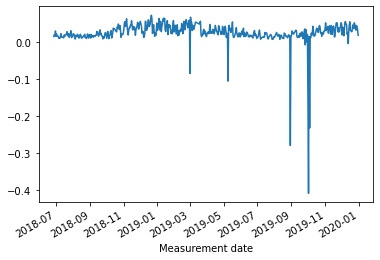

In [659]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

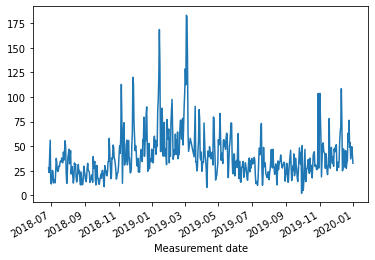

In [660]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

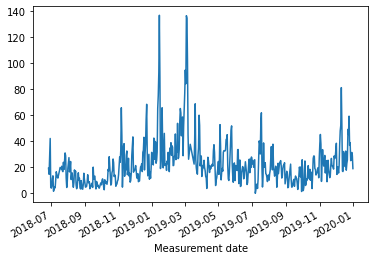

In [661]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

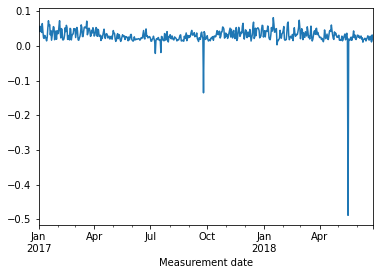

In [662]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

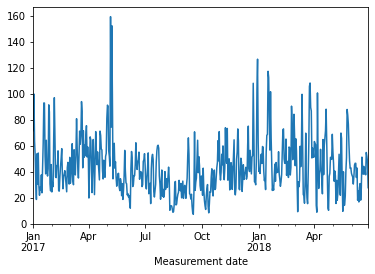

In [663]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

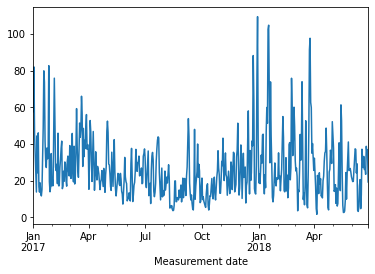

In [664]:
train['PM2.5'].plot()

In [665]:
print(stationarity_check(df_120['PM2.5']))
print(stationarity_check(df_120['PM10']))
print(stationarity_check(df_120['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.178565e+00
p-value                        2.686958e-10
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.151115e+00
p-value                        3.139364e-10
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.397643e+01
p-value                        4.253526e-26
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)      

# Rolling Mean Difference Train

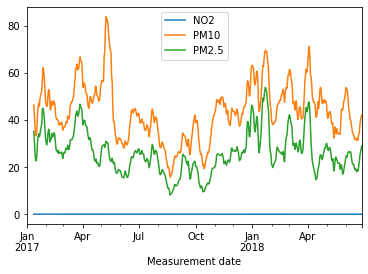

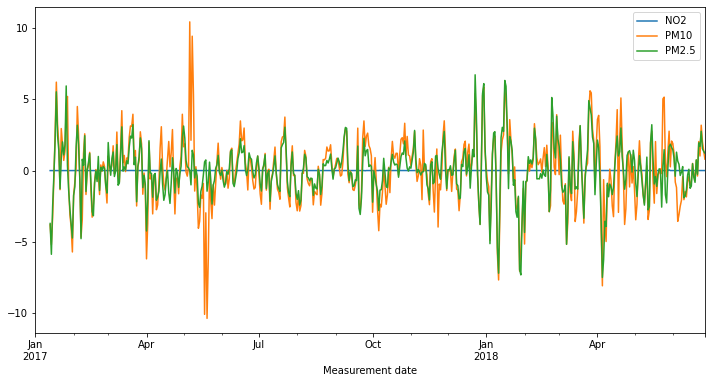

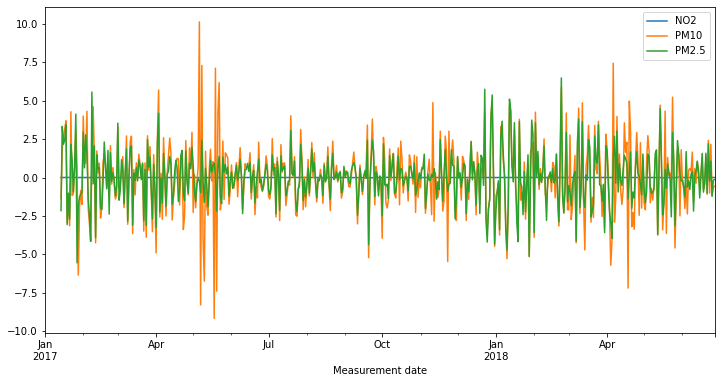

In [666]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [667]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.982352e+00
p-value                        8.130902e-10
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.274288e+00
p-value                        4.701942e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.095975e+01
p-value                        8.384321e-20
#Lags Used                     1.100000e+01
Number of Observations Used    5.190000e+02
Critical Value (1%)           -3.443013e+00
Critical Value (5%)      

In [668]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.143010e+01
p-value                        6.548706e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.072472e+01
p-value                        3.086329e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.012994e+01
p-value                        8.973408e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

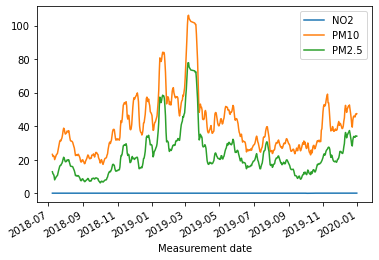

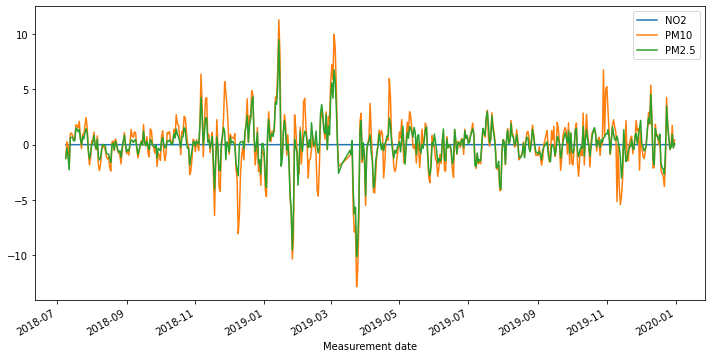

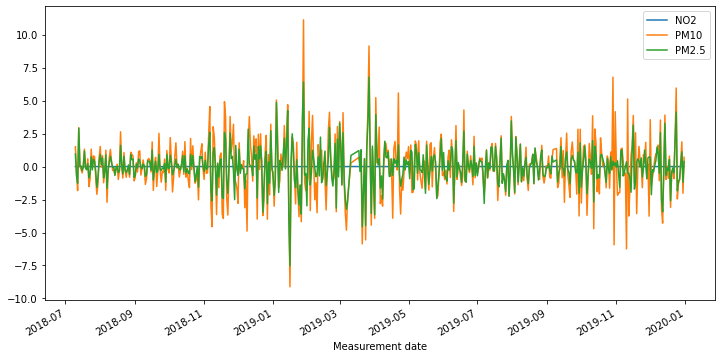

In [669]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [670]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.101941e+00
p-value                        9.787897e-08
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.100794e+00
p-value                        1.301526e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.720978e+00
p-value                        3.483799e-09
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

In [671]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.940117e+00
p-value                        2.678217e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.042851e+01
p-value                        1.633737e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.270218e+00
p-value                        1.333047e-15
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Station 120 PM2.5

In [672]:
base_model = sm.tsa.statespace.SARIMAX(df_120['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4615.861
Date:                Wed, 20 Oct 2021   AIC                           9235.721
Time:                        14:59:26   BIC                           9245.700
Sample:                             0   HQIC                          9239.499
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.3923      0.712     34.273      0.000      22.997      25.787
sigma2       290.2150      7.792     37.246      0.000     274.943     305.487
Ljung-Box (L1) (Q):                 526.77   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8640.457, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10443.701, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8638.520, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9489.426, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8640.492, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8628.192, Time=0.10 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8470.887, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8570.372, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8465.066, Time=0.32 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8558.487, Time=0.12 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8466.622, Time=0.46 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.33 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8464.831, Time=0.35 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=8463.037, Time=0.17 sec
 ARIMA(1,0,2)(0,0,0)[0]             :

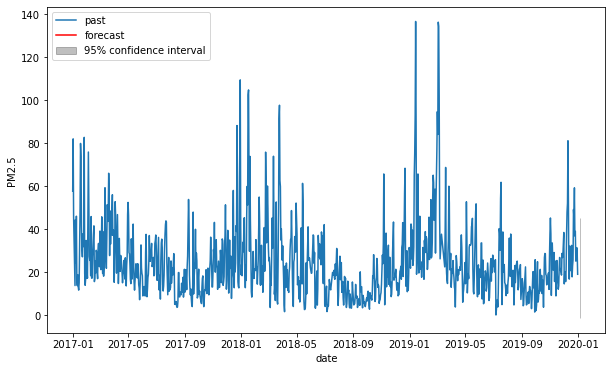

In [673]:
timeseries = df_120['PM2.5']
automodel = arimamodel(df_120['PM2.5'])
plotarima(1, timeseries, automodel)

In [674]:
best_model = sm.tsa.statespace.SARIMAX(df_120['PM2.5'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4221.704
Date:                Wed, 20 Oct 2021   AIC                           8455.408
Time:                        14:59:34   BIC                           8485.344
Sample:                             0   HQIC                          8466.741
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3111      0.218      1.425      0.154      -0.117       0.739
ar.L1          1.3505      0.055     24.653      0.000       1.243       1.458
ar.L2         -0.3630      0.049     -7.338      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [675]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 12.657935114032625
Test RMSE: 22.044788880836208
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2147.540
Date:                Wed, 20 Oct 2021   AIC                           4307.080
Time:                        14:59:34   BIC                           4332.862
Sample:                    01-01-2017   HQIC                          4317.161
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.8060      3.448      7.774      0.000      20.048      33.564
ar.L1          1.2985      0.078     16.652      0.000       

# Station 120 PM10

In [676]:
base_model = sm.tsa.statespace.SARIMAX(df_120['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4912.781
Date:                Wed, 20 Oct 2021   AIC                           9829.562
Time:                        14:59:35   BIC                           9839.541
Sample:                             0   HQIC                          9833.339
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     41.6747      0.882     47.269      0.000      39.947      43.403
sigma2       501.6689     14.193     35.346      0.000     473.851     529.487
Ljung-Box (L1) (Q):                 466.38   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9358.191, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11450.284, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9385.538, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10499.696, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9205.790, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9372.789, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9198.929, Time=0.23 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9327.062, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9200.150, Time=0.33 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9202.947, Time=0.43 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9198.562, Time=0.10 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9239.680, Time=0.11 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9200.185, Time=0.35 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=9207.118, Time=0.19 sec
 ARIMA(3,0,3)(0,0,0)[0]        

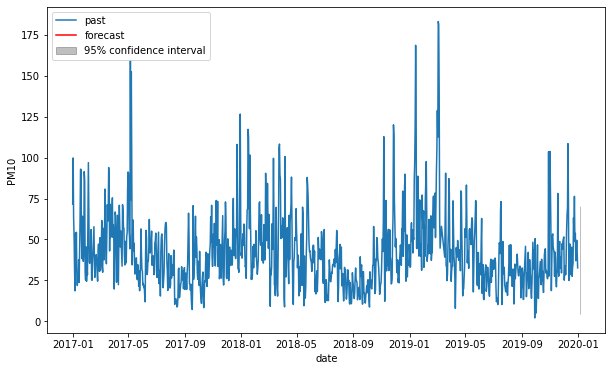

In [677]:
timeseries = df_120['PM10']
automodel = arimamodel(df_120['PM10'])
plotarima(1, timeseries, automodel)

In [678]:
best_model = sm.tsa.statespace.SARIMAX(df_120['PM10'], trend='c', order=[2,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 2)   Log Likelihood               -4590.045
Date:                Wed, 20 Oct 2021   AIC                           9192.090
Time:                        14:59:43   BIC                           9222.026
Sample:                             0   HQIC                          9203.423
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.6788      0.430      1.578      0.115      -0.165       1.522
ar.L1          1.3714      0.064     21.506      0.000       1.246       1.496
ar.L2         -0.3876      0.057     -6.825      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [679]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 17.087092760563767
Test RMSE: 29.13388171755011
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 2)   Log Likelihood               -2311.395
Date:                Wed, 20 Oct 2021   AIC                           4634.790
Time:                        14:59:43   BIC                           4660.573
Sample:                    01-01-2017   HQIC                          4644.871
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.8294      4.235     10.349      0.000      35.529      52.130
ar.L1          1.3381      0.080     16.799      0.000       1

# Station 120 NO2

In [680]:
base_model = sm.tsa.statespace.SARIMAX(df_120['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2297.278
Date:                Wed, 20 Oct 2021   AIC                          -4590.556
Time:                        14:59:43   BIC                          -4580.578
Sample:                             0   HQIC                         -4586.779
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0279      0.002     17.495      0.000       0.025       0.031
sigma2         0.0008    7.4e-06    114.575      0.000       0.001       0.001
Ljung-Box (L1) (Q):                  66.48   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4677.521, Time=0.21 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-3884.347, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-4382.474, Time=0.07 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-4157.953, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4695.170, Time=0.29 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4527.034, Time=0.07 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-4693.909, Time=0.34 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-4674.077, Time=0.28 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-4691.424, Time=0.25 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-4570.821, Time=0.10 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-4691.177, Time=0.38 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-4693.132, Time=0.41 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 2.491 seconds


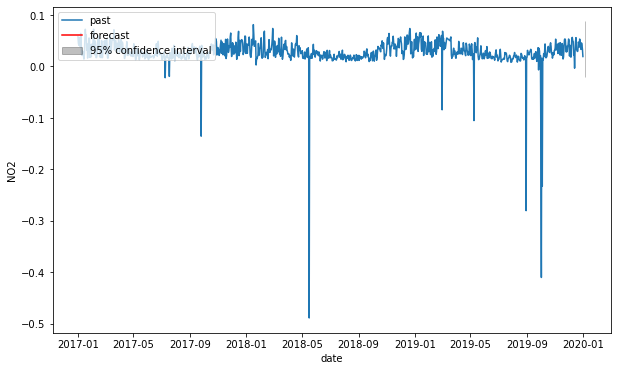

In [681]:
timeseries = df_120['NO2']
automodel = arimamodel(df_120['NO2'])
plotarima(1, timeseries, automodel)

In [682]:
best_model = sm.tsa.statespace.SARIMAX(df_120['NO2'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood                2351.566
Date:                Wed, 20 Oct 2021   AIC                          -4693.132
Time:                        14:59:46   BIC                          -4668.185
Sample:                             0   HQIC                         -4683.688
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0065      0.002      2.841      0.004       0.002       0.011
ar.L1          0.7394      0.100      7.403      0.000       0.544       0.935
ar.L2          0.0288      0.024      1.209      0.2

In [683]:
model_train = arima_results(train['NO2'],test['NO2'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.02618306580280754
Test RMSE: 0.03337145033929495
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood                1207.400
Date:                Wed, 20 Oct 2021   AIC                          -2404.800
Time:                        14:59:46   BIC                          -2383.315
Sample:                    01-01-2017   HQIC                         -2396.399
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0294      0.007      4.437      0.000       0.016       0.042
ar.L1          1.0557      0.076     13.981      0.000     

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 121

In [684]:
df_121 = df[df['Station code'] == 121]

In [685]:
df_121.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,121,0.006375,0.064333,0.005375,1.258333,74.958333,55.750000,Good,Bad,Good,Good,Normal,Bad
2017-01-02,121,0.007833,0.047792,0.016667,0.975000,95.375000,67.916667,Good,Normal,Good,Good,Bad,Bad
2017-01-03,121,0.006917,0.048583,0.013875,0.816667,64.291667,42.083333,Good,Normal,Good,Good,Normal,Bad
2017-01-04,121,0.006750,0.063958,0.008792,1.000000,54.666667,37.000000,Good,Bad,Good,Good,Normal,Bad
2017-01-05,121,0.005542,0.049667,0.007667,0.695833,33.708333,24.541667,Good,Normal,Good,Good,Normal,Normal


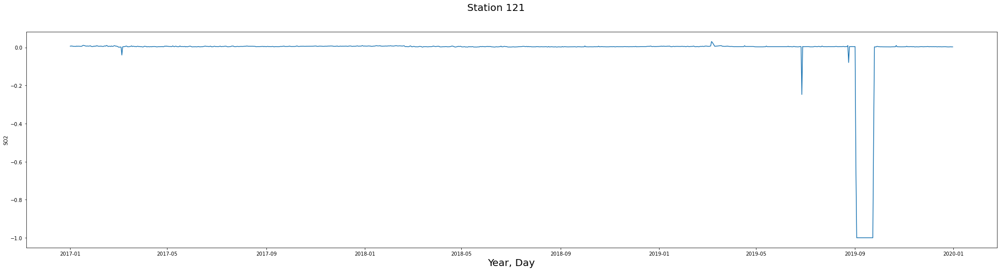

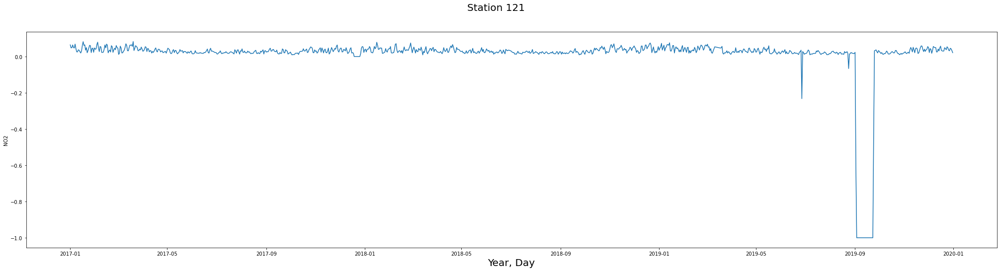

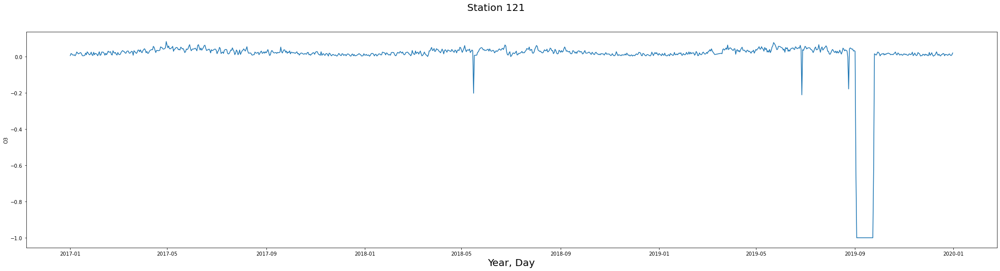

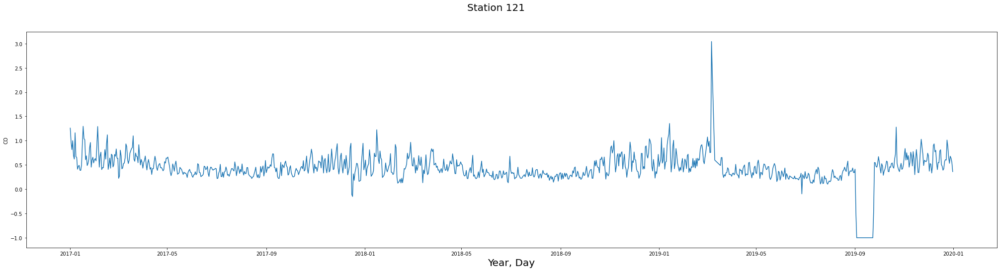

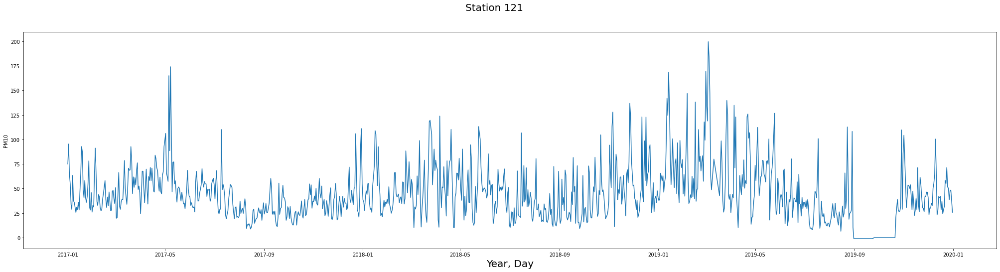

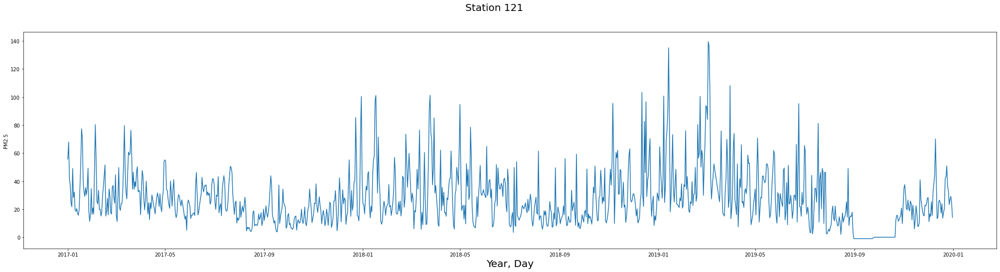

In [686]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 121", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_121)

In [687]:
df_121['NO2 Level'].value_counts()

Good      603
Normal    433
Bad        49
Name: NO2 Level, dtype: int64

In [688]:
df_121['PM10 Level'].value_counts()

Normal      636
Good        345
Bad          98
Very Bad      6
Name: PM10 Level, dtype: int64

In [689]:
df_121['PM2.5 Level'].value_counts()

Normal      521
Good        283
Bad         244
Very Bad     37
Name: PM2.5 Level, dtype: int64

###### For Station 121
- NO2 reaches levels of 'Bad' on 49 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 98 occasions and 'Very Bad' on 6, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 244 occasions and 'Very Bad' on 37 occasions.

# Picking the relevant columns

In [690]:
columns = ['NO2', 'PM10', 'PM2.5']
df_121 = df_121[columns]
df_121

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.064333,74.958333,55.750000
2017-01-02,0.047792,95.375000,67.916667
2017-01-03,0.048583,64.291667,42.083333
2017-01-04,0.063958,54.666667,37.000000
2017-01-05,0.049667,33.708333,24.541667
...,...,...,...
2019-12-27,0.031542,38.541667,23.291667
2019-12-28,0.045542,47.583333,27.000000
2019-12-29,0.042500,48.500000,29.166667


In [691]:
train = df_121[:-542]
test = df_121[542:]

<AxesSubplot:xlabel='Measurement date'>

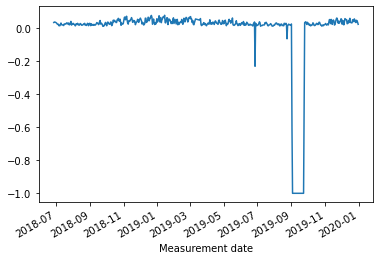

In [692]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

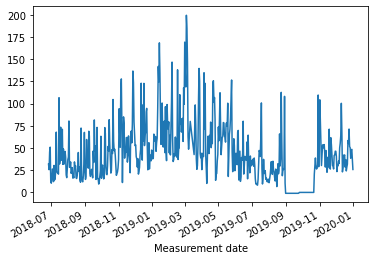

In [693]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

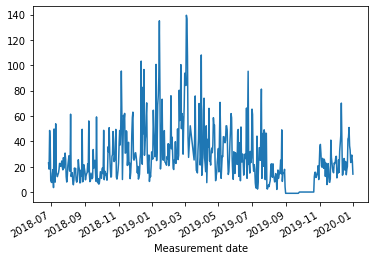

In [694]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

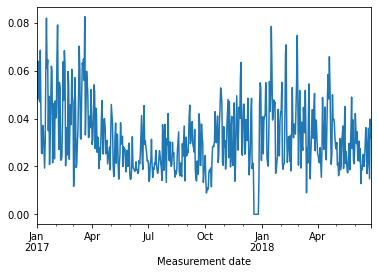

In [695]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

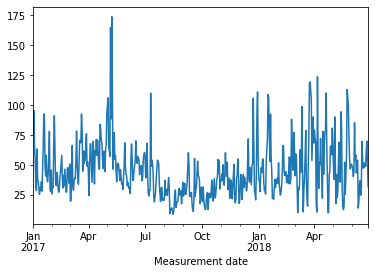

In [696]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

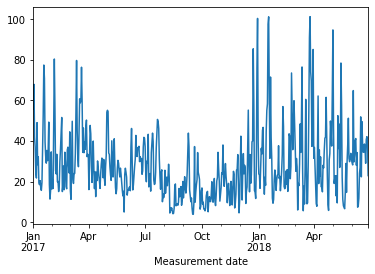

In [697]:
train['PM2.5'].plot()

In [698]:
print(stationarity_check(df_121['PM2.5']))
print(stationarity_check(df_121['PM10']))
print(stationarity_check(df_121['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -6.746870e+00
p-value                        3.019493e-09
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.491214
p-value                           0.000204
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -4.308098
p-value                           0.000430
#Lags Used                       22.000000
Number of Observations Used    1062.000000
Critical Value (1%)              -3.436522
Critical Value (5%)              -2.8

# Rolling Mean Difference Train

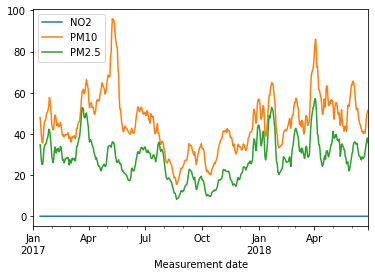

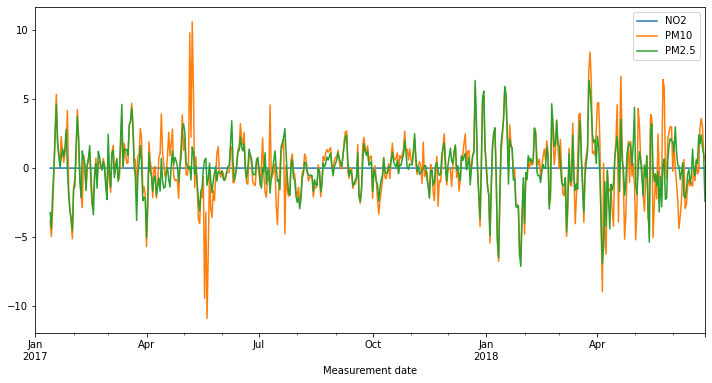

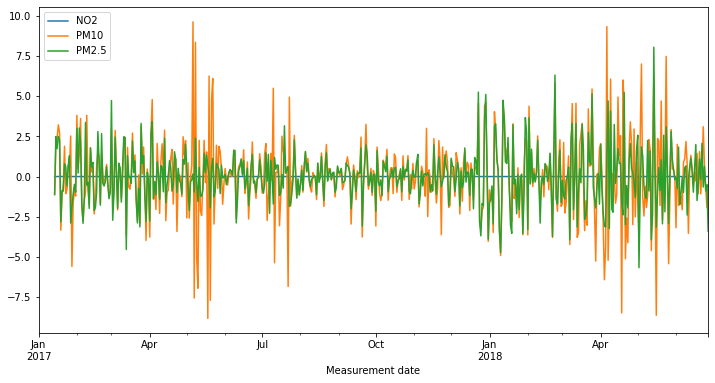

In [699]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [700]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.405284e+00
p-value                        7.372483e-11
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.319530e+00
p-value                        3.603913e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.703248e+00
p-value                        1.322089e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [701]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.105103e+01
p-value                        5.079565e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.000510e+01
p-value                        1.840393e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.041680e+01
p-value                        1.745914e-18
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)      

# Rolling Mean Difference Test

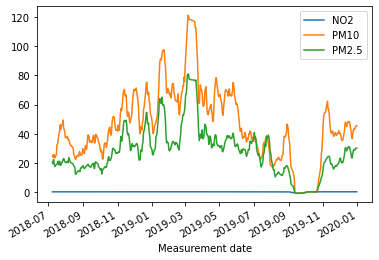

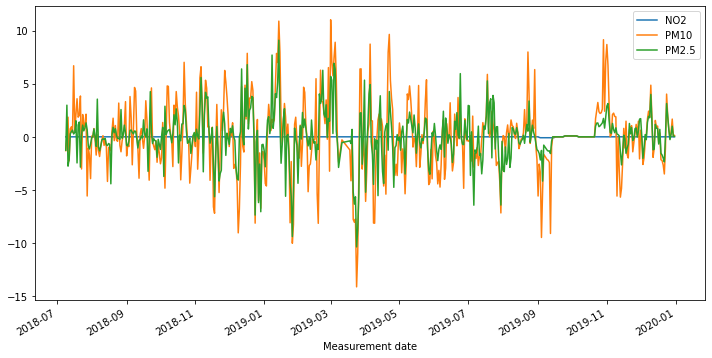

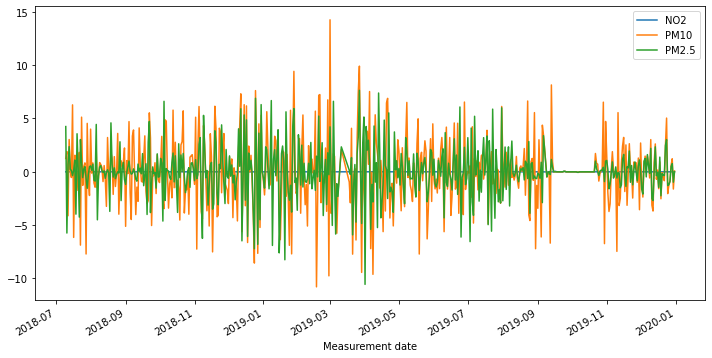

In [702]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [703]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.701723e+00
p-value                        3.793406e-14
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.594642e+00
p-value                        7.131951e-14
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.831820e+00
p-value                        1.885236e-09
#Lags Used                     1.800000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

In [704]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.757712e+00
p-value                        7.709743e-17
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.106947e+01
p-value                        4.592180e-20
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.629638e+00
p-value                        5.802438e-14
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 121 PM2.5

In [705]:
base_model = sm.tsa.statespace.SARIMAX(df_121['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4783.134
Date:                Wed, 20 Oct 2021   AIC                           9570.269
Time:                        14:59:50   BIC                           9580.248
Sample:                             0   HQIC                          9574.046
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     27.6457      0.793     34.870      0.000      26.092      29.200
sigma2       395.0296     12.938     30.532      0.000     369.671     420.388
Ljung-Box (L1) (Q):                 403.67   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9148.672, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10736.407, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9228.165, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9939.127, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9025.082, Time=0.22 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9196.767, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9024.448, Time=0.21 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9130.612, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9020.655, Time=0.34 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=9120.482, Time=0.07 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=9021.263, Time=0.38 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9020.122, Time=0.65 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9016.913, Time=0.33 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9023.085, Time=0.21 sec
 ARIMA(3,0,3)(0,0,0)[0]         

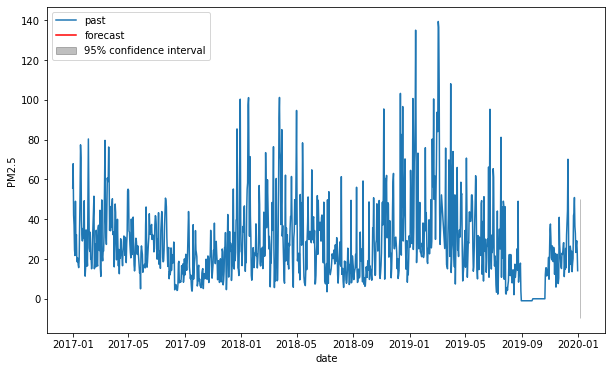

In [706]:
timeseries = df_121['PM2.5']
automodel = arimamodel(df_121['PM2.5'])
plotarima(1, timeseries, automodel)

In [707]:
best_model = sm.tsa.statespace.SARIMAX(df_121['PM2.5'], trend='c', order=[3,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -4498.330
Date:                Wed, 20 Oct 2021   AIC                           9010.661
Time:                        15:00:01   BIC                           9045.586
Sample:                             0   HQIC                          9023.882
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.4198      0.286      1.470      0.142      -0.140       0.979
ar.L1          0.7393      0.109      6.807      0.000       0.526       0.952
ar.L2          0.5020      0.171      2.942      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [708]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[3,0,2])

Train RMSE: 13.047771733180552
Test RMSE: 26.175002476365282
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -2164.581
Date:                Wed, 20 Oct 2021   AIC                           4343.162
Time:                        15:00:01   BIC                           4373.242
Sample:                    01-01-2017   HQIC                          4354.923
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         28.5263      1.857     15.362      0.000      24.887      32.166
ar.L1          0.2984      2.185      0.137      0.891      -

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

# Station 121 PM10

In [709]:
base_model = sm.tsa.statespace.SARIMAX(df_121['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5172.933
Date:                Wed, 20 Oct 2021   AIC                          10349.865
Time:                        15:00:01   BIC                          10359.844
Sample:                             0   HQIC                         10353.643
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     45.0635      1.072     42.053      0.000      42.963      47.164
sigma2       810.3631     27.448     29.524      0.000     756.566     864.160
Ljung-Box (L1) (Q):                 448.98   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9838.038, Time=0.07 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11708.953, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9930.049, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10883.724, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9720.948, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9881.489, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9722.883, Time=0.22 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9722.881, Time=0.21 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9751.562, Time=0.11 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9845.328, Time=0.06 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9724.875, Time=0.34 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=9714.917, Time=0.41 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=9762.651, Time=0.12 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=9766.857, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0] interce

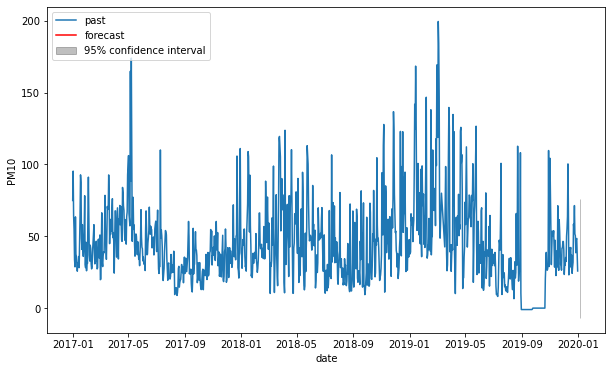

In [710]:
timeseries = df_121['PM10']
automodel = arimamodel(df_121['PM10'])
plotarima(1, timeseries, automodel)

In [711]:
best_model = sm.tsa.statespace.SARIMAX(df_121['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4852.459
Date:                Wed, 20 Oct 2021   AIC                           9714.917
Time:                        15:00:06   BIC                           9739.864
Sample:                             0   HQIC                          9724.361
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.3232      0.186      1.739      0.082      -0.041       0.688
ar.L1          1.4581      0.030     47.830      0.000       1.398       1.518
ar.L2         -0.4653      0.029    -16.248      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [712]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

Train RMSE: 18.05455052190407
Test RMSE: 37.91177038914744
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2341.343
Date:                Wed, 20 Oct 2021   AIC                           4692.686
Time:                        15:00:06   BIC                           4714.172
Sample:                    01-01-2017   HQIC                          4701.087
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         45.7179      2.514     18.183      0.000      40.790      50.646
ar.L1         -0.1224      0.437     -0.280      0.780      -0.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

# Station 121 NO2

In [713]:
base_model = sm.tsa.statespace.SARIMAX(df_121['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                 607.324
Date:                Wed, 20 Oct 2021   AIC                          -1210.649
Time:                        15:00:06   BIC                          -1200.670
Sample:                             0   HQIC                         -1206.871
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0119      0.030      0.402      0.688      -0.046       0.070
sigma2         0.0191      0.001     16.487      0.000       0.017       0.021
Ljung-Box (L1) (Q):                1015.79   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4279.248, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-1204.651, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-4152.944, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-2466.271, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4277.731, Time=0.23 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-4277.654, Time=0.17 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-3187.488, Time=0.11 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4261.360, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-4278.889, Time=0.25 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-4277.519, Time=0.14 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0]          
Total fit time: 1.185 seconds


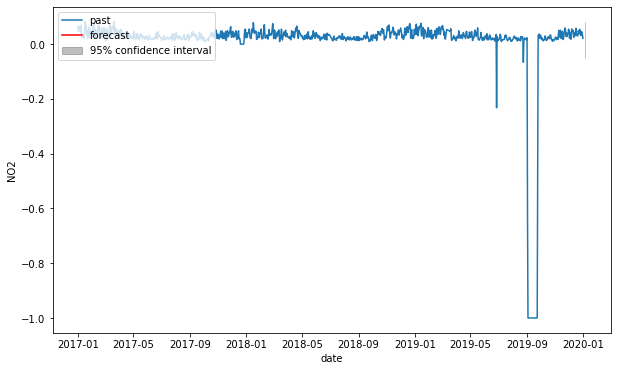

In [714]:
timeseries = df_121['NO2']
automodel = arimamodel(df_121['NO2'])
plotarima(1, timeseries, automodel)

In [715]:
best_model = sm.tsa.statespace.SARIMAX(df_121['NO2'], trend='c', order=[1,0,1])
res = best_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(1, 0, 1)   Log Likelihood                2142.760
Date:                Wed, 20 Oct 2021   AIC                          -4277.519
Time:                        15:00:07   BIC                          -4257.562
Sample:                             0   HQIC                         -4269.964
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0007      0.002      0.314      0.754      -0.004       0.005
ar.L1          0.9452      0.005    185.105      0.000       0.935       0.955
ma.L1          0.3717      0.006     67.284      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


In [716]:
model_train = arima_results(train['NO2'],test['NO2'], order=[1,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.011355327626139514
Test RMSE: 0.1973809976347759
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(1, 0, 1)   Log Likelihood                1662.305
Date:                Wed, 20 Oct 2021   AIC                          -3316.611
Time:                        15:00:08   BIC                          -3299.422
Sample:                    01-01-2017   HQIC                         -3309.890
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0321      0.001     29.053      0.000       0.030       0.034
ar.L1          0.3420      0.057      6.008      0.000     

# Station 122

In [717]:
df_122 = df[df['Station code'] == 122]

In [718]:
df_122.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,122,0.005292,0.041500,0.005000,1.195833,87.250000,51.208333,Good,Normal,Good,Good,Bad,Bad
2017-01-02,122,0.006000,0.036917,0.021458,0.925000,122.958333,68.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,122,0.005667,0.039750,0.018000,0.725000,76.166667,39.166667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,122,0.005417,0.047500,0.011792,0.895833,55.708333,28.041667,Good,Normal,Good,Good,Normal,Normal
2017-01-05,122,0.004917,0.038375,0.013292,0.795833,37.708333,17.625000,Good,Normal,Good,Good,Normal,Normal


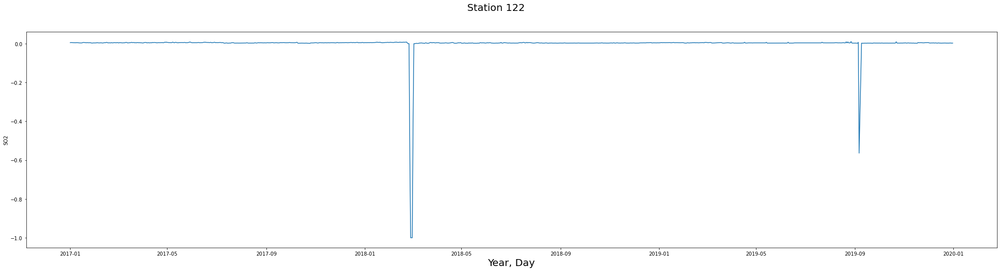

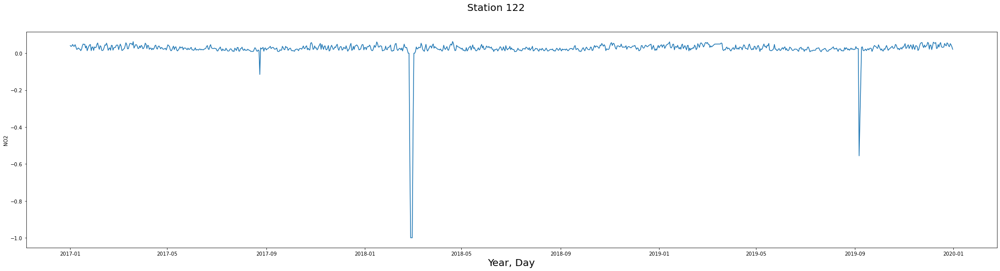

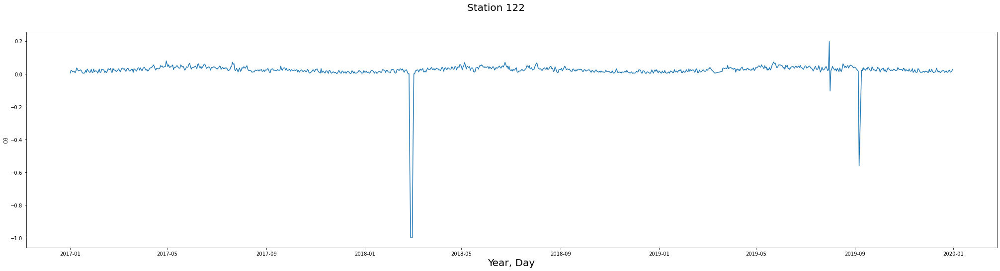

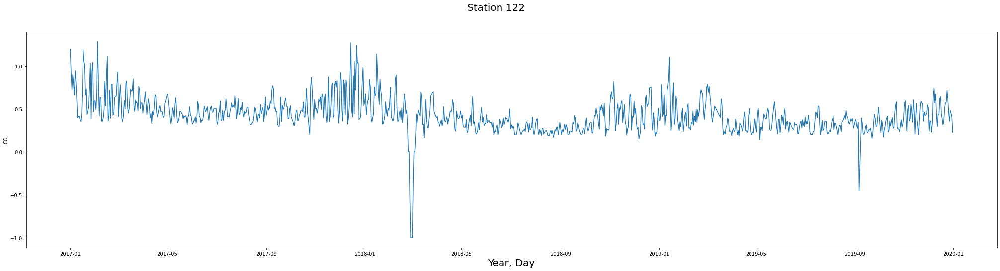

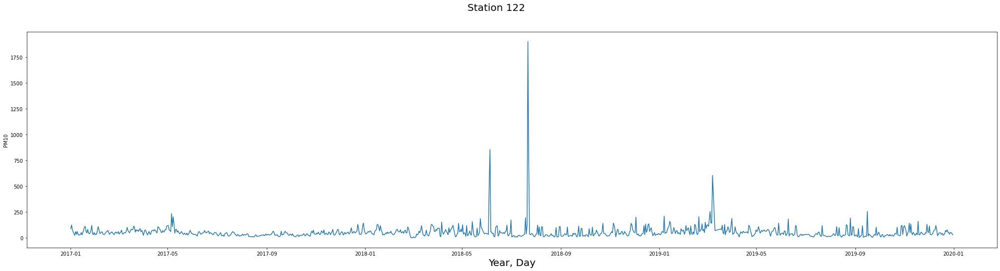

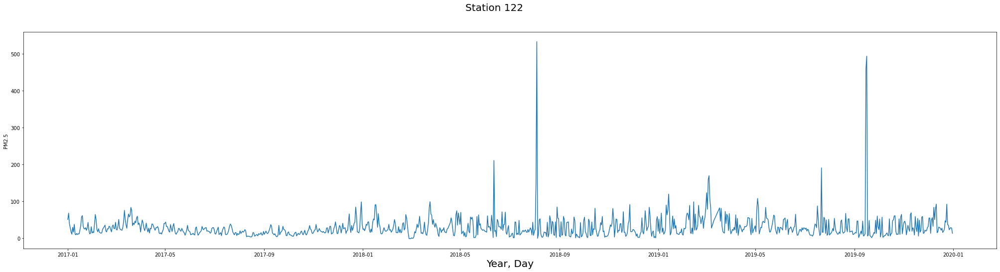

In [719]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 122", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_122)

In [720]:
df_122['NO2 Level'].value_counts()

Good      652
Normal    429
Bad         4
Name: NO2 Level, dtype: int64

In [721]:
df_122['PM10 Level'].value_counts()

Normal      571
Good        349
Bad         141
Very Bad     20
Name: PM10 Level, dtype: int64

In [722]:
df_122['PM2.5 Level'].value_counts()

Normal      476
Good        306
Bad         259
Very Bad     43
Name: PM2.5 Level, dtype: int64

##### For Station 122
- NO2 reaches levels of 'Bad' on 4 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 141 occasions and 'Very Bad' on 20, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 259 occasions and 'Very Bad' on 43 occasions.

# Picking the relevant columns

In [723]:
columns = ['NO2', 'PM10', 'PM2.5']
df_122 = df_122[columns]
df_122

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.041500,87.250000,51.208333
2017-01-02,0.036917,122.958333,68.250000
2017-01-03,0.039750,76.166667,39.166667
2017-01-04,0.047500,55.708333,28.041667
2017-01-05,0.038375,37.708333,17.625000
...,...,...,...
2019-12-27,0.035625,33.291667,23.208333
2019-12-28,0.052083,48.000000,26.833333
2019-12-29,0.045333,50.250000,29.125000


# Train-Test Split

In [724]:
train = df_122[:-542]
test = df_122[542:]

<AxesSubplot:xlabel='Measurement date'>

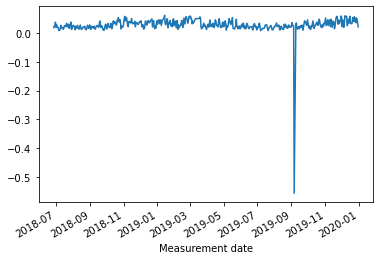

In [725]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

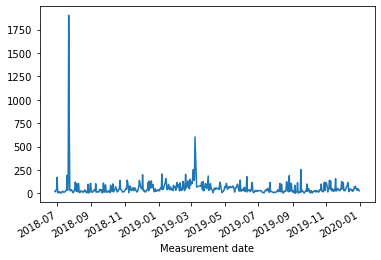

In [726]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

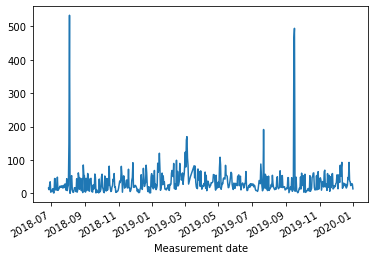

In [727]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

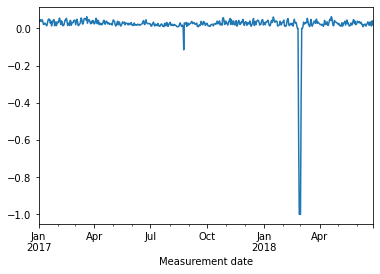

In [728]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

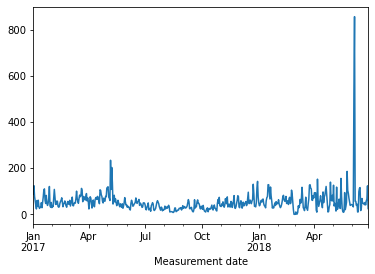

In [729]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

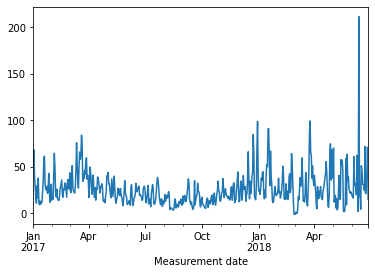

In [730]:
train['PM2.5'].plot()

In [731]:
print(stationarity_check(df_122['PM2.5']))
print(stationarity_check(df_122['PM10']))
print(stationarity_check(df_122['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -1.568992e+01
p-value                        1.438029e-28
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.538833e+01
p-value                        3.335755e-28
#Lags Used                     2.000000e+00
Number of Observations Used    1.082000e+03
Critical Value (1%)           -3.436408e+00
Critical Value (5%)           -2.864215e+00
Critical Value (10%)          -2.568194e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.049582e+01
p-value                        1.116311e-18
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)      

# Rolling Mean Difference Train

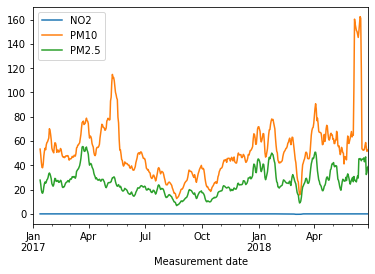

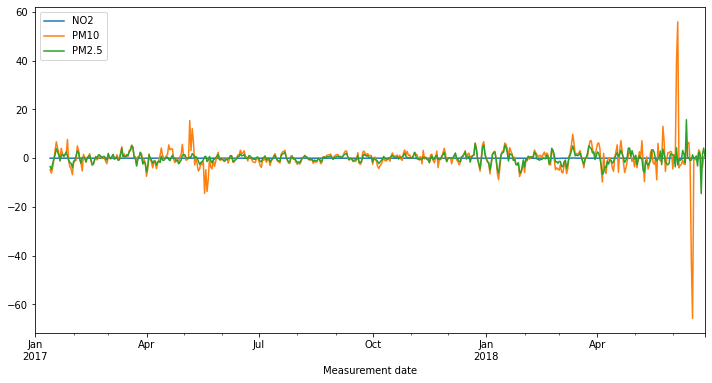

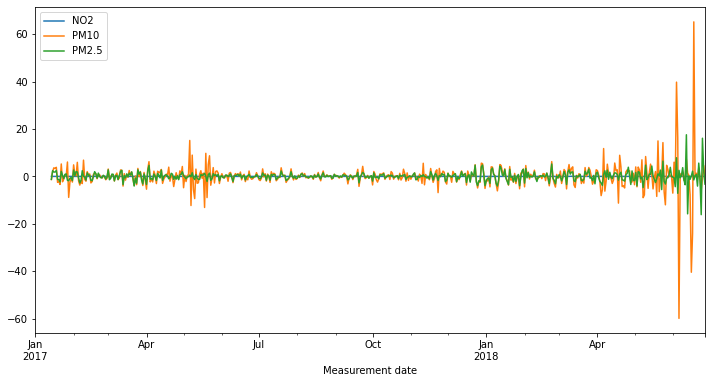

In [732]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [733]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.033681e+00
p-value                        1.398426e-07
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.750322e+00
p-value                        1.006059e-11
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.476858e+00
p-value                        1.324552e-08
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

In [734]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.361606e+00
p-value                        2.813798e-13
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.014881e+01
p-value                        8.052384e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)           -2.867224e+00
Critical Value (10%)          -2.569797e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.105042e+01
p-value                        5.096690e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)      

# Rolling Mean Difference Test

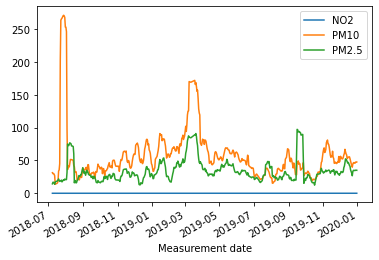

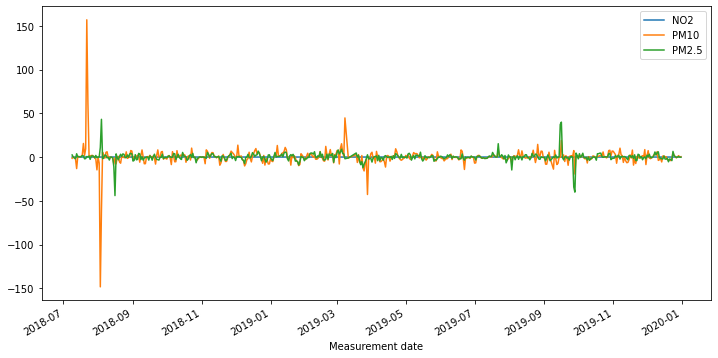

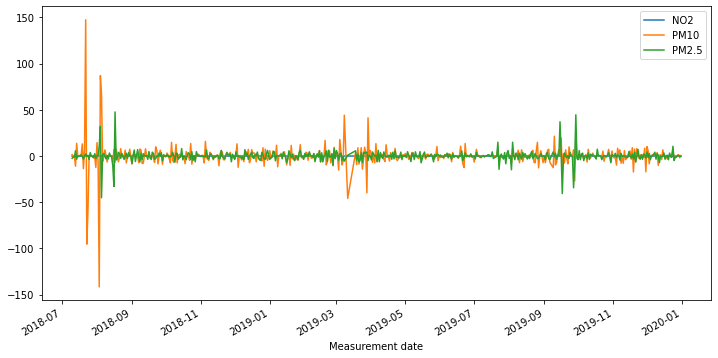

In [735]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [736]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.181694e+00
p-value                        2.242949e-15
#Lags Used                     1.300000e+01
Number of Observations Used    5.170000e+02
Critical Value (1%)           -3.443062e+00
Critical Value (5%)           -2.867147e+00
Critical Value (10%)          -2.569756e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.947612e+00
p-value                        8.900465e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.062412e+01
p-value                        5.420241e-19
#Lags Used                     1.100000e+01
Number of Observations Used    5.190000e+02
Critical Value (1%)           -3.443013e+00
Critical Value (5%)      

In [737]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.056871e+01
p-value                        7.400603e-19
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)           -2.867213e+00
Critical Value (10%)          -2.569791e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.127107e+01
p-value                        1.536446e-20
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.022042e+01
p-value                        5.343065e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 122 PM2.5

In [738]:
base_model = sm.tsa.statespace.SARIMAX(df_122['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5339.669
Date:                Wed, 20 Oct 2021   AIC                          10683.337
Time:                        15:00:11   BIC                          10693.316
Sample:                             0   HQIC                         10687.115
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     29.8886      1.657     18.036      0.000      26.641      33.137
sigma2      1101.9426     10.409    105.864      0.000    1081.541    1122.344
Ljung-Box (L1) (Q):                 149.59   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10660.423, Time=0.11 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11325.509, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=10726.336, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10897.372, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=inf, Time=0.29 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10513.024, Time=0.17 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10830.967, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10514.825, Time=0.29 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=10514.857, Time=0.31 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=10786.141, Time=0.09 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=10515.743, Time=0.36 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=10509.973, Time=0.45 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=10514.527, Time=0.14 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10514.264, Time=0.18 sec
 ARIMA(2,0,2)(0,0,0)[0] i

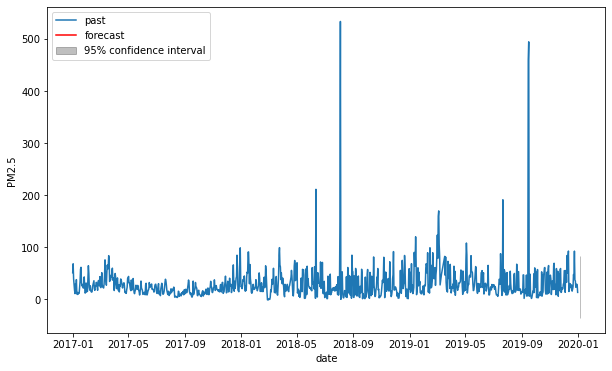

In [739]:
timeseries = df_122['PM2.5']
automodel = arimamodel(df_122['PM2.5'])
plotarima(1, timeseries, automodel)

In [740]:
best_model = sm.tsa.statespace.SARIMAX(df_122['PM2.5'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood               -5249.987
Date:                Wed, 20 Oct 2021   AIC                          10509.973
Time:                        15:00:16   BIC                          10534.920
Sample:                             0   HQIC                         10519.417
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      2.4557      2.386      1.029      0.303      -2.221       7.132
ar.L1          0.9166      0.079     11.554      0.000       0.761       1.072
ma.L1         -0.5095      0.077     -6.595      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [741]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[1,0,2])

Train RMSE: 16.199226053590568
Test RMSE: 44.66839182784352
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood               -2282.566
Date:                Wed, 20 Oct 2021   AIC                           4575.133
Time:                        15:00:16   BIC                           4596.618
Sample:                    01-01-2017   HQIC                          4583.534
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.7676      3.822      7.004      0.000      19.277      34.258
ar.L1          0.9538      0.038     25.128      0.000       0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 122 PM10

In [742]:
base_model = sm.tsa.statespace.SARIMAX(df_122['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -6256.437
Date:                Wed, 20 Oct 2021   AIC                          12516.875
Time:                        15:00:16   BIC                          12526.853
Sample:                             0   HQIC                         12520.652
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     53.9286      4.303     12.534      0.000      45.496      62.362
sigma2      5971.3372     37.039    161.219      0.000    5898.743    6043.932
Ljung-Box (L1) (Q):                 148.01   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=12495.216, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=12945.391, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=12511.389, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=12590.374, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=12507.280, Time=0.17 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=12345.380, Time=0.17 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=12562.264, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=12347.216, Time=0.24 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=12347.249, Time=0.27 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=12530.209, Time=0.11 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=12347.068, Time=0.41 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=12339.163, Time=0.53 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=12342.452, Time=0.18 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=12342.446, Time=0.21 sec
 ARIMA(2,0,2)(0,0,0

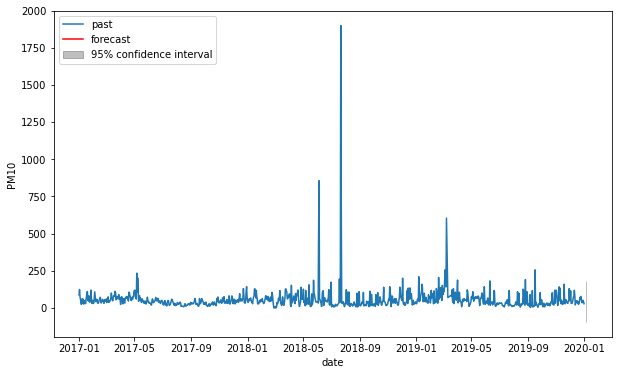

In [743]:
timeseries = df_122['PM10']
automodel = arimamodel(df_122['PM10'])
plotarima(1, timeseries, automodel)

In [744]:
best_model = sm.tsa.statespace.SARIMAX(df_122['PM10'], trend='c', order=[1,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(1, 0, 2)   Log Likelihood               -6164.581
Date:                Wed, 20 Oct 2021   AIC                          12339.163
Time:                        15:00:21   BIC                          12364.110
Sample:                             0   HQIC                         12348.607
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      3.2227      5.598      0.576      0.565      -7.750      14.195
ar.L1          0.9391      0.103      9.085      0.000       0.737       1.142
ma.L1         -0.5113      0.105     -4.866      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [745]:
model_train = arima_results(train['PM10'],test['PM10'], order=[1,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 43.077945145447224
Test RMSE: 100.84266376585359
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(1, 0, 2)   Log Likelihood               -2813.938
Date:                Wed, 20 Oct 2021   AIC                           5637.876
Time:                        15:00:21   BIC                           5659.362
Sample:                    01-01-2017   HQIC                          5646.277
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         53.8106     13.494      3.988      0.000      27.363      80.258
ar.L1          0.9845      0.036     27.393      0.000       

# Station 122 NO2

In [746]:
base_model = sm.tsa.statespace.SARIMAX(df_122['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                1470.143
Date:                Wed, 20 Oct 2021   AIC                          -2936.286
Time:                        15:00:21   BIC                          -2926.308
Sample:                             0   HQIC                         -2932.509
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0239      0.007      3.606      0.000       0.011       0.037
sigma2         0.0039   5.63e-05     69.158      0.000       0.004       0.004
Ljung-Box (L1) (Q):                 658.70   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-3950.054, Time=0.10 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2789.324, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3926.934, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3523.207, Time=0.08 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-3963.260, Time=0.19 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-3956.875, Time=0.08 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-3965.655, Time=0.25 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-3967.362, Time=0.09 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-3966.576, Time=0.05 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-3972.168, Time=0.29 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-3993.952, Time=0.41 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-3994.886, Time=0.05 sec
 ARIMA(5,0,0)(0,0,0)[0] intercept   : AIC=-4018.696, Time=0.35 sec
 ARIMA(4,0,0)(0,0,0)[0] intercept   : AIC=-3999.479, Time=0.17 sec
 ARIMA(5,0,1)(0,0,0

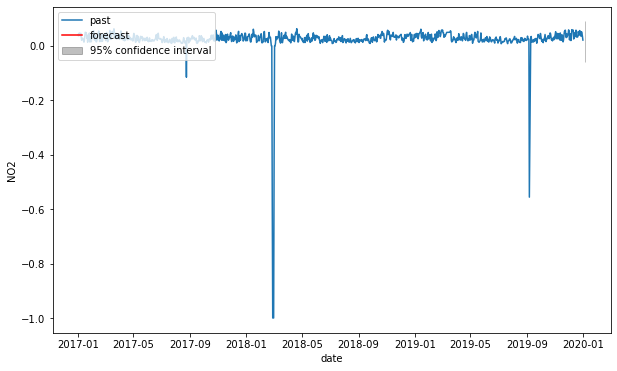

In [747]:
timeseries = df_122['NO2']
automodel = arimamodel(df_122['NO2'])
plotarima(1, timeseries, automodel)

In [748]:
best_model = sm.tsa.statespace.SARIMAX(df_122['NO2'], trend='c', order=[5,0,0])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(5, 0, 0)   Log Likelihood                2016.348
Date:                Wed, 20 Oct 2021   AIC                          -4018.696
Time:                        15:00:25   BIC                          -3983.770
Sample:                             0   HQIC                         -4005.474
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0066      0.002      3.128      0.002       0.002       0.011
ar.L1          0.9002      0.005    172.214      0.000       0.890       0.910
ar.L2         -0.0603      0.012     -4.965      0.0

In [749]:
model_train = arima_results(train['NO2'],test['NO2'], order=[5,0,0])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 0.03607778572750801
Test RMSE: 0.0808967587309717
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(5, 0, 0)   Log Likelihood                1032.388
Date:                Wed, 20 Oct 2021   AIC                          -2050.777
Time:                        15:00:26   BIC                          -2020.697
Sample:                    01-01-2017   HQIC                         -2039.015
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0201      0.020      1.003      0.316      -0.019       0.059
ar.L1          1.3061      0.010    134.139      0.000      

# Station 123

In [750]:
df_123 = df[df['Station code'] == 123]

In [751]:
df_123.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,123,0.004792,0.039750,0.002375,0.775000,79.625000,57.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,123,0.005542,0.036000,0.014625,0.783333,118.416667,79.000000,Good,Normal,Good,Good,Bad,Very Bad
2017-01-03,123,0.005625,0.036750,0.013542,0.641667,83.916667,50.041667,Good,Normal,Good,Good,Bad,Bad
2017-01-04,123,0.005542,0.049667,0.006833,0.712500,57.875000,33.625000,Good,Normal,Good,Good,Normal,Normal
2017-01-05,123,0.004667,0.038417,0.007542,0.512500,39.333333,20.541667,Good,Normal,Good,Good,Normal,Normal


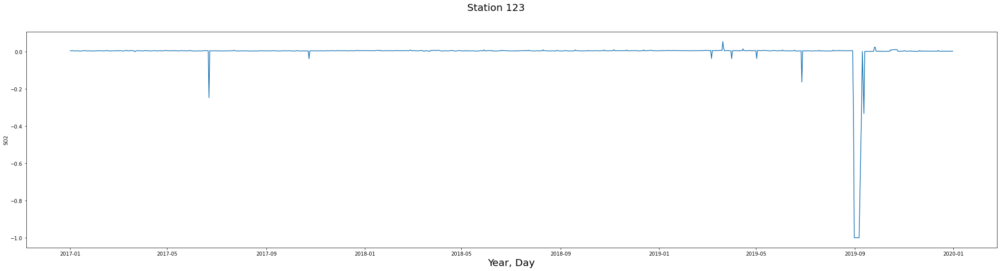

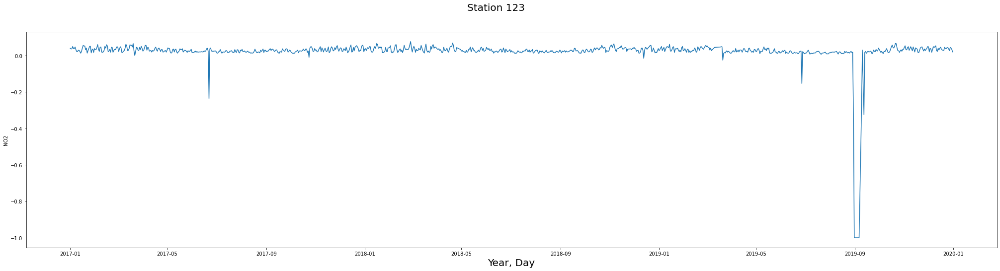

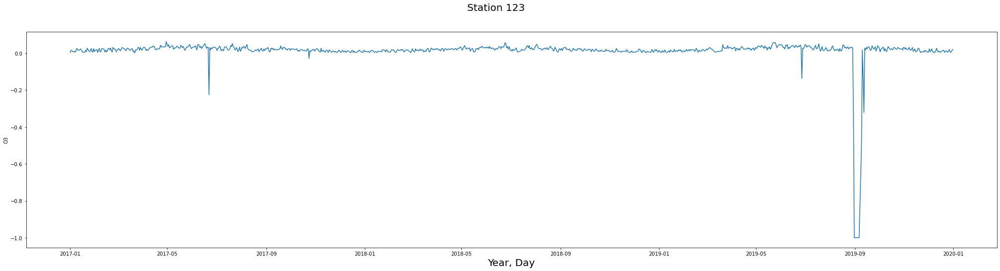

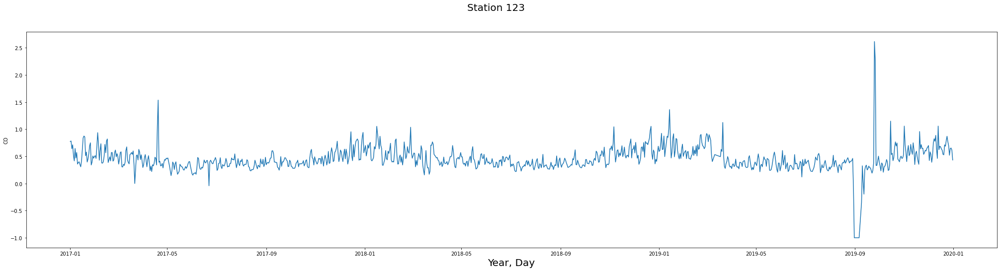

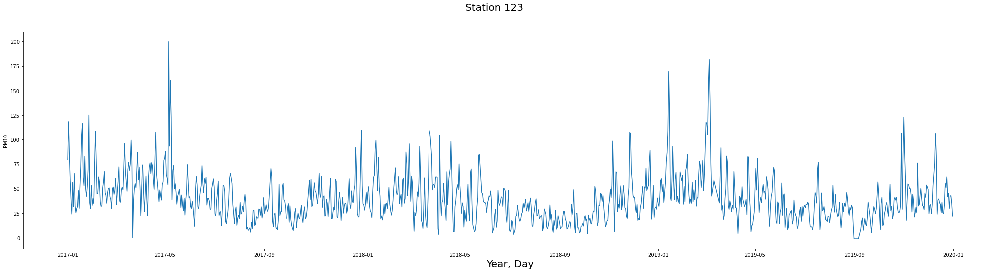

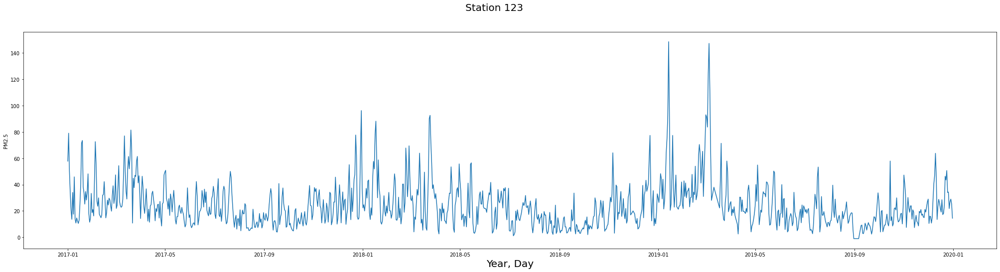

In [752]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 123", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_123)

In [753]:
df_123['NO2 Level'].value_counts()

Good      644
Normal    431
Bad        10
Name: NO2 Level, dtype: int64

In [754]:
df_123['PM10 Level'].value_counts()

Normal      616
Good        408
Bad          56
Very Bad      5
Name: PM10 Level, dtype: int64

In [755]:
df_123['PM2.5 Level'].value_counts()

Normal      529
Good        354
Bad         182
Very Bad     20
Name: PM2.5 Level, dtype: int64

###### For Station 123
- NO2 reaches levels of 'Bad' on 10 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 56 occasions and 'Very Bad' on 5, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 182 occasions and 'Very Bad' on 20 occasions.

# Picking the relevant columns

In [756]:
columns = ['NO2', 'PM10', 'PM2.5']
df_123 = df_123[columns]
df_123

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.039750,79.625000,57.791667
2017-01-02,0.036000,118.416667,79.000000
2017-01-03,0.036750,83.916667,50.041667
2017-01-04,0.049667,57.875000,33.625000
2017-01-05,0.038417,39.333333,20.541667
...,...,...,...
2019-12-27,0.026583,29.791667,21.833333
2019-12-28,0.044375,42.125000,27.083333
2019-12-29,0.040792,42.916667,29.000000


# Train-Test Split

In [757]:
train = df_123[:-542]
test = df_123[542:]

<AxesSubplot:xlabel='Measurement date'>

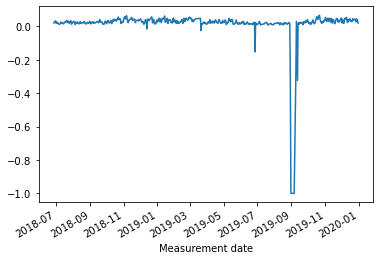

In [758]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

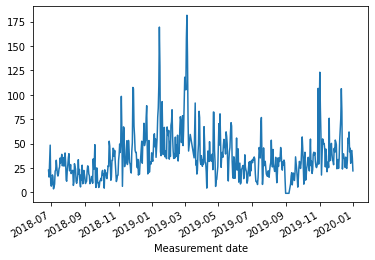

In [759]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

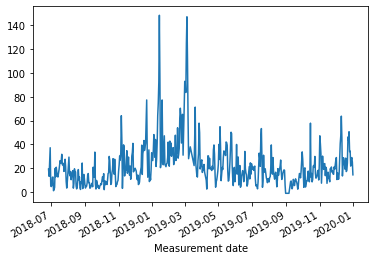

In [760]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

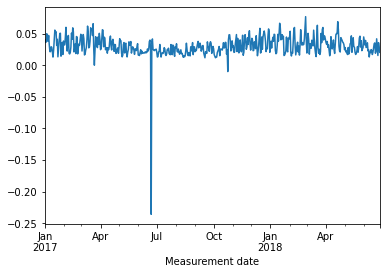

In [761]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

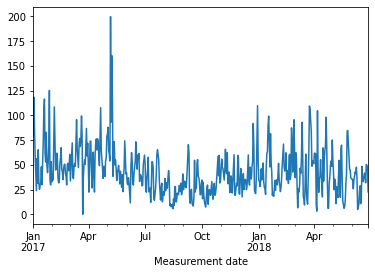

In [762]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

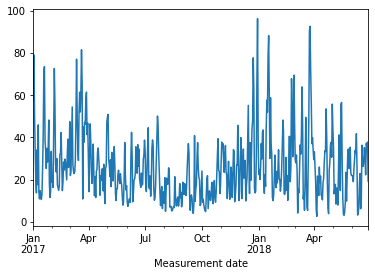

In [763]:
train['PM2.5'].plot()

In [764]:
print(stationarity_check(df_123['PM2.5']))
print(stationarity_check(df_123['PM10']))
print(stationarity_check(df_123['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -7.262578e+00
p-value                        1.666637e-10
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.887779e+00
p-value                        1.380360e-09
#Lags Used                     7.000000e+00
Number of Observations Used    1.077000e+03
Critical Value (1%)           -3.436436e+00
Critical Value (5%)           -2.864227e+00
Critical Value (10%)          -2.568201e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.213887e+00
p-value                        5.424510e-08
#Lags Used                     1.700000e+01
Number of Observations Used    1.067000e+03
Critical Value (1%)           -3.436493e+00
Critical Value (5%)      

# Rolling Mean Difference Train

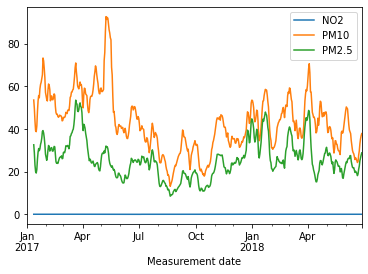

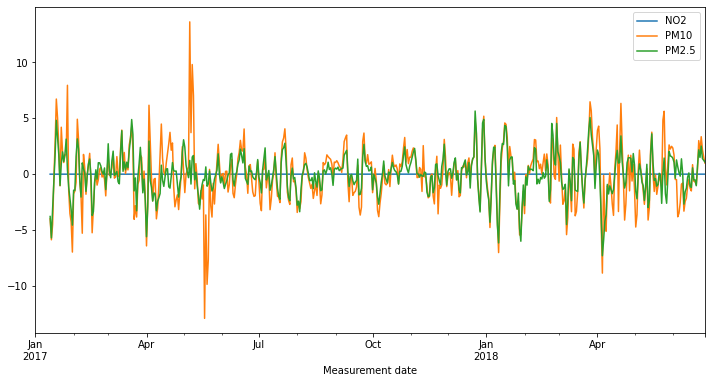

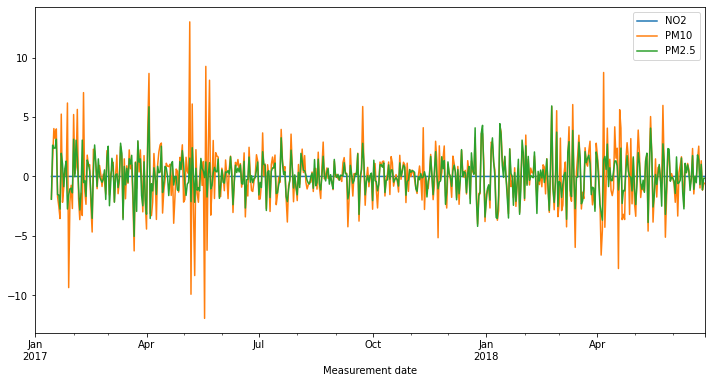

In [765]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [766]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.635546e+00
p-value                        1.956877e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.751365e+00
p-value                        2.830743e-14
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.204438e+01
p-value                        2.686031e-22
#Lags Used                     1.100000e+01
Number of Observations Used    5.190000e+02
Critical Value (1%)           -3.443013e+00
Critical Value (5%)      

In [767]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.074078e+01
p-value                        2.821889e-19
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.131361e+01
p-value                        1.221858e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.079734e+01
p-value                        2.059412e-19
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Rolling Mean Difference Test

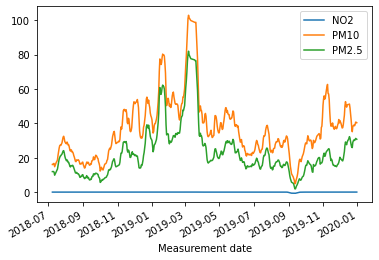

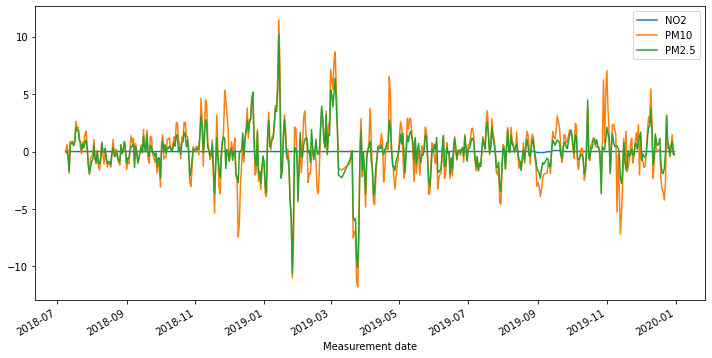

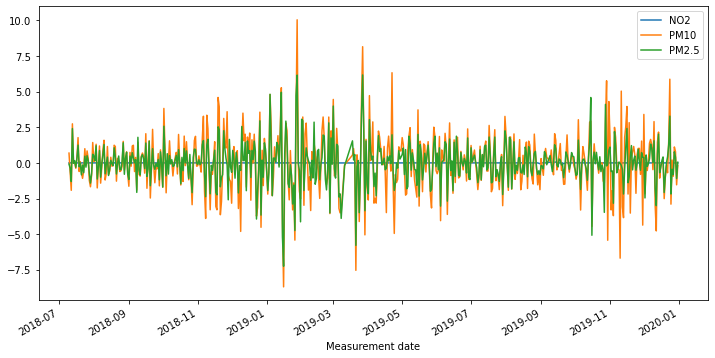

In [768]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [769]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.045517e+00
p-value                        1.314759e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.850789e+00
p-value                        5.608556e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.128911e+00
p-value                        3.559899e-10
#Lags Used                     1.900000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

In [770]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.712457e+00
p-value                        1.003123e-16
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.134104e+01
p-value                        1.054428e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.344677e+00
p-value                        3.108446e-13
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 123 PM2.5

In [771]:
base_model = sm.tsa.statespace.SARIMAX(df_123['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4627.450
Date:                Wed, 20 Oct 2021   AIC                           9258.900
Time:                        15:00:29   BIC                           9268.879
Sample:                             0   HQIC                          9262.678
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.0953      0.699     34.467      0.000      22.725      25.465
sigma2       296.4815      7.698     38.515      0.000     281.394     311.569
Ljung-Box (L1) (Q):                 558.05   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8589.397, Time=0.05 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10433.686, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8587.849, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9470.811, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8589.648, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8577.883, Time=0.11 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8427.119, Time=0.20 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8518.412, Time=0.08 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8420.268, Time=0.30 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8501.163, Time=0.08 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8422.174, Time=0.42 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.54 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8422.212, Time=0.30 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8493.147, Time=0.10 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

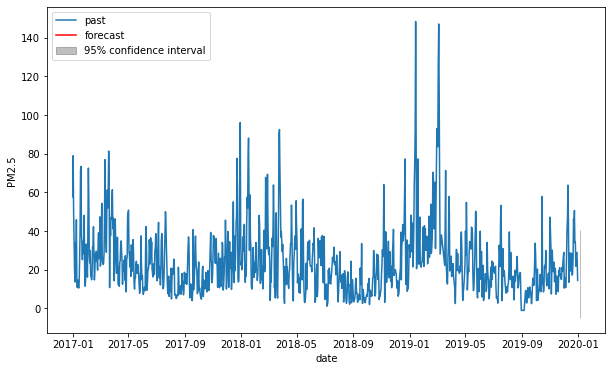

In [772]:
timeseries = df_123['PM2.5']
automodel = arimamodel(df_123['PM2.5'])
plotarima(1, timeseries, automodel)

In [773]:
best_model = sm.tsa.statespace.SARIMAX(df_123['PM2.5'], trend='c', order=[4,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(4, 0, 1)   Log Likelihood               -4199.775
Date:                Wed, 20 Oct 2021   AIC                           8413.550
Time:                        15:00:37   BIC                           8448.475
Sample:                             0   HQIC                          8426.771
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2582      0.183      1.411      0.158      -0.100       0.617
ar.L1          1.7102      0.043     39.584      0.000       1.625       1.795
ar.L2         -0.9763      0.057    -17.171      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [774]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[4,0,1])

Train RMSE: 11.80396083617645
Test RMSE: 22.5640626369146
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(4, 0, 1)   Log Likelihood               -2109.347
Date:                Wed, 20 Oct 2021   AIC                           4232.693
Time:                        15:00:37   BIC                           4262.773
Sample:                    01-01-2017   HQIC                          4244.454
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.9960      1.631     15.938      0.000      22.799      29.193
ar.L1          0.4071      8.146      0.050      0.960     -15.5

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


# Station 123 PM10

In [775]:
base_model = sm.tsa.statespace.SARIMAX(df_123['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4985.547
Date:                Wed, 20 Oct 2021   AIC                           9975.094
Time:                        15:00:37   BIC                           9985.073
Sample:                             0   HQIC                          9978.872
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     39.6613      0.914     43.385      0.000      37.870      41.453
sigma2       573.6799     16.293     35.211      0.000     541.747     605.613
Ljung-Box (L1) (Q):                 490.81   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9446.456, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11404.876, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9468.609, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10455.979, Time=0.04 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9468.834, Time=0.13 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9317.967, Time=0.14 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10101.031, Time=0.08 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9285.815, Time=0.21 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9284.231, Time=0.15 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9288.549, Time=0.25 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9285.641, Time=0.45 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=9288.711, Time=0.47 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=9285.534, Time=0.38 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9286.607, Time=0.35 sec
 ARIMA(4,0,3)(0,0,0)[0]       

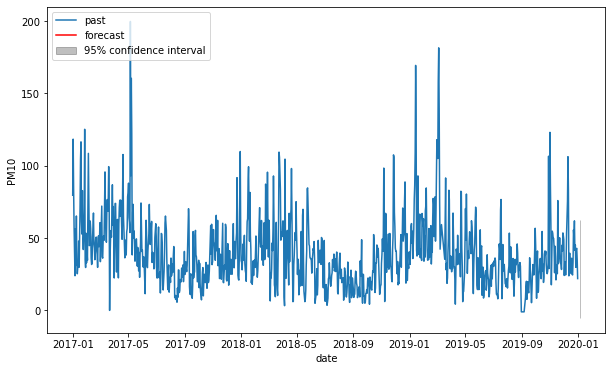

In [776]:
timeseries = df_123['PM10']
automodel = arimamodel(df_123['PM10'])
plotarima(1, timeseries, automodel)

In [777]:
best_model = sm.tsa.statespace.SARIMAX(df_123['PM10'], trend='c', order=[3,0,2])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -4635.269
Date:                Wed, 20 Oct 2021   AIC                           9284.539
Time:                        15:00:42   BIC                           9319.464
Sample:                             0   HQIC                          9297.760
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      1.1062      0.639      1.731      0.084      -0.147       2.359
ar.L1          0.7697      0.102      7.578      0.000       0.571       0.969
ar.L2          0.5213      0.154      3.385      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [778]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 18.430530674314166
Test RMSE: 31.18928637926842
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood               -2352.121
Date:                Wed, 20 Oct 2021   AIC                           4718.242
Time:                        15:00:42   BIC                           4748.321
Sample:                    01-01-2017   HQIC                          4730.003
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         43.6514      6.614      6.600      0.000      30.688      56.614
ar.L1          0.7923      0.180      4.398      0.000       0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 123 NO2

In [779]:
bbase_model = sm.tsa.statespace.SARIMAX(df_123['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4985.547
Date:                Wed, 20 Oct 2021   AIC                           9975.094
Time:                        15:00:42   BIC                           9985.073
Sample:                             0   HQIC                          9978.872
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     39.6613      0.914     43.385      0.000      37.870      41.453
sigma2       573.6799     16.293     35.211      0.000     541.747     605.613
Ljung-Box (L1) (Q):                 490.81   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-4043.501, Time=0.09 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-2183.775, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-3978.412, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-3162.827, Time=0.10 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-4044.499, Time=0.29 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-4025.175, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-4049.121, Time=0.32 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-4046.284, Time=0.09 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-4081.158, Time=0.42 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-4060.569, Time=0.05 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=-4097.044, Time=0.44 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=-4091.169, Time=0.27 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=-4107.042, Time=0.57 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-4082.207, Time=0.54 sec
 ARIMA(5,0,3)(0,0,0

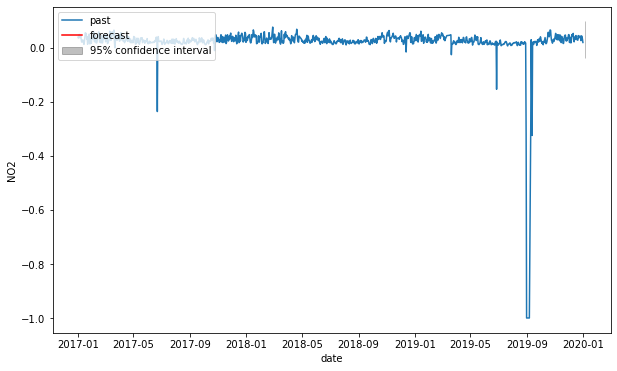

In [780]:
timeseries = df_123['NO2']
automodel = arimamodel(df_123['NO2'])
plotarima(1, timeseries, automodel)

In [781]:
best_model = sm.tsa.statespace.SARIMAX(df_123['NO2'], trend='c', order=[4,0,4])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(4, 0, 4)   Log Likelihood                2113.664
Date:                Wed, 20 Oct 2021   AIC                          -4207.328
Time:                        15:01:02   BIC                          -4157.434
Sample:                             0   HQIC                         -4188.440
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0046      0.004      1.317      0.188      -0.002       0.012
ar.L1          1.0031      0.058     17.226      0.000       0.889       1.117
ar.L2         -0.0803      0.111     -0.723      0.4

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [782]:
model_train = arima_results(train['NO2'],test['NO2'], order=[4,0,4])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.015759931704776825
Test RMSE: 0.12177333865085509
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(4, 0, 4)   Log Likelihood                1482.953
Date:                Wed, 20 Oct 2021   AIC                          -2945.906
Time:                        15:01:02   BIC                          -2902.935
Sample:                    01-01-2017   HQIC                         -2929.104
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0306      0.003      9.604      0.000       0.024       0.037
ar.L1         -0.0755      0.307     -0.246      0.806    

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 124

In [783]:
df_124 = df[df['Station code'] == 124]

In [784]:
df_124.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,124,0.005333,0.039500,0.003750,1.162500,63.958333,48.791667,Good,Normal,Good,Good,Normal,Bad
2017-01-02,124,0.005167,0.036375,0.018458,1.016667,92.416667,64.250000,Good,Normal,Good,Good,Bad,Bad
2017-01-03,124,0.006083,0.038333,0.016583,0.866667,76.166667,47.041667,Good,Normal,Good,Good,Normal,Bad
2017-01-04,124,0.006000,0.046958,0.008000,1.095833,54.583333,33.333333,Good,Normal,Good,Good,Normal,Normal
2017-01-05,124,0.005625,0.032417,0.013542,0.783333,31.083333,19.375000,Good,Normal,Good,Good,Normal,Normal


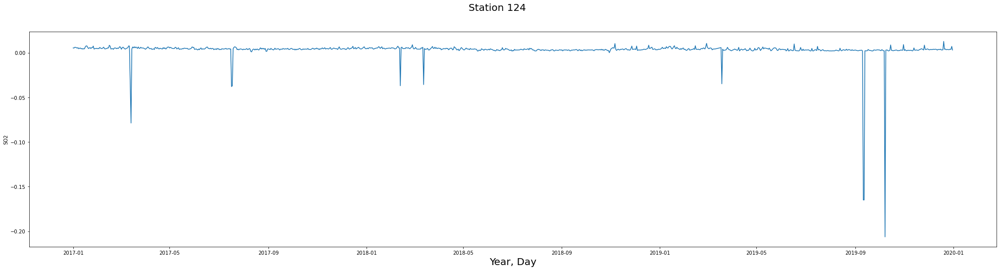

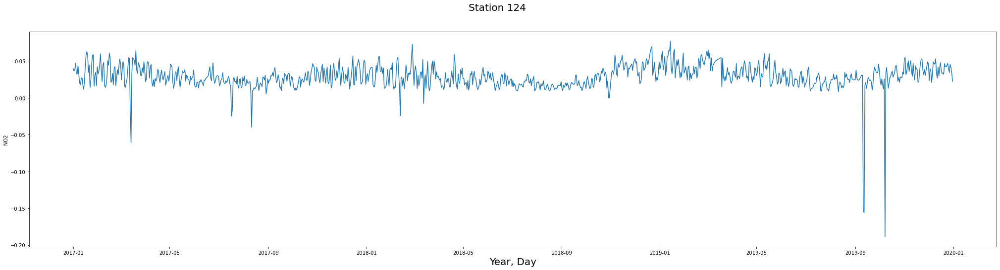

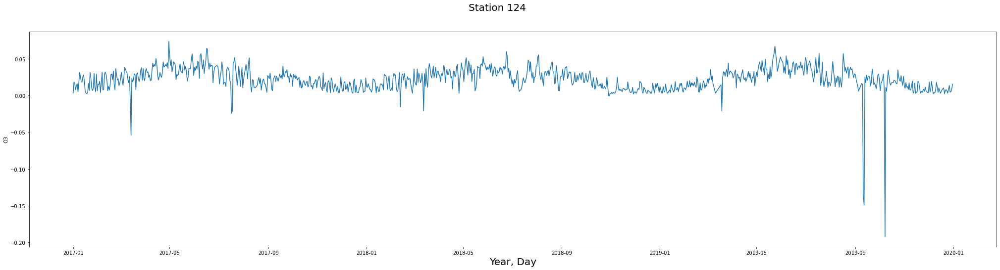

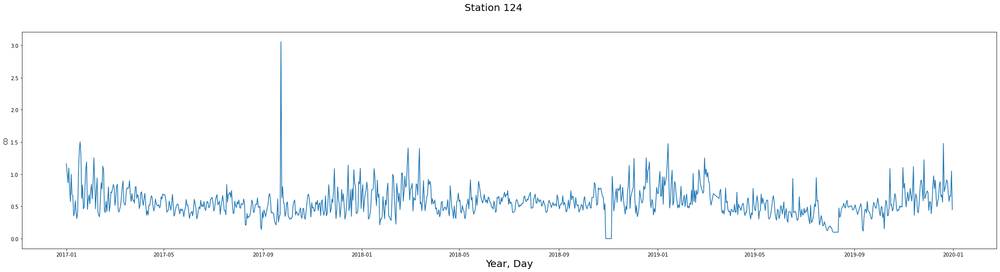

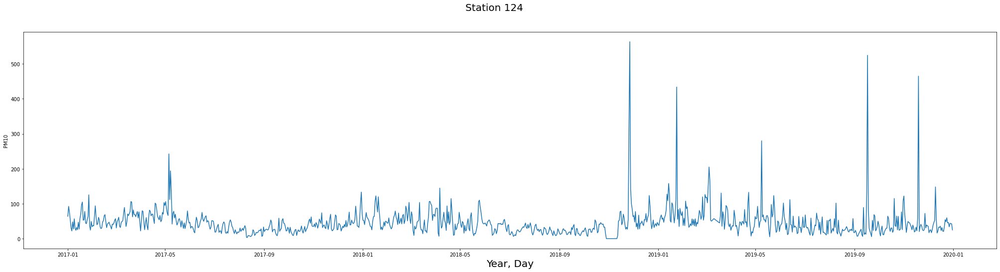

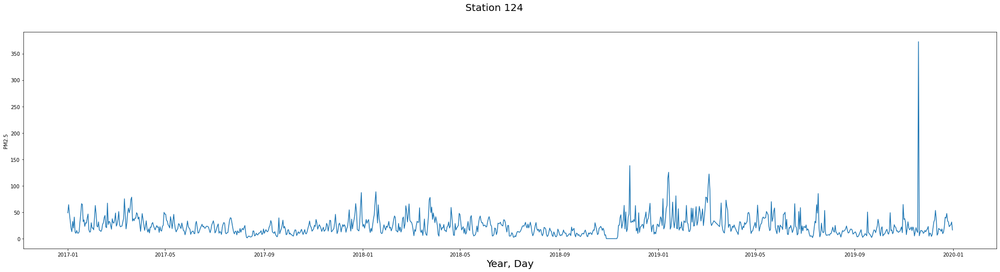

In [785]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 124", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_124)

In [786]:
df_124['NO2 Level'].value_counts()

Good      609
Normal    458
Bad        18
Name: NO2 Level, dtype: int64

In [787]:
df_124['PM2.5 Level'].value_counts()

Normal      518
Good        372
Bad         177
Very Bad     18
Name: PM2.5 Level, dtype: int64

In [788]:
df_124['PM10 Level'].value_counts()

Normal      608
Good        376
Bad          89
Very Bad     12
Name: PM10 Level, dtype: int64

###### For Station 124
- NO2 reaches levels of 'Bad' on 18 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 89 occasions and 'Very Bad' on 12, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 177 occasions and 'Very Bad' on 18 occasions.

# Picking the relevant columns

In [789]:
columns = ['NO2', 'PM10', 'PM2.5']
df_124 = df_124[columns]
df_124

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.039500,63.958333,48.791667
2017-01-02,0.036375,92.416667,64.250000
2017-01-03,0.038333,76.166667,47.041667
2017-01-04,0.046958,54.583333,33.333333
2017-01-05,0.032417,31.083333,19.375000
...,...,...,...
2019-12-27,0.034292,33.875000,22.750000
2019-12-28,0.045583,43.916667,24.666667
2019-12-29,0.041250,43.041667,26.458333


# Train-Test Split

In [790]:
train = df_124[:-542]
test = df_124[542:]

<AxesSubplot:xlabel='Measurement date'>

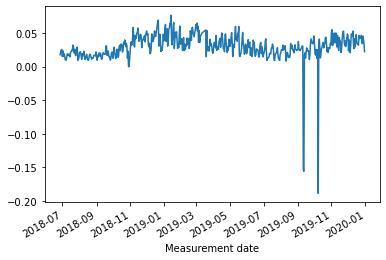

In [791]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

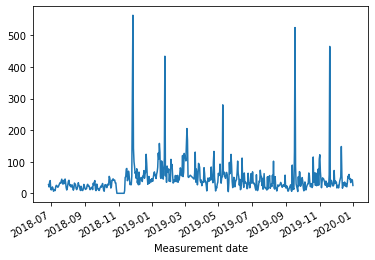

In [792]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

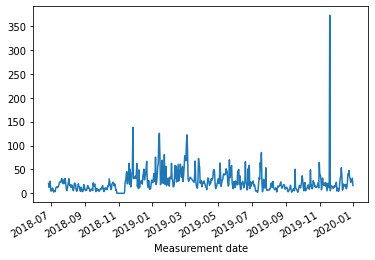

In [793]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

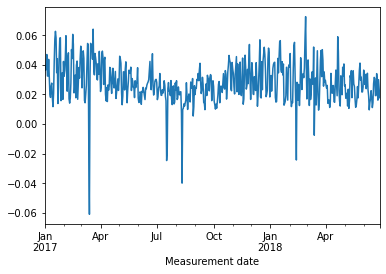

In [794]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

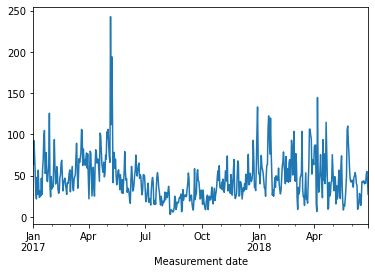

In [795]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

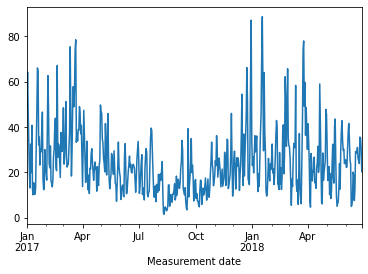

In [796]:
train['PM2.5'].plot()

In [797]:
print(stationarity_check(df_124['PM2.5']))
print(stationarity_check(df_124['PM10']))
print(stationarity_check(df_124['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                -8.147637e+00
p-value                        9.890051e-13
#Lags Used                     6.000000e+00
Number of Observations Used    1.078000e+03
Critical Value (1%)           -3.436431e+00
Critical Value (5%)           -2.864225e+00
Critical Value (10%)          -2.568200e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -6.524006e+00
p-value                        1.025360e-08
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)           -2.864235e+00
Critical Value (10%)          -2.568205e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -5.912500e+00
p-value                        2.618769e-07
#Lags Used                     1.000000e+01
Number of Observations Used    1.074000e+03
Critical Value (1%)           -3.436453e+00
Critical Value (5%)      

# Rolling Mean Difference Train

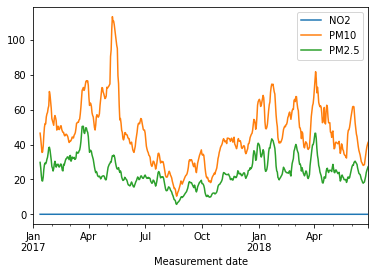

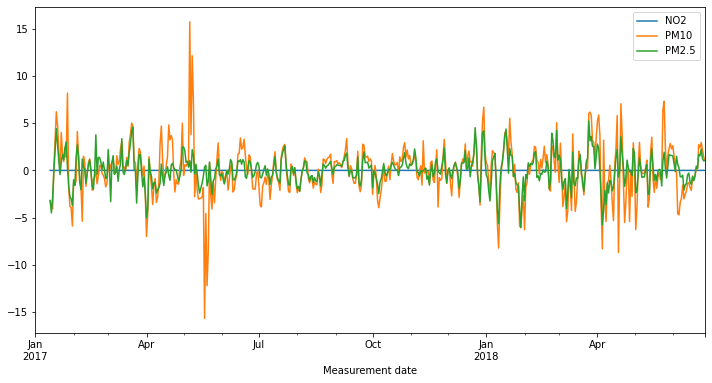

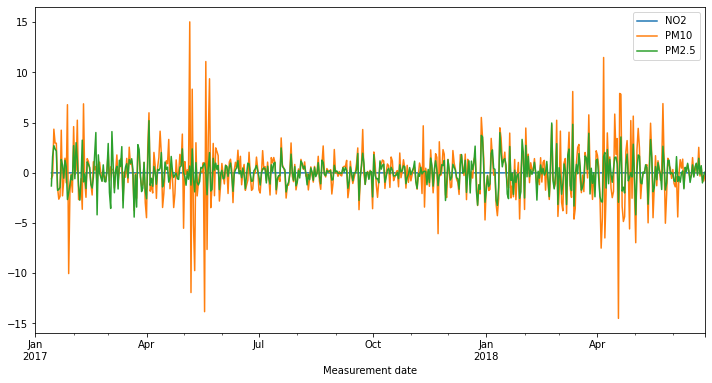

In [798]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [799]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.832392e+00
p-value                        1.879249e-09
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.072531e+00
p-value                        1.535859e-12
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.253852e+00
p-value                        1.467574e-15
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [800]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.063002e+01
p-value                        5.243586e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.094621e+01
p-value                        9.033514e-20
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.041904e+01
p-value                        1.723832e-18
#Lags Used                     1.800000e+01
Number of Observations Used    5.110000e+02
Critical Value (1%)           -3.443212e+00
Critical Value (5%)      

# Rolling Mean Difference Test

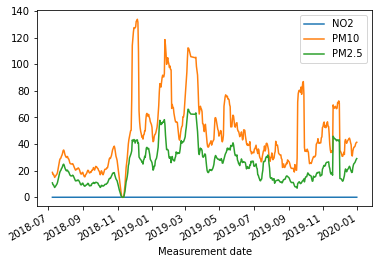

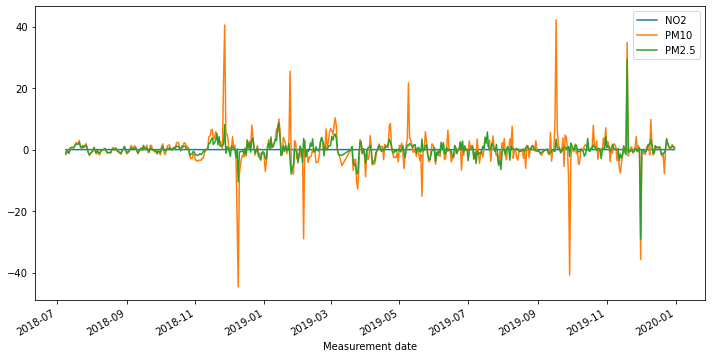

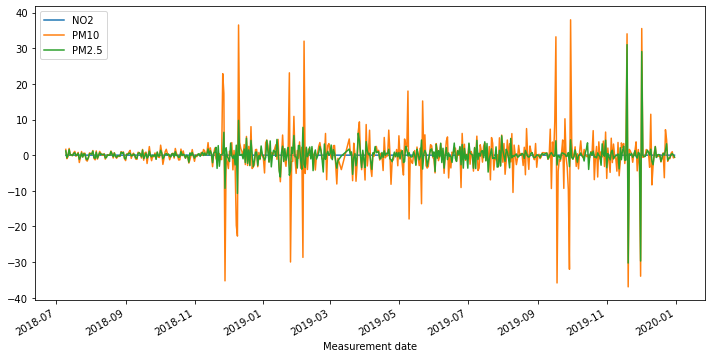

In [801]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [802]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -8.659174e+00
p-value                        4.875127e-14
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.399690e+00
p-value                        2.248853e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.602120e+00
p-value                        2.374104e-11
#Lags Used                     1.500000e+01
Number of Observations Used    5.150000e+02
Critical Value (1%)           -3.443112e+00
Critical Value (5%)      

In [803]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.099702e+01
p-value                        6.830639e-20
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.898418e+00
p-value                        3.408703e-17
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)           -2.867202e+00
Critical Value (10%)          -2.569785e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.032245e+01
p-value                        2.984491e-18
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 124 PM2.5

In [804]:
base_model = sm.tsa.statespace.SARIMAX(df_124['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4781.203
Date:                Wed, 20 Oct 2021   AIC                           9566.405
Time:                        15:01:06   BIC                           9576.384
Sample:                             0   HQIC                          9570.183
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.0174      0.783     30.655      0.000      22.482      25.553
sigma2       393.6253      3.254    120.980      0.000     387.248     400.002
Ljung-Box (L1) (Q):                 193.93   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9382.332, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10543.479, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9588.884, Time=0.03 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10044.370, Time=0.06 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9313.753, Time=0.18 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=9493.965, Time=0.05 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9313.669, Time=0.22 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=9456.172, Time=0.04 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9315.669, Time=0.27 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9317.079, Time=0.24 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9313.684, Time=0.19 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=9425.986, Time=0.05 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9316.388, Time=0.24 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=9307.207, Time=0.52 sec
 ARIMA(2,0,1)(0,0,0)[0] interce

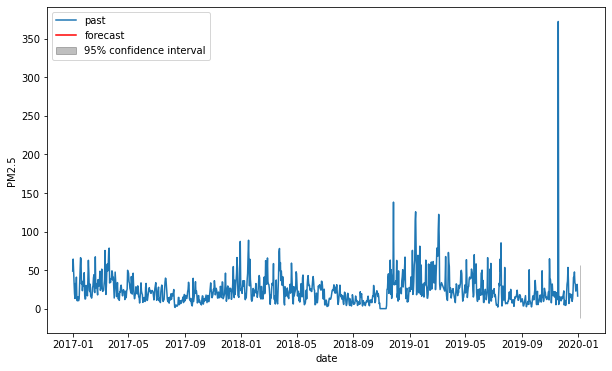

In [805]:
timeseries = df_124['PM2.5']
automodel = arimamodel(df_124['PM2.5'])
plotarima(1, timeseries, automodel)

In [806]:
best_model = sm.tsa.statespace.SARIMAX(df_124['PM2.5'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -4648.467
Date:                Wed, 20 Oct 2021   AIC                           9306.935
Time:                        15:01:11   BIC                           9331.881
Sample:                             0   HQIC                          9316.379
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2854      0.220      1.295      0.195      -0.146       0.717
ar.L1          1.2776      0.025     51.053      0.000       1.229       1.327
ar.L2         -0.2892      0.019    -15.631      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [807]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.919390452955142
Test RMSE: 26.757116913003543
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2067.790
Date:                Wed, 20 Oct 2021   AIC                           4145.580
Time:                        15:01:11   BIC                           4167.066
Sample:                    01-01-2017   HQIC                          4153.981
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.7240      1.699     14.554      0.000      21.394      28.054
ar.L1         -0.3430      1.305     -0.263      0.793      -

# Station 124 NO2

In [808]:
base_model = sm.tsa.statespace.SARIMAX(df_124['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2886.092
Date:                Wed, 20 Oct 2021   AIC                          -5768.183
Time:                        15:01:11   BIC                          -5758.205
Sample:                             0   HQIC                         -5764.406
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0290      0.001     45.251      0.000       0.028       0.030
sigma2         0.0003      3e-06     95.505      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 265.08   Jarque-

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-5981.255, Time=0.29 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4285.407, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-5824.868, Time=0.05 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5086.783, Time=0.12 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6112.605, Time=0.42 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=-5856.802, Time=0.06 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=-6121.068, Time=0.37 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=-5961.127, Time=0.21 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=-5986.200, Time=0.44 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=-6101.992, Time=0.65 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6004.894, Time=0.46 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=-5992.885, Time=0.13 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=-5941.623, Time=0.57 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-6086.501, Time=0.52 sec

Best model:  ARIMA

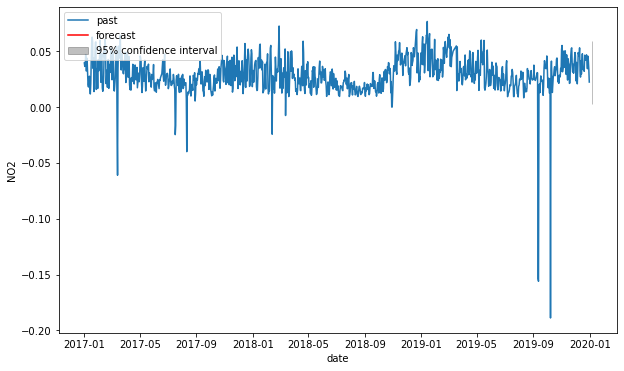

In [809]:
timeseries = df_124['NO2']
automodel = arimamodel(df_124['NO2'])
plotarima(1, timeseries, automodel)

In [810]:
best_model = sm.tsa.statespace.SARIMAX(df_124['NO2'], trend='c', order=[3,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 1)   Log Likelihood                3049.250
Date:                Wed, 20 Oct 2021   AIC                          -6086.501
Time:                        15:01:16   BIC                          -6056.565
Sample:                             0   HQIC                         -6075.168
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0161      0.004      4.155      0.000       0.008       0.024
ar.L1          0.3125      0.225      1.386      0.166      -0.129       0.754
ar.L2          0.0067      0.116      0.057      0.9

In [811]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,2])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.01153792253231054
Test RMSE: 0.021497898190183353
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 2)   Log Likelihood                1652.389
Date:                Wed, 20 Oct 2021   AIC                          -3290.778
Time:                        15:01:17   BIC                          -3260.698
Sample:                    01-01-2017   HQIC                         -3279.017
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0283      0.001     30.337      0.000       0.026       0.030
ar.L1          0.2754      1.434      0.192      0.848    

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 124 PM10

In [812]:
base_model = sm.tsa.statespace.SARIMAX(df_124['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5561.971
Date:                Wed, 20 Oct 2021   AIC                          11127.942
Time:                        15:01:17   BIC                          11137.921
Sample:                             0   HQIC                         11131.719
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     45.8963      1.938     23.678      0.000      42.097      49.695
sigma2      1660.0515     19.835     83.692      0.000    1621.175    1698.928
Ljung-Box (L1) (Q):                 216.81   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=10970.951, Time=0.08 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=12014.887, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=11098.296, Time=0.01 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=11496.046, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=10868.576, Time=0.25 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=11052.201, Time=0.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=10870.118, Time=0.25 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=10870.124, Time=0.15 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=10878.658, Time=0.14 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=11013.659, Time=0.04 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=inf, Time=0.40 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=10861.547, Time=0.47 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=10888.543, Time=0.17 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=10889.257, Time=0.04 sec
 ARIMA(3,0,1)(0,0,0)[0] i

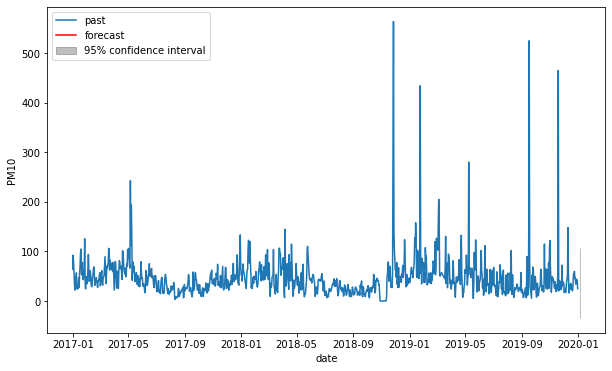

In [813]:
timeseries = df_124['PM10']
automodel = arimamodel(df_124['PM10'])
plotarima(1, timeseries, automodel)

In [814]:
best_model = sm.tsa.statespace.SARIMAX(df_124['PM10'], trend='c', order=[2,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(2, 0, 1)   Log Likelihood               -5425.773
Date:                Wed, 20 Oct 2021   AIC                          10861.547
Time:                        15:01:22   BIC                          10886.493
Sample:                             0   HQIC                         10870.991
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.5224      0.466      1.120      0.263      -0.392       1.436
ar.L1          1.3381      0.033     41.045      0.000       1.274       1.402
ar.L2         -0.3494      0.024    -14.291      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [815]:
model_train = arima_results(train['PM10'],test['PM10'], order=[2,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 20.12644290771008
Test RMSE: 57.2797774690385
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(2, 0, 1)   Log Likelihood               -2400.683
Date:                Wed, 20 Oct 2021   AIC                           4811.366
Time:                        15:01:22   BIC                           4832.852
Sample:                    01-01-2017   HQIC                          4819.767
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         46.6357      7.523      6.199      0.000      31.891      61.381
ar.L1          1.4569      0.052     28.232      0.000       1.3

# Station 125

In [816]:
df_125 = df[df['Station code'] == 125]

In [817]:
df_125.head()

,Station code,SO2,NO2,O3,CO,PM10,PM2.5,SO2 Level,NO2 Level,CO Level,O3 Level,PM10 Level,PM2.5 Level
Measurement date,,,,,,,,,,,,,
2017-01-01,125,0.003833,0.039042,0.003375,0.825000,79.583333,54.208333,Good,Normal,Good,Good,Normal,Bad
2017-01-02,125,-0.037167,-0.003250,-0.028083,0.845833,115.583333,80.083333,Good,Good,Good,Good,Bad,Very Bad
2017-01-03,125,0.004917,0.045333,0.011458,0.891667,105.958333,68.708333,Good,Normal,Good,Good,Bad,Bad
2017-01-04,125,0.005000,0.055000,0.005208,0.958333,66.083333,39.666667,Good,Normal,Good,Good,Normal,Bad
2017-01-05,125,0.004042,0.031708,0.013750,0.587500,35.541667,21.500000,Good,Normal,Good,Good,Normal,Normal


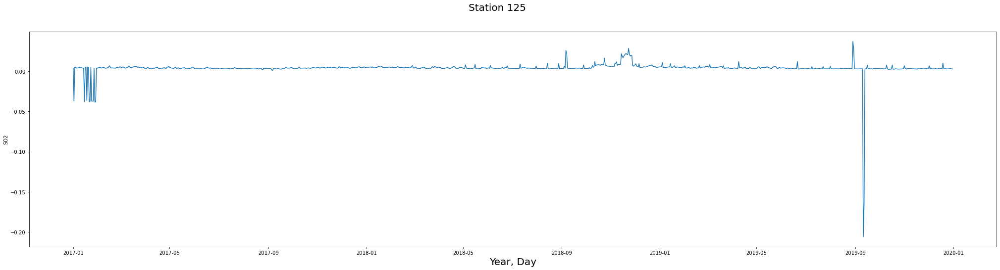

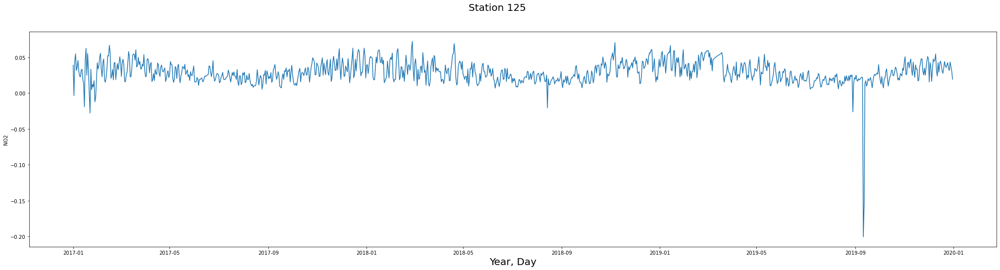

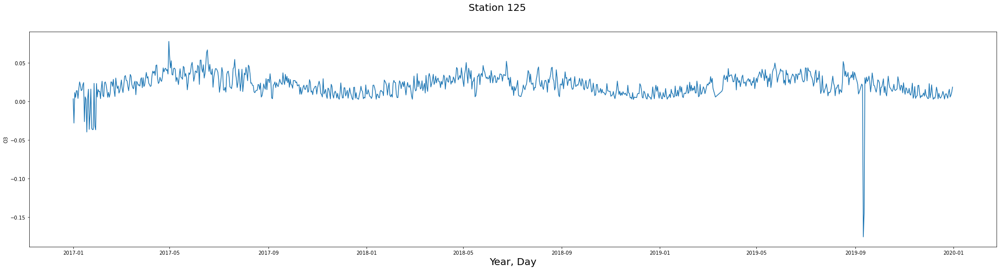

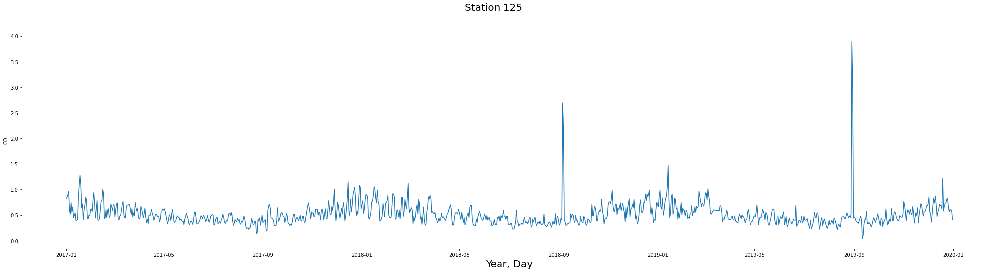

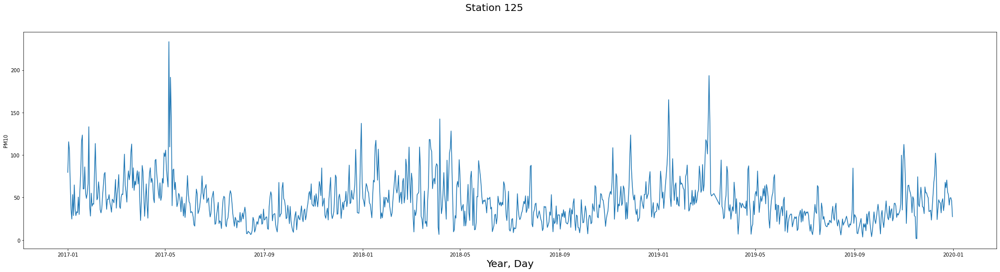

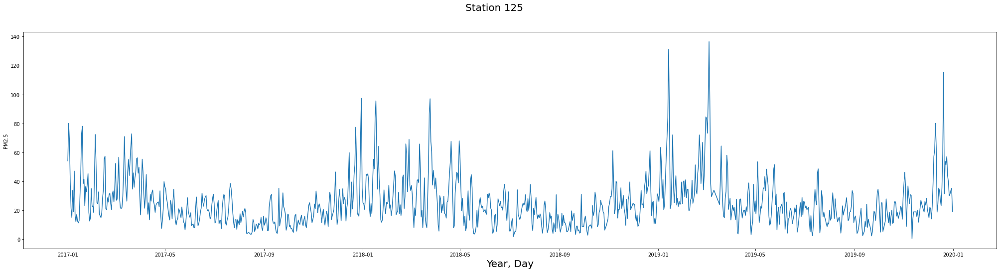

In [818]:
for feature in features:
    fig, ax = plt.subplots(figsize=(35,8))
    fig.suptitle("Station 125", fontsize=20)
    ax.set_xlabel('Year, Day', fontsize=20)
    sns.lineplot(x='Measurement date', y=feature, data=df_125)

In [819]:
df_125['NO2 Level'].value_counts()

Good      601
Normal    467
Bad        17
Name: NO2 Level, dtype: int64

In [820]:
df_125['PM10 Level'].value_counts()

Normal      664
Good        323
Bad          94
Very Bad      4
Name: PM10 Level, dtype: int64

In [821]:
df_125['PM2.5 Level'].value_counts()

Normal      572
Good        313
Bad         182
Very Bad     18
Name: PM2.5 Level, dtype: int64

##### For Station 125:
- NO2 reaches levels of 'Bad' on 17 occasions and sits close to bad on most of the year.
- PM10 reaches levels of 'Bad' on 94 occasions and 'Very Bad' on 4, and can get close to bad on many occasions.
- PM2.5 reaches levels of 'Bad' on 182 occasions and 'Very Bad' on 18 occasions.

# Picking the relevant columns

In [822]:
columns = ['NO2', 'PM10', 'PM2.5']
df_125 = df_125[columns]
df_125

,NO2,PM10,PM2.5
Measurement date,,,
2017-01-01,0.039042,79.583333,54.208333
2017-01-02,-0.003250,115.583333,80.083333
2017-01-03,0.045333,105.958333,68.708333
2017-01-04,0.055000,66.083333,39.666667
2017-01-05,0.031708,35.541667,21.500000
...,...,...,...
2019-12-27,0.031667,41.083333,30.125000
2019-12-28,0.043417,49.375000,31.291667
2019-12-29,0.036833,49.791667,33.666667


# Train-Test Split

In [823]:
train = df_125[:-542]
test = df_125[542:]

<AxesSubplot:xlabel='Measurement date'>

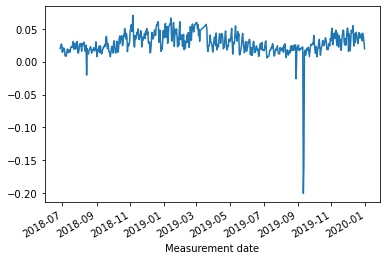

In [824]:
test['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

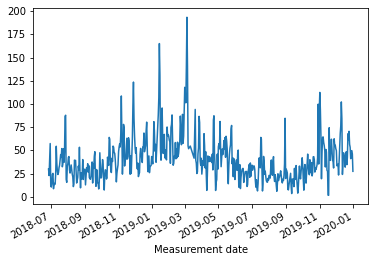

In [825]:
test['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

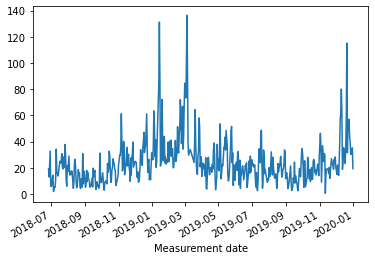

In [826]:
test['PM2.5'].plot()

<AxesSubplot:xlabel='Measurement date'>

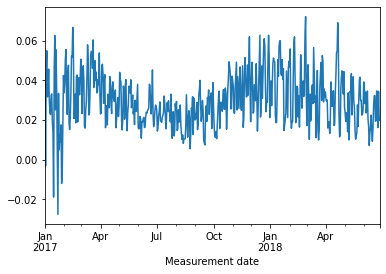

In [827]:
train['NO2'].plot()

<AxesSubplot:xlabel='Measurement date'>

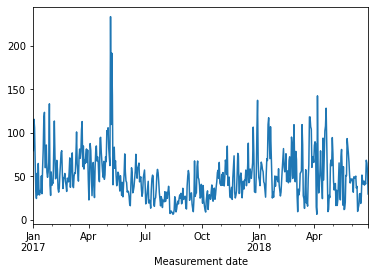

In [828]:
train['PM10'].plot()

<AxesSubplot:xlabel='Measurement date'>

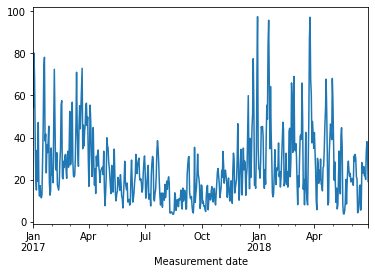

In [829]:
train['PM2.5'].plot()

In [830]:
print(stationarity_check(df_125['PM2.5']))
print(stationarity_check(df_125['PM10']))
print(stationarity_check(df_125['NO2']))

Results of Dickey-Fuller Test: 

Test Statistic                   -4.440904
p-value                           0.000251
#Lags Used                       13.000000
Number of Observations Used    1071.000000
Critical Value (1%)              -3.436470
Critical Value (5%)              -2.864242
Critical Value (10%)             -2.568209
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -5.544537
p-value                           0.000002
#Lags Used                       10.000000
Number of Observations Used    1074.000000
Critical Value (1%)              -3.436453
Critical Value (5%)              -2.864235
Critical Value (10%)             -2.568205
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                   -5.004519
p-value                           0.000022
#Lags Used                       10.000000
Number of Observations Used    1074.000000
Critical Value (1%)              -3.436453
Critical Value (5%)              -2.864235
C

# Rolling Mean Difference Train

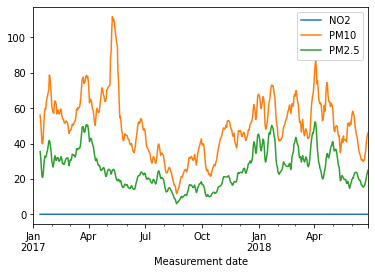

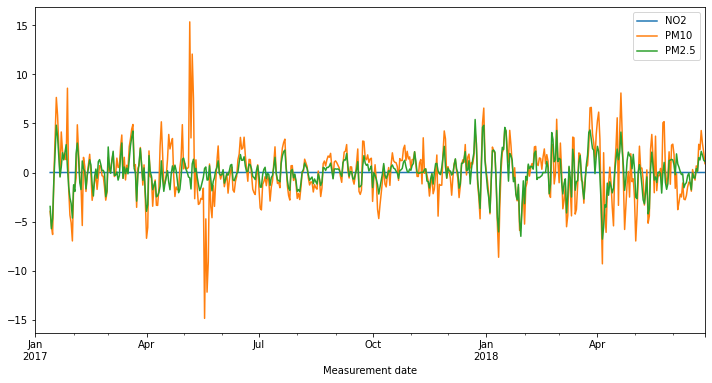

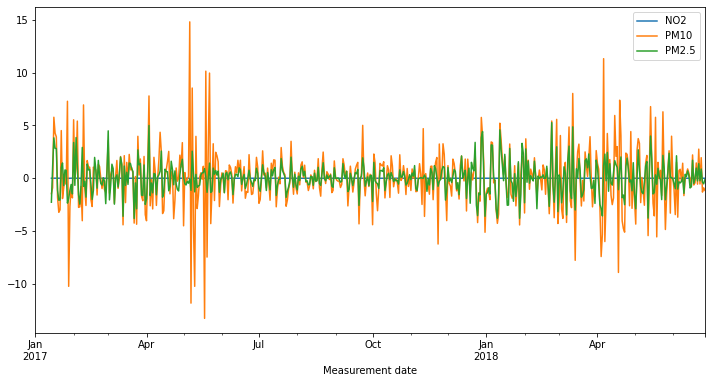

In [831]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_train = train.rolling(window=12).mean()
roll_mean_train.plot();

rm_diff_1 = roll_mean_train.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_train.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [832]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -7.599732e+00
p-value                        2.407081e-11
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.173626e+00
p-value                        8.491588e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)           -2.867136e+00
Critical Value (10%)          -2.569750e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -8.508737e+00
p-value                        1.183235e-13
#Lags Used                     1.200000e+01
Number of Observations Used    5.180000e+02
Critical Value (1%)           -3.443037e+00
Critical Value (5%)      

In [833]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -1.048239e+01
p-value                        1.204340e-18
#Lags Used                     1.600000e+01
Number of Observations Used    5.130000e+02
Critical Value (1%)           -3.443162e+00
Critical Value (5%)           -2.867190e+00
Critical Value (10%)          -2.569780e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.086426e+01
p-value                        1.420662e-19
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.038179e+01
p-value                        2.129604e-18
#Lags Used                     1.700000e+01
Number of Observations Used    5.120000e+02
Critical Value (1%)           -3.443187e+00
Critical Value (5%)      

# Rolling Mean Difference Test

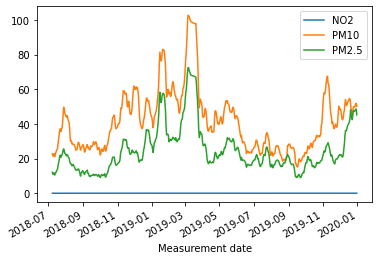

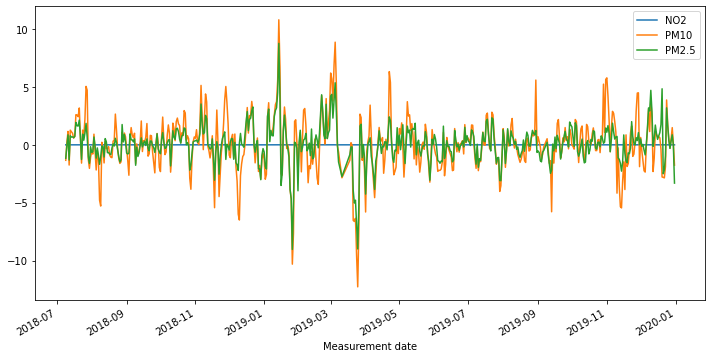

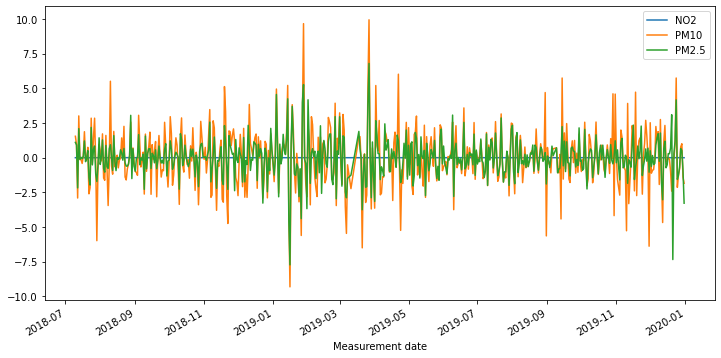

In [834]:
# Apply a 1st order difference to the time series and plot the rolling mean

roll_mean_test = test.rolling(window=12).mean()
roll_mean_test.plot();

rm_diff_1 = roll_mean_test.diff(periods=1)
rm_diff_1.plot(figsize=(12,6))


rm_diff_2 = roll_mean_test.diff(periods=1).diff(periods=1)
rm_diff_2.plot(figsize=(12,6));

In [835]:
print(stationarity_check(rm_diff_1['PM2.5'].dropna()))
print(stationarity_check(rm_diff_1['PM10'].dropna()))
print(stationarity_check(rm_diff_1['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -6.005999e+00
p-value                        1.615014e-07
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158e+00
Critical Value (10%)          -2.569762e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                  -5.456713
p-value                          0.000003
#Lags Used                      16.000000
Number of Observations Used    514.000000
Critical Value (1%)             -3.443136
Critical Value (5%)             -2.867179
Critical Value (10%)            -2.569774
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -7.156817e+00
p-value                        3.039568e-10
#Lags Used                     1.400000e+01
Number of Observations Used    5.160000e+02
Critical Value (1%)           -3.443087e+00
Critical Value (5%)           -2.867158

In [836]:
print(stationarity_check(rm_diff_2['PM2.5'].dropna()))
print(stationarity_check(rm_diff_2['PM10'].dropna()))
print(stationarity_check(rm_diff_2['NO2'].dropna()))

Results of Dickey-Fuller Test: 

Test Statistic                -9.801621e+00
p-value                        5.974046e-17
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -1.162556e+01
p-value                        2.328237e-21
#Lags Used                     1.500000e+01
Number of Observations Used    5.140000e+02
Critical Value (1%)           -3.443136e+00
Critical Value (5%)           -2.867179e+00
Critical Value (10%)          -2.569774e+00
dtype: float64
None
Results of Dickey-Fuller Test: 

Test Statistic                -9.790644e+00
p-value                        6.367180e-17
#Lags Used                     1.900000e+01
Number of Observations Used    5.100000e+02
Critical Value (1%)           -3.443237e+00
Critical Value (5%)      

# Station 125 PM2.5

In [837]:
base_model = sm.tsa.statespace.SARIMAX(df_125['PM2.5'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -4589.548
Date:                Wed, 20 Oct 2021   AIC                           9183.095
Time:                        15:01:25   BIC                           9193.074
Sample:                             0   HQIC                          9186.873
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     24.9092      0.684     36.437      0.000      23.569      26.249
sigma2       276.4745      8.000     34.558      0.000     260.794     292.155
Ljung-Box (L1) (Q):                 561.19   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=8512.750, Time=0.04 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=10458.002, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=8510.893, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=9479.065, Time=0.04 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=8512.828, Time=0.05 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=8505.215, Time=0.11 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=8342.147, Time=0.19 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=8447.388, Time=0.07 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=8339.824, Time=0.30 sec
 ARIMA(4,0,0)(0,0,0)[0]             : AIC=8426.840, Time=0.10 sec
 ARIMA(5,0,1)(0,0,0)[0]             : AIC=8341.800, Time=0.45 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=inf, Time=0.55 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=8340.500, Time=0.30 sec
 ARIMA(5,0,0)(0,0,0)[0]             : AIC=8416.991, Time=0.16 sec
 ARIMA(5,0,2)(0,0,0)[0]             :

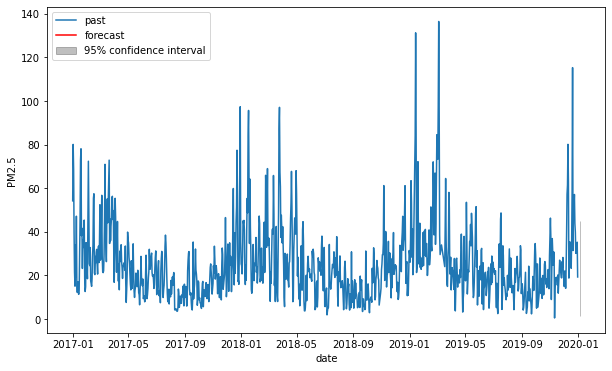

In [838]:
timeseries = df_125['PM2.5']
automodel = arimamodel(df_125['PM2.5'])
plotarima(1, timeseries, automodel)

In [839]:
best_model = sm.tsa.statespace.SARIMAX(df_125['PM2.5'], trend='c', order=[4,0,1])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


                               SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                 1085
Model:               SARIMAX(4, 0, 1)   Log Likelihood               -4159.341
Date:                Wed, 20 Oct 2021   AIC                           8332.682
Time:                        15:01:34   BIC                           8367.607
Sample:                             0   HQIC                          8345.903
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.2087      0.147      1.421      0.155      -0.079       0.497
ar.L1          1.6952      0.034     49.689      0.000       1.628       1.762
ar.L2         -0.9350      0.045    -20.817      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [840]:
model_train = arima_results(train['PM2.5'],test['PM2.5'], order=[4,0,1])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 10.94225142496466
Test RMSE: 23.16203473756111
Summary:                                SARIMAX Results                                
Dep. Variable:                  PM2.5   No. Observations:                  543
Model:                 ARIMA(4, 0, 1)   Log Likelihood               -2067.914
Date:                Wed, 20 Oct 2021   AIC                           4149.827
Time:                        15:01:34   BIC                           4179.907
Sample:                    01-01-2017   HQIC                          4161.589
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.7405      4.827      5.540      0.000      17.280      36.201
ar.L1          1.7481      0.047     37.532      0.000       1.

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 125 NO2

In [841]:
base_model = sm.tsa.statespace.SARIMAX(df_125['NO2'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood                2939.768
Date:                Wed, 20 Oct 2021   AIC                          -5875.536
Time:                        15:01:35   BIC                          -5865.557
Sample:                             0   HQIC                         -5871.758
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0291      0.001     50.659      0.000       0.028       0.030
sigma2         0.0003   2.49e-06    104.052      0.000       0.000       0.000
Ljung-Box (L1) (Q):                 372.84   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-6179.933, Time=0.17 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=-4302.987, Time=0.03 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=-6131.087, Time=0.04 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=-5275.553, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-6145.584, Time=0.27 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-6433.480, Time=0.20 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=-5601.683, Time=0.13 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-6427.335, Time=0.28 sec
 ARIMA(1,0,3)(0,0,0)[0]             : AIC=-6432.641, Time=0.43 sec
 ARIMA(0,0,3)(0,0,0)[0]             : AIC=-5745.704, Time=0.28 sec
 ARIMA(2,0,3)(0,0,0)[0]             : AIC=-6435.539, Time=0.29 sec
 ARIMA(3,0,3)(0,0,0)[0]             : AIC=-6433.120, Time=0.47 sec
 ARIMA(2,0,4)(0,0,0)[0]             : AIC=-6433.364, Time=0.48 sec
 ARIMA(1,0,4)(0,0,0)[0]             : AIC=-6391.939, Time=0.49 sec
 ARIMA(3,0,2)(0,0,0

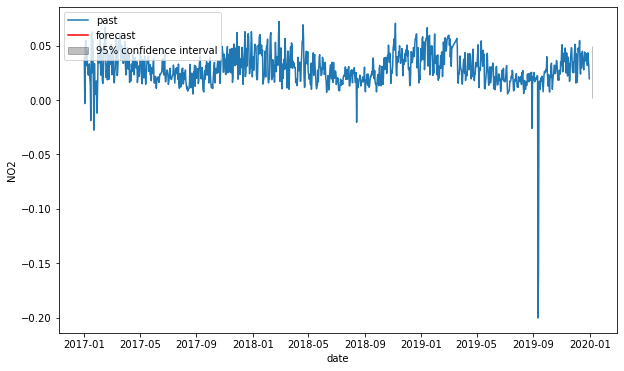

In [842]:
timeseries = df_125['NO2']
automodel = arimamodel(df_125['NO2'])
plotarima(1, timeseries, automodel)

In [843]:
best_model = sm.tsa.statespace.SARIMAX(df_125['NO2'], trend='c', order=[3,0,4])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packa

                               SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                 1085
Model:               SARIMAX(3, 0, 4)   Log Likelihood                3197.144
Date:                Wed, 20 Oct 2021   AIC                          -6376.288
Time:                        15:01:45   BIC                          -6331.384
Sample:                             0   HQIC                         -6359.289
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0186      0.005      3.916      0.000       0.009       0.028
ar.L1          0.3121      0.331      0.942      0.346      -0.337       0.961
ar.L2         -0.0667      0.379     -0.176      0.8

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [844]:
model_train = arima_results(train['NO2'],test['NO2'], order=[3,0,4])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('

Train RMSE: 0.011309652567488622
Test RMSE: 0.02065623230745106
Summary:                                SARIMAX Results                                
Dep. Variable:                    NO2   No. Observations:                  543
Model:                 ARIMA(3, 0, 4)   Log Likelihood                1663.546
Date:                Wed, 20 Oct 2021   AIC                          -3309.093
Time:                        15:01:46   BIC                          -3270.419
Sample:                    01-01-2017   HQIC                         -3293.971
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0301      0.001     28.059      0.000       0.028       0.032
ar.L1          0.2905      1.595      0.182      0.856    

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Station 125 PM10

In [845]:
base_model = sm.tsa.statespace.SARIMAX(df_125['PM10'], trend='c', order=[0,0,0])
res = base_model.fit(disp=False)
print(res.summary())

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:                        SARIMAX   Log Likelihood               -5068.046
Date:                Wed, 20 Oct 2021   AIC                          10140.093
Time:                        15:01:46   BIC                          10150.072
Sample:                             0   HQIC                         10143.870
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     45.3032      0.975     46.441      0.000      43.391      47.215
sigma2       667.9037     18.709     35.699      0.000     631.234     704.573
Ljung-Box (L1) (Q):                 484.99   Jarque-

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'


Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=9614.050, Time=0.06 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=11661.811, Time=0.01 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=9651.620, Time=0.02 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=10704.954, Time=0.03 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=9648.263, Time=0.16 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=9482.831, Time=0.10 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=10329.288, Time=0.07 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=9458.241, Time=0.19 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=9456.701, Time=0.20 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=9460.305, Time=0.19 sec
 ARIMA(4,0,2)(0,0,0)[0]             : AIC=9455.247, Time=0.48 sec
 ARIMA(4,0,1)(0,0,0)[0]             : AIC=9458.771, Time=0.32 sec
 ARIMA(5,0,2)(0,0,0)[0]             : AIC=inf, Time=0.45 sec
 ARIMA(4,0,3)(0,0,0)[0]             : AIC=9456.561, Time=0.50 sec
 ARIMA(3,0,3)(0,0,0)[0]            

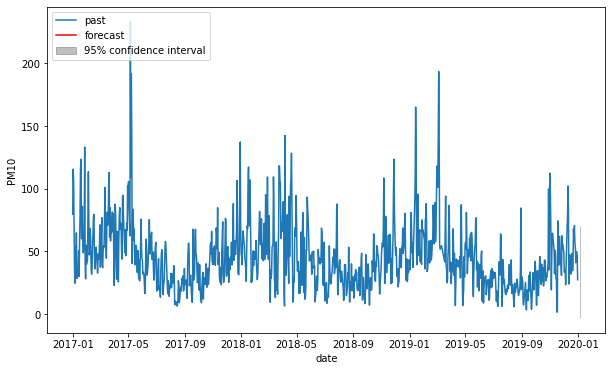

In [846]:
timeseries = df_125['PM10']
automodel = arimamodel(df_125['PM10'])
plotarima(1, timeseries, automodel)

In [847]:
best_model = sm.tsa.statespace.SARIMAX(df_125['PM10'], trend='c', order=[3,0,3])
res = best_model.fit(disp=False)
print(res.summary())

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:593: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  warnings.warn('A date index has been provided, but it has no'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packa

                               SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                 1085
Model:               SARIMAX(3, 0, 3)   Log Likelihood               -4717.347
Date:                Wed, 20 Oct 2021   AIC                           9450.693
Time:                        15:01:53   BIC                           9490.608
Sample:                             0   HQIC                          9465.803
                               - 1085                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.8462      0.584      1.449      0.147      -0.298       1.990
ar.L1          0.3721      0.054      6.853      0.000       0.266       0.479
ar.L2          0.9721      0.012     83.456      0.0

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [848]:
model_train = arima_results(train['PM10'],test['PM10'], order=[3,0,3])

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'
/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:536: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  warnings.warn('No frequency information was'


Train RMSE: 20.842253362043778
Test RMSE: 33.681485120432725
Summary:                                SARIMAX Results                                
Dep. Variable:                   PM10   No. Observations:                  543
Model:                 ARIMA(3, 0, 3)   Log Likelihood               -2419.333
Date:                Wed, 20 Oct 2021   AIC                           4854.666
Time:                        15:01:53   BIC                           4889.043
Sample:                    01-01-2017   HQIC                          4868.108
                         - 06-27-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         50.5683      7.629      6.629      0.000      35.616      65.520
ar.L1          0.5249      0.122      4.300      0.000       

/Users/rashidkarriti/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


# Visualizations

<AxesSubplot:xlabel='NO2 Level', ylabel='count'>

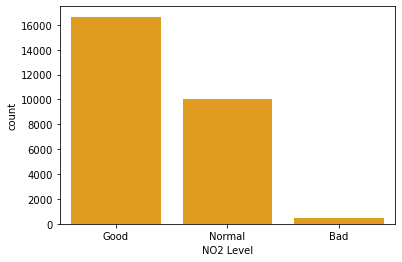

In [974]:
sns.countplot(x='NO2 Level',data=df, order=['Good', 'Normal', 'Bad'], color='orange')

<AxesSubplot:xlabel='PM10 Level', ylabel='count'>

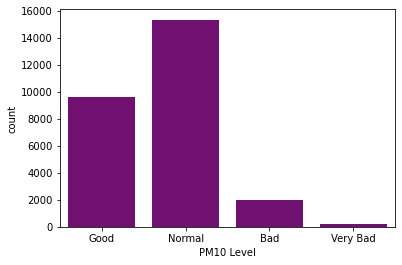

In [962]:
sns.countplot(x='PM10 Level',data=df, order=['Good', 'Normal', 'Bad', 'Very Bad'], color='purple')

<AxesSubplot:xlabel='PM2.5 Level', ylabel='count'>

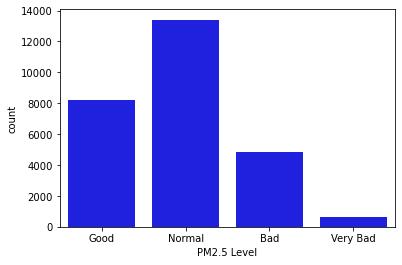

In [851]:
sns.countplot(x='PM2.5 Level',data=df, order=['Good', 'Normal', 'Bad', 'Very Bad'], color='blue')

In [945]:


seoul = ('Seoul')
gdf = geopandas.read_file(seoul)

gdf.shape

(25, 7)

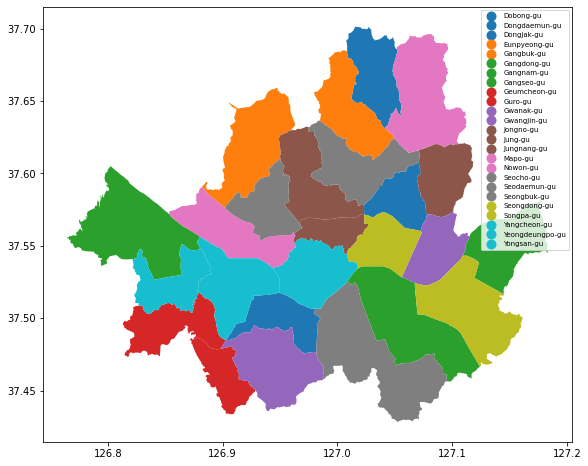

In [873]:
ax = gdf.plot("SIG_ENG_NM", legend=True, figsize=(50,8), legend_kwds={'fontsize':7})

In [937]:
ranking = pd.read_csv('ranking.csv')
ranking = ranking.drop('Unnamed: 0', axis = 1)
ranking = ranking.reset_index()

In [948]:
ranking

,index,Station,PM10_Bad,PM2.5_Bad,NO2_Bad
0,0,113,93,250,8
1,1,104,74,202,11
2,2,109,65,173,37
3,3,120,61,206,27
4,4,118,60,205,22
5,5,117,151,319,2
6,6,101,50,160,24
7,7,112,67,158,10
8,8,110,68,172,7
9,9,123,61,202,10


In [949]:
plotting = gdf.reset_index(drop=True).merge(ranking.reset_index(drop=True), left_index=True, right_index=True)
plotting 

,SIG_CD,SIG_KOR_NM,SIG_ENG_NM,ESRI_PK,SHAPE_AREA,SHAPE_LEN,geometry,index,Station,PM10_Bad,PM2.5_Bad,NO2_Bad
0,11320,도봉구,Dobong-gu,0,0.002110,0.239901,"POLYGON ((127.01985 37.70088, 127.02217 37.699...",0,113,93,250,8
1,11380,은평구,Eunpyeong-gu,1,0.003041,0.327143,"POLYGON ((126.95174 37.65489, 126.95188 37.654...",1,104,74,202,11
2,11230,동대문구,Dongdaemun-gu,2,0.001453,0.182837,"POLYGON ((127.07110 37.60733, 127.07119 37.606...",2,109,65,173,37
3,11590,동작구,Dongjak-gu,3,0.001670,0.237796,"POLYGON ((126.95472 37.51604, 126.95556 37.515...",3,120,61,206,27
4,11545,금천구,Geumcheon-gu,4,0.001325,0.211649,"POLYGON ((126.87994 37.48606, 126.88034 37.485...",4,118,60,205,22
5,11530,구로구,Guro-gu,5,0.002047,0.347568,"POLYGON ((126.87951 37.51778, 126.88175 37.516...",5,117,151,319,2
6,11110,종로구,Jongno-gu,6,0.002448,0.290100,"POLYGON ((126.97509 37.63118, 126.97469 37.629...",6,101,50,160,24
7,11305,강북구,Gangbuk-gu,7,0.002412,0.267441,"POLYGON ((127.00459 37.68500, 127.00555 37.684...",7,112,67,158,10
8,11260,중랑구,Jungnang-gu,8,0.001893,0.184716,"POLYGON ((127.11132 37.62070, 127.11216 37.620...",8,110,68,172,7
9,11680,강남구,Gangnam-gu,9,0.004027,0.348412,"POLYGON ((127.03969 37.53584, 127.03981 37.535...",9,123,61,202,10


# PM10 Map

Text(0.5, 1.0, 'PM10 Levels')

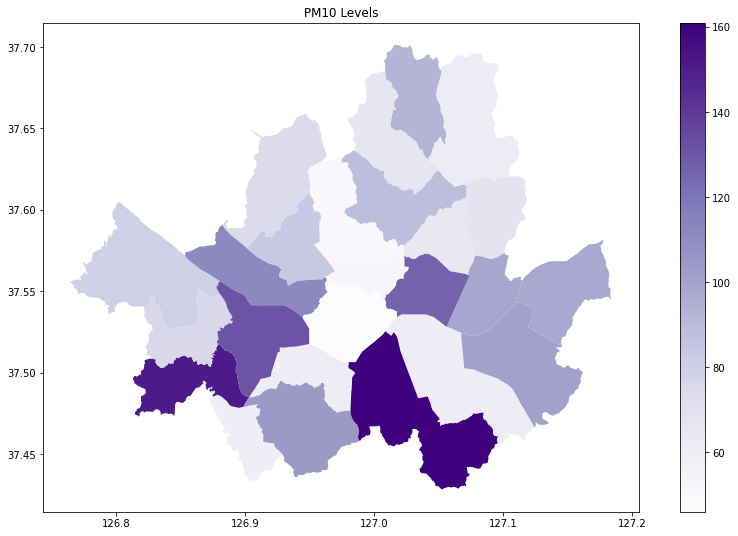

In [963]:
ax = plotting.plot(column='PM10_Bad', cmap =    
                                'Purples', figsize=(15,9),   
                                  k=3, legend =  
                                  True);
ax.set_title("PM10 Levels")

# PM2.5 Map

Text(0.5, 1.0, 'PM2.5 Levels')

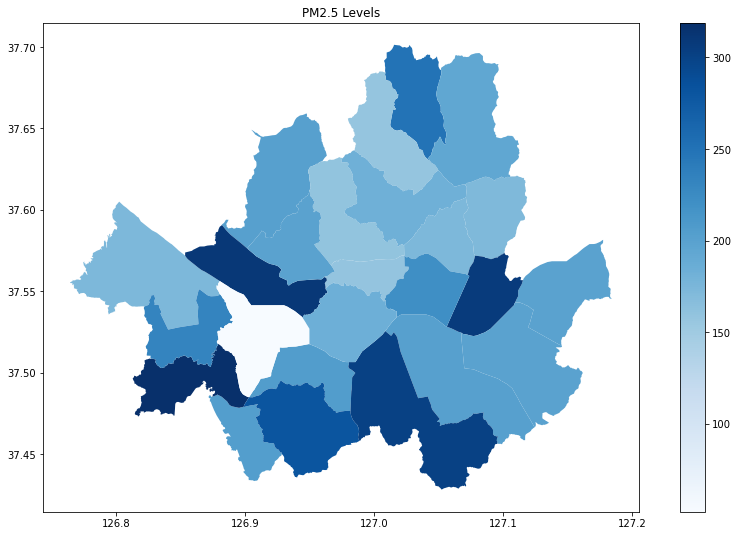

In [975]:
ax = plotting.plot(column='PM2.5_Bad', cmap =    
                                'Blues', figsize=(15,9),   
                                  k=3, legend =  
                                  True);
ax.set_title("PM2.5 Levels")

# NO2 Map

Text(0.5, 1.0, 'NO2 Levels')

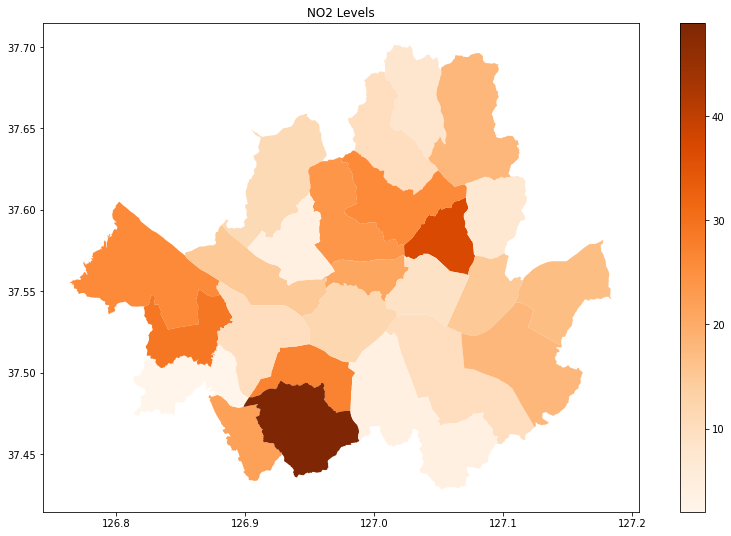

In [973]:
ax = plotting.plot(column='NO2_Bad', cmap =    
                                'Oranges', figsize=(15,9),   
                                  k=3, legend =  
                                  True);
ax.set_title("NO2 Levels")

In [984]:
shanghi_weather 

,date,maxtempC,mintempC,totalSnow_cm,sunHour,uvIndex,moon_illumination,DewPointC,FeelsLikeC,HeatIndexC,...,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph,AQI,AQI_Explained
0,2014-01-01,15.0,5.0,0.0,8.7,4.0,0.0,-1.0,11.0,12.0,...,0.0,43.0,0.0,1021.0,15.0,10.0,242.0,12.0,319.0,Hazardous
1,2014-01-02,14.0,7.0,0.0,8.7,4.0,2.0,4.0,11.0,13.0,...,3.0,60.0,0.0,1019.0,14.0,10.0,141.0,14.0,352.0,Hazardous
2,2014-01-03,16.0,9.0,0.0,8.7,4.0,10.0,3.0,11.0,12.0,...,26.0,55.0,0.0,1017.0,16.0,10.0,295.0,14.0,338.0,Hazardous
3,2014-01-04,10.0,4.0,0.0,5.5,2.0,17.0,3.0,7.0,9.0,...,24.0,68.0,0.1,1022.0,10.0,10.0,169.0,14.0,355.0,Hazardous
4,2014-01-05,10.0,3.0,0.0,8.7,3.0,24.0,3.0,9.0,9.0,...,12.0,66.0,0.0,1024.0,10.0,10.0,117.0,6.0,343.0,Hazardous
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2497,2021-01-26,12.0,10.0,0.0,4.0,3.0,88.0,7.0,10.0,11.0,...,91.0,77.0,1.1,1023.0,12.0,8.0,233.0,9.0,229.0,Very unhealthy
2498,2021-01-27,11.0,7.0,0.0,8.7,2.0,96.0,4.0,7.0,9.0,...,55.0,72.0,0.0,1024.0,11.0,10.0,49.0,11.0,200.0,Unhealthy
2499,2021-01-28,10.0,4.0,0.0,8.7,3.0,100.0,-5.0,5.0,8.0,...,16.0,44.0,0.0,1028.0,10.0,10.0,291.0,19.0,309.0,Hazardous
2500,2021-01-29,9.0,6.0,0.0,8.7,3.0,90.0,-9.0,5.0,7.0,...,0.0,32.0,0.0,1030.0,9.0,10.0,188.0,10.0,320.0,Hazardous


In [1154]:
shanghi_air['date'] = pd.to_datetime(shanghi_air['date'])
shanghi_air = shanghi_air.sort_values(by="date")
shanghi_air.set_index(shanghi_air['date'], inplace=True)
shanghi_air = shanghi_air.drop('date', axis=1)
shanghi_air

,pm25,pm10,o3,no2,so2,co
date,,,,,,
2014-01-01,,121,29,57,30,14
2014-01-02,188,92,39,54,17,13
2014-01-03,170,105,21,55,32,12
2014-01-04,191,94,18,36,19,9
2014-01-05,176,53,13,37,13,7
...,...,...,...,...,...,...
2021-01-27,90,50,38,16,2,9
2021-01-28,132,72,28,20,2,10
2021-01-29,146,62,24,13,3,6


In [1155]:
start_remove = pd.to_datetime('2014-01-01')
end_remove = pd.to_datetime('2016-12-31')

In [1156]:
shanghi_air = shanghi_air.query('index < @start_remove or index > @end_remove')
shanghi_air

,pm25,pm10,o3,no2,so2,co
date,,,,,,
2017-01-01,126,46,24,36,8,7
2017-01-02,114,63,27,33,8,10
2017-01-03,150,79,29,35,6,10
2017-01-04,178,55,28,37,8,8
2017-01-05,147,32,33,22,5,7
...,...,...,...,...,...,...
2021-01-27,90,50,38,16,2,9
2021-01-28,132,72,28,20,2,10
2021-01-29,146,62,24,13,3,6


In [1157]:
start_remove = pd.to_datetime('2020-01-01')
end_remove = pd.to_datetime('2021-12-30')

In [1158]:
shanghi_air = shanghi_air.query('index < @start_remove or index > @end_remove')
shanghi_air

,pm25,pm10,o3,no2,so2,co
date,,,,,,
2017-01-01,126,46,24,36,8,7
2017-01-02,114,63,27,33,8,10
2017-01-03,150,79,29,35,6,10
2017-01-04,178,55,28,37,8,8
2017-01-05,147,32,33,22,5,7
...,...,...,...,...,...,...
2019-12-26,83,32,17,22,2,9
2019-12-27,96,59,20,28,4,10
2019-12-28,155,66,32,34,4,9


In [1161]:
shanghi_air.dtypes

 pm25    object
 pm10    object
 o3      object
 no2     object
 so2     object
 co      object
dtype: object

In [1167]:
shanghi_air[' pm25'] = pd.to_numeric(shanghi_air[' pm25'], errors='coerce').convert_dtypes() 
shanghi_air[' pm10'] = pd.to_numeric(shanghi_air[' pm10'], errors='coerce').convert_dtypes()
shanghi_air[' no2'] = pd.to_numeric(shanghi_air[' no2'], errors='coerce').convert_dtypes()
shanghi_air.dtypes                                         

<ipython-input-1167-f1f104b50738>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shanghi_air[' pm25'] = pd.to_numeric(shanghi_air[' pm25'], errors='coerce').convert_dtypes()
<ipython-input-1167-f1f104b50738>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shanghi_air[' pm10'] = pd.to_numeric(shanghi_air[' pm10'], errors='coerce').convert_dtypes()
<ipython-input-1167-f1f104b50738>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_

 pm25    Int64
 pm10    Int64
 o3      Int64
 no2     Int64
 so2     Int64
 co      Int64
dtype: object

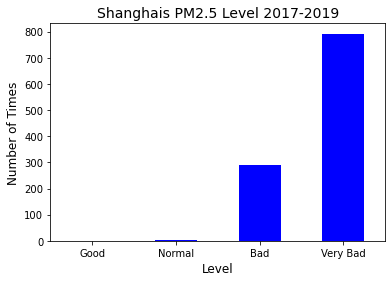

In [1198]:
out = pd.cut(shanghi_air[' pm25'], bins=[0, 15, 35, 75, 500],  precision=0, labels =["Good", "Normal", "Bad", "Very Bad"])
ax = out.value_counts(sort=False).plot.bar(rot=0, color="b", figsize=(6,4))
ax.set_title('Shanghais PM2.5 Level 2017-2019', fontsize=14)
ax.set_xlabel('Level', fontsize=12)
ax.set_ylabel('Number of Times', fontsize=12)
plt.show()

In [1189]:
shanghi_weather['AQI'].max

<bound method Series.max of 0       319
1       352
2       338
3       355
4       343
       ... 
2497    229
2498    200
2499    309
2500    320
2501    162
Name: AQI, Length: 2502, dtype: Int64>

In [1185]:
shanghi_weather['AQI'] = pd.to_numeric(shanghi_weather['AQI'], errors='coerce').convert_dtypes()

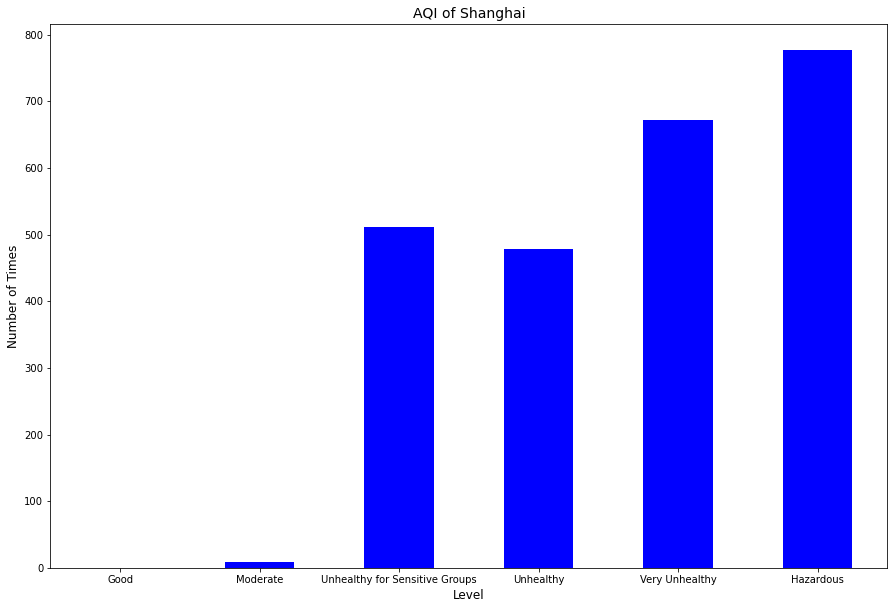

In [1197]:
out = pd.cut(shanghi_weather['AQI'], bins=[0, 50, 100, 150, 200, 300, 352],  precision=0, labels =["Good", "Moderate", "Unhealthy for Sensitive Groups", "Unhealthy", 'Very Unhealthy', 'Hazardous'])
ax = out.value_counts(sort=False).plot.bar(rot=0, color="b", figsize=(15,10))
ax.set_title('AQI of Shanghai', fontsize=14)
ax.set_xlabel('Level', fontsize=12)
ax.set_ylabel('Number of Times', fontsize=12)
plt.show()